In [1]:
import pandas as pd
import numpy as np
from sklearn.model_selection import StratifiedKFold, GridSearchCV, RandomizedSearchCV
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler
from xgboost import XGBClassifier
from sklearn.metrics import f1_score, precision_score, recall_score, accuracy_score, roc_auc_score, confusion_matrix, roc_curve
from sklearn.inspection import permutation_importance
from sklearn.utils.class_weight import compute_class_weight
import shap
from sklearn.linear_model import LassoCV
import seaborn as sns
import matplotlib.pyplot as plt
import joblib

# Các hàm

## 1. Load dữ liệu

In [2]:
# Đọc dữ liệu
def load_data(phase):
    # Đọc dữ liệu từ các file CSV
    phase_ = phase[:-1] + '_' + phase[-1]
    X_train = pd.read_csv(f"/kaggle/input/final-data/{phase}/user_train_{phase_}_train.csv")
    X_test = pd.read_csv(f"/kaggle/input/final-data/{phase}/user_train_{phase_}_test.csv")
    
    # In thông tin chung về dữ liệu
    print(X_train.info())

    count_map = X_train['school'].value_counts().to_dict()
    X_train['school'] = X_train['school'].map(count_map)
    X_test['school'] = X_test['school'].map(count_map)

    # Fill nan = 0
    X_train = X_train.fillna(0)
    X_test = X_test.fillna(0)
    
    # Loại bỏ các cột không cần thiết trong X
    columns_to_drop = ['course_id', 'user_id', 'total_score', 'type', 'label']
    X_train = X_train.drop(columns=columns_to_drop, axis=1)
    X_test = X_test.drop(columns=columns_to_drop, axis=1)
    
    # Lấy nhãn (target) từ cột 'label_encoded'
    y_train = X_train.pop("label_encoded")
    y_test = X_test.pop("label_encoded")
    
    return X_train, y_train, X_test, y_test

## 2. Đánh giá dữ liệu

In [3]:
from sklearn.preprocessing import label_binarize
from sklearn.metrics import (
    f1_score, precision_score, recall_score, accuracy_score,
    roc_auc_score, roc_curve, confusion_matrix, classification_report
)
import matplotlib.pyplot as plt
import seaborn as plt
import seaborn as sns
import numpy as np

def evaluate_model(model, X_train, y_train, X_test, y_test):
    def evaluate_split(X, y, split_name):
        y_pred = model.predict(X)
        y_proba = model.predict_proba(X)

        f1 = f1_score(y, y_pred, average=None)
        precision = precision_score(y, y_pred, average=None)
        recall = recall_score(y, y_pred, average=None)
        accuracy = accuracy_score(y, y_pred)

        y_bin = label_binarize(y, classes=[0, 1, 2, 3, 4])
        roc_auc = roc_auc_score(y_bin, y_proba, multi_class="ovr")

        print(f"\n--- {split_name} Metrics ---")
        print("F1 Score (per class):", f1)
        print("Precision (per class):", precision)
        print("Recall (per class):", recall)
        print(f"Accuracy: {accuracy:.4f}")
        print(f"AUC (One-vs-Rest): {roc_auc:.4f}")

        print("\nClassification Report:")
        print(classification_report(y, y_pred, target_names=["E", "D", "C", "B", "A"]))

        conf_matrix = confusion_matrix(y, y_pred)
        plt.figure(figsize=(8, 6))
        sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues",
                    xticklabels=["E", "D", "C", "B", "A"],
                    yticklabels=["E", "D", "C", "B", "A"])
        plt.title(f"Confusion Matrix - {split_name}")
        plt.xlabel("Predicted Label")
        plt.ylabel("True Label")
        plt.show()

        # ROC Curve
        plt.figure(figsize=(10, 8))
        for i in range(5):
            fpr, tpr, _ = roc_curve(y_bin[:, i], y_proba[:, i])
            auc_score = roc_auc_score(y_bin[:, i], y_proba[:, i])
            plt.plot(fpr, tpr, label=f"Class {i} (AUC = {auc_score:.2f})")
        plt.plot([0, 1], [0, 1], 'k--')
        plt.title(f"ROC Curve - {split_name}")
        plt.xlabel("False Positive Rate")
        plt.ylabel("True Positive Rate")
        plt.legend()
        plt.show()

        return f1, precision, recall, accuracy, roc_auc

    train_metrics = evaluate_split(X_train, y_train, "Train")
    test_metrics = evaluate_split(X_test, y_test, "Test")

    return {
        "train": train_metrics,
        "test": test_metrics
    }

## 3. Scale dữ liệu

In [4]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler
import numpy as np
import pandas as pd

def scale_data(X_train, X_test, scaler_type="standard"):
    """
    Áp dụng các kỹ thuật scaling cho dữ liệu.
    
    Parameters:
        X_train (DataFrame): Dữ liệu huấn luyện
        X_test (DataFrame): Dữ liệu kiểm tra
        scaler_type (str): 'minmax', 'standard', 'robust', hoặc 'log'
    
    Returns:
        X_train_scaled, X_test_scaled: Dữ liệu đã được scale
    """
    if scaler_type == "log":
        # Đảm bảo tất cả các giá trị > 0 trước khi lấy log
        min_val = min(X_train.min().min(), X_test.min().min())
        if min_val <= 0:
            offset = 1 - min_val
            X_train = X_train + offset
            X_test = X_test + offset
        X_train_scaled = np.log(X_train)
        X_test_scaled = np.log(X_test)
        return X_train_scaled, X_test_scaled

    elif scaler_type == "minmax":
        scaler = MinMaxScaler()
    elif scaler_type == "standard":
        scaler = StandardScaler()
    elif scaler_type == "robust":
        scaler = RobustScaler()
    else:
        raise ValueError(f"Scaler type '{scaler_type}' không hợp lệ. Chọn: 'minmax', 'standard', 'robust', hoặc 'log'.")

    # Fit và transform dữ liệu
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)
    
    return X_train_scaled, X_test_scaled


## Permutation Importance

In [5]:
from sklearn.inspection import permutation_importance
import matplotlib.pyplot as plt
import pandas as pd

def plot_permutation_importance(model, X_train, y_train):
    # Tính Permutation Importance
    perm_importance = permutation_importance(model, X_train, y_train, n_repeats=8, random_state=42)
    
    # Tạo DataFrame cho dữ liệu quan trọng
    importance_df = pd.DataFrame({
        'Feature': X_train.columns,
        'Importance': perm_importance.importances_mean
    }).sort_values(by='Importance', ascending=False)
    
    # Dựa trên số lượng feature, điều chỉnh kích thước của biểu đồ
    num_features = len(importance_df)
    figsize = (10, num_features * 0.3)  # Điều chỉnh chiều cao dựa trên số feature
    
    # Vẽ biểu đồ
    importance_df.plot(kind='barh', x='Feature', y='Importance', legend=False, figsize=figsize)
    plt.title("Permutation Importance")
    plt.xlabel("Importance")
    plt.ylabel("Feature")
    plt.show()

    return importance_df

## Lasso

In [6]:
import pandas as pd
from sklearn.linear_model import LassoCV
import numpy as np
import matplotlib.pyplot as plt

def lasso_feature_selection(X_train, y_train):
    # Lasso Regression với Cross-Validation để tìm alpha tốt nhất
    lasso = LassoCV(cv=5, random_state=42)
    lasso.fit(X_train, y_train)
    
    # In ra trọng số của các feature
    feature_importance = pd.DataFrame({
        'Feature': X_train.columns,
        'Importance': np.abs(lasso.coef_)
    }).sort_values(by='Importance', ascending=False)
    
    # Tính chiều cao dựa trên số lượng feature
    num_features = len(feature_importance)
    height = max(4, num_features * 0.3)  # đảm bảo không quá nhỏ
    
    # Vẽ biểu đồ trọng số của feature
    feature_importance.plot(kind='barh', x='Feature', y='Importance', legend=False, figsize=(8, height))
    plt.title("Lasso Feature Importance")
    plt.xlabel("Importance")
    plt.ylabel("Feature")
    plt.tight_layout()
    plt.show()
    
    return feature_importance

## Boruta Trick

In [7]:
from sklearn.ensemble import RandomForestClassifier
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def boruta_trick(model, X_train, y_train):
    # Tạo một feature ngẫu nhiên (feature "ngẫu nhiên")
    random_feature = np.random.rand(X_train.shape[0], 1)
    X_train_random = np.hstack([X_train.values, random_feature])

    # Huấn luyện mô hình Random Forest
    model.fit(X_train_random, y_train)

    # Tính toán importance của từng feature
    feature_importance = pd.DataFrame({
        'Feature': list(X_train.columns) + ['Random Feature'],
        'Importance': model.feature_importances_
    }).sort_values(by='Importance', ascending=False)

    # In ra độ quan trọng của tất cả các feature (bao gồm feature ngẫu nhiên)
    print('Feature Importance (Including Random Feature):')
    print(feature_importance)

    # Lọc các feature quan trọng hơn feature ngẫu nhiên
    important_features = feature_importance[feature_importance['Importance'] > feature_importance['Importance'].iloc[-1]]
    print('Important features (Above Random Feature): ', important_features)

    # Dựa trên số lượng feature, điều chỉnh kích thước của biểu đồ
    num_features = len(feature_importance)
    figsize = (10, num_features * 0.3)  # Điều chỉnh chiều cao dựa trên số feature
    
    # Vẽ biểu đồ
    feature_importance.plot(kind='barh', x='Feature', y='Importance', legend=False, figsize=figsize)
    plt.title("Boruta Feature Importance (Trick)")
    plt.xlabel("Importance")
    plt.ylabel("Feature")
    plt.show()

    return important_features

## Calibration

In [8]:
from sklearn.calibration import CalibratedClassifierCV

def calibrate_model(model, X_train, y_train, method='sigmoid'):
    """
    Áp dụng Calibration (One-vs-Rest cho đa lớp).
    
    Parameters:
    model: mô hình đã huấn luyện
    X_train: Dữ liệu huấn luyện
    y_train: Nhãn huấn luyện
    method: phương pháp calibration ('sigmoid' hoặc 'isotonic')
    
    Return:
    calibrated_model: mô hình đã qua calibration
    """
    calibrated_model = CalibratedClassifierCV(model, method=method, cv='prefit')
    calibrated_model.fit(X_train, y_train)
    return calibrated_model

In [9]:
# SHAP (SHapley Additive exPlanations)
def plot_shap_importance(model, X_train):
    explainer = shap.TreeExplainer(model)
    shap_values = explainer.shap_values(X_train)
    # Vẽ SHAP summary plot
    shap.summary_plot(shap_values, X_train)
    return shap_values

In [10]:
from sklearn.utils.class_weight import compute_sample_weight
from sklearn.metrics import f1_score
import matplotlib.pyplot as plt

def find_hyperparameter(phase, scale='standard', metric='accuracy'):
    # Đọc dữ liệu
    X_train, y_train, X_test, y_test = load_data(phase)

    # Scale dữ liệu
    X_train_scaled, X_test_scaled = scale_data(X_train, X_test, scaler_type=scale)
    X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)
    X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns)

    param_grid = {
        'n_estimators': [100, 300, 500, 800],
        'max_depth': [5, 10, 15, 20, None],
        'min_samples_split': [2, 5, 10],
        'min_samples_leaf': [1, 2, 4],
        'max_features': ['sqrt', 'log2', None],
        'bootstrap': [True, False]
    }
    # Cấu hình StratifiedKFold
    skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    
    # RandomizedSearchCV với StratifiedKFold
    random_search = RandomizedSearchCV(
        estimator=RandomForestClassifier(random_state=42, class_weight='balanced'),
        param_distributions=param_grid,
        scoring='f1_macro',
        n_iter=40,
        cv=skf,
        random_state=42,
        n_jobs=-1,
        verbose=2
    )
    # Fit với cross-validation
    random_search.fit(X_train_scaled, y_train)
    
    # In ra siêu tham số tốt nhất
    print(f"✅ Best Parameters for phase {phase}:")
    print(random_search.best_params_)
    
    return random_search.best_params_

In [11]:
# Lặp qua các phase
# hp_1 = find_hyperparameter("phase1", metric='f1_macro')
# hp_2 = find_hyperparameter("phase2", metric='f1_macro')
# hp_3 = find_hyperparameter("phase3", metric='f1_macro')
# hp_4 = find_hyperparameter("phase4", metric='f1_macro')


In [12]:
hp_1 = {'n_estimators': 300, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 'log2', 'max_depth': 20, 'bootstrap': True}
hp_2 = {'n_estimators': 300, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 'log2', 'max_depth': 20, 'bootstrap': True}
hp_3 = {'n_estimators': 300, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 'log2', 'max_depth': 20, 'bootstrap': True}
hp_4 = {'n_estimators': 300, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 'log2', 'max_depth': 20, 'bootstrap': True}

# 1. Scale dữ liệu standard

In [13]:
from sklearn.utils.class_weight import compute_sample_weight
from sklearn.metrics import f1_score
import matplotlib.pyplot as plt

def process_phase(phase, hyper, scale='standard', metric='accuracy'):
    # Đọc dữ liệu
    X_train, y_train, X_test, y_test = load_data(phase)

    # Scale dữ liệu
    X_train_scaled, X_test_scaled = scale_data(X_train, X_test, scaler_type=scale)
    X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)
    X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns)

    # Huấn luyện mô hình
    model = RandomForestClassifier(**hyper, random_state=42, class_weight='balanced')
    model.fit(X_train_scaled, y_train)
    
    # Dự đoán
    y_pred = model.predict(X_test_scaled)

    # Lưu kết quả
    results_df = X_test.copy()
    results_df['True_Label'] = y_test
    results_df['Predicted_Label'] = y_pred
    results_filename = f"test_results_{scale}_{metric}_{phase}.csv"
    results_df.to_csv(results_filename, index=False)
    print(f"Results saved as {results_filename}")

    # Đánh giá mô hình
    print(f"----------Results for phase: {phase}--------------")
    evaluate_model(model, X_train_scaled, y_train, X_test_scaled, y_test)

    # Calibrate model
    calibrate_train_model = calibrate_model(model, X_train_scaled, y_train)
    y_calibrate_pred = calibrate_train_model.predict(X_test_scaled)

    results_df = X_test.copy()
    results_df['True_Label'] = y_test
    results_df['Predicted_Label'] = y_calibrate_pred
    results_filename = f"test_results_calibrate_{scale}_{metric}_{phase}.csv"
    results_df.to_csv(results_filename, index=False)
    print(f"Results saved as {results_filename}")

    print(f"-------------Results for calibrate phase: {phase}---------------")
    evaluate_model(calibrate_train_model, X_train_scaled, y_train, X_test_scaled, y_test)

    # Feature selection và SHAP (chỉ với phase 1-2)
    if int(phase[-1]) <= 2:
        print(f"\n-------------Permutation Importance for phase: {phase}---------")
        perm_importance = plot_permutation_importance(model, X_train_scaled, y_train)
        print(perm_importance)
        
        print(f"\n-----------SHAP Feature Importance for phase: {phase}------------")
        shap_values = plot_shap_importance(model, X_train_scaled)

        print(f"\n-----Lasso Feature Selection for phase: {phase}----------")
        lasso_importance = lasso_feature_selection(X_train_scaled, y_train)
        print(lasso_importance)

        print(f"\n----------Boruta Trick: {phase}----------")
        important_features = boruta_trick(model, X_train_scaled, y_train)



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

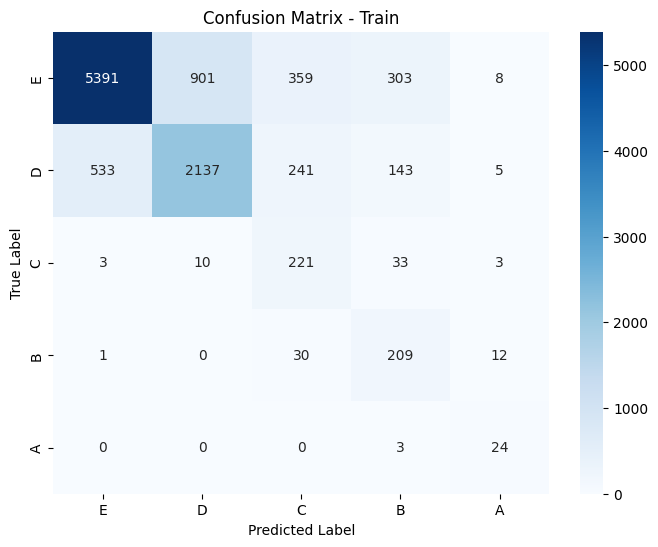

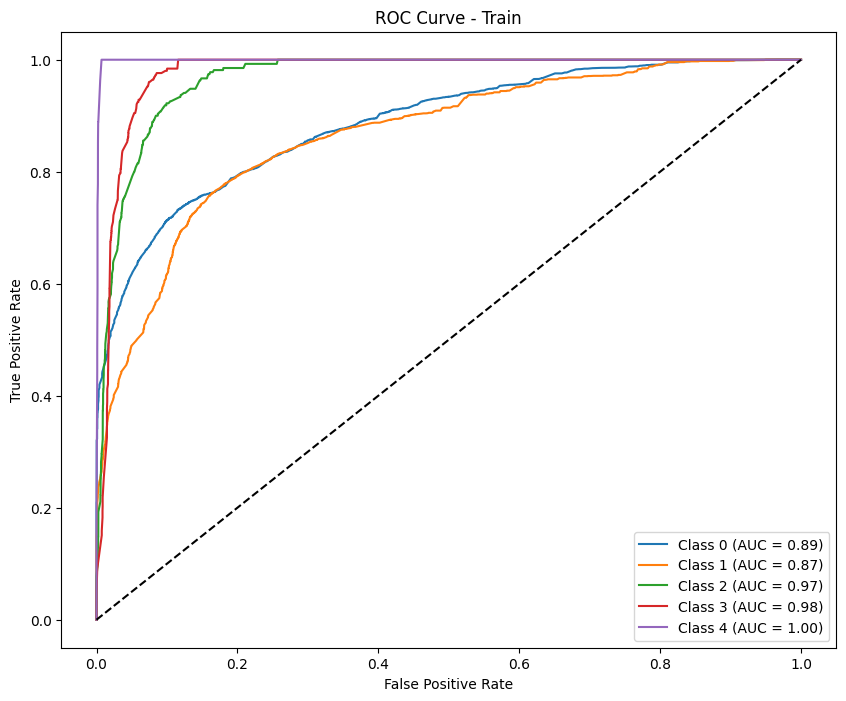

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.92111195 0.35555556 0.         0.         0.        ]
Precision (per class): [0.85734266 0.58536585 0.         0.         0.        ]
Recall (per class): [0.99512987 0.25531915 0.         0.         0.        ]
Accuracy: 0.8426
AUC (One-vs-Rest): 0.8404

Classification Report:
              precision    recall  f1-score   support

           E       0.86      1.00      0.92       616
           D       0.59      0.26      0.36        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.84       756
   macro avg       0.29      0.25      0.26       756
weighted avg       0.77      0.84      0.79       756



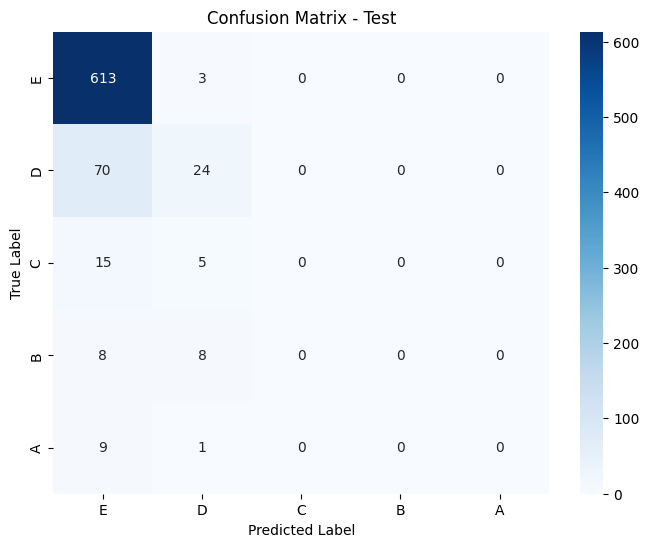

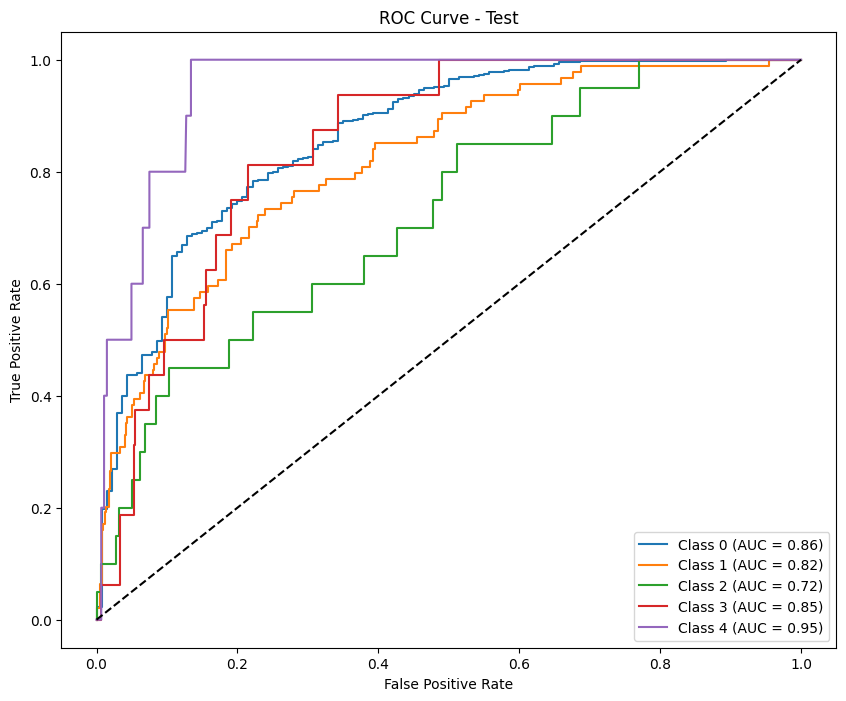

Results saved as test_results_calibrate_standard_f1_macro_phase1.csv
-------------Results for calibrate phase: phase1---------------

--- Train Metrics ---
F1 Score (per class): [0.86431886 0.65927766 0.4983165  0.51580699 0.6       ]
Precision (per class): [0.82340702 0.79346826 0.45679012 0.44412607 0.54545455]
Recall (per class): [0.90950876 0.56390977 0.54814815 0.61507937 0.66666667]
Accuracy: 0.7926
AUC (One-vs-Rest): 0.9470

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.91      0.86      6962
           D       0.79      0.56      0.66      3059
           C       0.46      0.55      0.50       270
           B       0.44      0.62      0.52       252
           A       0.55      0.67      0.60        27

    accuracy                           0.79     10570
   macro avg       0.61      0.66      0.63     10570
weighted avg       0.80      0.79      0.79     10570



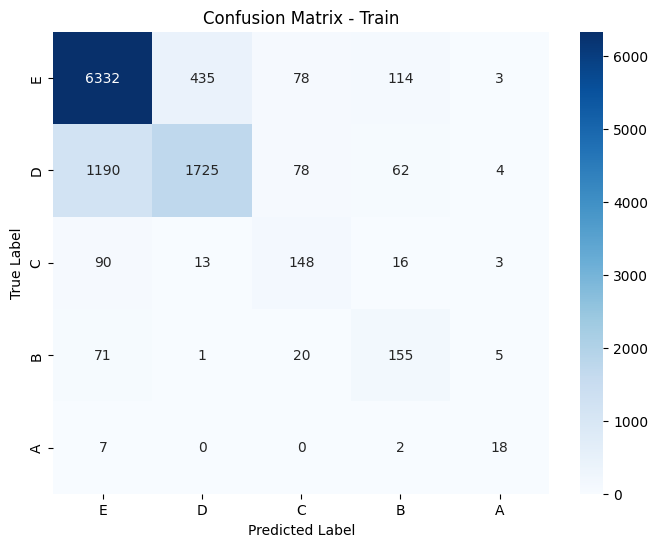

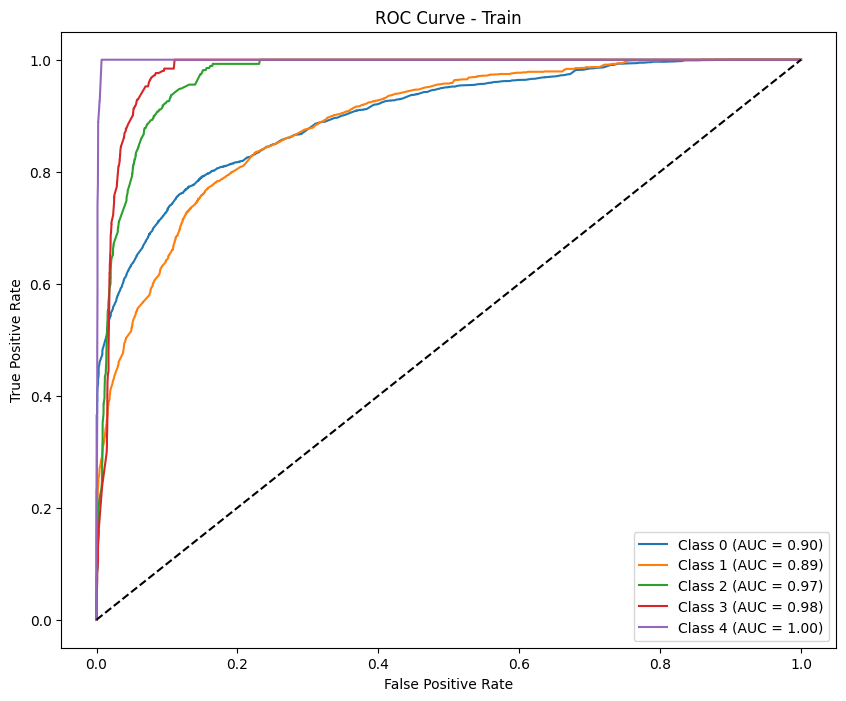

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.90707965 0.18181818 0.         0.         0.        ]
Precision (per class): [0.83108108 0.625      0.         0.         0.        ]
Recall (per class): [0.99837662 0.10638298 0.         0.         0.        ]
Accuracy: 0.8267
AUC (One-vs-Rest): 0.8357

Classification Report:
              precision    recall  f1-score   support

           E       0.83      1.00      0.91       616
           D       0.62      0.11      0.18        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.83       756
   macro avg       0.29      0.22      0.22       756
weighted avg       0.75      0.83      0.76       756



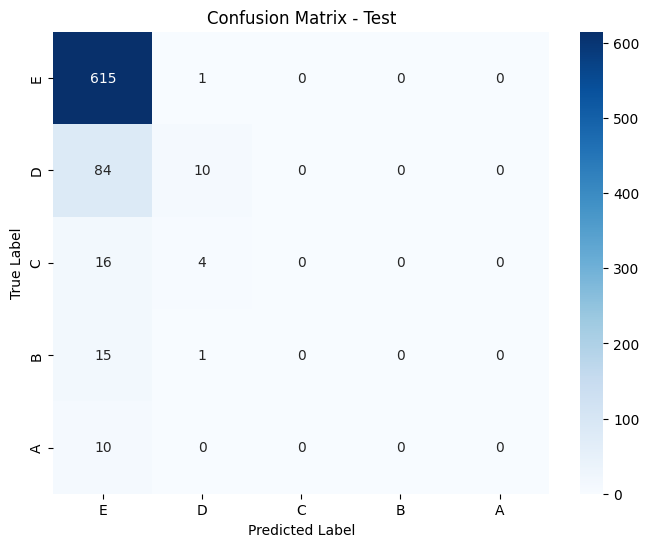

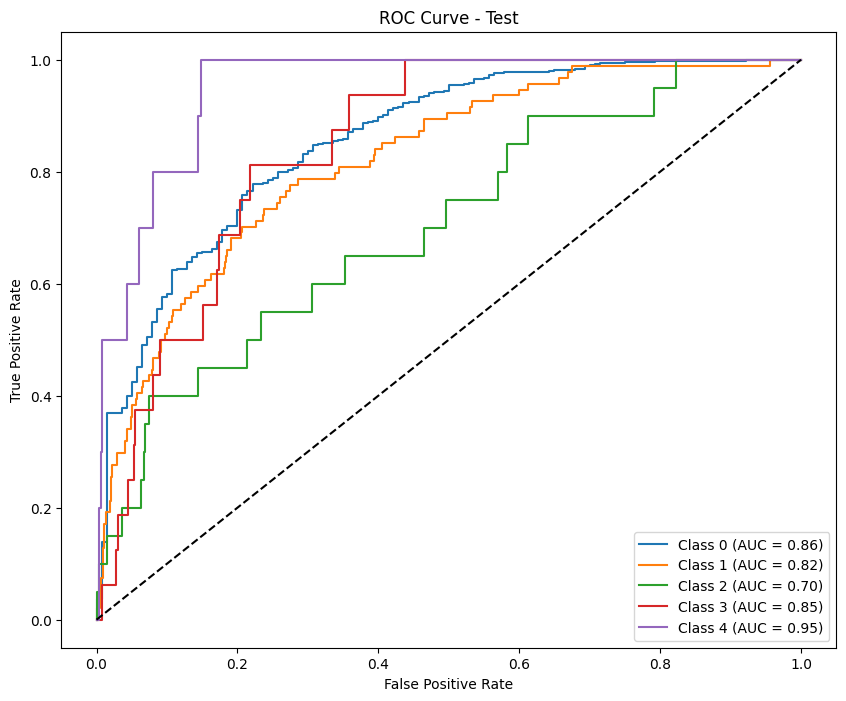


-------------Permutation Importance for phase: phase1---------


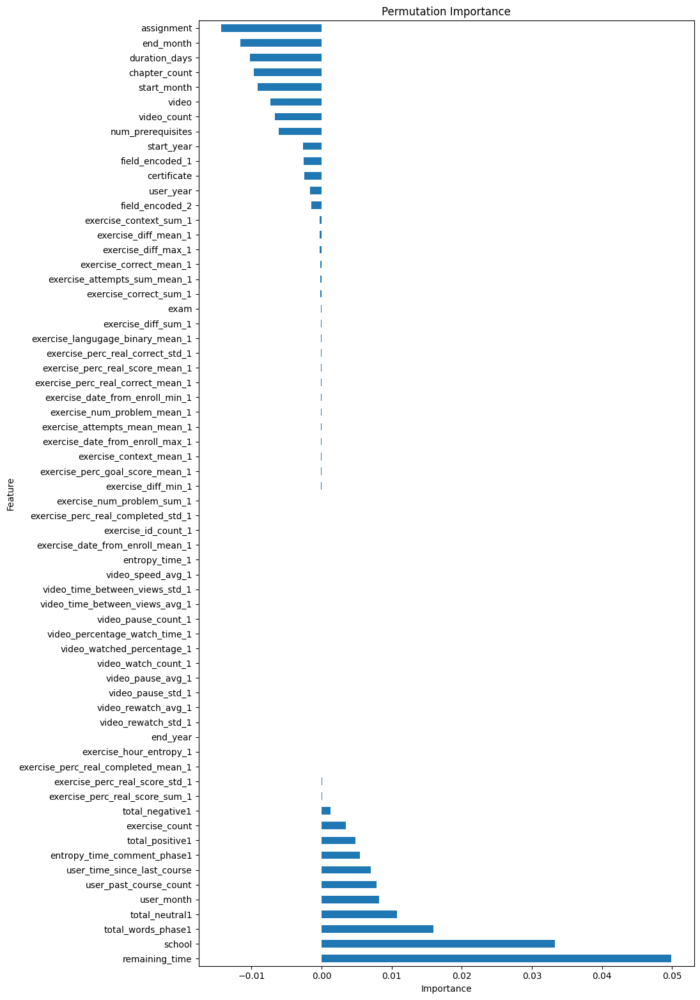

               Feature  Importance
20      remaining_time    0.049894
0               school    0.033243
60  total_words_phase1    0.015930
63      total_neutral1    0.010726
8           user_month    0.008243
..                 ...         ...
4          start_month   -0.009070
11       chapter_count   -0.009626
19       duration_days   -0.010241
6            end_month   -0.011613
16          assignment   -0.014333

[64 rows x 2 columns]

-----------SHAP Feature Importance for phase: phase1------------


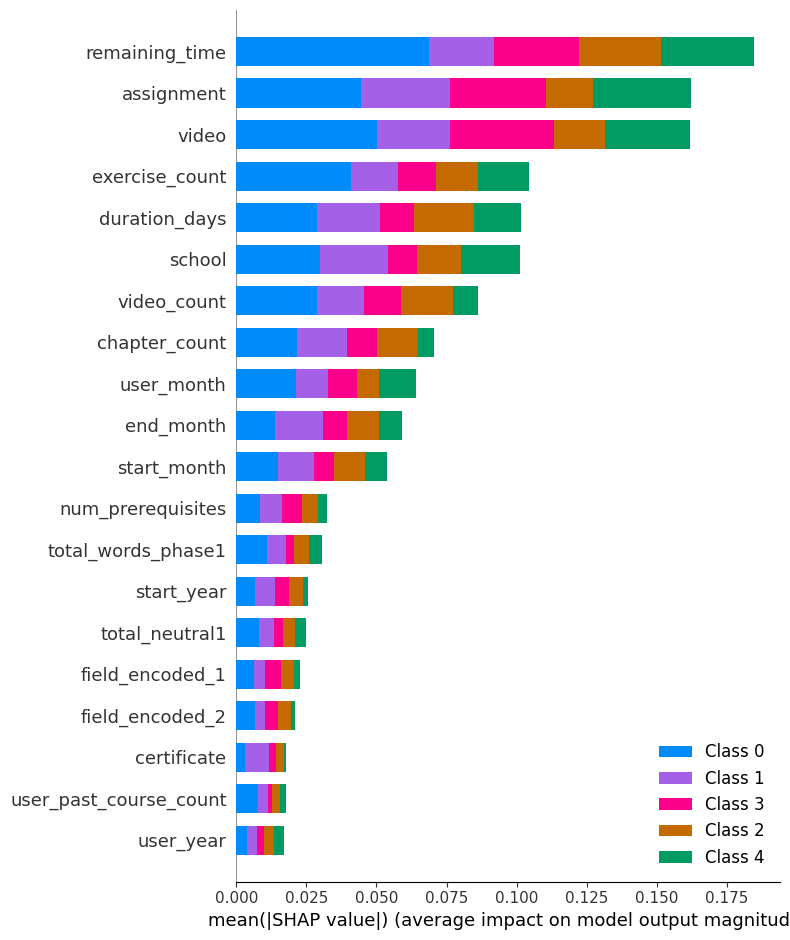


-----Lasso Feature Selection for phase: phase1----------


Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8626378950248181, tolerance: 0.38841890964995307
Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.0220066983251854, tolerance: 0.38841890964995307
Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.0369075504218017, tolerance: 0.38841890964995307
Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.0244889567061364, tolerance: 0.38841890964995307
Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.0036492193839877, tolerance: 0.38841890964995307
Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.6832867277125843, tolerance: 0.38841890964995307
Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8605425436494443, tolerance: 0.388

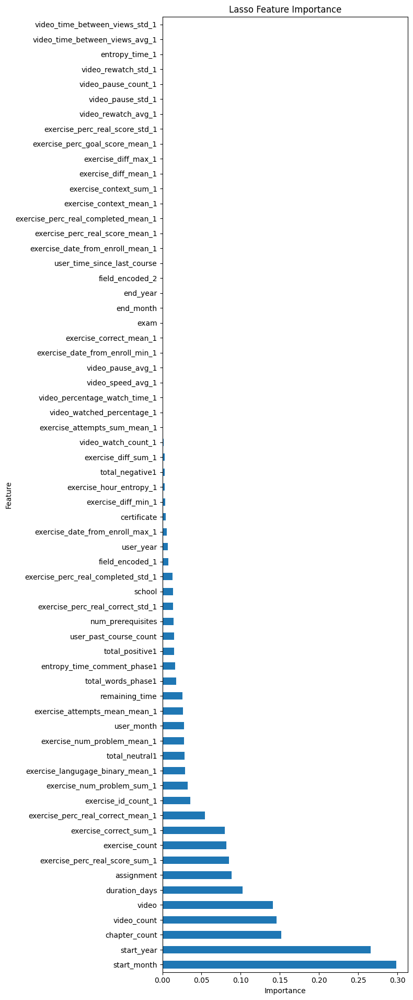

                           Feature  Importance
4                      start_month    0.298216
3                       start_year    0.265777
11                   chapter_count    0.151744
9                      video_count    0.145462
17                           video    0.141055
..                             ...         ...
51             video_pause_count_1    0.000000
55             video_rewatch_std_1    0.000000
59                  entropy_time_1    0.000000
56  video_time_between_views_avg_1    0.000000
57  video_time_between_views_std_1    0.000000

[64 rows x 2 columns]

----------Boruta Trick: phase1----------
Feature Importance (Including Random Feature):
                           Feature  Importance
64                  Random Feature    0.218377
20                  remaining_time    0.130986
17                           video    0.084413
16                      assignment    0.078718
0                           school    0.059450
..                             ...        

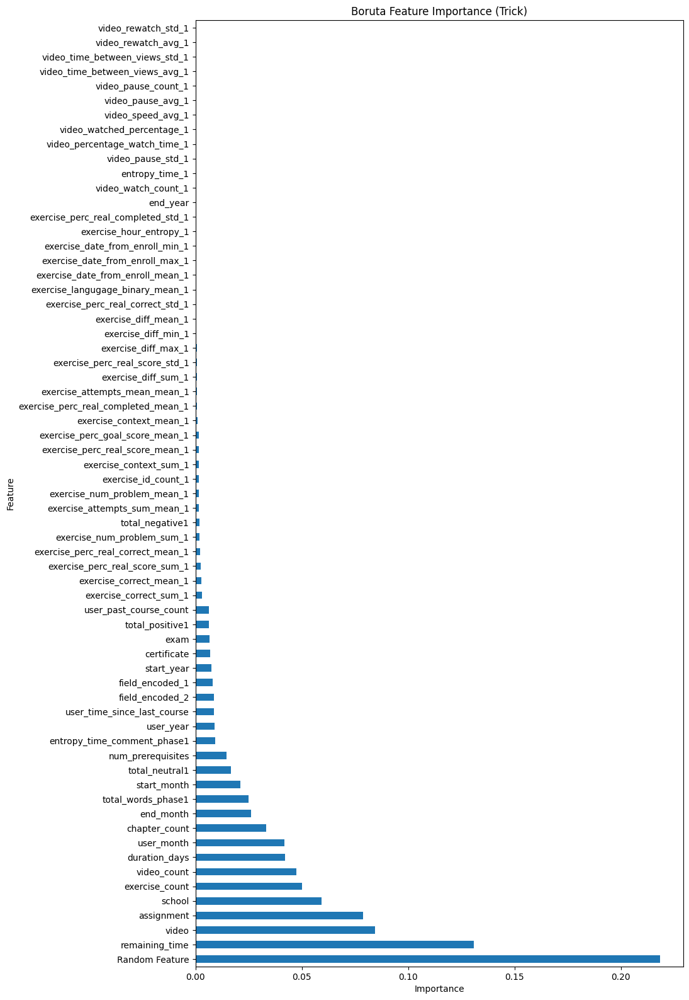

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None
Results saved as test_results_standard_f1_macro_phase2.csv
----------Results for phase: phase2--------------

--- Train Metrics ---
F1 Score (per class): [0.82252922 0.6659857  0.3875969  0.45330296 0.66666667]
Precision (per class): [0.89980977 0.66476346 0.26002972 0.30709877 0.52272727]
Recall (per class): [0.75747331 0.66721244 0.76086957 0.86521739 0.92      ]
Accuracy: 0.7351
AUC (One-vs-Rest): 0.9270

Classification Report:
              precision    recall  f1-score   support

           E       0.90      0.76      0.82      5620
           D       0.66      0.67      0.67      2443
           C       0.26      0.76      0.39       230
           B       0.31      0.87      0.45       230
           A       0.52      0.92      0.67        25

    accuracy                           0.74      

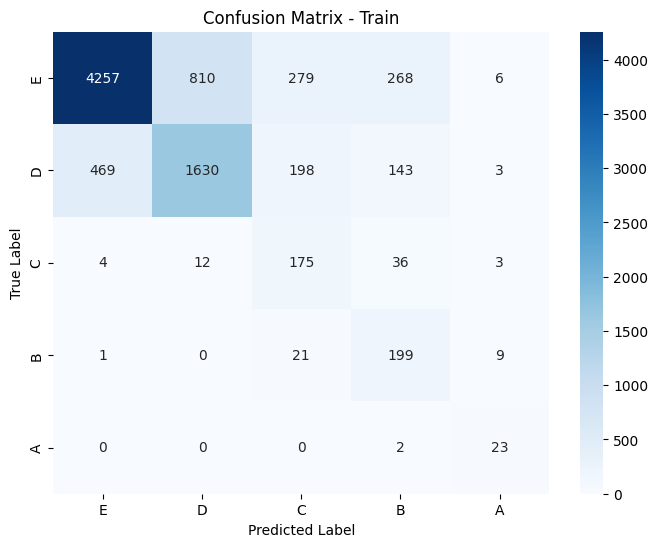

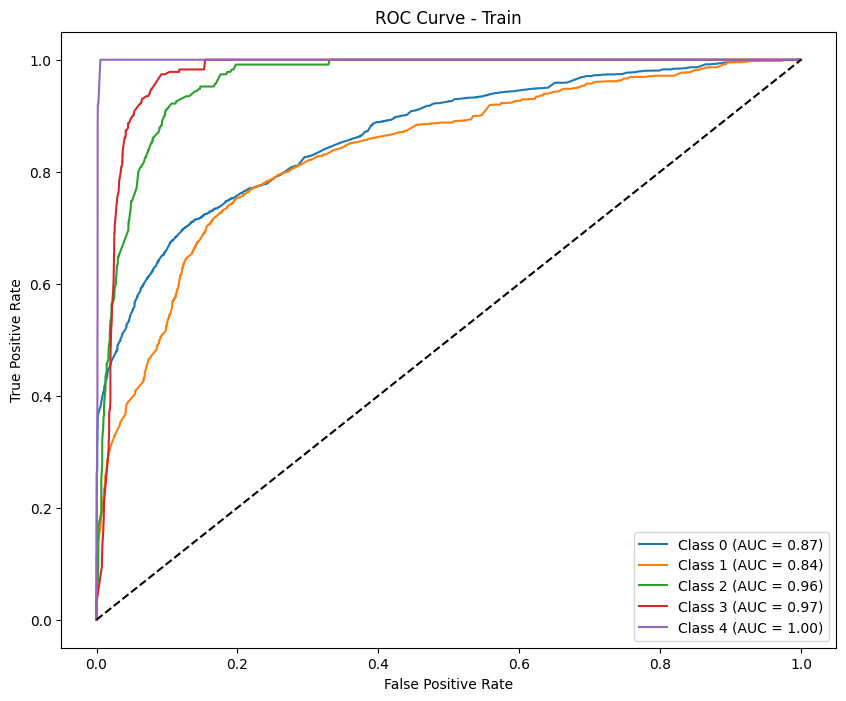


--- Test Metrics ---
F1 Score (per class): [0.90289103 0.06122449 0.         0.         0.        ]
Precision (per class): [0.82297297 0.5        0.         0.         0.        ]
Recall (per class): [1.        0.0326087 0.        0.        0.       ]
Accuracy: 0.8204
AUC (One-vs-Rest): 0.7475

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       609
           D       0.50      0.03      0.06        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.82       746
   macro avg       0.26      0.21      0.19       746
weighted avg       0.73      0.82      0.74       746



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


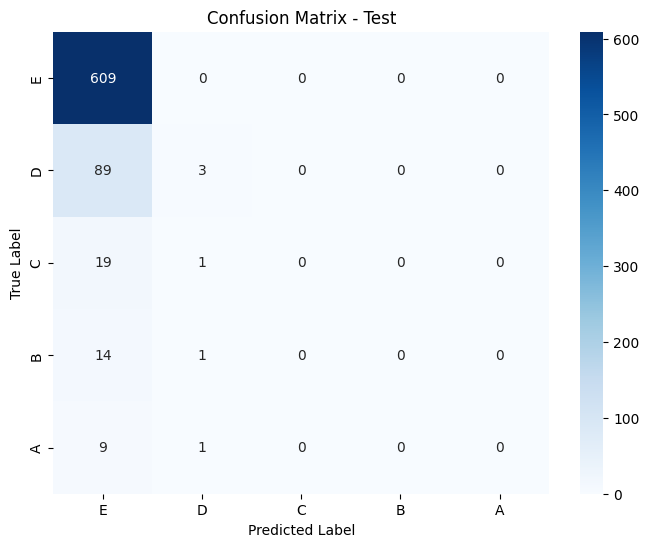

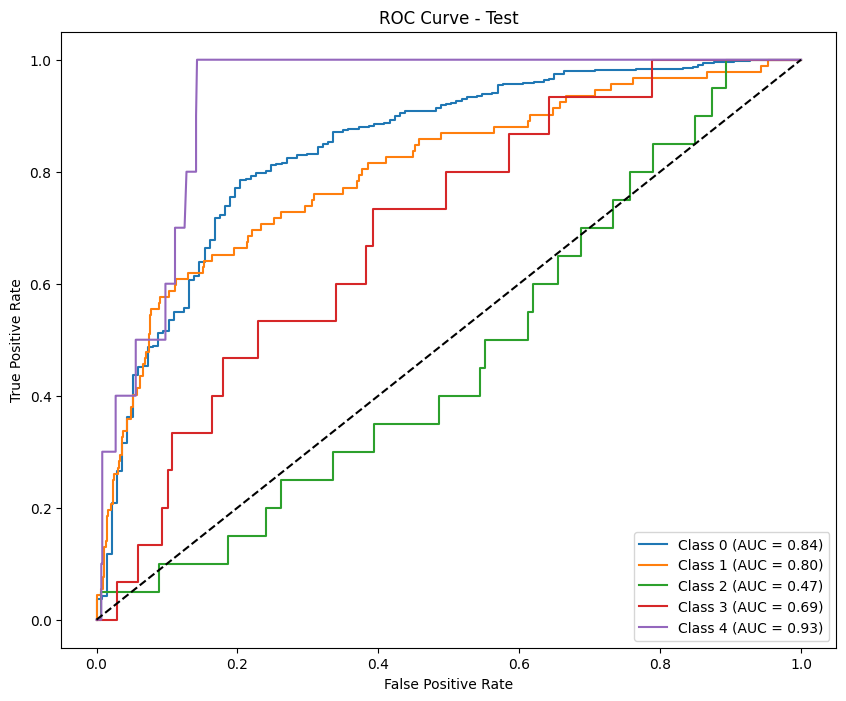

Results saved as test_results_calibrate_standard_f1_macro_phase2.csv
-------------Results for calibrate phase: phase2---------------

--- Train Metrics ---
F1 Score (per class): [0.84368345 0.62035088 0.46186441 0.49640288 0.59259259]
Precision (per class): [0.80928256 0.72379913 0.45041322 0.42331288 0.55172414]
Recall (per class): [0.88113879 0.54277528 0.47391304 0.6        0.64      ]
Accuracy: 0.7652
AUC (One-vs-Rest): 0.9369

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.88      0.84      5620
           D       0.72      0.54      0.62      2443
           C       0.45      0.47      0.46       230
           B       0.42      0.60      0.50       230
           A       0.55      0.64      0.59        25

    accuracy                           0.77      8548
   macro avg       0.59      0.63      0.60      8548
weighted avg       0.76      0.77      0.76      8548



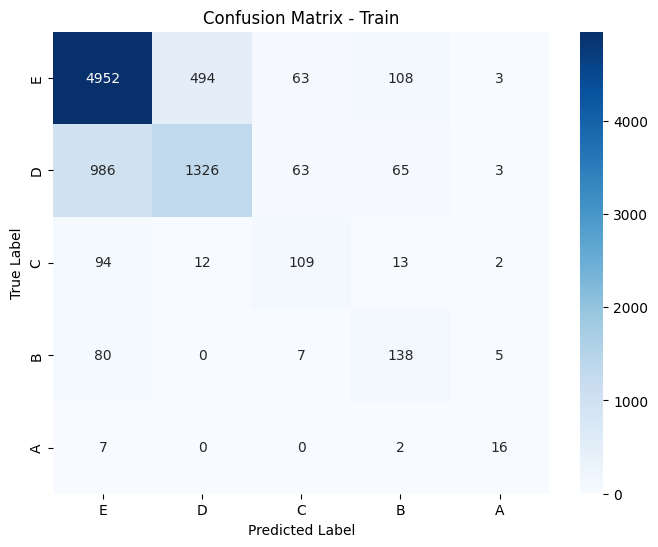

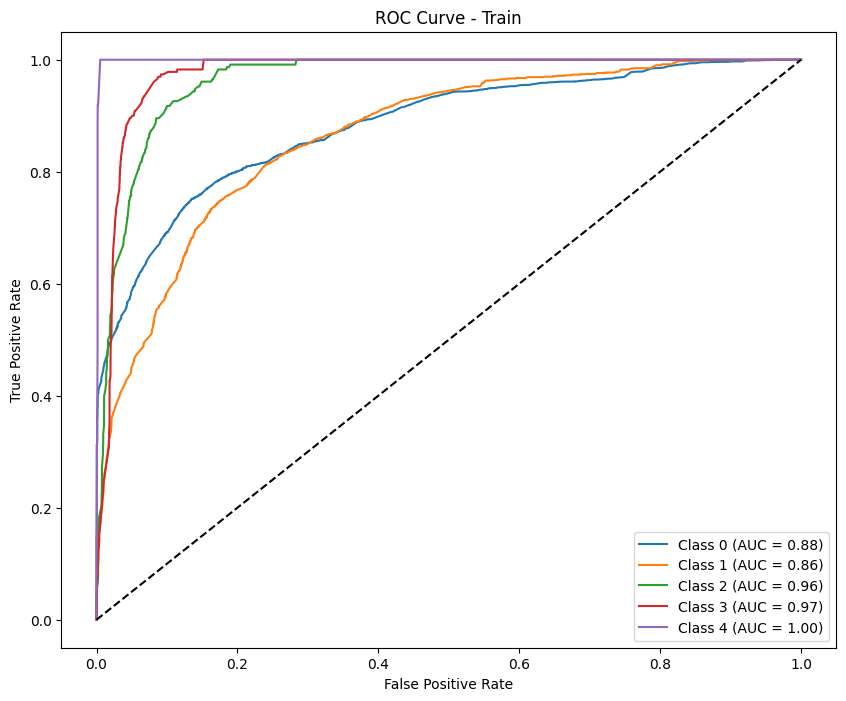


--- Test Metrics ---
F1 Score (per class): [0.89889299 0.         0.         0.         0.        ]
Precision (per class): [0.81635389 0.         0.         0.         0.        ]
Recall (per class): [1. 0. 0. 0. 0.]
Accuracy: 0.8164
AUC (One-vs-Rest): 0.7384

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       609
           D       0.00      0.00      0.00        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.82       746
   macro avg       0.16      0.20      0.18       746
weighted avg       0.67      0.82      0.73       746



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


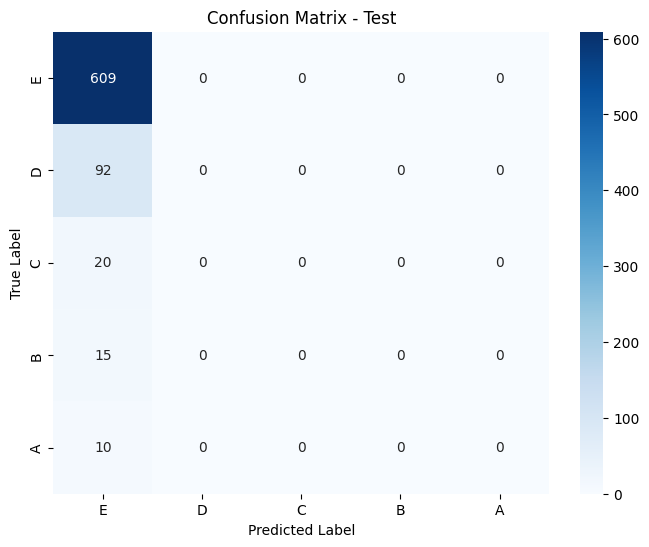

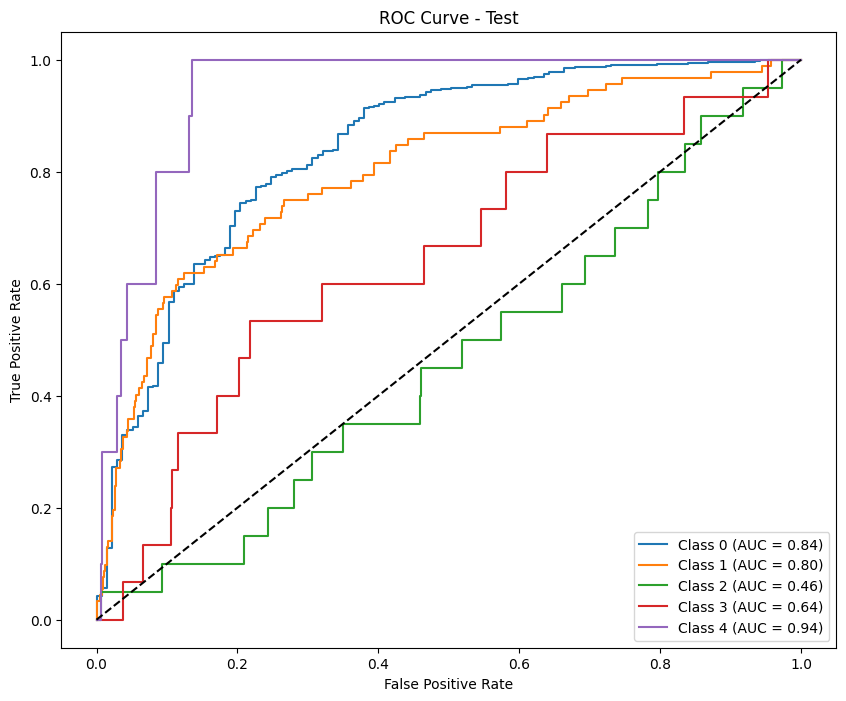


-------------Permutation Importance for phase: phase2---------


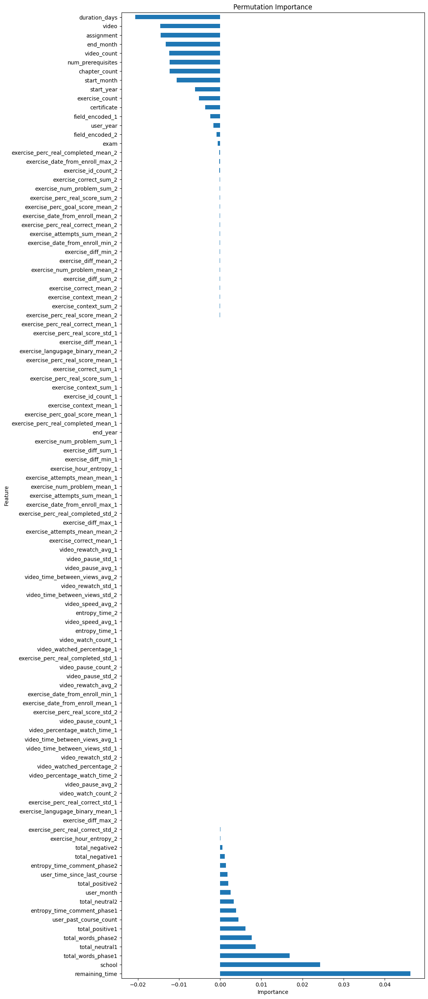

                Feature  Importance
20       remaining_time    0.046268
0                school    0.024260
60   total_words_phase1    0.016875
63       total_neutral1    0.008584
103  total_words_phase2    0.007663
..                  ...         ...
9           video_count   -0.012371
6             end_month   -0.013249
16           assignment   -0.014462
17                video   -0.014521
19        duration_days   -0.020648

[107 rows x 2 columns]

-----------SHAP Feature Importance for phase: phase2------------


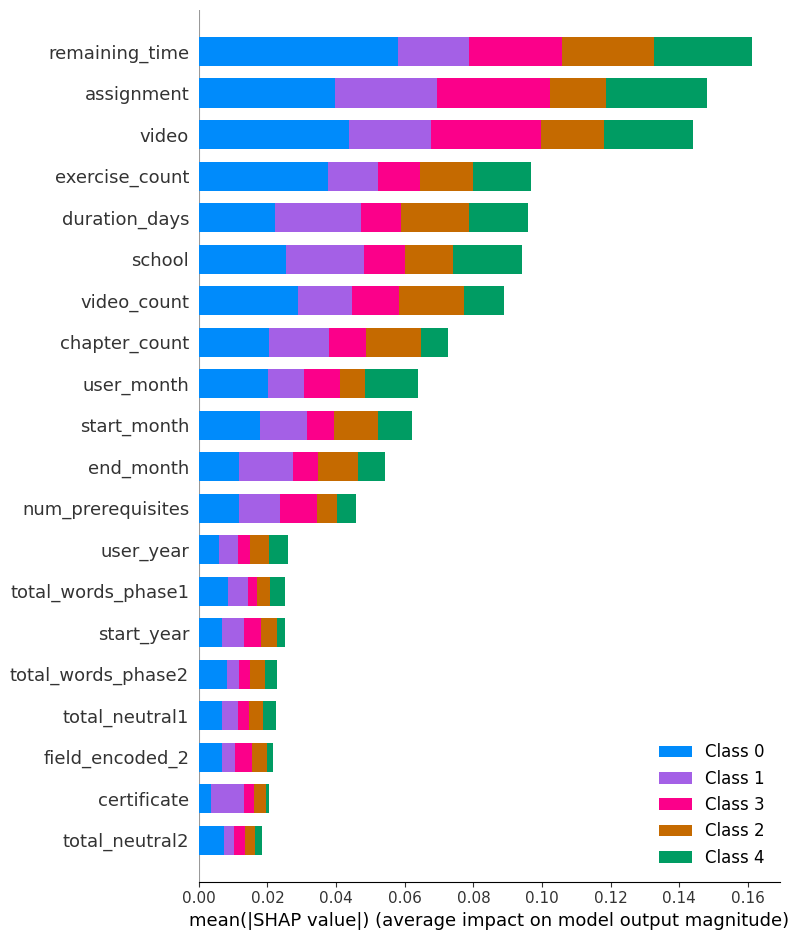


-----Lasso Feature Selection for phase: phase2----------


Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.3597667214262401, tolerance: 0.3280285609827438
Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.6821299358962278, tolerance: 0.3280285609827438
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.201722082730157, tolerance: 0.3280285609827438
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3476406712161406, tolerance: 0.3280285609827438
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.37839705040642, tolerance: 0.3280285609827438
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.374100164331594, tolerance: 0.3280285609827438
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3576103359796434, tolerance: 0.3280285609827

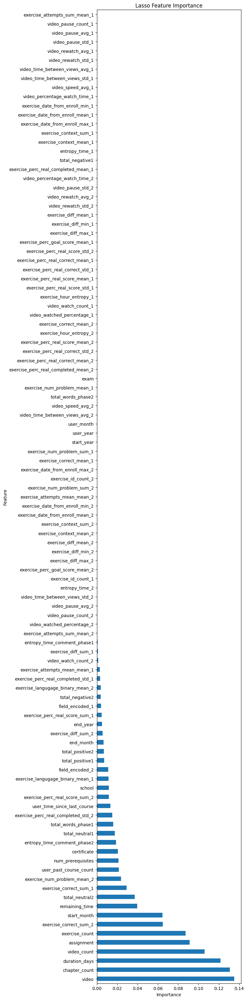

                         Feature  Importance
17                         video    0.135128
11                 chapter_count    0.130991
19                 duration_days    0.121659
9                    video_count    0.105890
16                    assignment    0.091239
..                           ...         ...
54           video_rewatch_avg_1    0.000000
53             video_pause_std_1    0.000000
52             video_pause_avg_1    0.000000
51           video_pause_count_1    0.000000
27  exercise_attempts_sum_mean_1    0.000000

[107 rows x 2 columns]

----------Boruta Trick: phase2----------
Feature Importance (Including Random Feature):
                            Feature  Importance
107                  Random Feature    0.191712
20                   remaining_time    0.123637
17                            video    0.080552
16                       assignment    0.077790
0                            school    0.063508
..                              ...         ...
56   video_

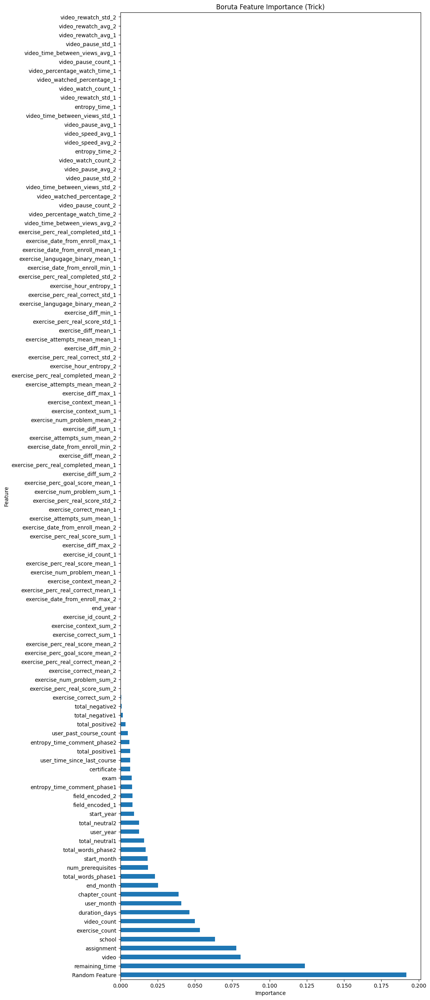

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None
Results saved as test_results_standard_f1_macro_phase3.csv
----------Results for phase: phase3--------------

--- Train Metrics ---
F1 Score (per class): [0.8257209  0.67008014 0.37662338 0.45547074 0.60714286]
Precision (per class): [0.89607127 0.67428315 0.25129983 0.30915371 0.45945946]
Recall (per class): [0.7656128  0.6659292  0.75129534 0.8647343  0.89473684]
Accuracy: 0.7393
AUC (One-vs-Rest): 0.9280

Classification Report:
              precision    recall  f1-score   support

           E       0.90      0.77      0.83      5124
           D       0.67      0.67      0.67      2260
           C       0.25      0.75      0.38       193
           B       0.31      0.86      0.46       207
           A       0.46      0.89      0.61        19

    accuracy                           0.74      

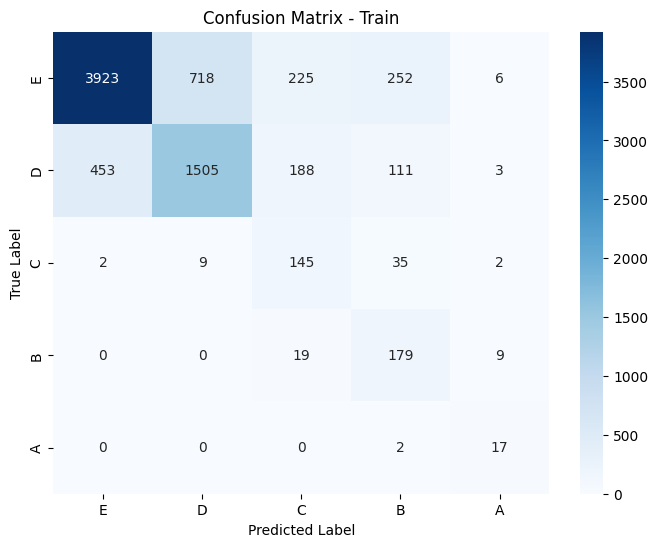

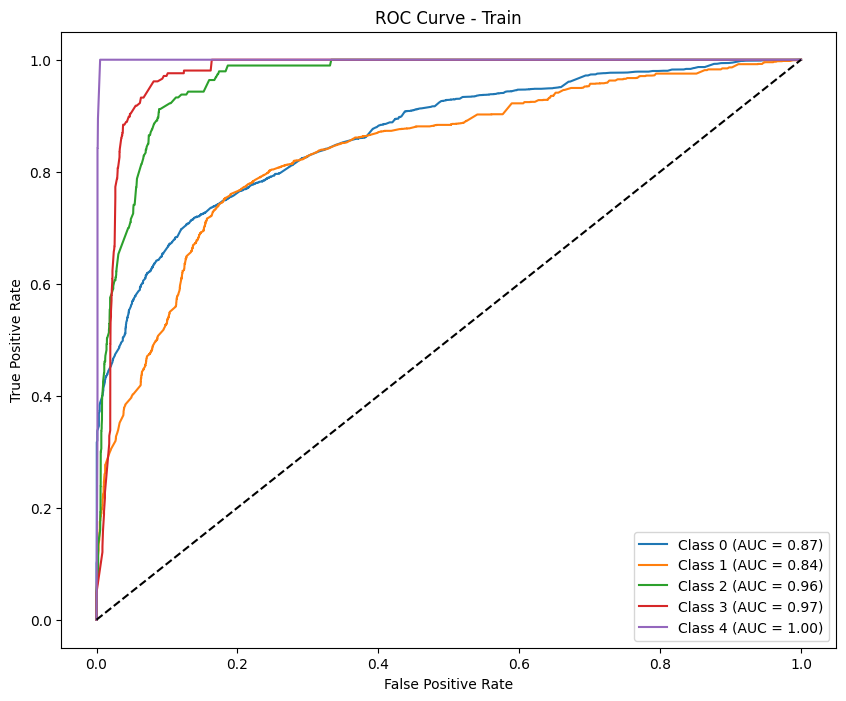


--- Test Metrics ---
F1 Score (per class): [0.89586524 0.         0.         0.         0.        ]
Precision (per class): [0.81476323 0.         0.         0.         0.        ]
Recall (per class): [0.99489796 0.         0.         0.         0.        ]
Accuracy: 0.8114
AUC (One-vs-Rest): 0.6306

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.99      0.90       588
           D       0.00      0.00      0.00        87
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.81       721
   macro avg       0.16      0.20      0.18       721
weighted avg       0.66      0.81      0.73       721



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


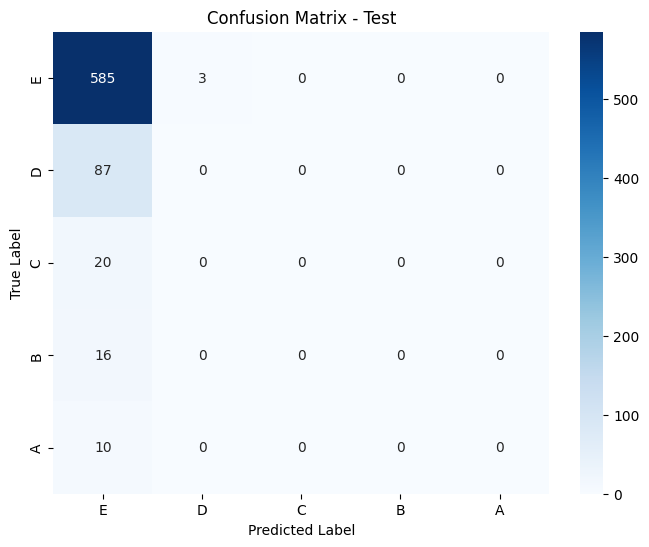

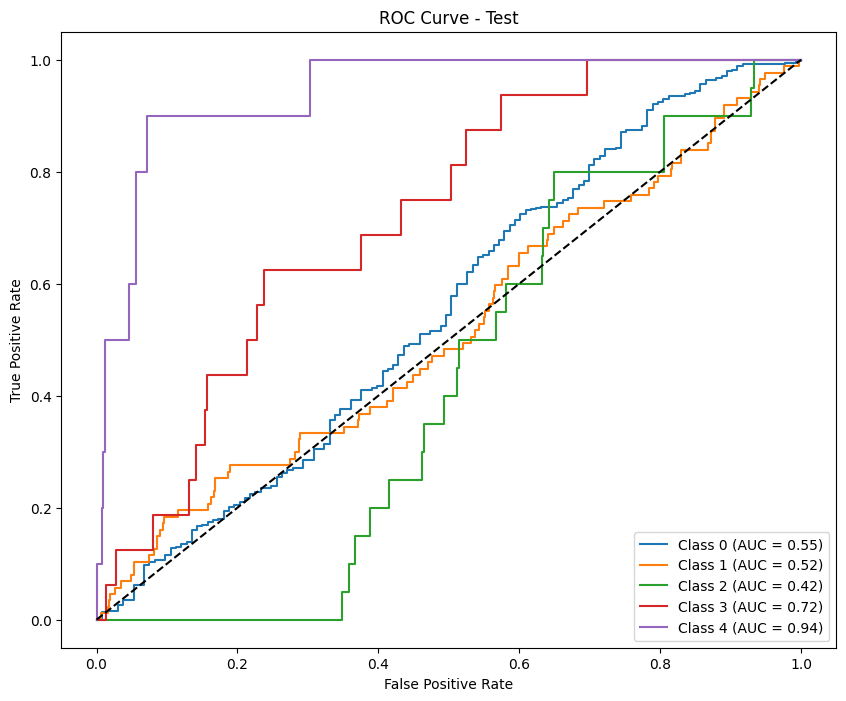

Results saved as test_results_calibrate_standard_f1_macro_phase3.csv
-------------Results for calibrate phase: phase3---------------

--- Train Metrics ---
F1 Score (per class): [0.84631893 0.6342814  0.47570332 0.4679089  0.57142857]
Precision (per class): [0.81083497 0.73555166 0.46969697 0.40942029 0.52173913]
Recall (per class): [0.88505074 0.55752212 0.48186528 0.54589372 0.63157895]
Accuracy: 0.7706
AUC (One-vs-Rest): 0.9389

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.89      0.85      5124
           D       0.74      0.56      0.63      2260
           C       0.47      0.48      0.48       193
           B       0.41      0.55      0.47       207
           A       0.52      0.63      0.57        19

    accuracy                           0.77      7803
   macro avg       0.59      0.62      0.60      7803
weighted avg       0.77      0.77      0.77      7803



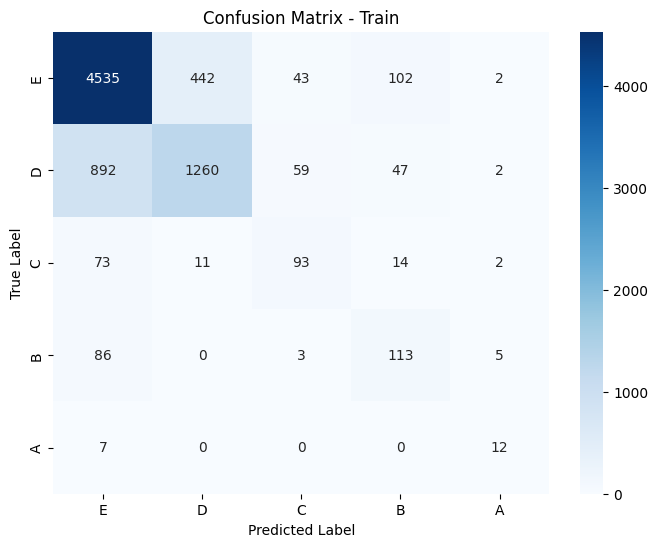

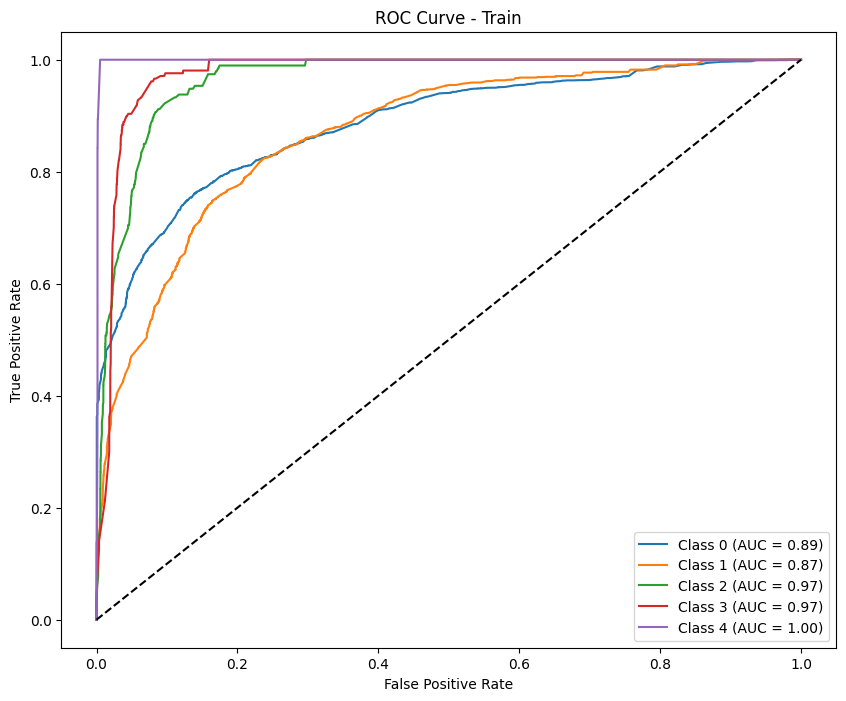

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.89839572 0.         0.         0.         0.        ]
Precision (per class): [0.81553398 0.         0.         0.         0.        ]
Recall (per class): [1. 0. 0. 0. 0.]
Accuracy: 0.8155
AUC (One-vs-Rest): 0.6323

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       588
           D       0.00      0.00      0.00        87
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.82       721
   macro avg       0.16      0.20      0.18       721
weighted avg       0.67      0.82      0.73       721



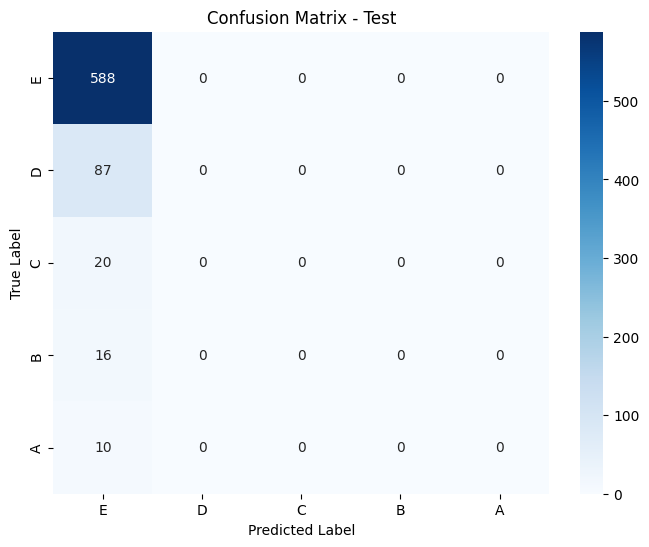

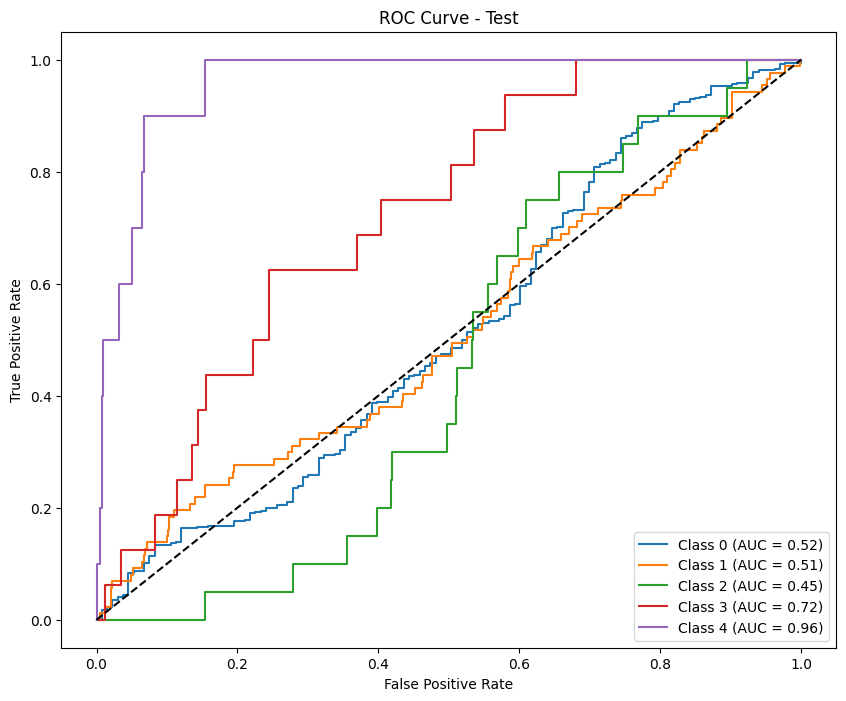

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None
Results saved as test_results_standard_f1_macro_phase4.csv
----------Results for phase: phase4--------------

--- Train Metrics ---
F1 Score (per class): [0.82155614 0.69517685 0.27892235 0.53892216 0.62222222]
Precision (per class): [0.9021146  0.70746073 0.16603774 0.39473684 0.4516129 ]
Recall (per class): [0.75420587 0.68331226 0.87128713 0.8490566  1.        ]
Accuracy: 0.7390
AUC (One-vs-Rest): 0.9326

Classification Report:
              precision    recall  f1-score   support

           E       0.90      0.75      0.82      3507
           D       0.71      0.68      0.70      1582
           C       0.17      0.87      0.28       101
           B       0.39      0.85      0.54       159
           A       0.45      1.00      0.62        14

    accuracy                           0.74      

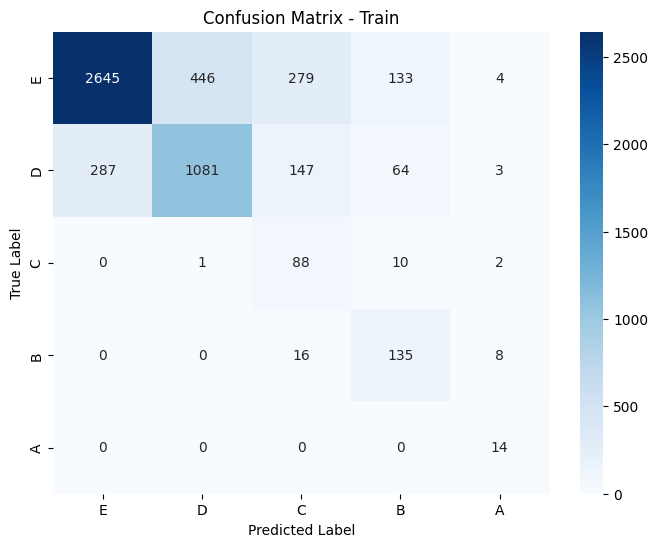

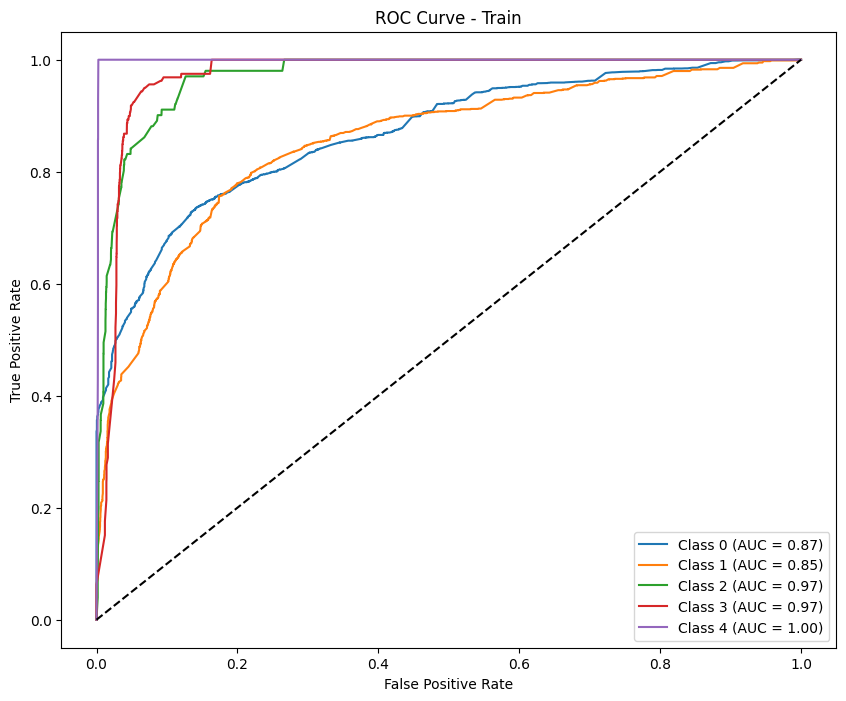


--- Test Metrics ---
F1 Score (per class): [0.88996764 0.         0.         0.         0.        ]
Precision (per class): [0.80763583 0.         0.         0.         0.        ]
Recall (per class): [0.99099099 0.         0.         0.         0.        ]
Accuracy: 0.8006
AUC (One-vs-Rest): 0.5851

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.99      0.89       555
           D       0.00      0.00      0.00        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.80       687
   macro avg       0.16      0.20      0.18       687
weighted avg       0.65      0.80      0.72       687



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


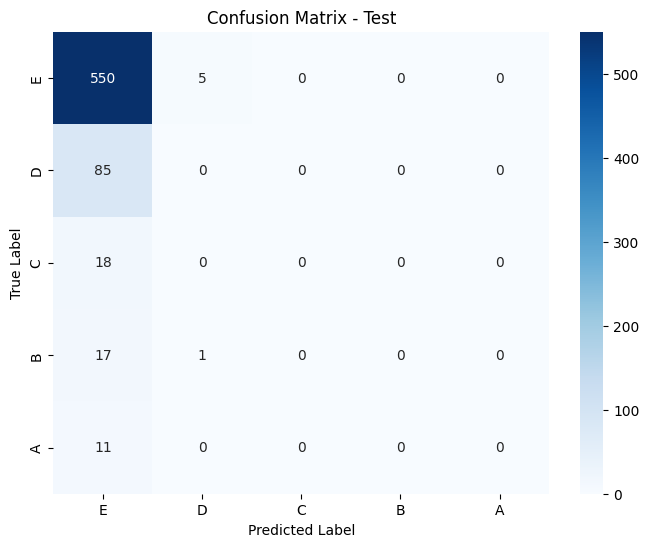

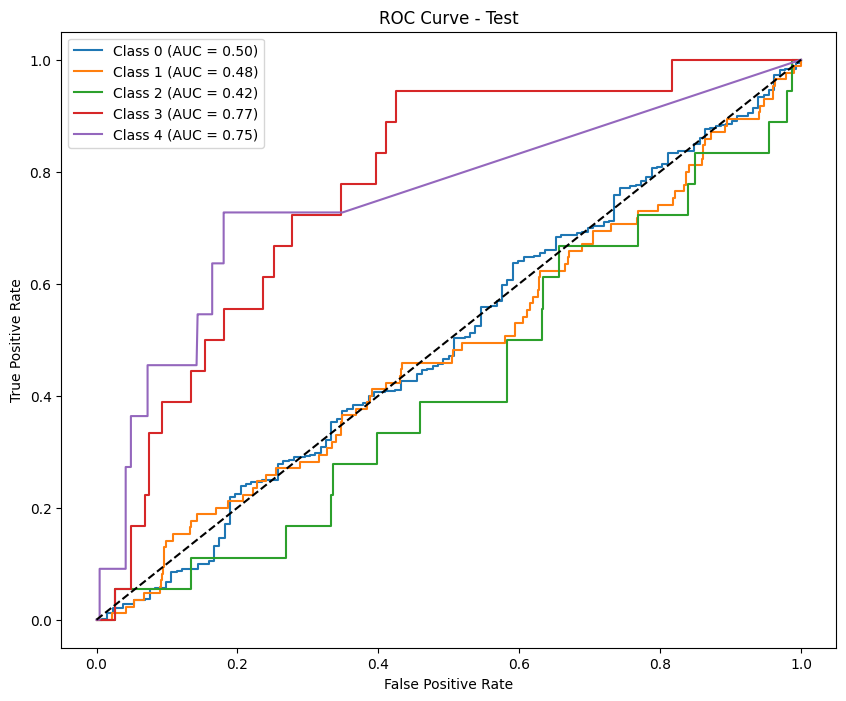

Results saved as test_results_calibrate_standard_f1_macro_phase4.csv
-------------Results for calibrate phase: phase4---------------

--- Train Metrics ---
F1 Score (per class): [0.85485209 0.66357474 0.5        0.52830189 0.48484848]
Precision (per class): [0.82962168 0.76167076 0.44274809 0.42264151 0.42105263]
Recall (per class): [0.88166524 0.58786346 0.57425743 0.70440252 0.57142857]
Accuracy: 0.7831
AUC (One-vs-Rest): 0.9427

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.88      0.85      3507
           D       0.76      0.59      0.66      1582
           C       0.44      0.57      0.50       101
           B       0.42      0.70      0.53       159
           A       0.42      0.57      0.48        14

    accuracy                           0.78      5363
   macro avg       0.58      0.66      0.61      5363
weighted avg       0.79      0.78      0.78      5363



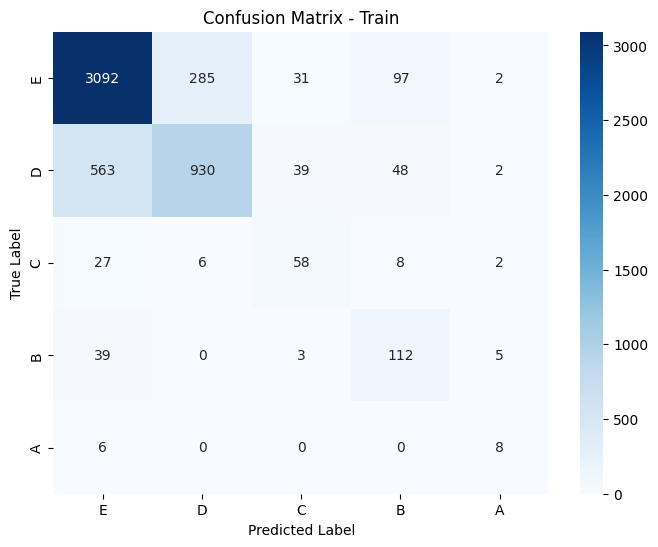

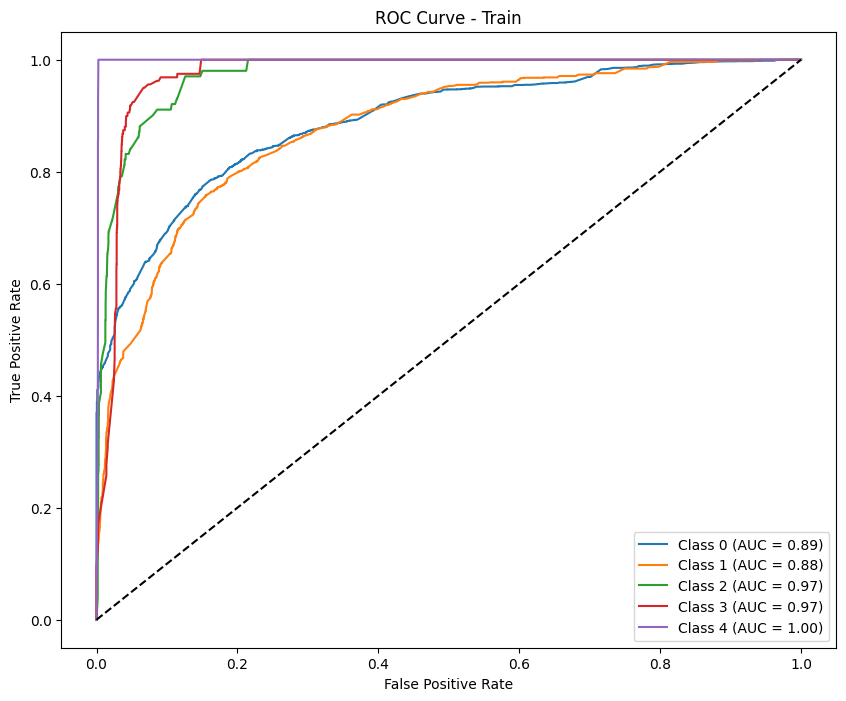


--- Test Metrics ---
F1 Score (per class): [0.89282836 0.         0.         0.         0.        ]
Precision (per class): [0.80758017 0.         0.         0.         0.        ]
Recall (per class): [0.9981982 0.        0.        0.        0.       ]
Accuracy: 0.8064
AUC (One-vs-Rest): 0.6124

Classification Report:
              precision    recall  f1-score   support

           E       0.81      1.00      0.89       555
           D       0.00      0.00      0.00        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.81       687
   macro avg       0.16      0.20      0.18       687
weighted avg       0.65      0.81      0.72       687



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


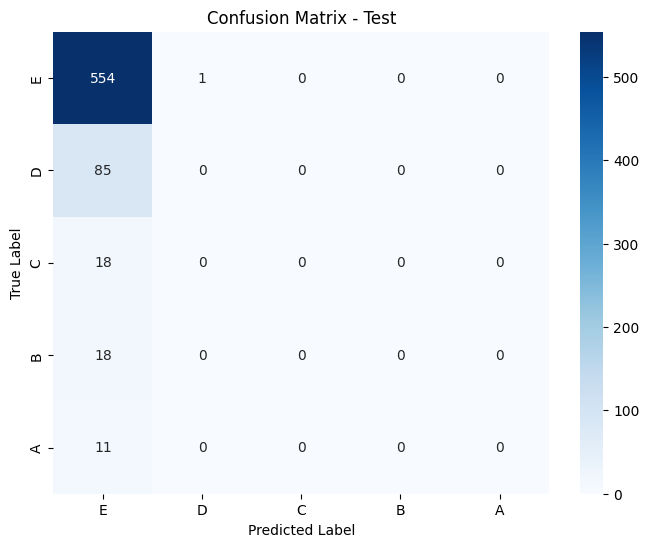

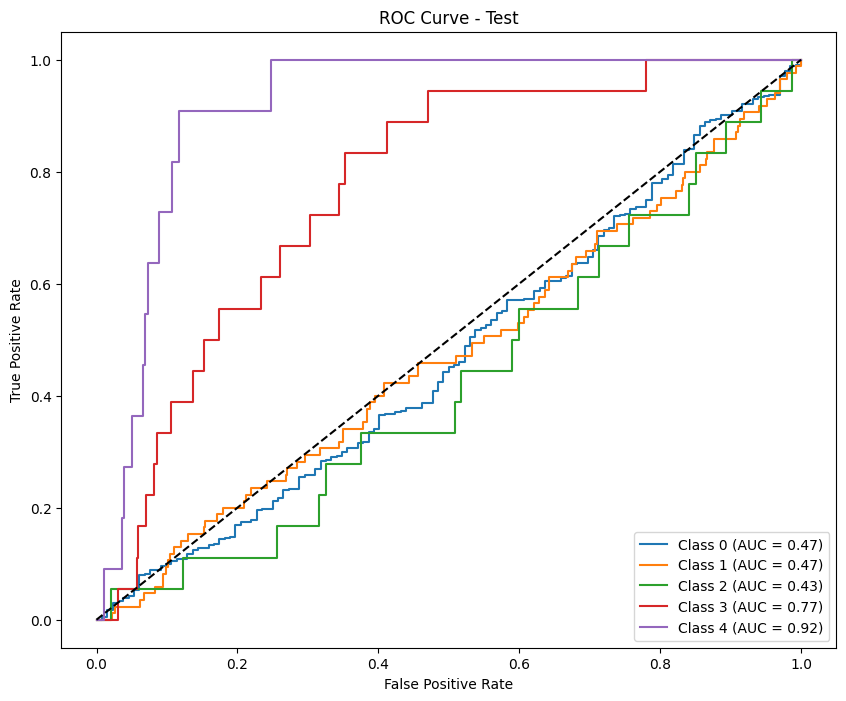

In [14]:
hyperparams = {
    "phase1": hp_1,
    "phase2": hp_2,
    "phase3": hp_3,
    "phase4": hp_4
}

for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_phase(phase, metric='f1_macro', hyper=hyperparams[phase])

## Xử lý imbalance

### Phân phối các nhãn

In [15]:
# Đọc dữ liệu
def plot_label(phase):
    # Đọc dữ liệu từ các file CSV
    phase_ = phase[:-1] + '_' + phase[-1]
    X_train = pd.read_csv(f"/kaggle/input/final-data/{phase}/user_train_{phase_}_train.csv")
    X_test = pd.read_csv(f"/kaggle/input/final-data/{phase}/user_train_{phase_}_test.csv")

    count_map = X_train['school'].value_counts().to_dict()
    X_train['school'] = X_train['school'].map(count_map)
    X_test['school'] = X_test['school'].map(count_map)

    # Fill nan = 0
    X_train = X_train.fillna(0)
    X_test = X_test.fillna(0)
    
    # Loại bỏ các cột không cần thiết trong X
    columns_to_drop = ['course_id', 'user_id', 'total_score', 'label']
    X_train = X_train.drop(columns=columns_to_drop, axis=1)
    X_test = X_test.drop(columns=columns_to_drop, axis=1)
    
    # Lấy nhãn (target) từ cột 'label_encoded'
    y_train = X_train.pop("label_encoded")
    y_test = X_test.pop("label_encoded")

    # Đếm số lượng mỗi class
    value_counts = y_train.value_counts()
    print(value_counts)
    
    # Vẽ biểu đồ
    value_counts.plot(kind='bar', figsize=(8, 6), color='skyblue', edgecolor='black')
    
    # Thêm tiêu đề và nhãn trục
    plt.title(f"Distribution of y_train labels in {phase}")
    plt.xlabel("Class")
    plt.ylabel("Count")
    
    # Hiển thị
    plt.show()
    
    return X_train, y_train, X_test, y_test

In [16]:
# Lặp qua các phase
# for phase in ["phase1", "phase2", "phase3", "phase4"]:
#     plot_label(phase)

### Undersampling

In [17]:
import pandas as pd

def manual_custom_undersample_decrease(X, y, class_decrease_counts):
    """
    Undersample bằng cách giảm bớt một số lượng mẫu xác định cho từng class.

    Args:
        X (pd.DataFrame): Features.
        y (pd.Series): Labels.
        class_decrease_counts (dict): Dict {class_label: decrease_number}.

    Returns:
        (X_resampled, y_resampled): Dữ liệu sau undersample.
    """
    df = pd.concat([X, y], axis=1)
    resampled_parts = []

    for cls in y.unique():
        df_cls = df[df[y.name] == cls]
        if cls in class_decrease_counts:
            decrease_count = class_decrease_counts[cls]
            target_count = max(len(df_cls) - decrease_count, 1)  # Đảm bảo ít nhất còn 1 mẫu
            if len(df_cls) > target_count:
                df_cls = df_cls.sample(n=target_count, random_state=42)
        # Nếu class không cần giảm thì giữ nguyên
        resampled_parts.append(df_cls)

    df_resampled = pd.concat(resampled_parts).sample(frac=1, random_state=42)  # shuffle
    X_resampled = df_resampled.drop(columns=[y.name])
    y_resampled = df_resampled[y.name]

    return X_resampled, y_resampled


In [18]:
# Đọc và xử lý dữ liệu cho từng phase
def process_undersample_phase(phase, hyper, scale='standard', metric='accuracy'):
    # Đọc dữ liệu
    X_train, y_train, X_test, y_test = load_data(phase)
    # Undersampling
    cls_count = {
        0: 2000,
        1: 1000,
        2: 0,
        3: 0,
        4: 0
    }
    X_train, y_train = manual_custom_undersample_decrease(X_train, y_train, cls_count)
    # Scale dữ liệu
    X_train_scaled, X_test_scaled = scale_data(X_train, X_test, scaler_type=scale)
    X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)
    X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns)
    # Thiết lập StratifiedKFold
    # skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    
    # # Định nghĩa mô hình XGBoost
    # model = XGBClassifier(random_state=42)
    
    # Định nghĩa các tham số cần tìm kiếm (cho GridSearchCV hoặc RandomizedSearchCV)
    # param_grid = {
    #     'max_depth': [7, 9],
    #     'learning_rate': [0.02, 0.1],
    #     'n_estimators': [200],
    #     'subsample': [0.7, 0.8],
    #     'colsample_bytree': [0.7, 0.8, 0.9]
    # }
    
    # Sử dụng GridSearchCV hoặc RandomizedSearchCV
    # GridSearchCV: Thử tất cả các kết hợp tham số
    # grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=skf, scoring='accuracy', n_jobs=-1)
    
    # RandomizedSearchCV: Thử ngẫu nhiên một số lượng tham số
    # randomized_search = RandomizedSearchCV(
    #     estimator=model,
    #     param_distributions=param_grid,
    #     n_iter=35,
    #     cv=skf,
    #     scoring=metric,
    #     random_state=42,
    #     n_jobs=-1,
    #     verbose=2 
    # )
    
    # # Huấn luyện mô hình với RandomizedSearchCV
    # randomized_search.fit(X_train_scaled, y_train)
    
    # # In ra tham số tốt nhất
    # print(f"Best Parameters for phase {phase}: {randomized_search.best_params_}")
    # best_params = randomized_search.best_params_

    # # Dự đoán trên tập test
    # y_pred = randomized_search.best_estimator_.predict(X_test_scaled)
    
    # Huấn luyện mô hình
    model = RandomForestClassifier(**hyper, random_state=42, class_weight='balanced')
    model.fit(X_train_scaled, y_train)
    
    # Dự đoán
    y_pred = model.predict(X_test_scaled)
    
    # Tạo DataFrame chứa dữ liệu test và nhãn dự đoán
    results_df = X_test.copy()
    results_df['True_Label'] = y_test
    results_df['Predicted_Label'] = y_pred
    
    # Lưu kết quả dự đoán
    results_filename = f"test_results_undersample_{scale}_{metric}_{phase}.csv"
    results_df.to_csv(results_filename, index=False)
    print(f"Results saved as {results_filename}")
    
    # Đánh giá mô hình
    print(f"Results for phase: {phase}")
    evaluate_model(model, X_train_scaled, y_train, X_test_scaled, y_test)

    # Tính toán calibrate model
    calibrate_train_model = calibrate_model(model, X_train_scaled, y_train)
    # Dự đoán trên tập test
    y_calibrate_pred = calibrate_train_model.predict(X_test_scaled)
    # Tạo DataFrame chứa dữ liệu test và nhãn dự đoán
    results_df = X_test.copy()
    results_df['True_Label'] = y_test
    results_df['Predicted_Label'] = y_calibrate_pred
    
    # Lưu kết quả dự đoán
    results_filename = f"test_results_calibrate_undersample_{scale}_{metric}_{phase}.csv"
    results_df.to_csv(results_filename, index=False)
    print(f"Results saved as {results_filename}")
    
    # Đánh giá mô hình
    print(f"Results for phase: {phase}")
    evaluate_model(calibrate_train_model, X_train_scaled, y_train, X_test_scaled, y_test)

    
    # Chọn feature yếu
    if int(phase[-1]) <=2:
        print(f"\nPermutation Importance for phase: {phase}")
        perm_importance = plot_permutation_importance(model, X_train_scaled, y_train)
        print(perm_importance)
    
        # Lasso Regression cho chọn feature
        print(f"\nLasso Feature Selection for phase: {phase}")
        lasso_importance = lasso_feature_selection(X_train_scaled, y_train)
        print(lasso_importance)

        print("\nBoruta Trick:")
        important_features = boruta_trick(model, X_train_scaled, y_train)

In [19]:
hyperparams = {
    "phase1": hp_1,
    "phase2": hp_2,
    "phase3": hp_3,
    "phase4": hp_4
}

# for phase in ["phase1", "phase2", "phase3", "phase4"]:
#     process_undersample_phase(phase, metric='f1_macro', hyper=hyperparams[phase]) 

### Oversammpling

In [20]:
def manual_custom_oversample(X, y, class_increase_counts):
    """
    Oversample bằng cách tăng thêm số lượng mẫu xác định cho từng class.

    Args:
        X (pd.DataFrame): Features.
        y (pd.Series): Labels.
        class_increase_counts (dict): Dict {class_label: increase_number}.

    Returns:
        (X_resampled, y_resampled): Dữ liệu sau oversample.
    """
    df = pd.concat([X, y], axis=1)
    resampled_parts = []

    for cls in y.unique():
        df_cls = df[df[y.name] == cls]
        resampled_parts.append(df_cls)  # Ban đầu: dữ liệu gốc

        if cls in class_increase_counts:
            increase_count = class_increase_counts[cls]
            n_repeat = increase_count // len(df_cls)  # số lần nhân bản toàn bộ
            n_extra = increase_count % len(df_cls)    # thêm bao nhiêu mẫu riêng lẻ

            # Nhân bản toàn bộ
            if n_repeat > 0:
                resampled_parts.append(pd.concat([df_cls] * n_repeat, ignore_index=True))

            # Lấy thêm một số mẫu ngẫu nhiên
            if n_extra > 0:
                resampled_parts.append(df_cls.sample(n=n_extra, replace=True, random_state=42))

    df_resampled = pd.concat(resampled_parts).sample(frac=1, random_state=42)  # shuffle
    X_resampled = df_resampled.drop(columns=[y.name])
    y_resampled = df_resampled[y.name]

    return X_resampled, y_resampled


In [21]:
# Đọc và xử lý dữ liệu cho từng phase
def process_oversample_phase(phase,hyper, scale='standard', metric='accuracy'):
    # Đọc dữ liệu
    X_train, y_train, X_test, y_test = load_data(phase)
    # Oversampling
    cls_count = {
        2: 1000,
        3: 500,
        4: 250
    }
    X_train, y_train = manual_custom_oversample(X_train, y_train, cls_count)
    # Scale dữ liệu
    X_train_scaled, X_test_scaled = scale_data(X_train, X_test, scaler_type=scale)
    X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)
    X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns)

    # Huấn luyện mô hình
    model = RandomForestClassifier(**hyper, random_state=42, class_weight='balanced')
    model.fit(X_train_scaled, y_train)
    
    # Dự đoán
    y_pred = model.predict(X_test_scaled)
    
    # Tạo DataFrame chứa dữ liệu test và nhãn dự đoán
    results_df = X_test.copy()
    results_df['True_Label'] = y_test
    results_df['Predicted_Label'] = y_pred
    
    # Lưu kết quả dự đoán
    results_filename = f"test_results_undersample_{scale}_{metric}_{phase}.csv"
    results_df.to_csv(results_filename, index=False)
    print(f"Results saved as {results_filename}")
    
    # Đánh giá mô hình
    print(f"Results for phase: {phase}")
    evaluate_model(model, X_train_scaled, y_train, X_test_scaled, y_test)

    # Tính toán calibrate model
    calibrate_train_model = calibrate_model(model, X_train_scaled, y_train)
    # Dự đoán trên tập test
    y_calibrate_pred = calibrate_train_model.predict(X_test_scaled)
    # Tạo DataFrame chứa dữ liệu test và nhãn dự đoán
    results_df = X_test.copy()
    results_df['True_Label'] = y_test
    results_df['Predicted_Label'] = y_calibrate_pred
    
    # Lưu kết quả dự đoán
    results_filename = f"test_results_calibrate_undersample_{scale}_{metric}_{phase}.csv"
    results_df.to_csv(results_filename, index=False)
    print(f"Results saved as {results_filename}")
    
    # Đánh giá mô hình
    print(f"Results for phase: {phase}")
    evaluate_model(calibrate_train_model, X_train_scaled, y_train, X_test_scaled, y_test)

    
    # Chọn feature yếu
    if int(phase[-1]) <=2:
        print(f"\nPermutation Importance for phase: {phase}")
        perm_importance = plot_permutation_importance(model, X_train_scaled, y_train)
        print(perm_importance)
    
        # Lasso Regression cho chọn feature
        print(f"\nLasso Feature Selection for phase: {phase}")
        lasso_importance = lasso_feature_selection(X_train_scaled, y_train)
        print(lasso_importance)

        print("\nBoruta Trick:")
        important_features = boruta_trick(model, X_train_scaled, y_train)

In [22]:
hyperparams = {
    "phase1": hp_1,
    "phase2": hp_2,
    "phase3": hp_3,
    "phase4": hp_4
}

# for phase in ["phase1", "phase2", "phase3", "phase4"]:
#     process_oversample_phase(phase, metric='f1_macro', hyper=hyperparams[phase]) 

### Tạo mẫu ảo 

In [23]:
# !pip install -U imbalanced-learn

In [24]:
# khoi dong lai kernal
# import os
# os.kill(os.getpid(), 9)

In [25]:
# from imblearn.over_sampling import SMOTE

# def apply_smote(X, y):
#     smote = SMOTE(sampling_strategy=0.4, random_state=42) 
#     X_resampled, y_resampled = smote.fit_resample(X, y)
#     return X_resampled, y_resampled

In [26]:
# # Đọc và xử lý dữ liệu cho từng phase
# def process_smote_phase(phase, scale='standard', metric='accuracy'):
#     # Đọc dữ liệu
#     X_train, y_train, X_test, y_test = load_data(phase)
#     X_train, y_train = apply_smote(X_train, y_train)
#     # Scale dữ liệu
#     X_train_scaled, X_test_scaled = scale_data(X_train, X_test, scaler_type=scale)
#     X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)
#     X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns)
#     # Thiết lập StratifiedKFold
#     skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    
#     # Định nghĩa mô hình XGBoost
#     model = XGBClassifier(random_state=42)
    
#     # Định nghĩa các tham số cần tìm kiếm (cho GridSearchCV hoặc RandomizedSearchCV)
#     param_grid = {
#         'max_depth': [7, 9],
#         'learning_rate': [0.02, 0.1],
#         'n_estimators': [200],
#         'subsample': [0.7, 0.8],
#         'colsample_bytree': [0.7, 0.8, 0.9]
#     }
    
#     # Sử dụng GridSearchCV hoặc RandomizedSearchCV
#     # GridSearchCV: Thử tất cả các kết hợp tham số
#     # grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=skf, scoring='accuracy', n_jobs=-1)
    
#     # RandomizedSearchCV: Thử ngẫu nhiên một số lượng tham số
#     randomized_search = RandomizedSearchCV(
#         estimator=model,
#         param_distributions=param_grid,
#         n_iter=35,
#         cv=skf,
#         scoring=metric,
#         random_state=42,
#         n_jobs=-1,
#         verbose=2 
#     )
    
#     # Huấn luyện mô hình với RandomizedSearchCV
#     randomized_search.fit(X_train_scaled, y_train)
    
#     # In ra tham số tốt nhất
#     print(f"Best Parameters for phase {phase}: {randomized_search.best_params_}")
#     best_params = randomized_search.best_params_

#     # Dự đoán trên tập test
#     y_pred = randomized_search.best_estimator_.predict(X_test_scaled)
    
#     # Tạo DataFrame chứa dữ liệu test và nhãn dự đoán
#     results_df = X_test.copy()
#     results_df['True_Label'] = y_test
#     results_df['Predicted_Label'] = y_pred
    
#     # Lưu kết quả dự đoán
#     results_filename = f"test_results_smote_{scale}_{metric}_{phase}.csv"
#     results_df.to_csv(results_filename, index=False)
#     print(f"Results saved as {results_filename}")
    
#     # Đánh giá mô hình
#     print(f"Results for phase: {phase}")
#     evaluate_model(randomized_search.best_estimator_, X_train_scaled, y_train, X_test_scaled, y_test)

#     # Tính toán calibrate model
#     calibrate_train_model = calibrate_model(randomized_search.best_estimator_, X_train_scaled, y_train)
#     # Dự đoán trên tập test
#     y_calibrate_pred = calibrate_train_model.predict(X_test_scaled)
#     # Tạo DataFrame chứa dữ liệu test và nhãn dự đoán
#     results_df = X_test.copy()
#     results_df['True_Label'] = y_test
#     results_df['Predicted_Label'] = y_calibrate_pred
    
#     # Lưu kết quả dự đoán
#     results_filename = f"test_results_calibrate_smote_{scale}_{metric}_{phase}.csv"
#     results_df.to_csv(results_filename, index=False)
#     print(f"Results saved as {results_filename}")
    
#     # Đánh giá mô hình
#     print(f"Results for phase: {phase}")
#     evaluate_model(calibrate_train_model, X_train_scaled, y_train, X_test_scaled, y_test)
    
#     print("\nBoruta Trick:")
#     important_features = boruta_trick(randomized_search.best_estimator_, X_train_scaled, y_train)

In [27]:
# for phase in ["phase1", "phase2", "phase3", "phase4"]:
#     process_smote_phase(phase, scale='standard', metric='f1_macro')

# 2. Scale dữ liệu theo Robust 

### robust

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

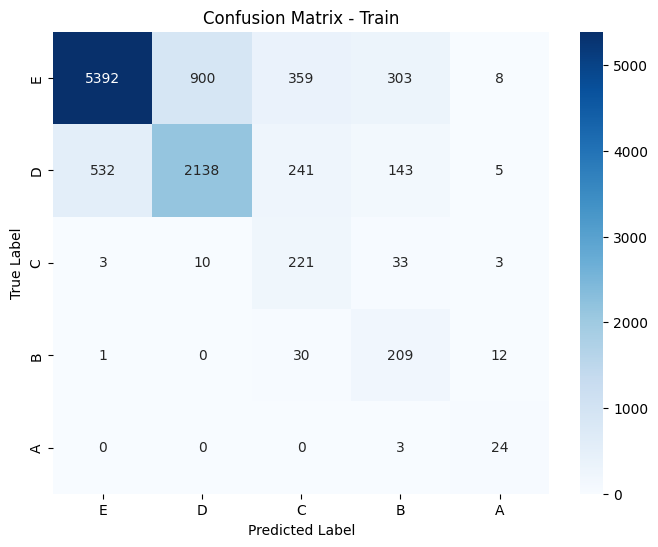

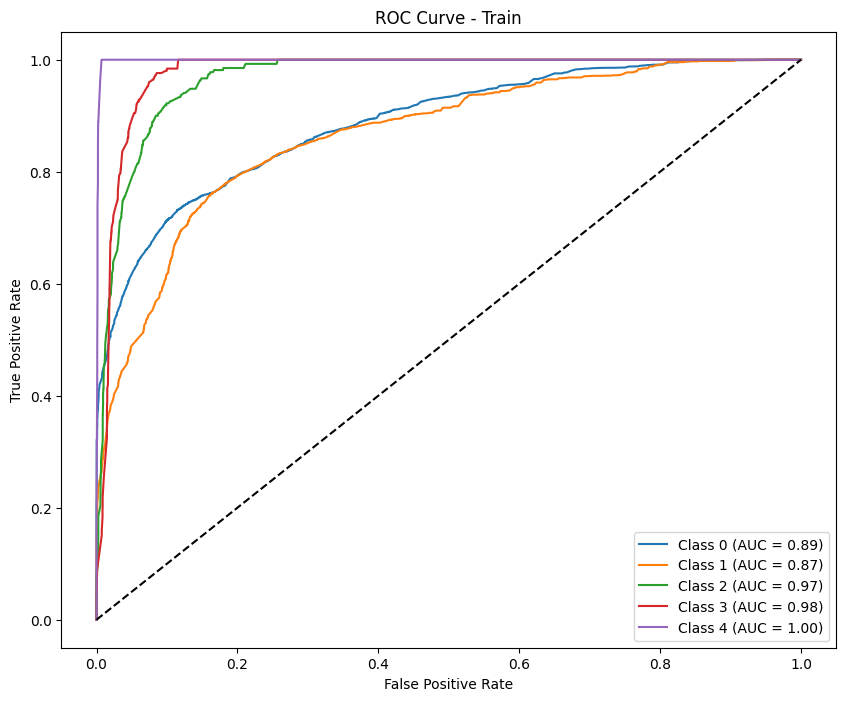


--- Test Metrics ---
F1 Score (per class): [0.92261458 0.37037037 0.         0.         0.        ]
Precision (per class): [0.85874126 0.6097561  0.         0.         0.        ]
Recall (per class): [0.99675325 0.26595745 0.         0.         0.        ]
Accuracy: 0.8452
AUC (One-vs-Rest): 0.8380

Classification Report:
              precision    recall  f1-score   support

           E       0.86      1.00      0.92       616
           D       0.61      0.27      0.37        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.85       756
   macro avg       0.29      0.25      0.26       756
weighted avg       0.78      0.85      0.80       756



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


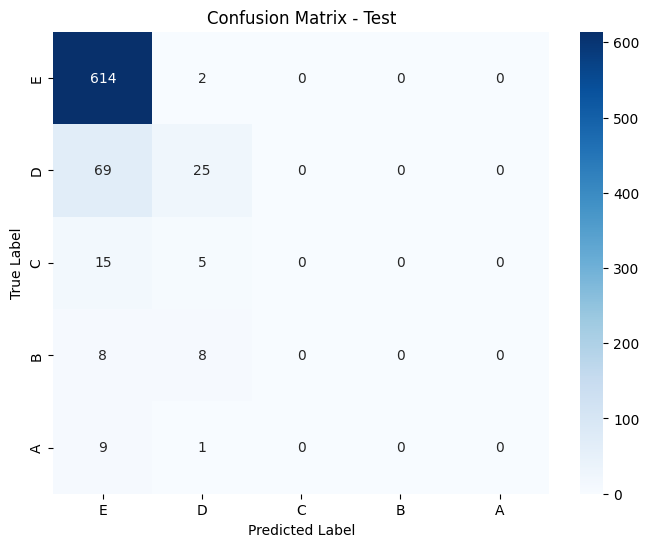

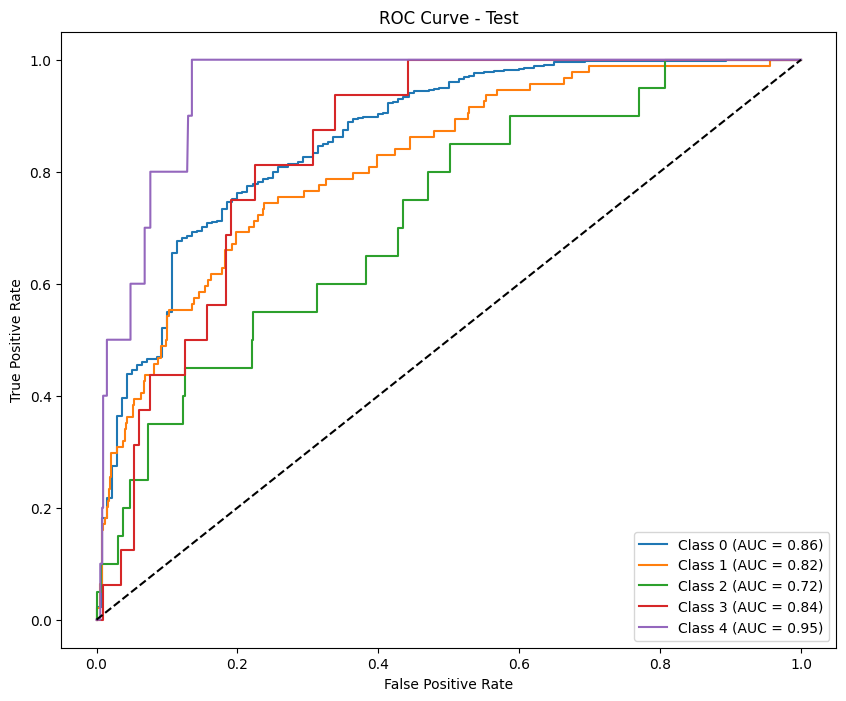

Results saved as test_results_calibrate_robust_f1_macro_phase1.csv
-------------Results for calibrate phase: phase1---------------

--- Train Metrics ---
F1 Score (per class): [0.86445536 0.65940367 0.4983165  0.51827243 0.6       ]
Precision (per class): [0.82353706 0.79383341 0.45679012 0.44571429 0.54545455]
Recall (per class): [0.9096524  0.56390977 0.54814815 0.61904762 0.66666667]
Accuracy: 0.7928
AUC (One-vs-Rest): 0.9470

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.91      0.86      6962
           D       0.79      0.56      0.66      3059
           C       0.46      0.55      0.50       270
           B       0.45      0.62      0.52       252
           A       0.55      0.67      0.60        27

    accuracy                           0.79     10570
   macro avg       0.61      0.66      0.63     10570
weighted avg       0.80      0.79      0.79     10570



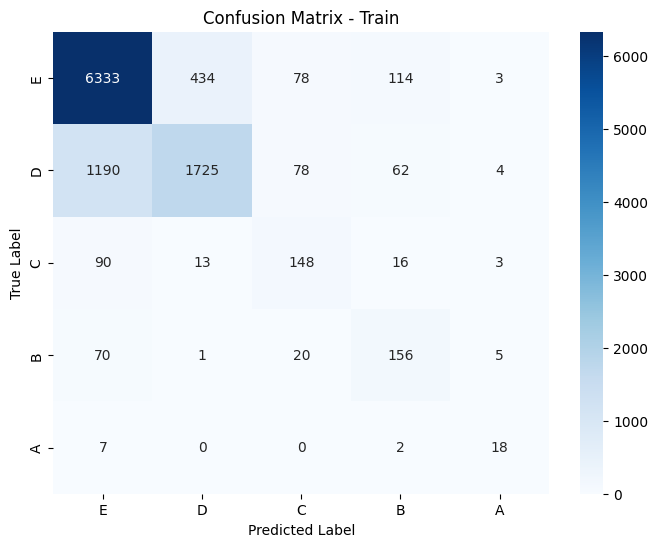

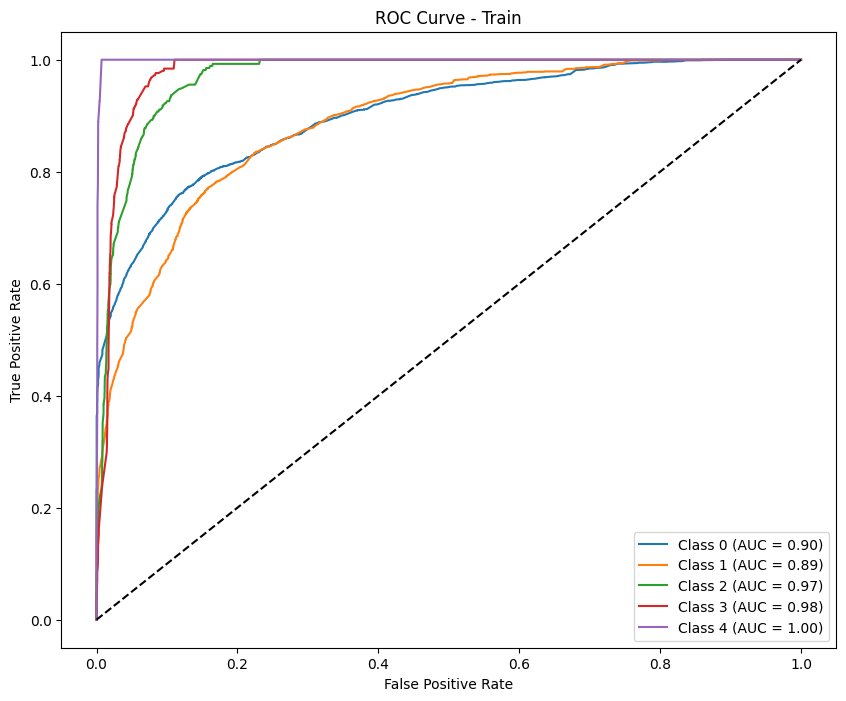


--- Test Metrics ---
F1 Score (per class): [0.90707965 0.18181818 0.         0.         0.        ]
Precision (per class): [0.83108108 0.625      0.         0.         0.        ]
Recall (per class): [0.99837662 0.10638298 0.         0.         0.        ]
Accuracy: 0.8267
AUC (One-vs-Rest): 0.8332

Classification Report:
              precision    recall  f1-score   support

           E       0.83      1.00      0.91       616
           D       0.62      0.11      0.18        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.83       756
   macro avg       0.29      0.22      0.22       756
weighted avg       0.75      0.83      0.76       756



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


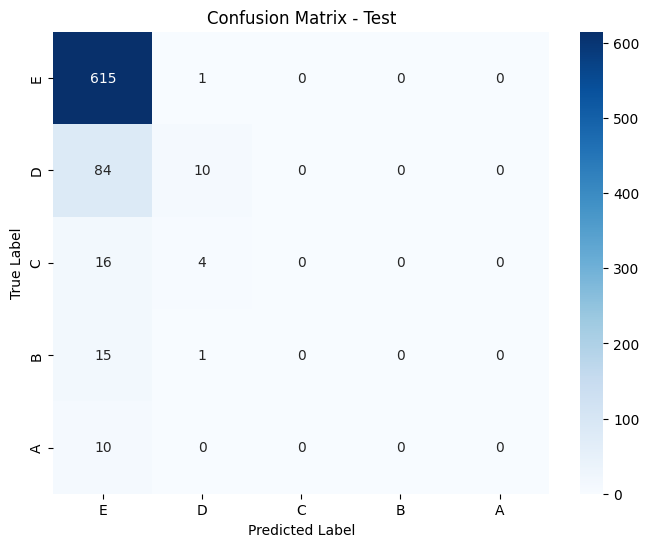

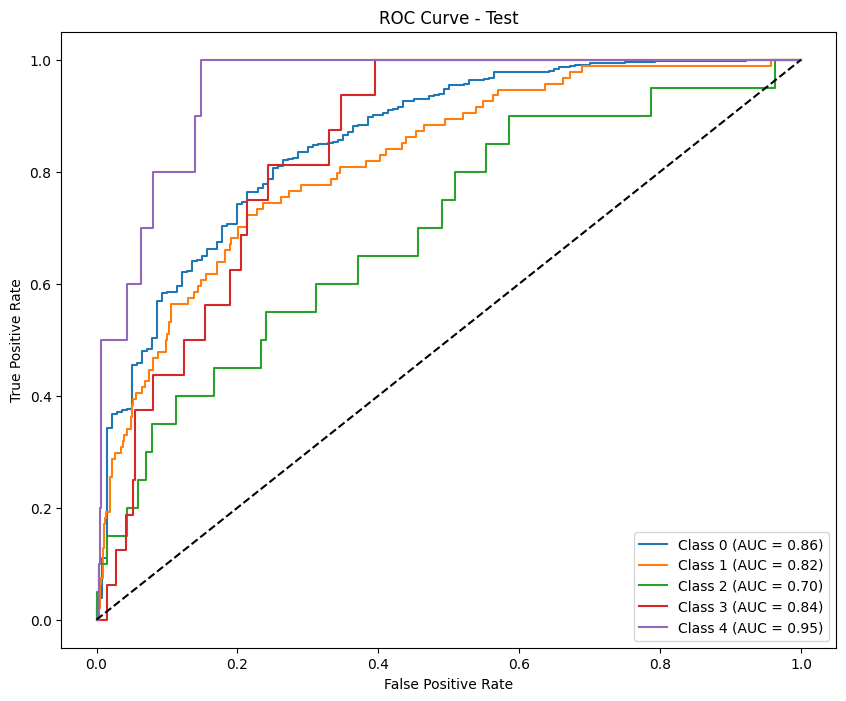


-------------Permutation Importance for phase: phase1---------


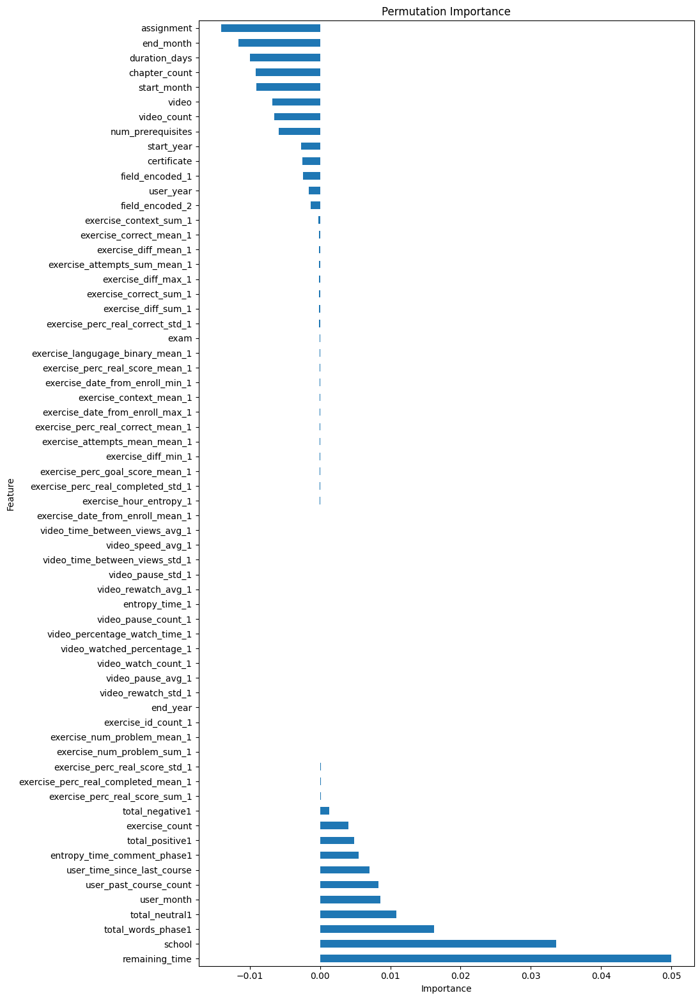

               Feature  Importance
20      remaining_time    0.050024
0               school    0.033574
60  total_words_phase1    0.016261
63      total_neutral1    0.010821
8           user_month    0.008550
..                 ...         ...
4          start_month   -0.009035
11       chapter_count   -0.009212
19       duration_days   -0.010017
6            end_month   -0.011660
16          assignment   -0.014108

[64 rows x 2 columns]

-----------SHAP Feature Importance for phase: phase1------------


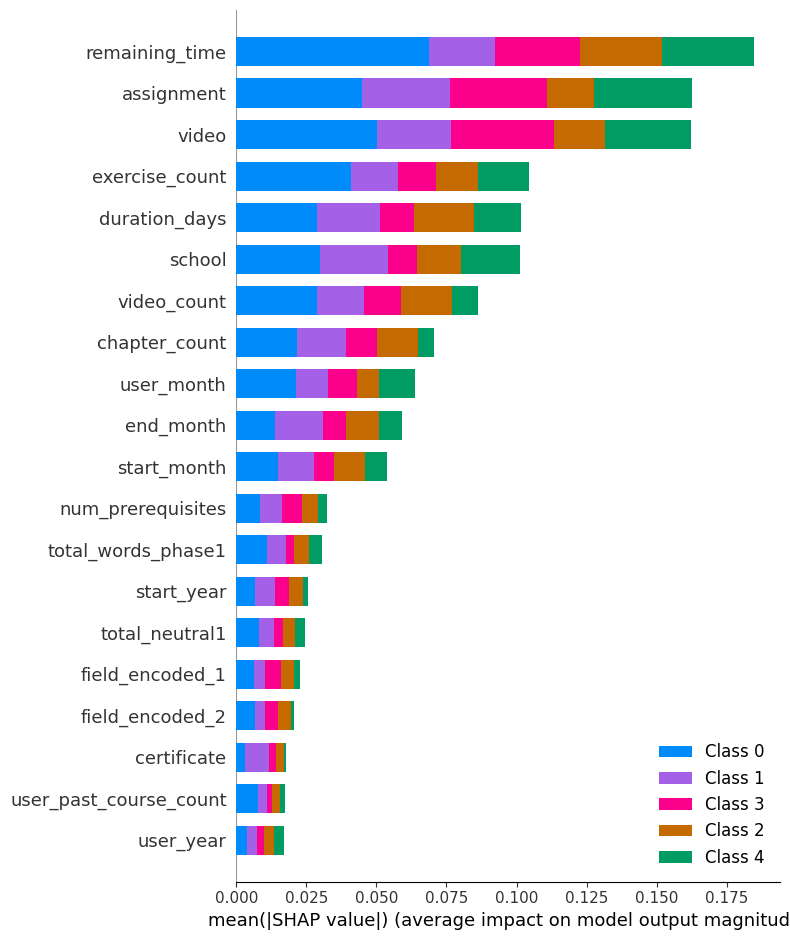


-----Lasso Feature Selection for phase: phase1----------


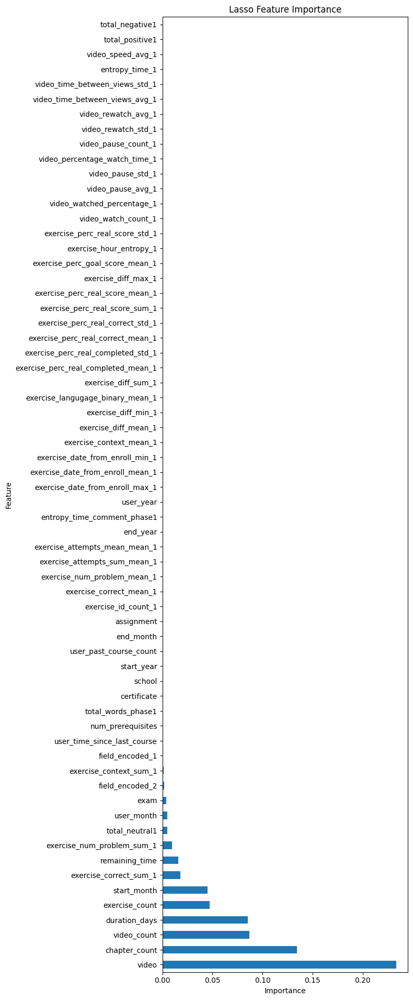

                           Feature  Importance
17                           video    0.233465
11                   chapter_count    0.134253
9                      video_count    0.087082
19                   duration_days    0.085149
10                  exercise_count    0.047206
..                             ...         ...
57  video_time_between_views_std_1    0.000000
59                  entropy_time_1    0.000000
58               video_speed_avg_1    0.000000
61                 total_positive1    0.000000
62                 total_negative1    0.000000

[64 rows x 2 columns]

----------Boruta Trick: phase1----------
Feature Importance (Including Random Feature):
                Feature    Importance
64       Random Feature  2.163469e-01
20       remaining_time  1.321483e-01
17                video  8.841324e-02
16           assignment  7.482611e-02
0                school  6.158968e-02
..                  ...           ...
48  video_watch_count_1  1.149892e-06
52    video_pause_av

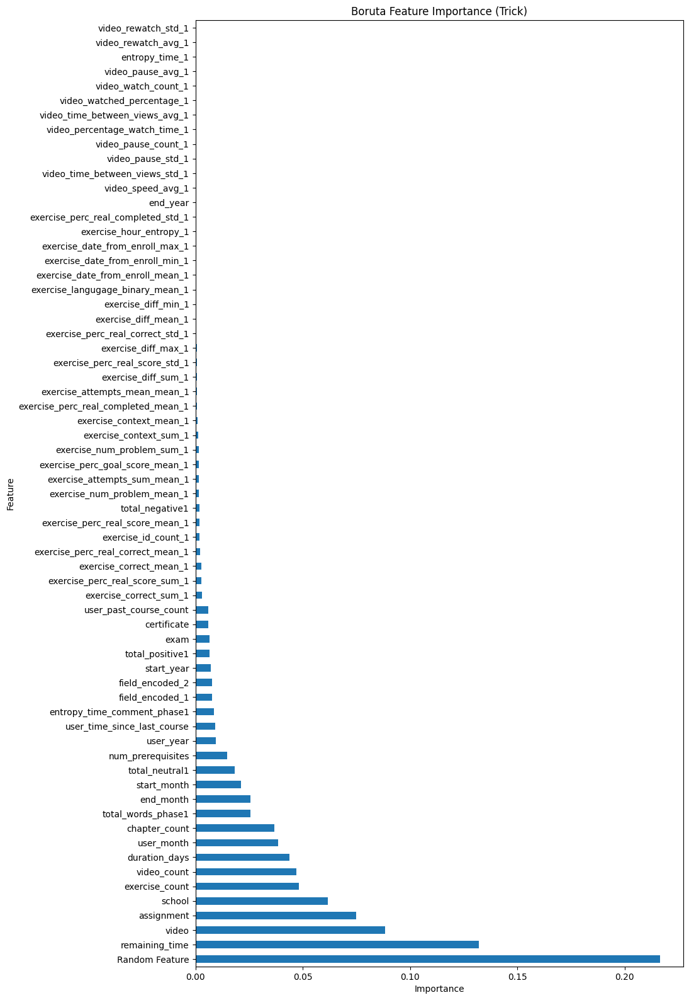

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None
Results saved as test_results_robust_f1_macro_phase2.csv
----------Results for phase: phase2--------------

--- Train Metrics ---
F1 Score (per class): [0.82264297 0.6659857  0.3875969  0.45381984 0.66666667]
Precision (per class): [0.89983094 0.66476346 0.26002972 0.30757342 0.52272727]
Recall (per class): [0.75765125 0.66721244 0.76086957 0.86521739 0.92      ]
Accuracy: 0.7353
AUC (One-vs-Rest): 0.9270

Classification Report:
              precision    recall  f1-score   support

           E       0.90      0.76      0.82      5620
           D       0.66      0.67      0.67      2443
           C       0.26      0.76      0.39       230
           B       0.31      0.87      0.45       230
           A       0.52      0.92      0.67        25

    accuracy                           0.74      85

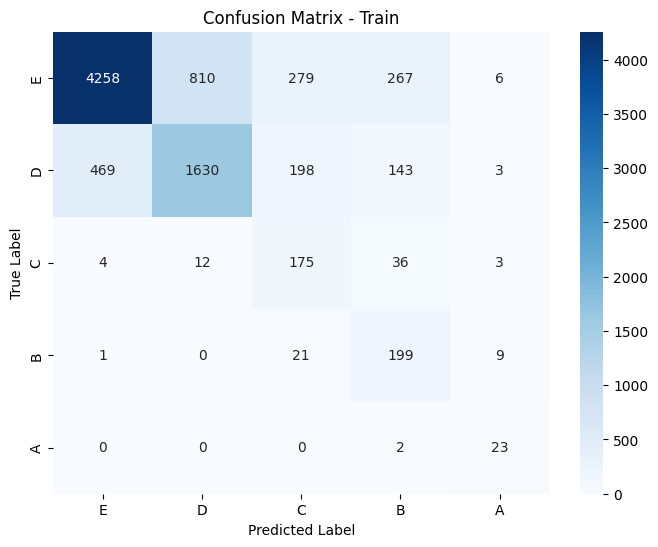

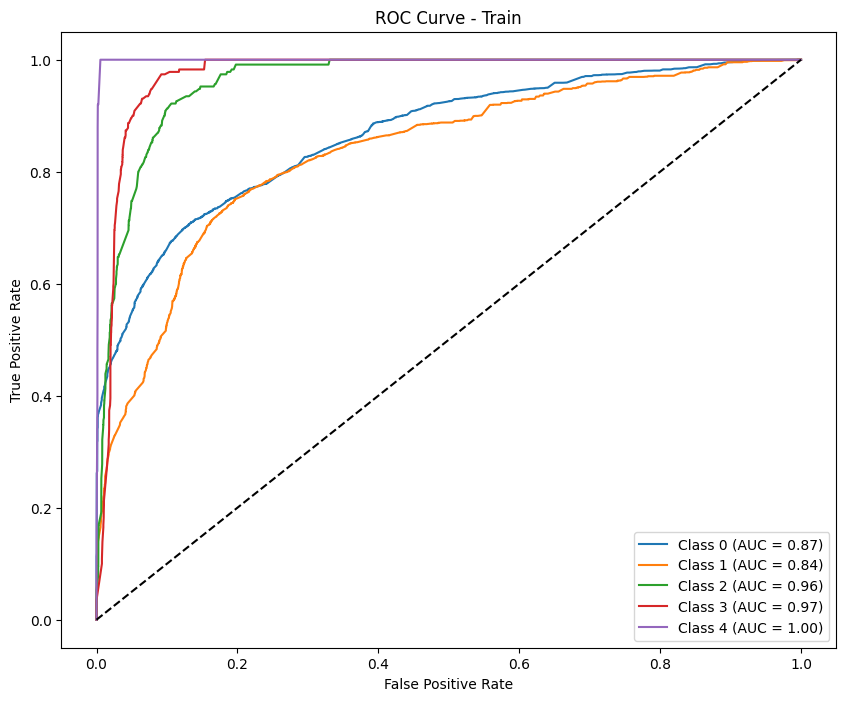


--- Test Metrics ---
F1 Score (per class): [0.90423163 0.08       0.         0.         0.        ]
Precision (per class): [0.82520325 0.5        0.         0.         0.        ]
Recall (per class): [1.         0.04347826 0.         0.         0.        ]
Accuracy: 0.8217
AUC (One-vs-Rest): 0.7484

Classification Report:
              precision    recall  f1-score   support

           E       0.83      1.00      0.90       609
           D       0.50      0.04      0.08        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.82       746
   macro avg       0.27      0.21      0.20       746
weighted avg       0.74      0.82      0.75       746



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


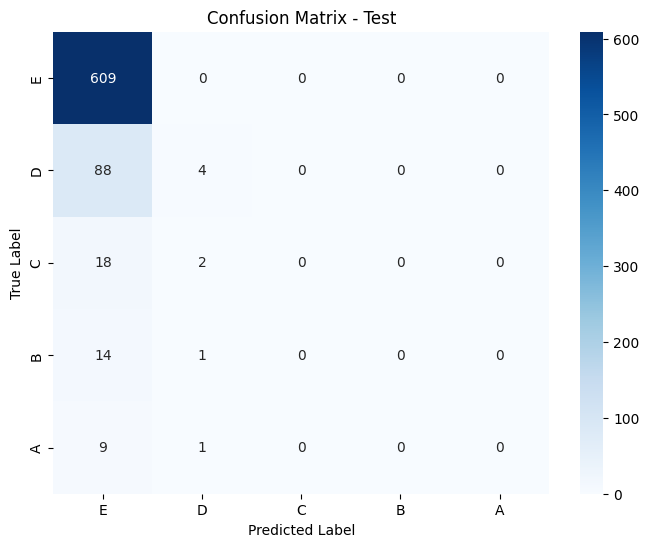

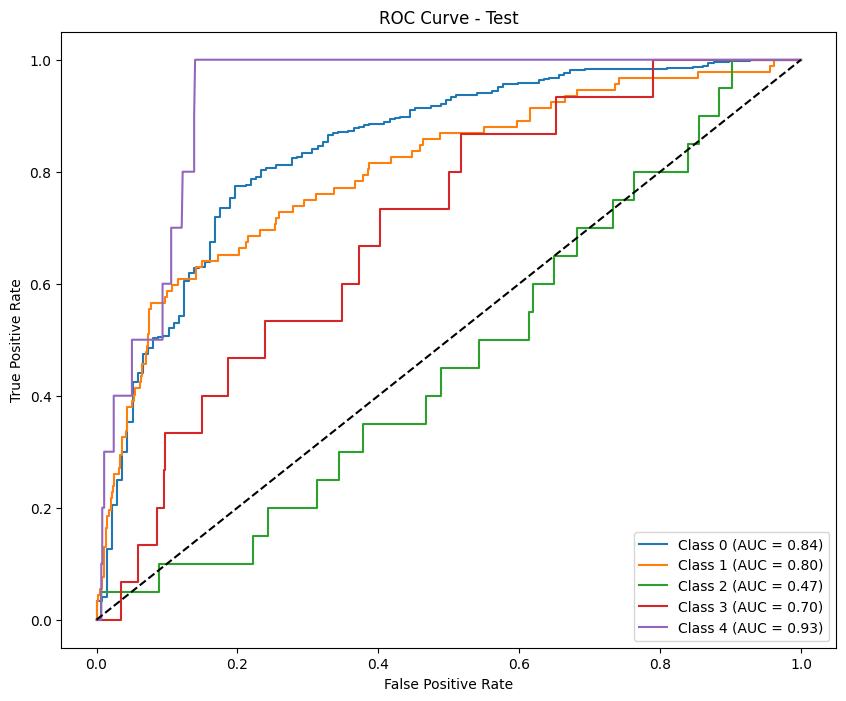

Results saved as test_results_calibrate_robust_f1_macro_phase2.csv
-------------Results for calibrate phase: phase2---------------

--- Train Metrics ---
F1 Score (per class): [0.84363822 0.61952704 0.46186441 0.49910233 0.59259259]
Precision (per class): [0.80904933 0.72374179 0.45041322 0.42507645 0.55172414]
Recall (per class): [0.88131673 0.54154728 0.47391304 0.60434783 0.64      ]
Accuracy: 0.7651
AUC (One-vs-Rest): 0.9369

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.88      0.84      5620
           D       0.72      0.54      0.62      2443
           C       0.45      0.47      0.46       230
           B       0.43      0.60      0.50       230
           A       0.55      0.64      0.59        25

    accuracy                           0.77      8548
   macro avg       0.59      0.63      0.60      8548
weighted avg       0.76      0.77      0.76      8548



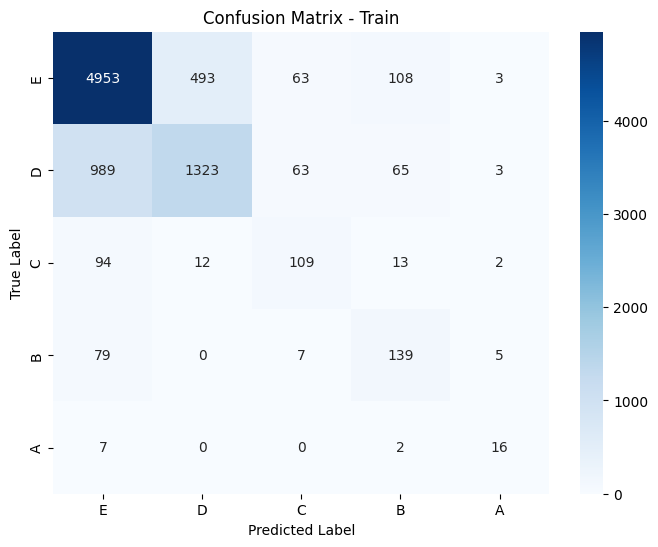

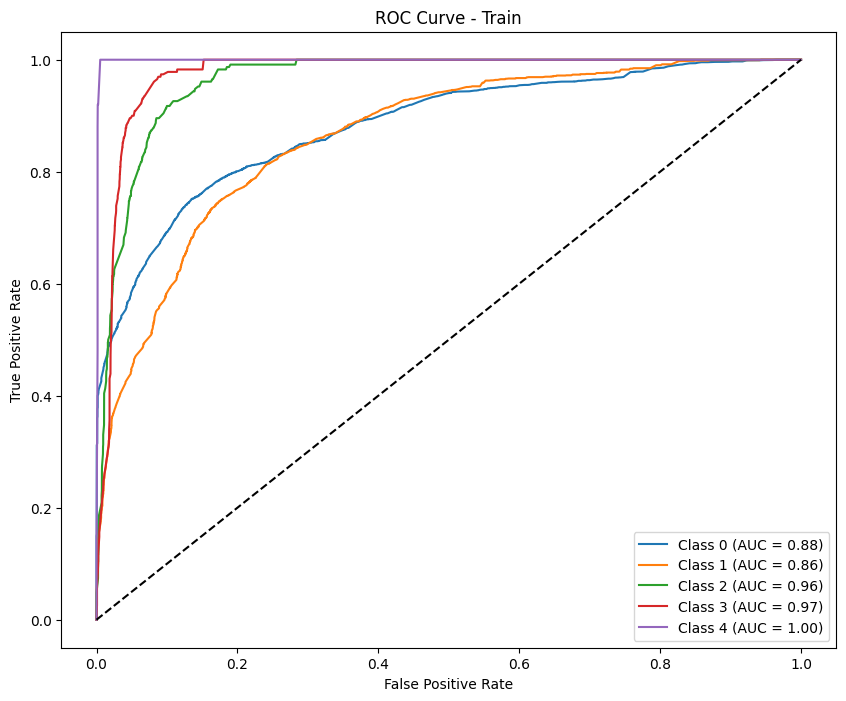


--- Test Metrics ---
F1 Score (per class): [0.89889299 0.         0.         0.         0.        ]
Precision (per class): [0.81635389 0.         0.         0.         0.        ]
Recall (per class): [1. 0. 0. 0. 0.]
Accuracy: 0.8164
AUC (One-vs-Rest): 0.7390

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       609
           D       0.00      0.00      0.00        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.82       746
   macro avg       0.16      0.20      0.18       746
weighted avg       0.67      0.82      0.73       746



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


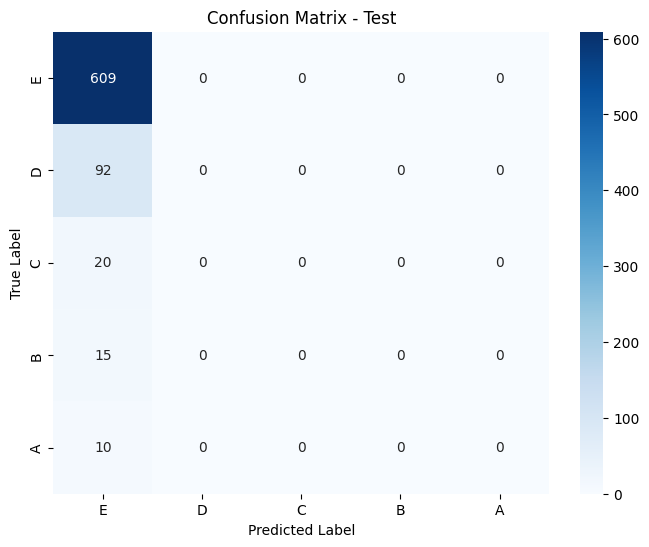

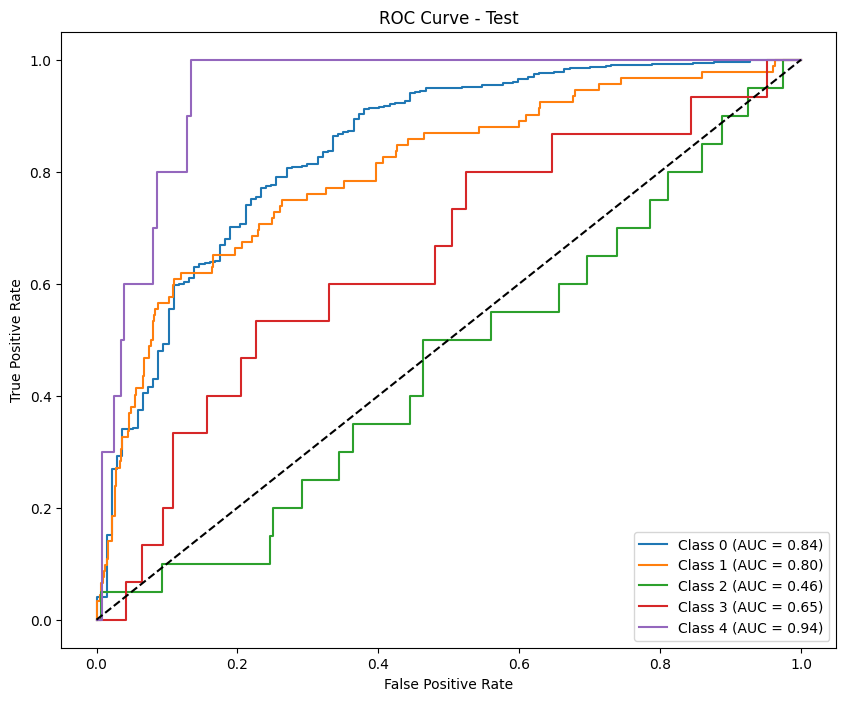


-------------Permutation Importance for phase: phase2---------


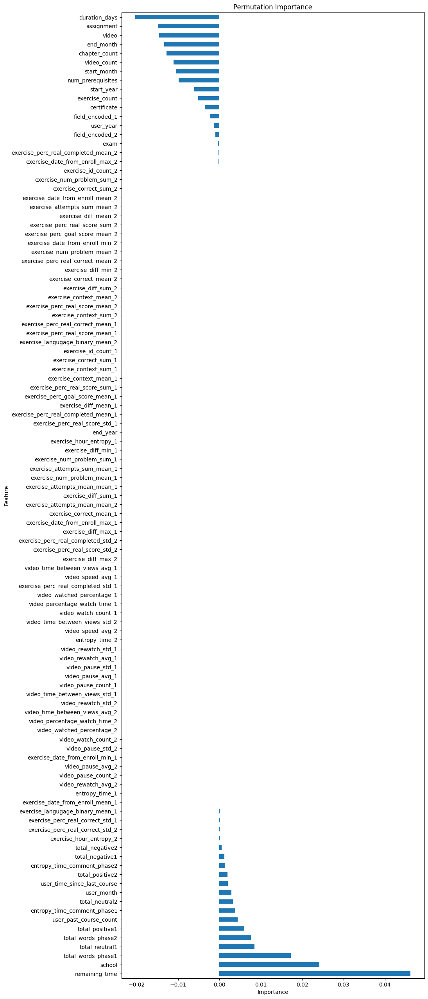

                Feature  Importance
20       remaining_time    0.046210
0                school    0.024202
60   total_words_phase1    0.017226
63       total_neutral1    0.008438
103  total_words_phase2    0.007619
..                  ...         ...
11        chapter_count   -0.012766
6             end_month   -0.013336
17                video   -0.014565
16           assignment   -0.014887
19        duration_days   -0.020385

[107 rows x 2 columns]

-----------SHAP Feature Importance for phase: phase2------------


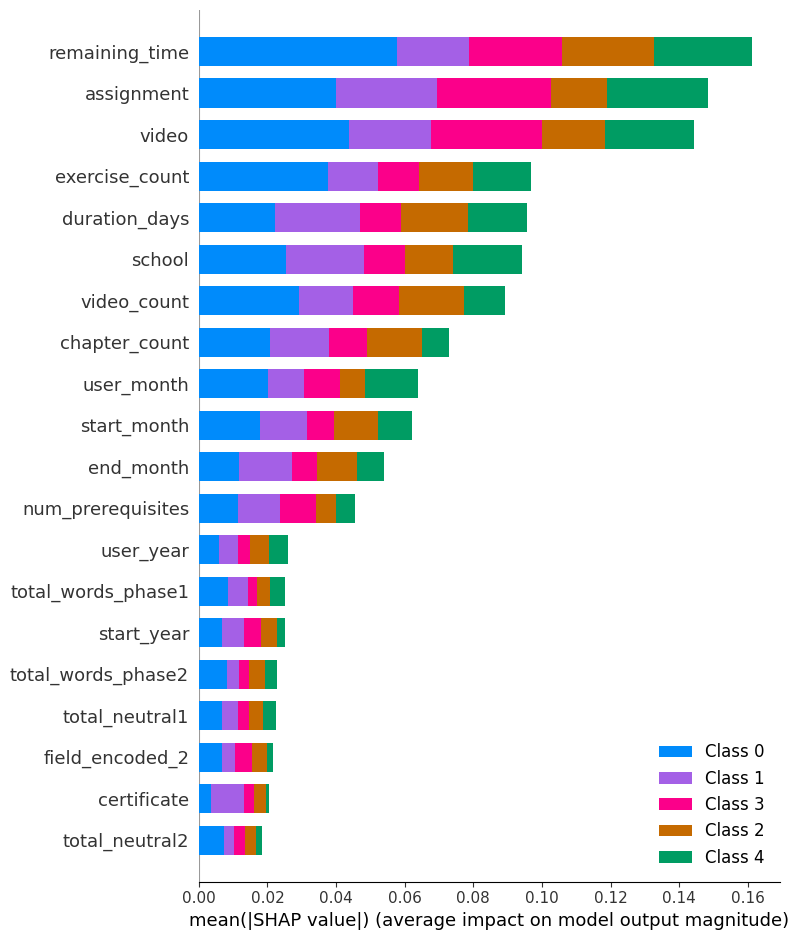


-----Lasso Feature Selection for phase: phase2----------


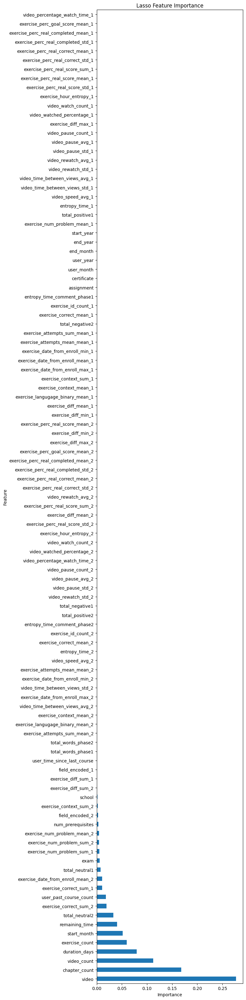

                                Feature  Importance
17                                video    0.276941
11                        chapter_count    0.168214
9                           video_count    0.112384
19                        duration_days    0.079778
10                       exercise_count    0.059750
..                                  ...         ...
42    exercise_perc_real_correct_mean_1    0.000000
41   exercise_perc_real_completed_std_1    0.000000
40  exercise_perc_real_completed_mean_1    0.000000
39      exercise_perc_goal_score_mean_1    0.000000
50        video_percentage_watch_time_1    0.000000

[107 rows x 2 columns]

----------Boruta Trick: phase2----------
Feature Importance (Including Random Feature):
                            Feature  Importance
107                  Random Feature    0.197427
20                   remaining_time    0.122247
17                            video    0.081176
16                       assignment    0.077950
0                      

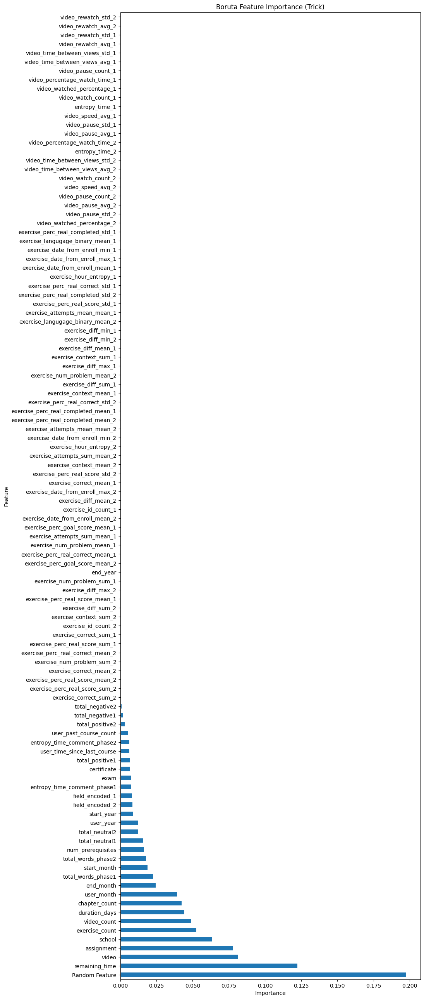

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None
Results saved as test_results_robust_f1_macro_phase3.csv
----------Results for phase: phase3--------------

--- Train Metrics ---
F1 Score (per class): [0.82580781 0.66993318 0.37516171 0.45547074 0.60714286]
Precision (per class): [0.89627599 0.67443946 0.25       0.30915371 0.45945946]
Recall (per class): [0.7656128  0.66548673 0.75129534 0.8647343  0.89473684]
Accuracy: 0.7392
AUC (One-vs-Rest): 0.9279

Classification Report:
              precision    recall  f1-score   support

           E       0.90      0.77      0.83      5124
           D       0.67      0.67      0.67      2260
           C       0.25      0.75      0.38       193
           B       0.31      0.86      0.46       207
           A       0.46      0.89      0.61        19

    accuracy                           0.74      78

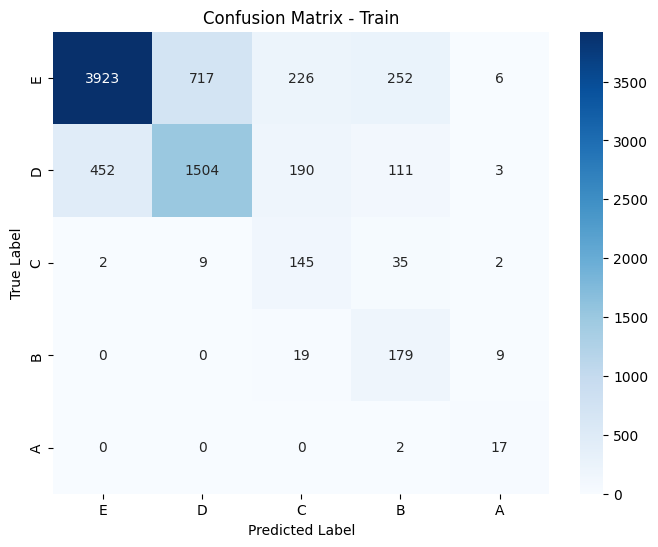

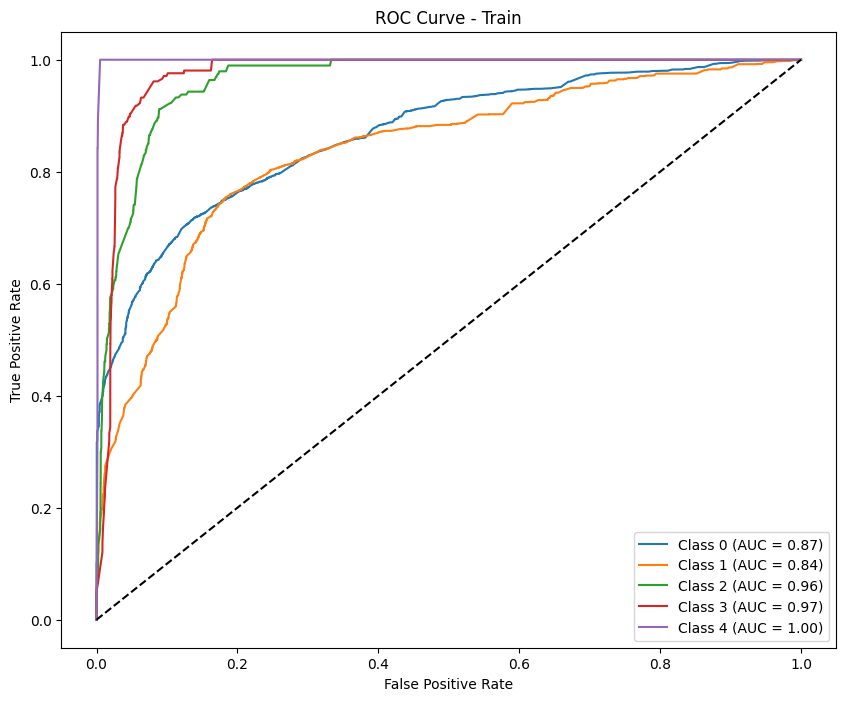


--- Test Metrics ---
F1 Score (per class): [0.89586524 0.         0.         0.         0.        ]
Precision (per class): [0.81476323 0.         0.         0.         0.        ]
Recall (per class): [0.99489796 0.         0.         0.         0.        ]
Accuracy: 0.8114
AUC (One-vs-Rest): 0.6249

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.99      0.90       588
           D       0.00      0.00      0.00        87
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.81       721
   macro avg       0.16      0.20      0.18       721
weighted avg       0.66      0.81      0.73       721



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


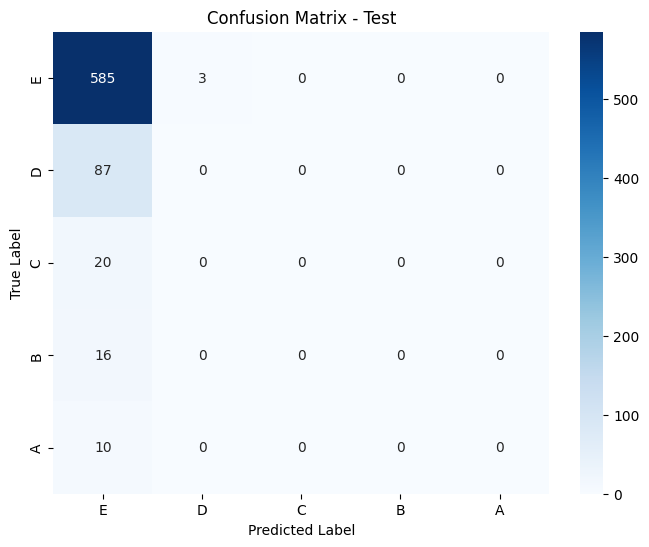

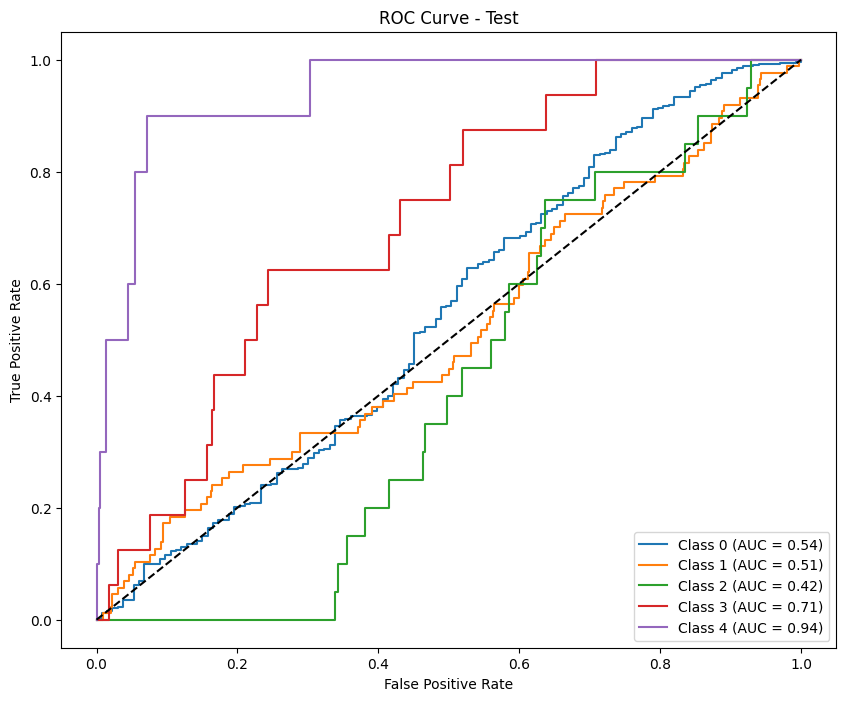

Results saved as test_results_calibrate_robust_f1_macro_phase3.csv
-------------Results for calibrate phase: phase3---------------

--- Train Metrics ---
F1 Score (per class): [0.8464769  0.63496855 0.47570332 0.4679089  0.57142857]
Precision (per class): [0.81112502 0.73586006 0.46969697 0.40942029 0.52173913]
Recall (per class): [0.88505074 0.55840708 0.48186528 0.54589372 0.63157895]
Accuracy: 0.7709
AUC (One-vs-Rest): 0.9389

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.89      0.85      5124
           D       0.74      0.56      0.63      2260
           C       0.47      0.48      0.48       193
           B       0.41      0.55      0.47       207
           A       0.52      0.63      0.57        19

    accuracy                           0.77      7803
   macro avg       0.59      0.62      0.60      7803
weighted avg       0.77      0.77      0.77      7803



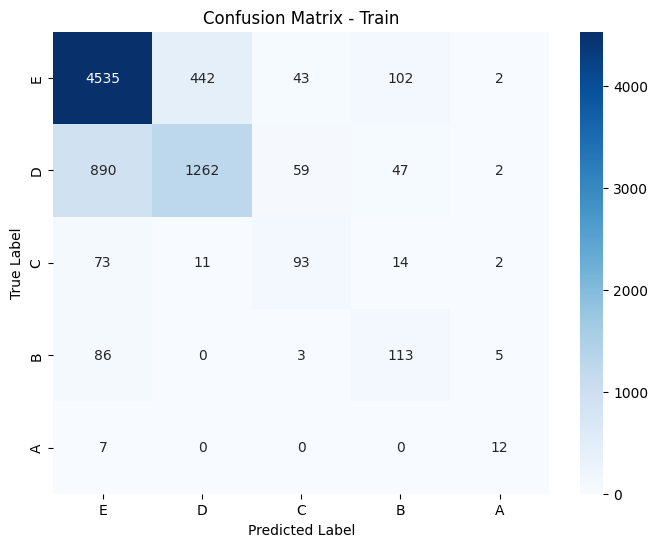

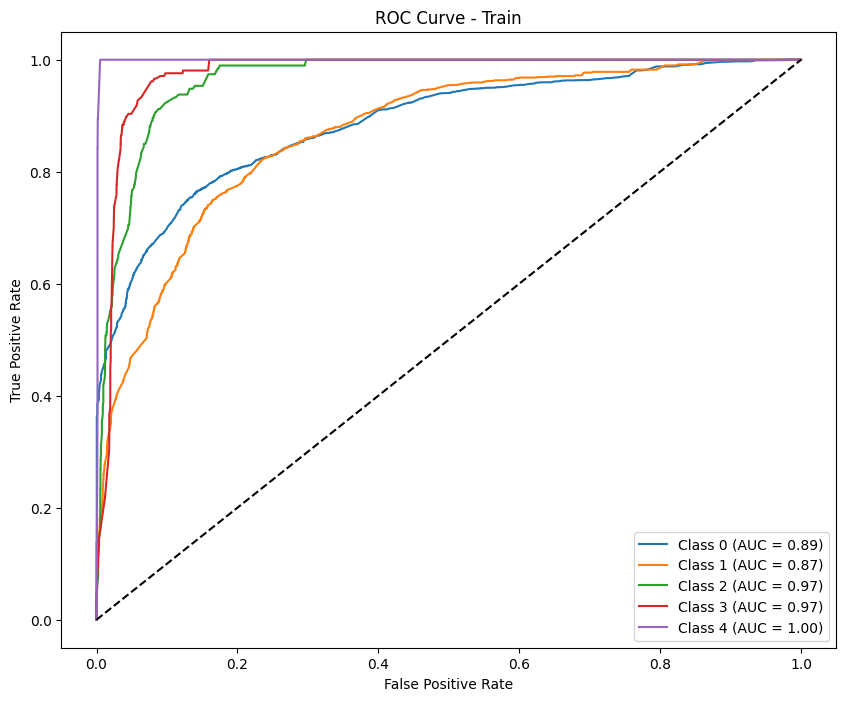


--- Test Metrics ---
F1 Score (per class): [0.89839572 0.         0.         0.         0.        ]
Precision (per class): [0.81553398 0.         0.         0.         0.        ]
Recall (per class): [1. 0. 0. 0. 0.]
Accuracy: 0.8155
AUC (One-vs-Rest): 0.6258

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       588
           D       0.00      0.00      0.00        87
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.82       721
   macro avg       0.16      0.20      0.18       721
weighted avg       0.67      0.82      0.73       721



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


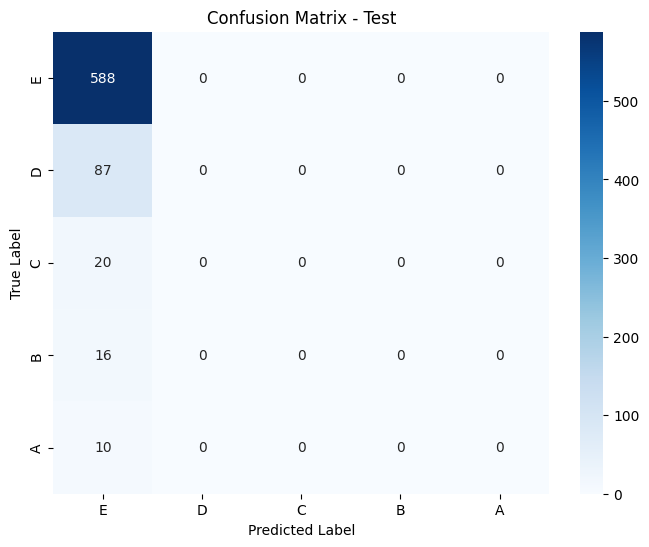

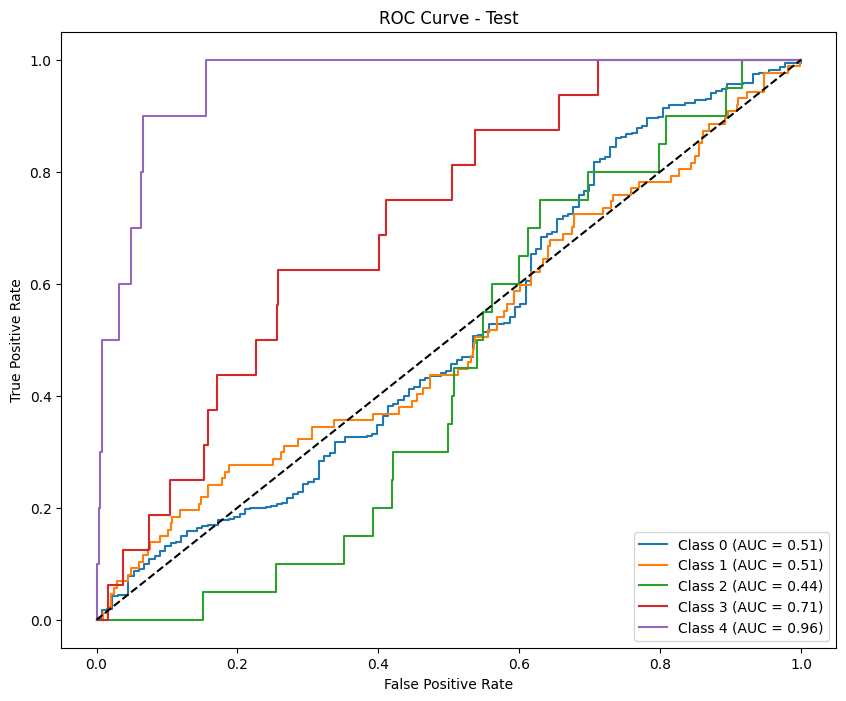

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None
Results saved as test_results_robust_f1_macro_phase4.csv
----------Results for phase: phase4--------------

--- Train Metrics ---
F1 Score (per class): [0.82192206 0.6956242  0.27619048 0.53784861 0.62222222]
Precision (per class): [0.90218132 0.70838794 0.16446125 0.39358601 0.4516129 ]
Recall (per class): [0.75477616 0.68331226 0.86138614 0.8490566  1.        ]
Accuracy: 0.7391
AUC (One-vs-Rest): 0.9326

Classification Report:
              precision    recall  f1-score   support

           E       0.90      0.75      0.82      3507
           D       0.71      0.68      0.70      1582
           C       0.16      0.86      0.28       101
           B       0.39      0.85      0.54       159
           A       0.45      1.00      0.62        14

    accuracy                           0.74      53

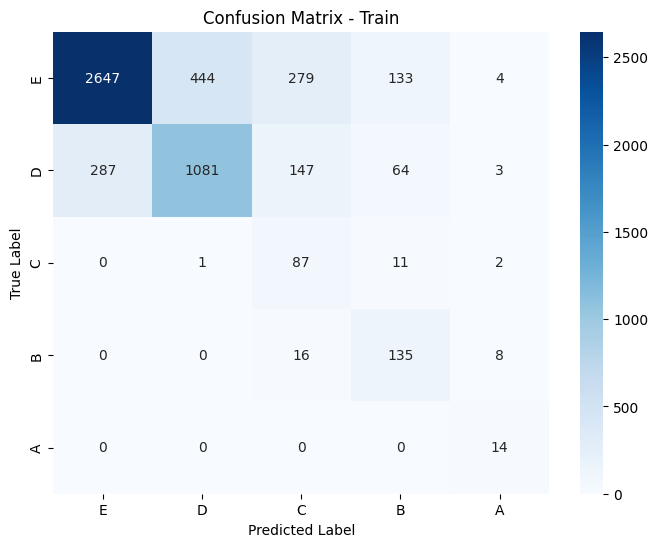

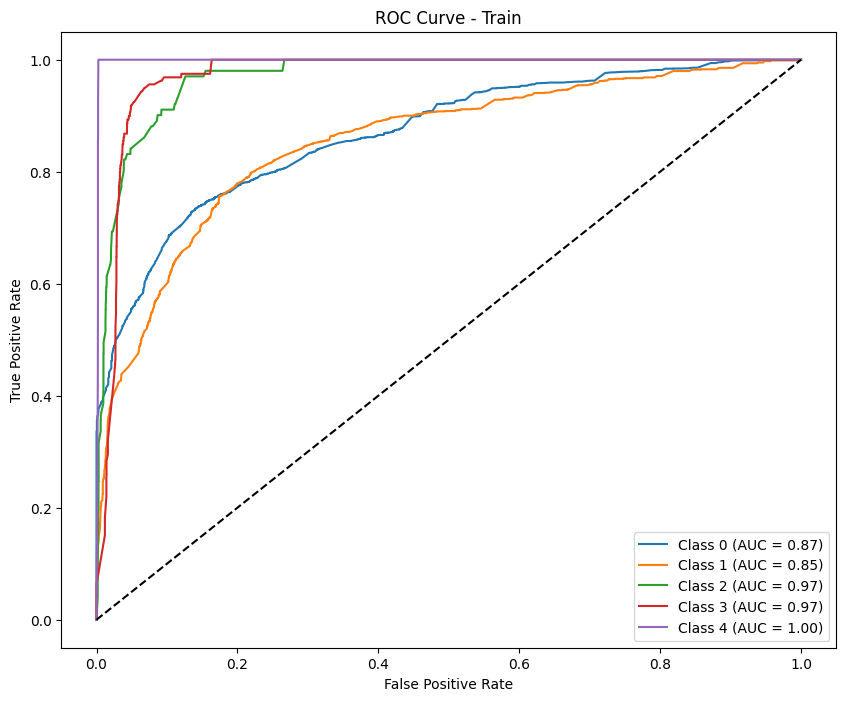


--- Test Metrics ---
F1 Score (per class): [0.88834951 0.         0.         0.         0.        ]
Precision (per class): [0.8061674 0.        0.        0.        0.       ]
Recall (per class): [0.98918919 0.         0.         0.         0.        ]
Accuracy: 0.7991
AUC (One-vs-Rest): 0.5837

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.99      0.89       555
           D       0.00      0.00      0.00        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.80       687
   macro avg       0.16      0.20      0.18       687
weighted avg       0.65      0.80      0.72       687



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


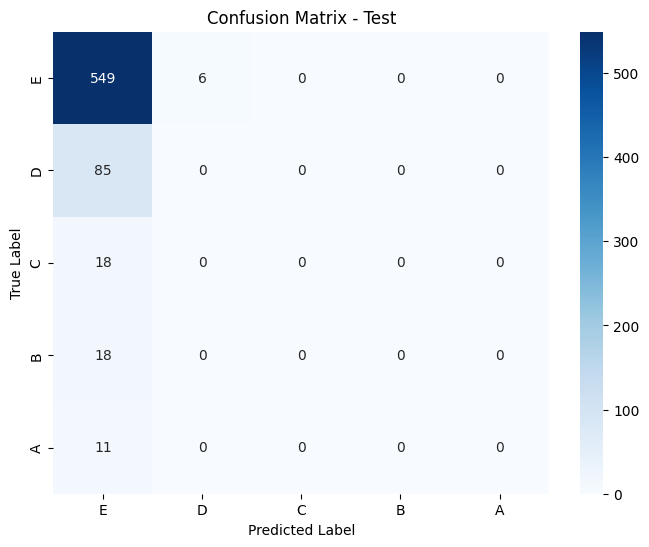

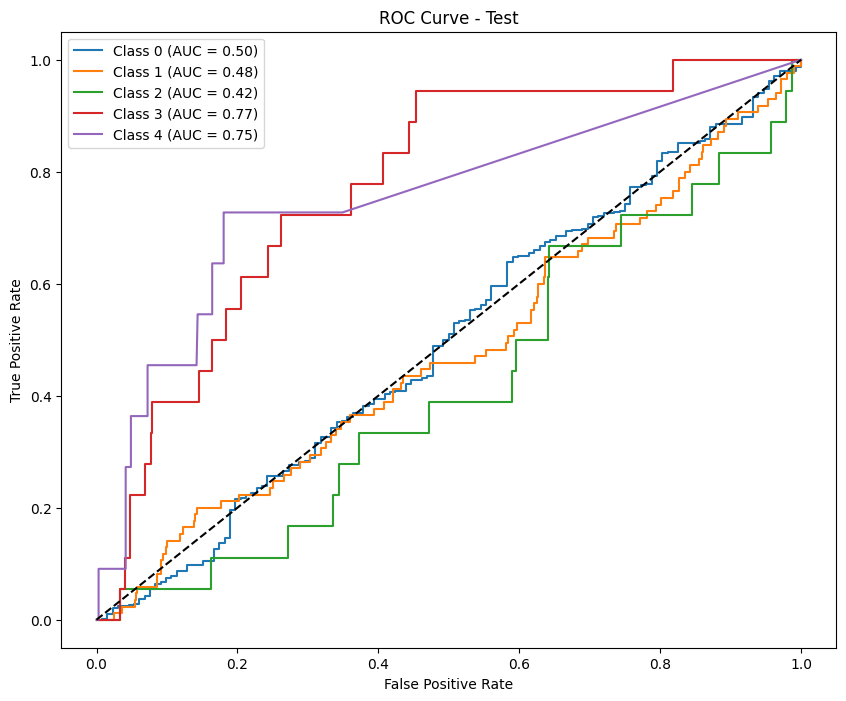

Results saved as test_results_calibrate_robust_f1_macro_phase4.csv
-------------Results for calibrate phase: phase4---------------

--- Train Metrics ---
F1 Score (per class): [0.85497028 0.66405136 0.5        0.52830189 0.48484848]
Precision (per class): [0.82984434 0.76186579 0.44274809 0.42264151 0.42105263]
Recall (per class): [0.88166524 0.58849558 0.57425743 0.70440252 0.57142857]
Accuracy: 0.7833
AUC (One-vs-Rest): 0.9428

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.88      0.85      3507
           D       0.76      0.59      0.66      1582
           C       0.44      0.57      0.50       101
           B       0.42      0.70      0.53       159
           A       0.42      0.57      0.48        14

    accuracy                           0.78      5363
   macro avg       0.58      0.66      0.61      5363
weighted avg       0.79      0.78      0.78      5363



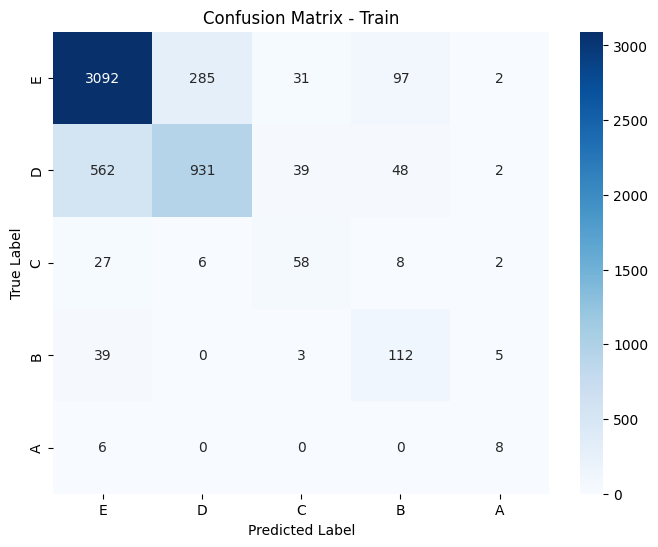

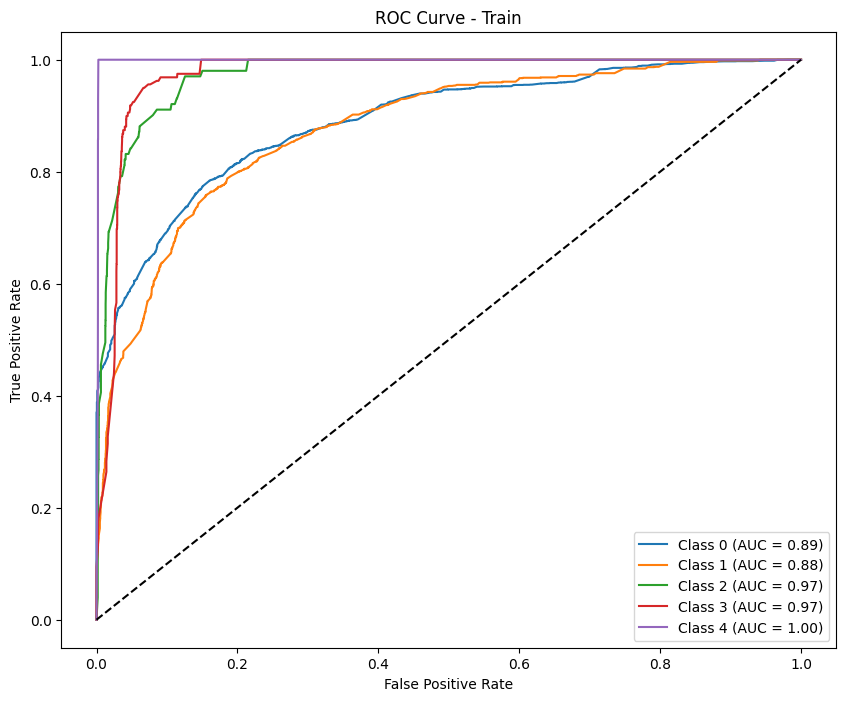


--- Test Metrics ---
F1 Score (per class): [0.89282836 0.         0.         0.         0.        ]
Precision (per class): [0.80758017 0.         0.         0.         0.        ]
Recall (per class): [0.9981982 0.        0.        0.        0.       ]
Accuracy: 0.8064
AUC (One-vs-Rest): 0.6115

Classification Report:
              precision    recall  f1-score   support

           E       0.81      1.00      0.89       555
           D       0.00      0.00      0.00        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.81       687
   macro avg       0.16      0.20      0.18       687
weighted avg       0.65      0.81      0.72       687



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


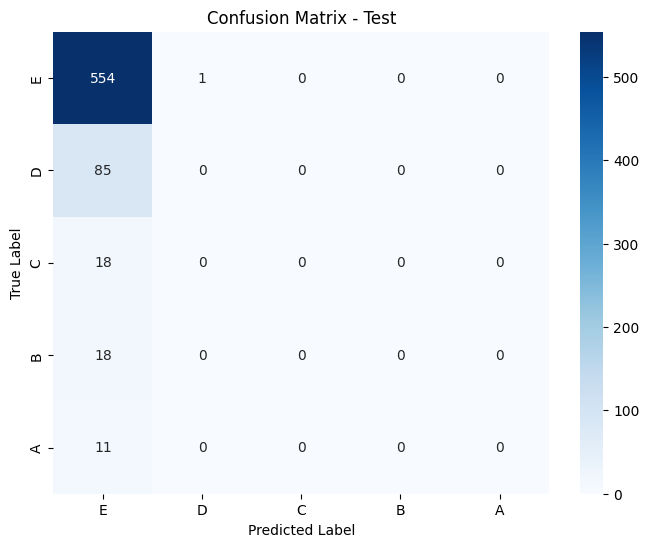

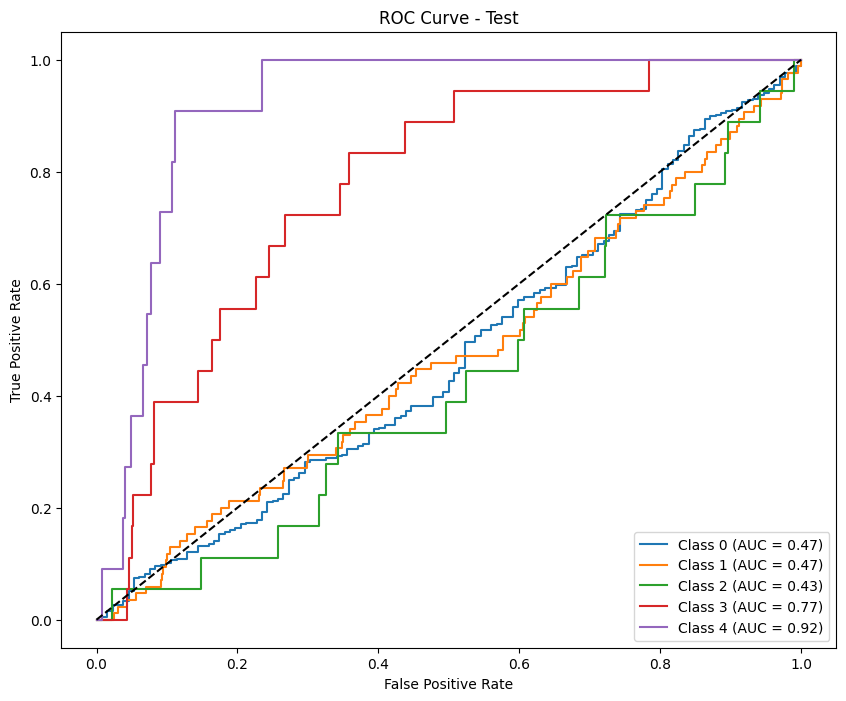

In [28]:
# Lặp qua các phase
hyperparams = {
    "phase1": hp_1,
    "phase2": hp_2,
    "phase3": hp_3,
    "phase4": hp_4
}

for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_phase(phase, metric='f1_macro', scale='robust', hyper=hyperparams[phase]) 

### undersample

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

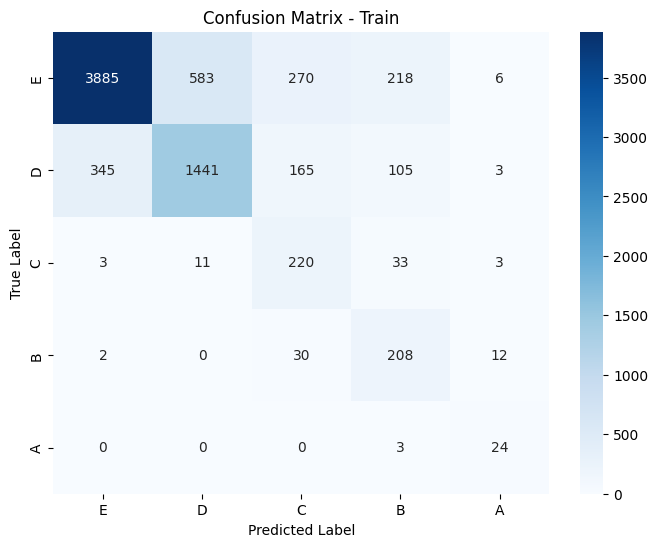

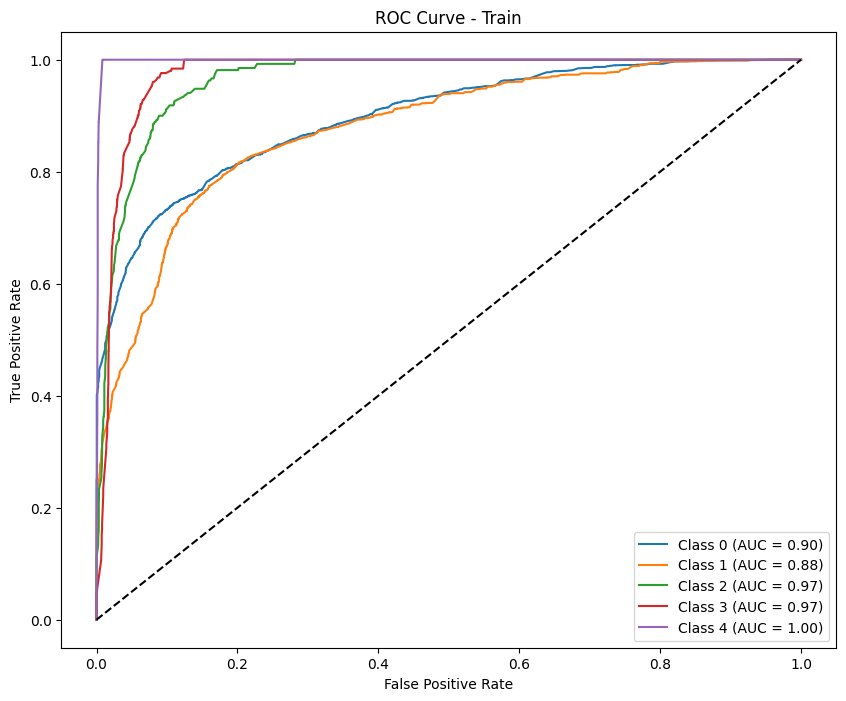


--- Test Metrics ---
F1 Score (per class): [0.92319277 0.37681159 0.         0.         0.        ]
Precision (per class): [0.86095506 0.59090909 0.         0.         0.        ]
Recall (per class): [0.99512987 0.27659574 0.         0.         0.        ]
Accuracy: 0.8452
AUC (One-vs-Rest): 0.8253

Classification Report:
              precision    recall  f1-score   support

           E       0.86      1.00      0.92       616
           D       0.59      0.28      0.38        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.85       756
   macro avg       0.29      0.25      0.26       756
weighted avg       0.77      0.85      0.80       756



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


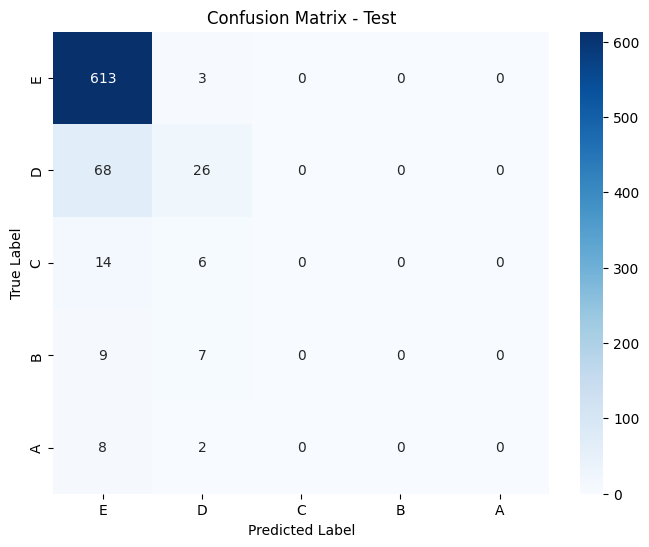

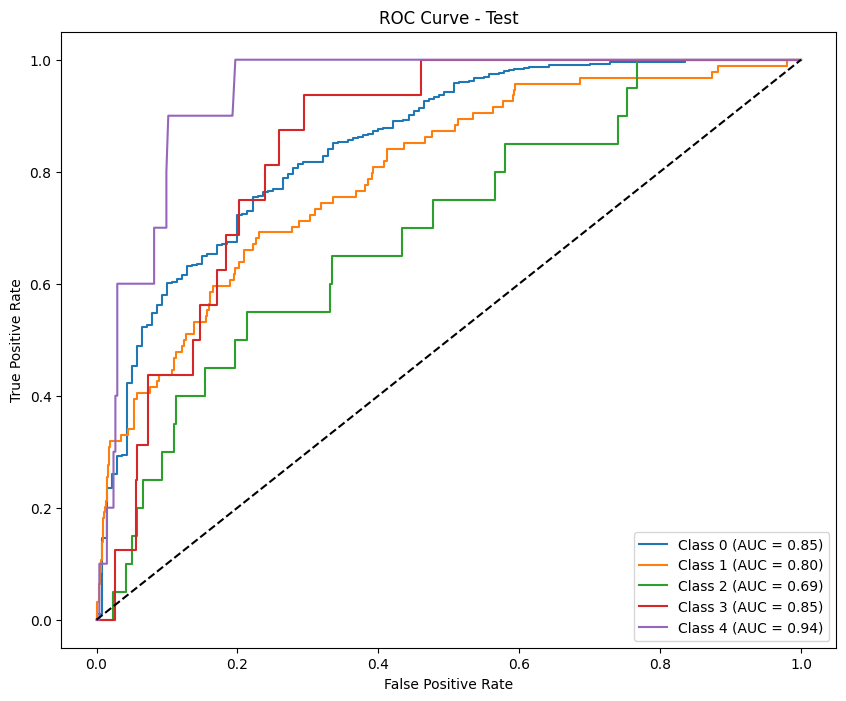

Results saved as test_results_calibrate_undersample_robust_f1_macro_phase1.csv
Results for phase: phase1

--- Train Metrics ---
F1 Score (per class): [0.86419031 0.66847826 0.54513889 0.57746479 0.6440678 ]
Precision (per class): [0.83701605 0.75879087 0.5130719  0.51898734 0.59375   ]
Recall (per class): [0.89318823 0.59737737 0.58148148 0.65079365 0.7037037 ]
Accuracy: 0.7929
AUC (One-vs-Rest): 0.9496

Classification Report:
              precision    recall  f1-score   support

           E       0.84      0.89      0.86      4962
           D       0.76      0.60      0.67      2059
           C       0.51      0.58      0.55       270
           B       0.52      0.65      0.58       252
           A       0.59      0.70      0.64        27

    accuracy                           0.79      7570
   macro avg       0.64      0.69      0.66      7570
weighted avg       0.79      0.79      0.79      7570



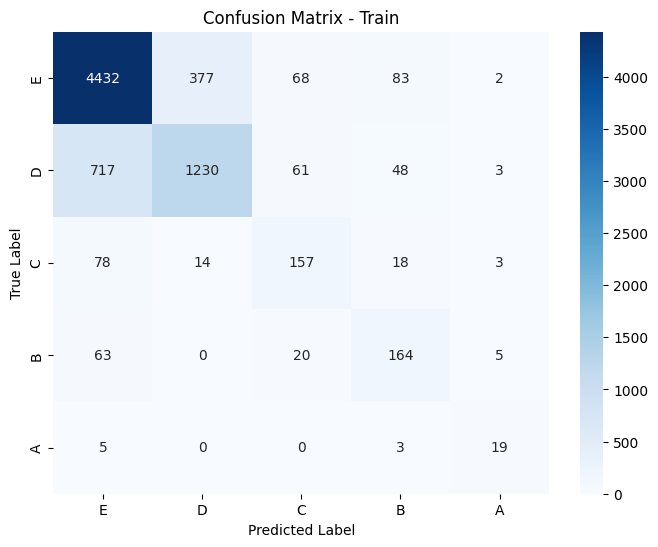

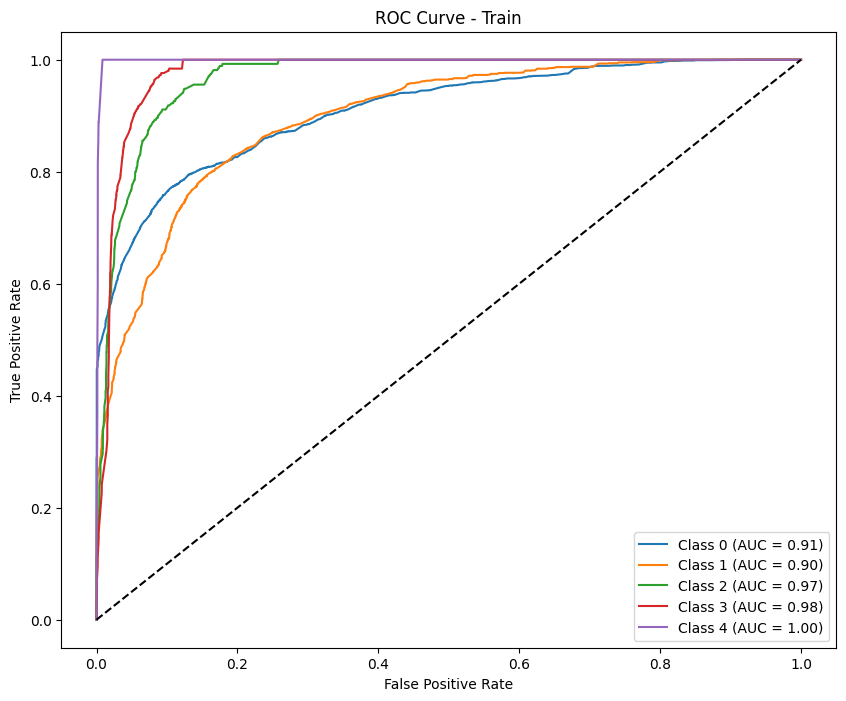


--- Test Metrics ---
F1 Score (per class): [0.90654893 0.1682243  0.         0.         0.        ]
Precision (per class): [0.82907133 0.69230769 0.         0.         0.        ]
Recall (per class): [1.         0.09574468 0.         0.         0.        ]
Accuracy: 0.8267
AUC (One-vs-Rest): 0.8246

Classification Report:
              precision    recall  f1-score   support

           E       0.83      1.00      0.91       616
           D       0.69      0.10      0.17        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.83       756
   macro avg       0.30      0.22      0.21       756
weighted avg       0.76      0.83      0.76       756



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


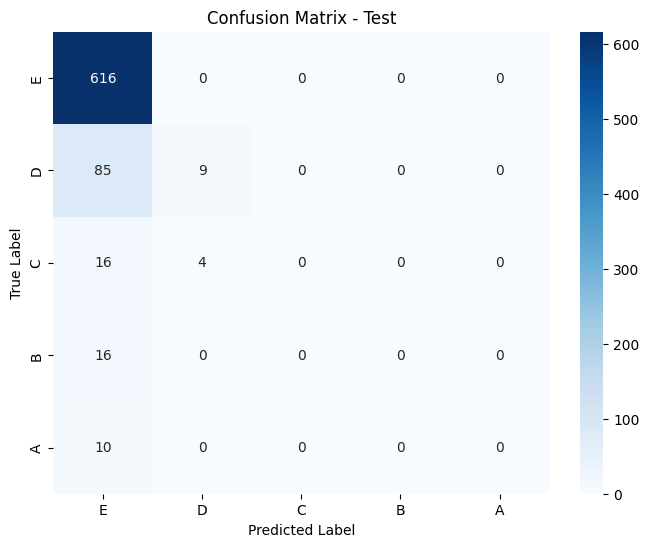

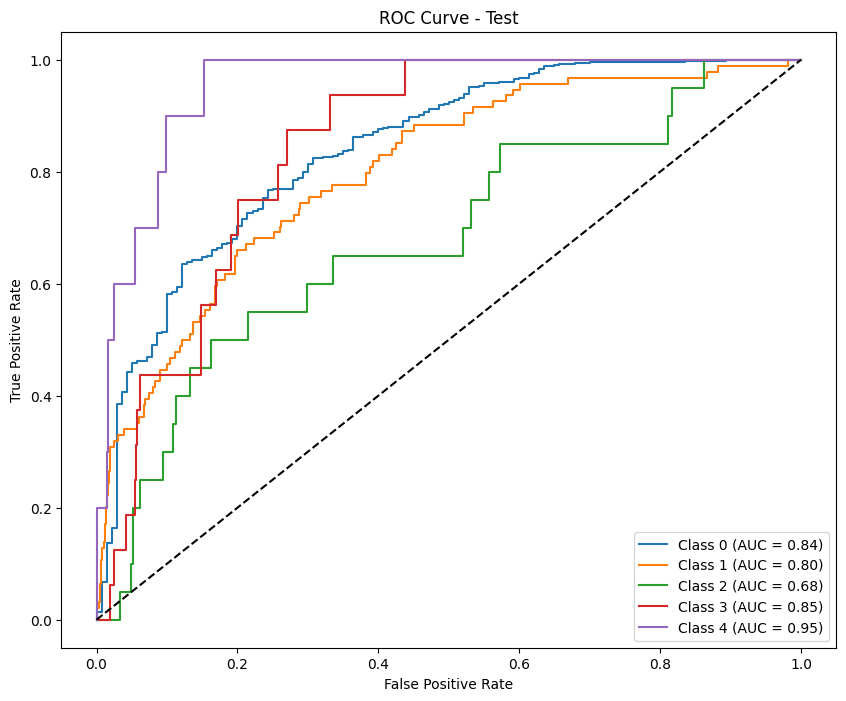


Permutation Importance for phase: phase1


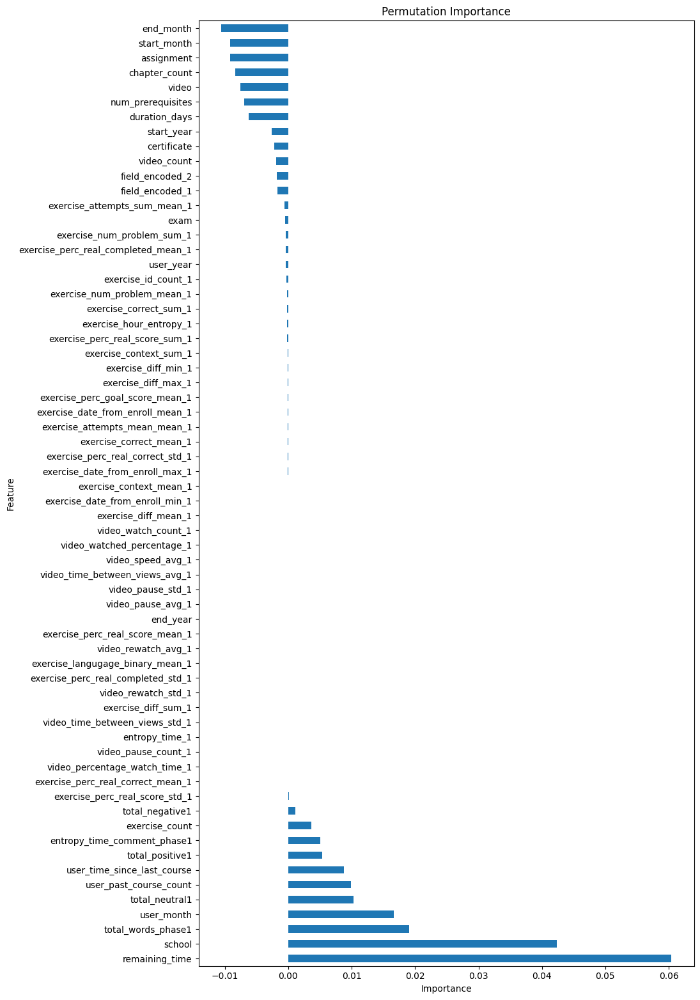

               Feature  Importance
20      remaining_time    0.060419
0               school    0.042355
60  total_words_phase1    0.019022
8           user_month    0.016678
63      total_neutral1    0.010304
..                 ...         ...
17               video   -0.007546
11       chapter_count   -0.008339
16          assignment   -0.009115
4          start_month   -0.009148
6            end_month   -0.010601

[64 rows x 2 columns]

Lasso Feature Selection for phase: phase1


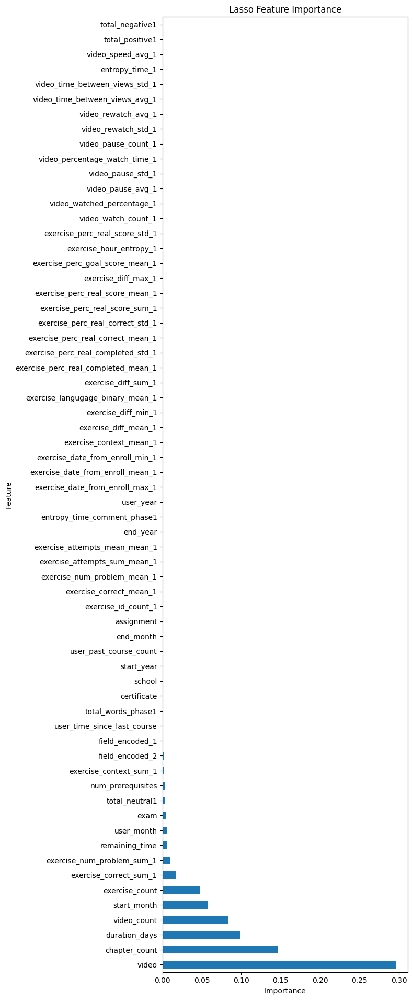

                           Feature  Importance
17                           video    0.296242
11                   chapter_count    0.146293
19                   duration_days    0.098527
9                      video_count    0.082877
4                      start_month    0.057420
..                             ...         ...
57  video_time_between_views_std_1    0.000000
59                  entropy_time_1    0.000000
58               video_speed_avg_1    0.000000
61                 total_positive1    0.000000
62                 total_negative1    0.000000

[64 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                Feature    Importance
64       Random Feature  2.155226e-01
20       remaining_time  1.327620e-01
17                video  8.269093e-02
16           assignment  7.937926e-02
0                school  6.243891e-02
..                  ...           ...
59       entropy_time_1  1.487689e-06
48  video_watch_count_1  1.253945e-06
52    vid

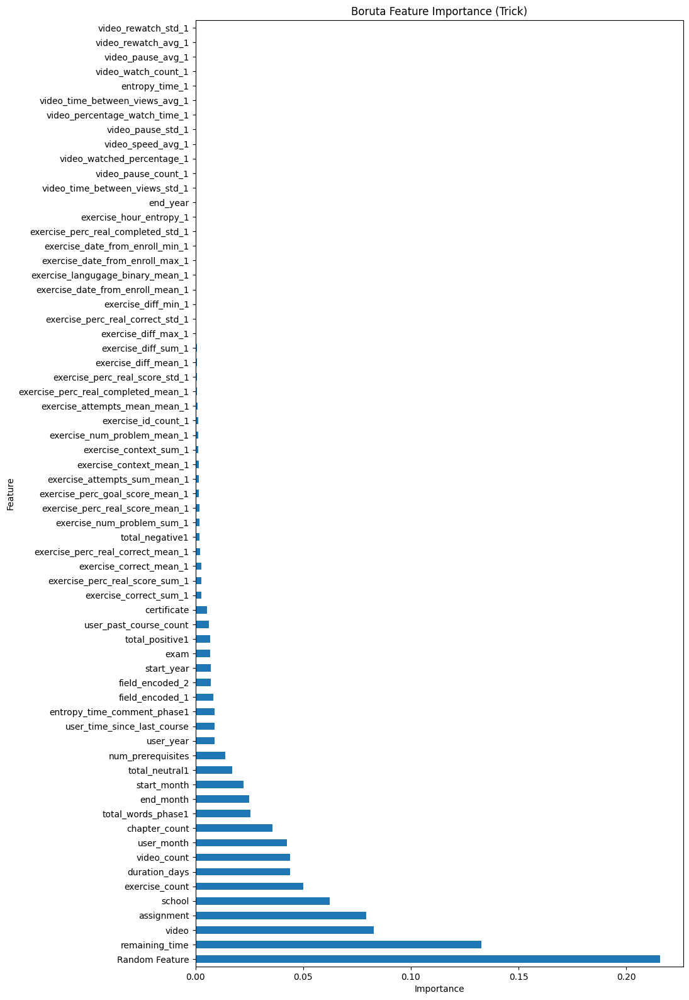

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None
Results saved as test_results_undersample_robust_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.83168019 0.67283316 0.46703297 0.55464481 0.73015873]
Precision (per class): [0.91199736 0.66531165 0.34136546 0.40438247 0.60526316]
Recall (per class): [0.76436464 0.68052668 0.73913043 0.8826087  0.92      ]
Accuracy: 0.7471
AUC (One-vs-Rest): 0.9338

Classification Report:
              precision    recall  f1-score   support

           E       0.91      0.76      0.83      3620
           D       0.67      0.68      0.67      1443
           C       0.34      0.74      0.47       230
           B       0.40      0.88      0.55       230
           A       0.61      0.92      0.73        25

    accuracy                           0.75      5548
   macro 

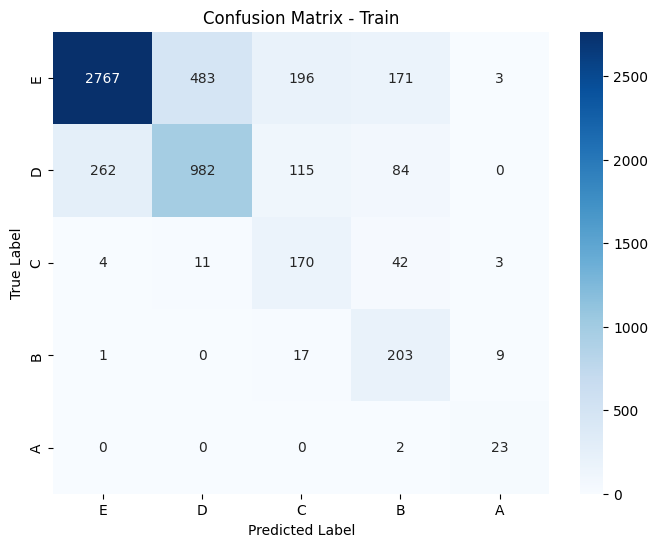

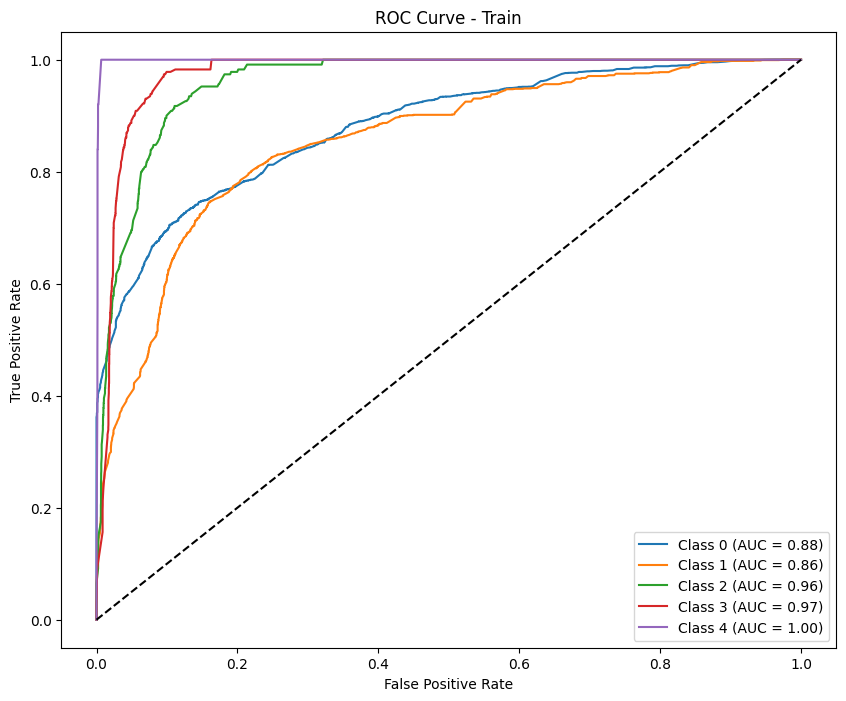


--- Test Metrics ---
F1 Score (per class): [0.90022173 0.04255319 0.         0.         0.        ]
Precision (per class): [0.81854839 1.         0.         0.         0.        ]
Recall (per class): [1.         0.02173913 0.         0.         0.        ]
Accuracy: 0.8190
AUC (One-vs-Rest): 0.7400

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       609
           D       1.00      0.02      0.04        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.82       746
   macro avg       0.36      0.20      0.19       746
weighted avg       0.79      0.82      0.74       746



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


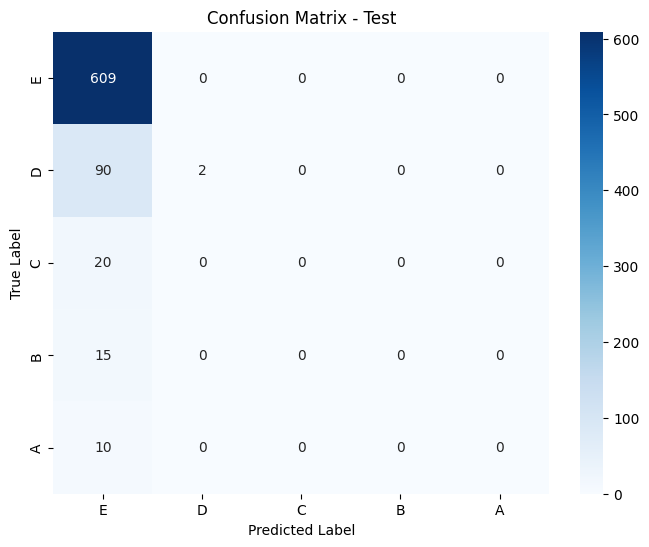

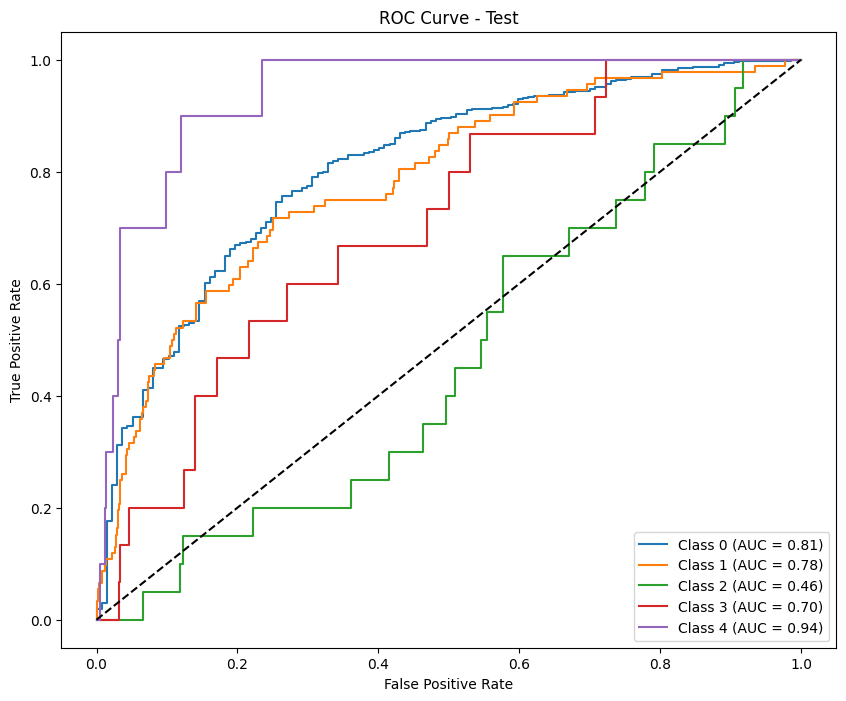

Results saved as test_results_calibrate_undersample_robust_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.8524722  0.61628818 0.53626374 0.62105263 0.77777778]
Precision (per class): [0.82773875 0.70837084 0.54222222 0.52058824 0.72413793]
Recall (per class): [0.87872928 0.54539155 0.53043478 0.76956522 0.84      ]
Accuracy: 0.7729
AUC (One-vs-Rest): 0.9413

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.88      0.85      3620
           D       0.71      0.55      0.62      1443
           C       0.54      0.53      0.54       230
           B       0.52      0.77      0.62       230
           A       0.72      0.84      0.78        25

    accuracy                           0.77      5548
   macro avg       0.66      0.71      0.68      5548
weighted avg       0.77      0.77      0.77      5548



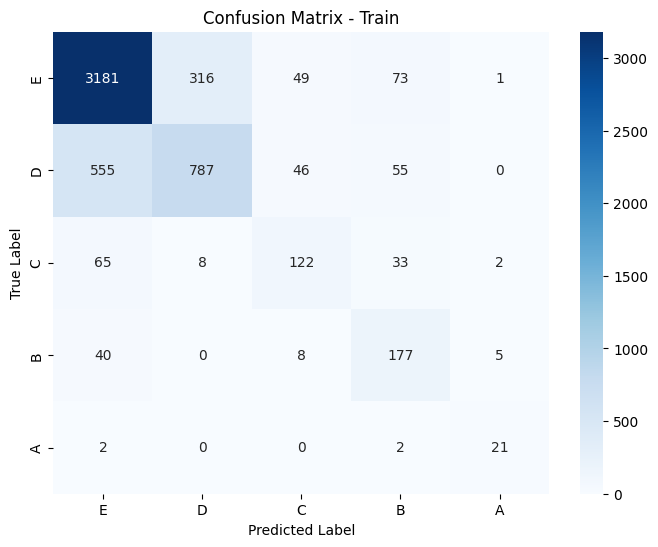

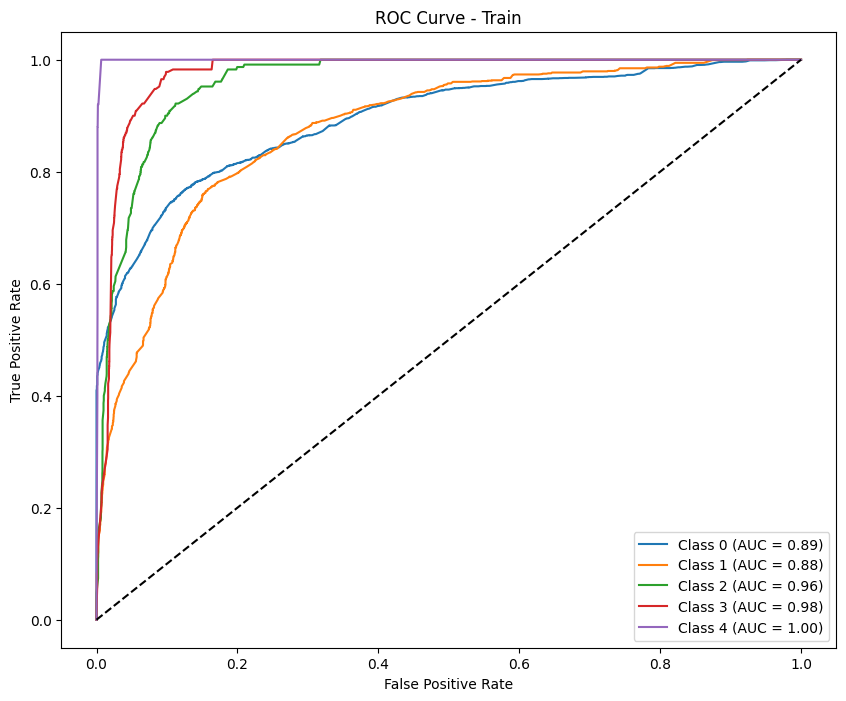


--- Test Metrics ---
F1 Score (per class): [0.89889299 0.         0.         0.         0.        ]
Precision (per class): [0.81635389 0.         0.         0.         0.        ]
Recall (per class): [1. 0. 0. 0. 0.]
Accuracy: 0.8164
AUC (One-vs-Rest): 0.7381

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       609
           D       0.00      0.00      0.00        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.82       746
   macro avg       0.16      0.20      0.18       746
weighted avg       0.67      0.82      0.73       746



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


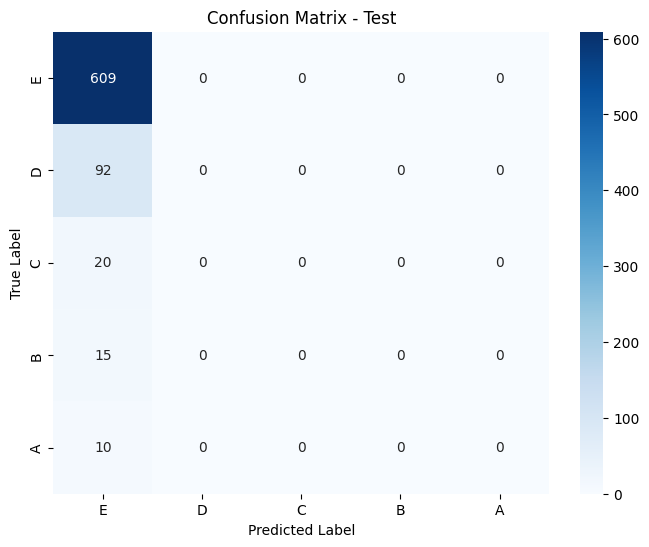

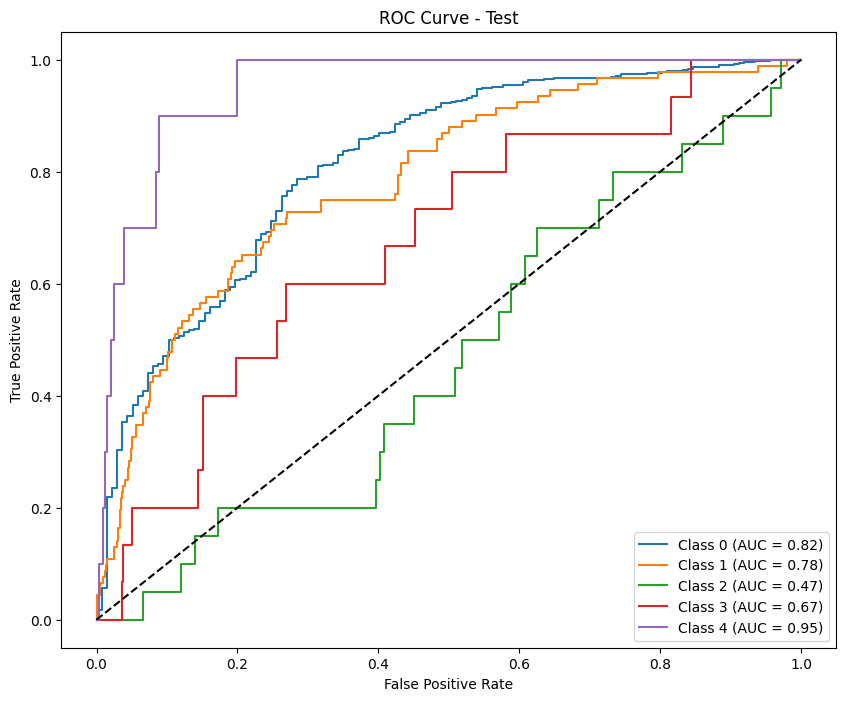


Permutation Importance for phase: phase2


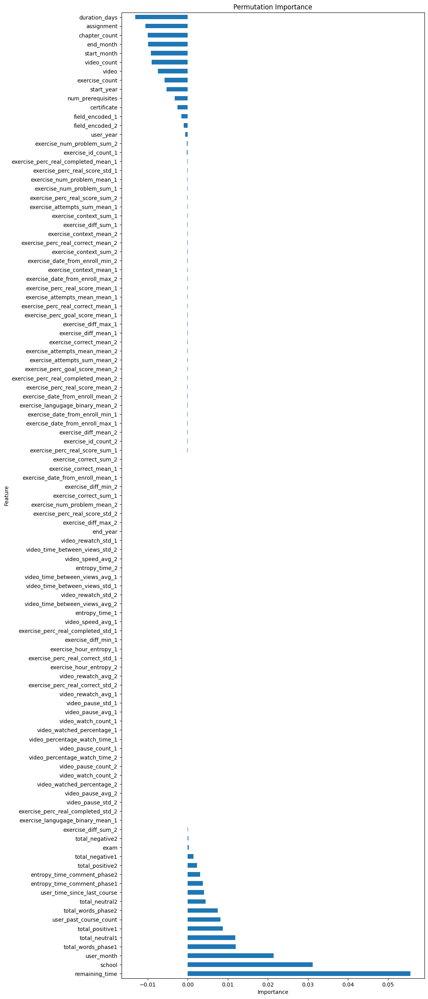

               Feature  Importance
20      remaining_time    0.055628
0               school    0.031205
8           user_month    0.021494
60  total_words_phase1    0.012031
63      total_neutral1    0.011851
..                 ...         ...
4          start_month   -0.009215
6            end_month   -0.009891
11       chapter_count   -0.010004
16          assignment   -0.010544
19       duration_days   -0.013113

[107 rows x 2 columns]

Lasso Feature Selection for phase: phase2


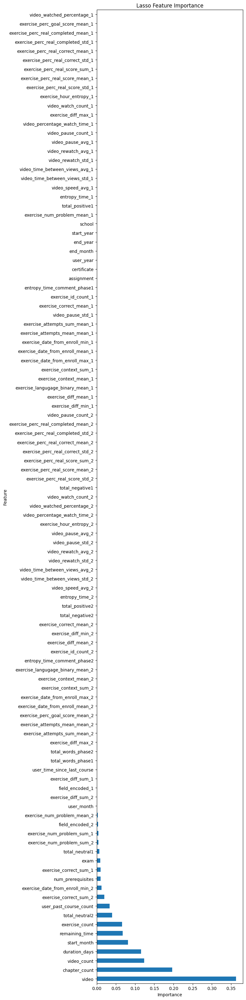

                                Feature  Importance
17                                video    0.362884
11                        chapter_count    0.197127
9                           video_count    0.123460
19                        duration_days    0.115316
4                           start_month    0.081763
..                                  ...         ...
42    exercise_perc_real_correct_mean_1    0.000000
41   exercise_perc_real_completed_std_1    0.000000
40  exercise_perc_real_completed_mean_1    0.000000
39      exercise_perc_goal_score_mean_1    0.000000
49           video_watched_percentage_1    0.000000

[107 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                            Feature  Importance
107                  Random Feature    0.188492
20                   remaining_time    0.122059
16                       assignment    0.079812
17                            video    0.076446
0                            school    0.061007
..

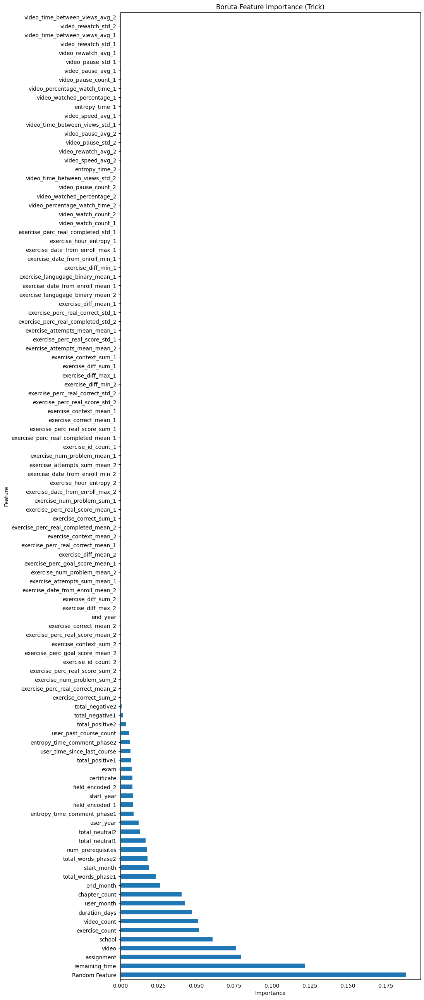

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None
Results saved as test_results_undersample_robust_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.83612858 0.68634969 0.48684211 0.57467532 0.68      ]
Precision (per class): [0.92038462 0.66394659 0.35662651 0.43276284 0.5483871 ]
Recall (per class): [0.76600512 0.71031746 0.76683938 0.85507246 0.89473684]
Accuracy: 0.7558
AUC (One-vs-Rest): 0.9366

Classification Report:
              precision    recall  f1-score   support

           E       0.92      0.77      0.84      3124
           D       0.66      0.71      0.69      1260
           C       0.36      0.77      0.49       193
           B       0.43      0.86      0.57       207
           A       0.55      0.89      0.68        19

    accuracy                           0.76      4803
   macro 

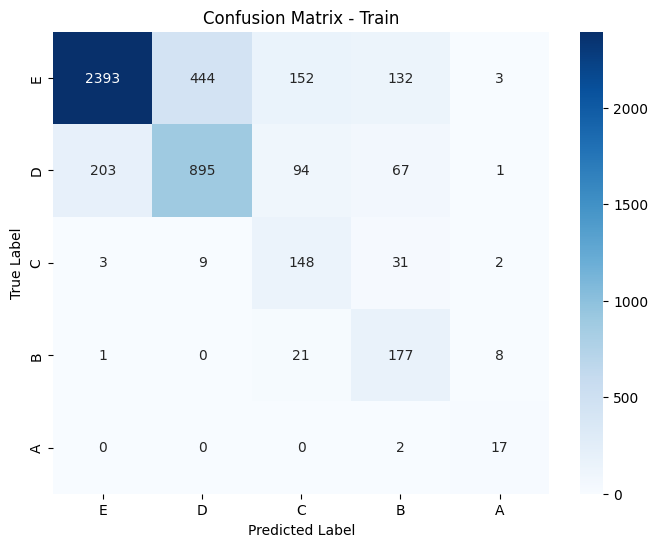

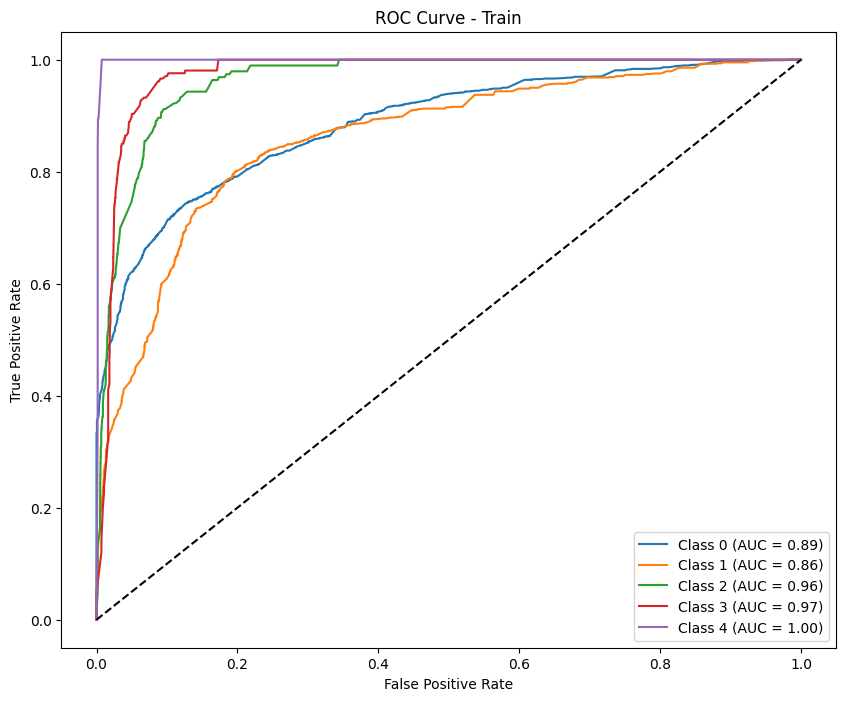


--- Test Metrics ---
F1 Score (per class): [0.89671002 0.         0.         0.         0.        ]
Precision (per class): [0.81502086 0.         0.         0.         0.        ]
Recall (per class): [0.99659864 0.         0.         0.         0.        ]
Accuracy: 0.8128
AUC (One-vs-Rest): 0.6346

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       588
           D       0.00      0.00      0.00        87
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.81       721
   macro avg       0.16      0.20      0.18       721
weighted avg       0.66      0.81      0.73       721



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


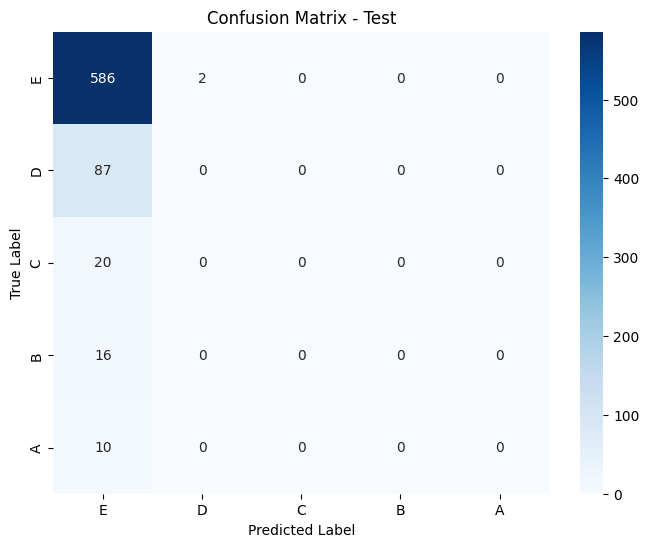

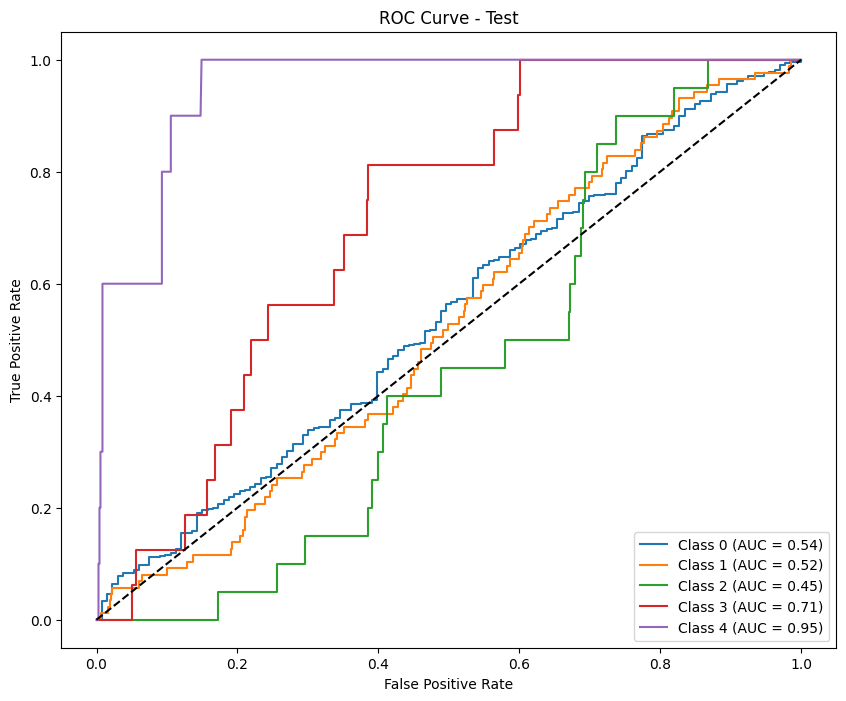

Results saved as test_results_calibrate_undersample_robust_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.8583878  0.64085447 0.56122449 0.62925852 0.71428571]
Precision (per class): [0.83525136 0.72948328 0.55276382 0.53767123 0.65217391]
Recall (per class): [0.88284251 0.57142857 0.56994819 0.75845411 0.78947368]
Accuracy: 0.7828
AUC (One-vs-Rest): 0.9448

Classification Report:
              precision    recall  f1-score   support

           E       0.84      0.88      0.86      3124
           D       0.73      0.57      0.64      1260
           C       0.55      0.57      0.56       193
           B       0.54      0.76      0.63       207
           A       0.65      0.79      0.71        19

    accuracy                           0.78      4803
   macro avg       0.66      0.71      0.68      4803
weighted avg       0.78      0.78      0.78      4803



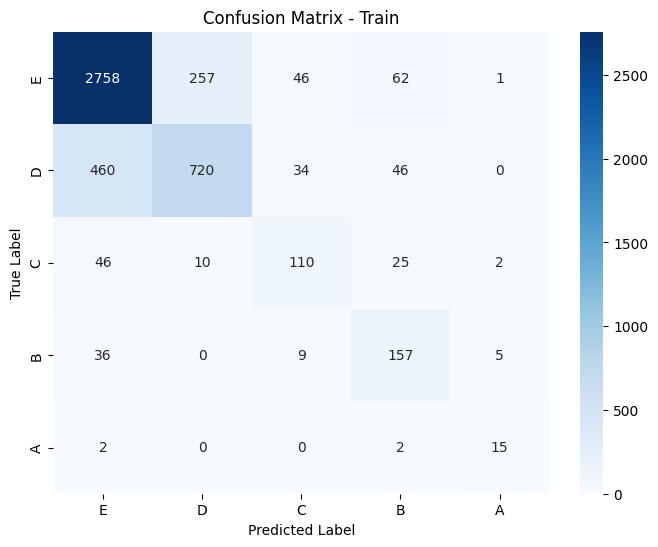

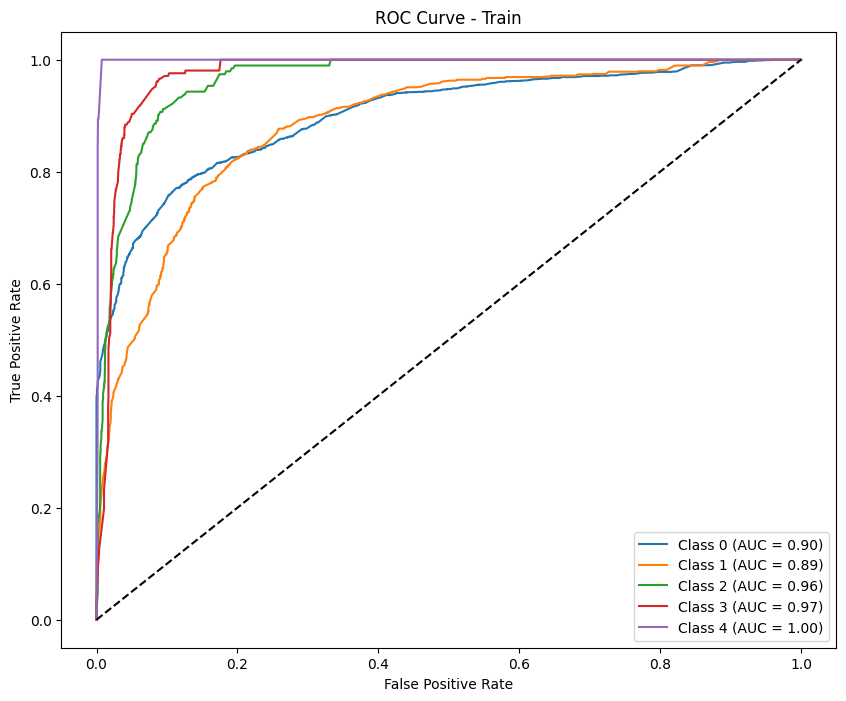


--- Test Metrics ---
F1 Score (per class): [0.89839572 0.         0.         0.         0.        ]
Precision (per class): [0.81553398 0.         0.         0.         0.        ]
Recall (per class): [1. 0. 0. 0. 0.]
Accuracy: 0.8155
AUC (One-vs-Rest): 0.6346

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       588
           D       0.00      0.00      0.00        87
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.82       721
   macro avg       0.16      0.20      0.18       721
weighted avg       0.67      0.82      0.73       721



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


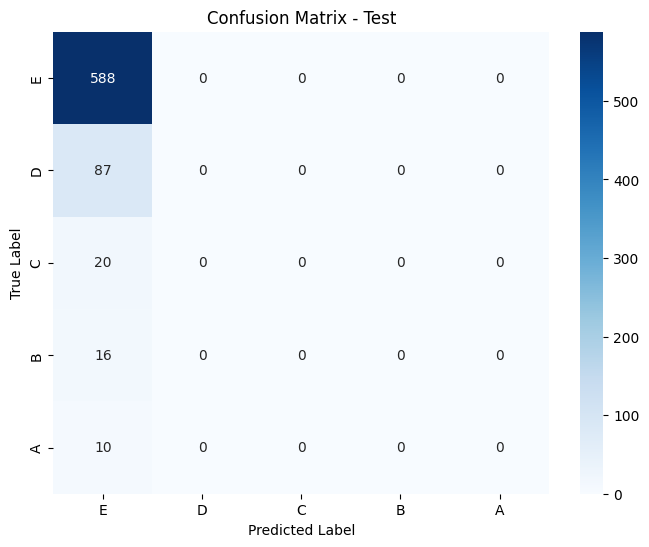

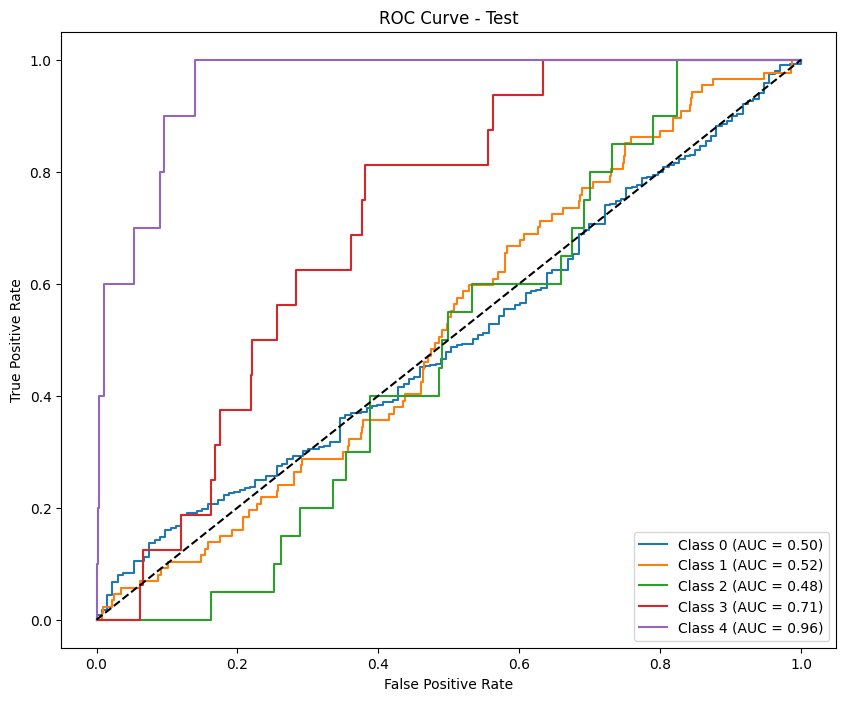

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None
Results saved as test_results_undersample_robust_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.83924692 0.71054852 0.46111111 0.6984127  0.68292683]
Precision (per class): [0.92350598 0.69817579 0.32046332 0.60273973 0.51851852]
Recall (per class): [0.76907764 0.7233677  0.82178218 0.83018868 1.        ]
Accuracy: 0.7656
AUC (One-vs-Rest): 0.9434

Classification Report:
              precision    recall  f1-score   support

           E       0.92      0.77      0.84      1507
           D       0.70      0.72      0.71       582
           C       0.32      0.82      0.46       101
           B       0.60      0.83      0.70       159
           A       0.52      1.00      0.68        14

    accuracy                           0.77      2363
   macro 

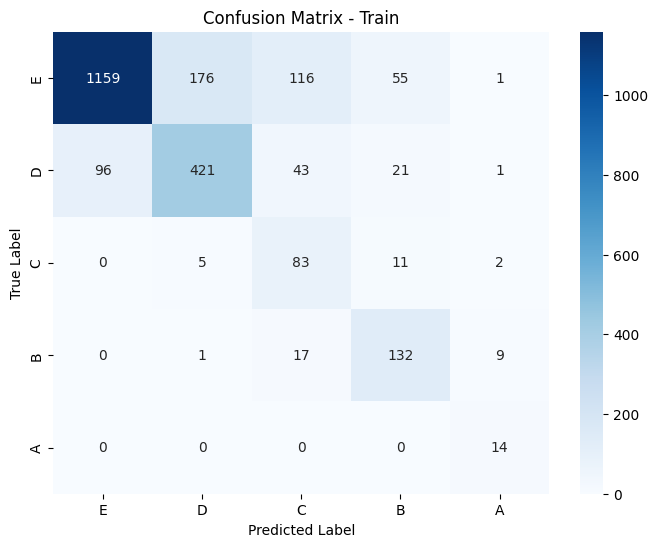

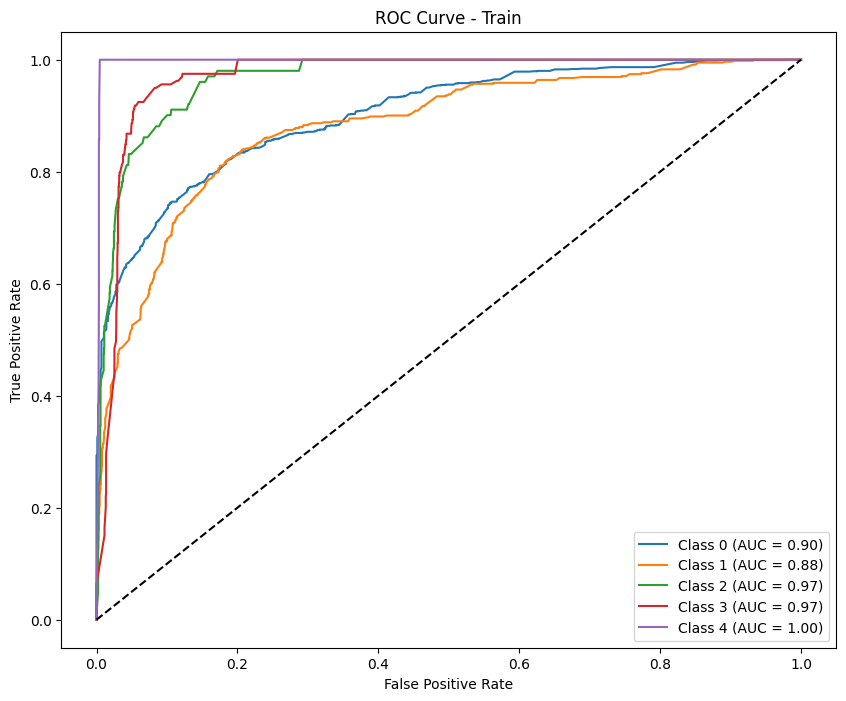

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.88436482 0.02020202 0.         0.         0.        ]
Precision (per class): [0.80683507 0.07142857 0.         0.         0.        ]
Recall (per class): [0.97837838 0.01176471 0.         0.         0.        ]
Accuracy: 0.7918
AUC (One-vs-Rest): 0.5922

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.98      0.88       555
           D       0.07      0.01      0.02        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.79       687
   macro avg       0.18      0.20      0.18       687
weighted avg       0.66      0.79      0.72       687



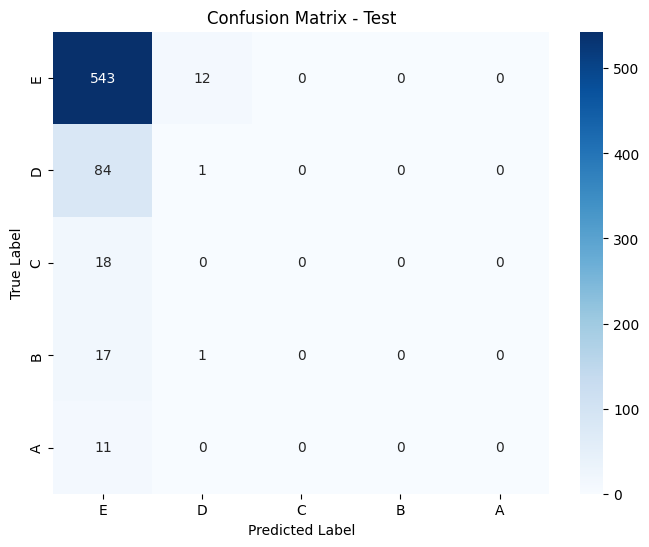

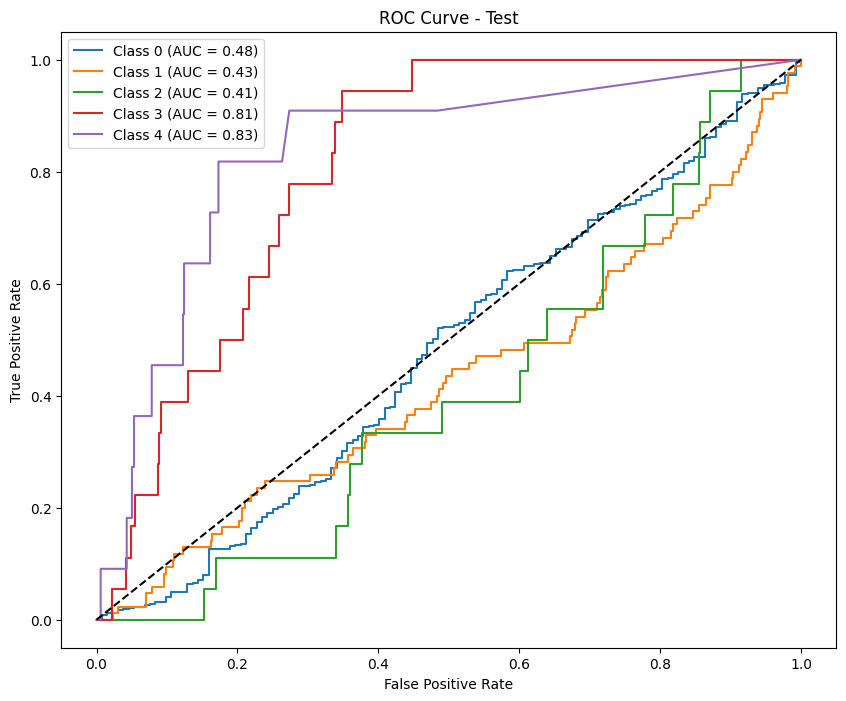

Results saved as test_results_calibrate_undersample_robust_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.87951422 0.672148   0.61206897 0.70391061 0.70588235]
Precision (per class): [0.84833539 0.83631714 0.54198473 0.63316583 0.6       ]
Recall (per class): [0.91307233 0.56185567 0.7029703  0.79245283 0.85714286]
Accuracy: 0.8091
AUC (One-vs-Rest): 0.9506

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.91      0.88      1507
           D       0.84      0.56      0.67       582
           C       0.54      0.70      0.61       101
           B       0.63      0.79      0.70       159
           A       0.60      0.86      0.71        14

    accuracy                           0.81      2363
   macro avg       0.69      0.77      0.71      2363
weighted avg       0.82      0.81      0.80      2363



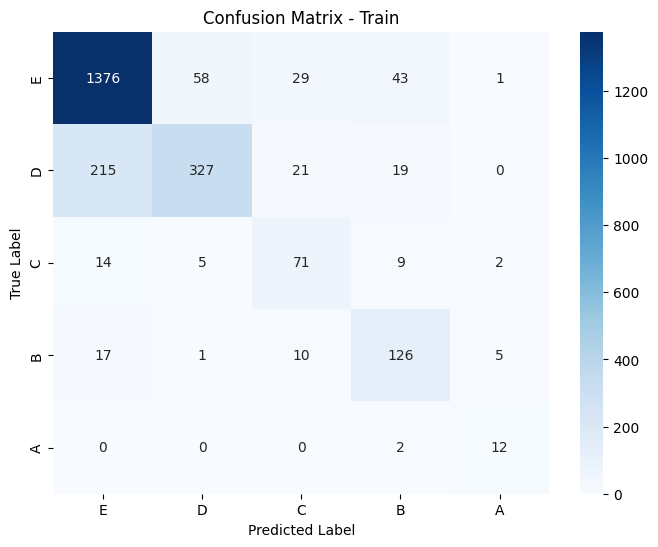

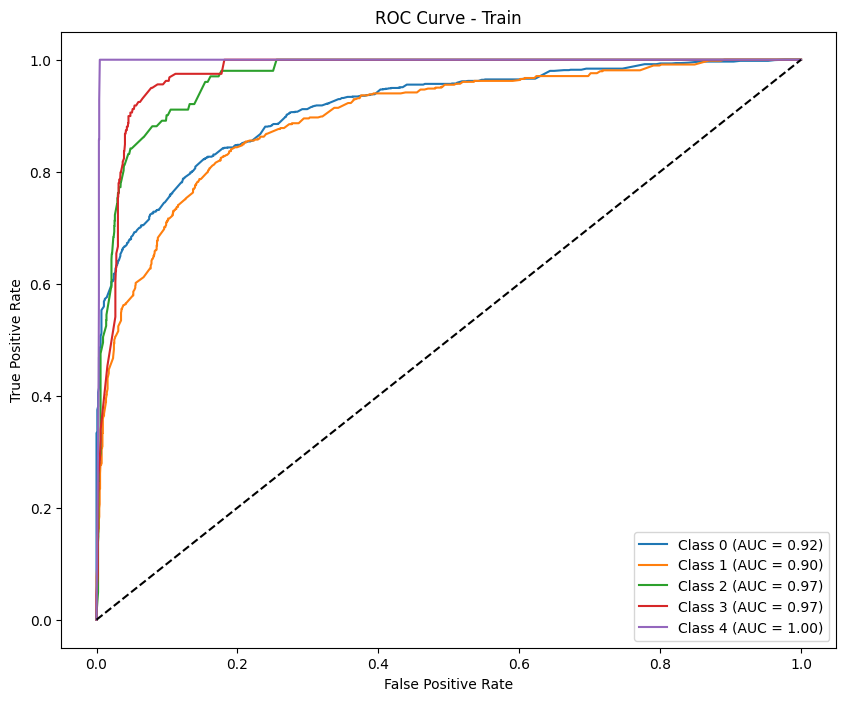


--- Test Metrics ---
F1 Score (per class): [0.89371981 0.         0.         0.         0.        ]
Precision (per class): [0.80786026 0.         0.         0.         0.        ]
Recall (per class): [1. 0. 0. 0. 0.]
Accuracy: 0.8079
AUC (One-vs-Rest): 0.5995

Classification Report:
              precision    recall  f1-score   support

           E       0.81      1.00      0.89       555
           D       0.00      0.00      0.00        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.81       687
   macro avg       0.16      0.20      0.18       687
weighted avg       0.65      0.81      0.72       687



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


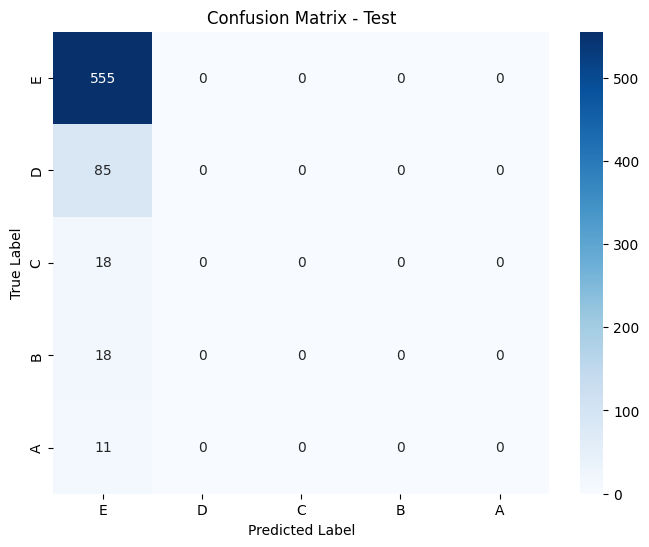

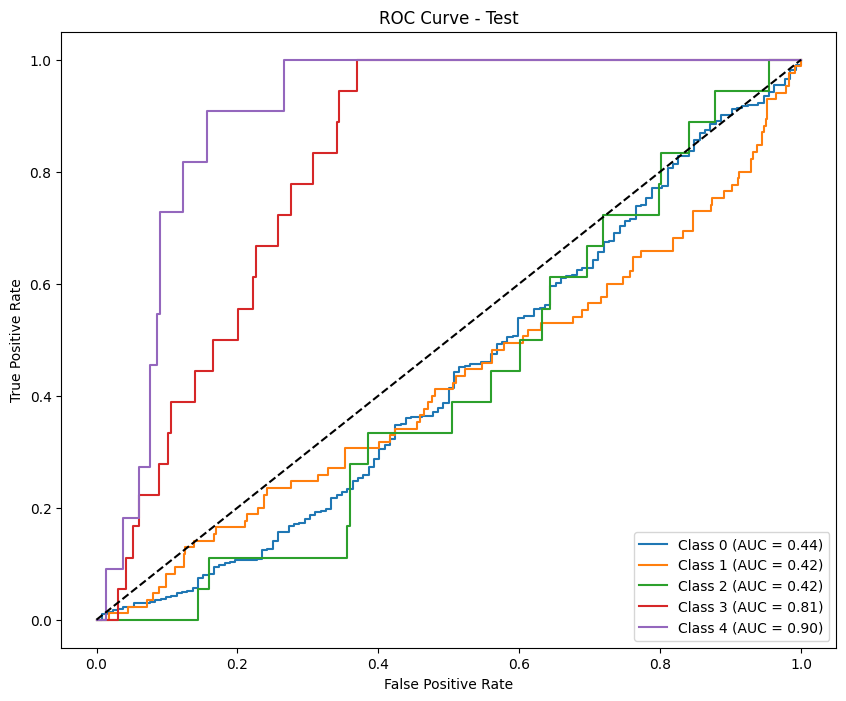

In [29]:
hyperparams = {
    "phase1": hp_1,
    "phase2": hp_2,
    "phase3": hp_3,
    "phase4": hp_4
}

for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_undersample_phase(phase, metric='f1_macro', scale='robust', hyper=hyperparams[phase]) 

### oversample

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

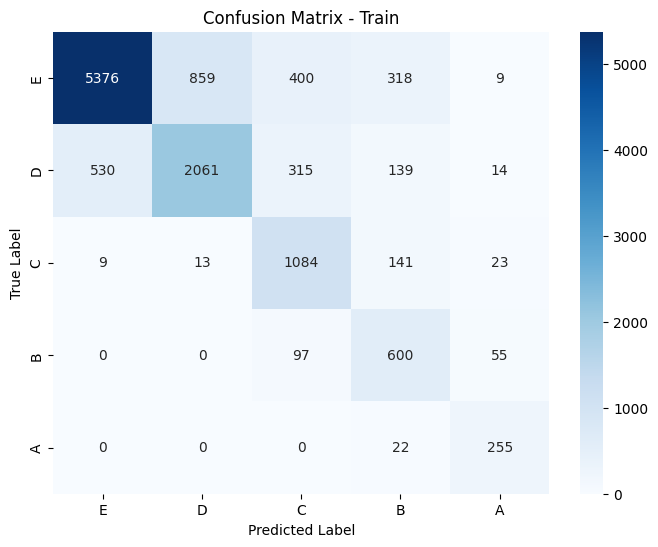

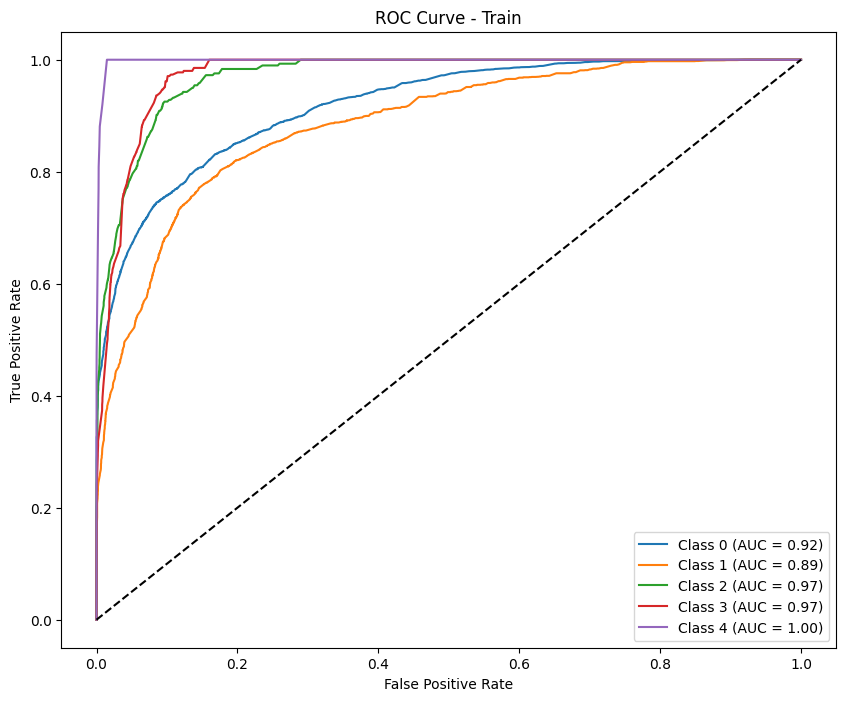

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.91948834 0.35036496 0.         0.         0.        ]
Precision (per class): [0.8569425  0.55813953 0.         0.         0.        ]
Recall (per class): [0.99188312 0.25531915 0.         0.         0.        ]
Accuracy: 0.8399
AUC (One-vs-Rest): 0.8493

Classification Report:
              precision    recall  f1-score   support

           E       0.86      0.99      0.92       616
           D       0.56      0.26      0.35        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.84       756
   macro avg       0.28      0.25      0.25       756
weighted avg       0.77      0.84      0.79       756



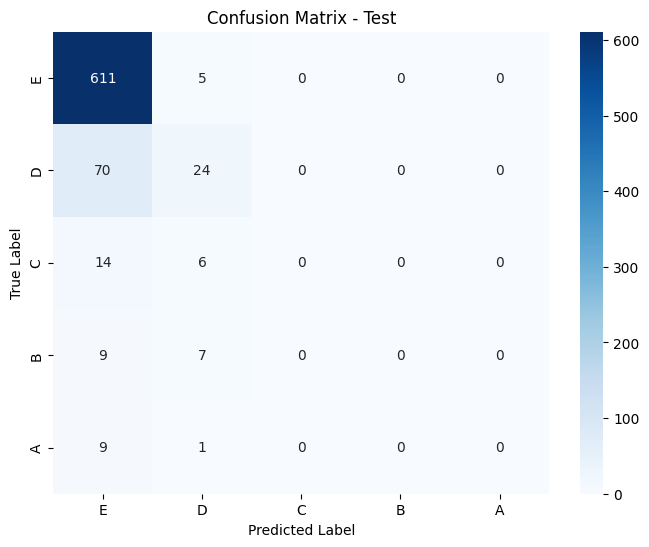

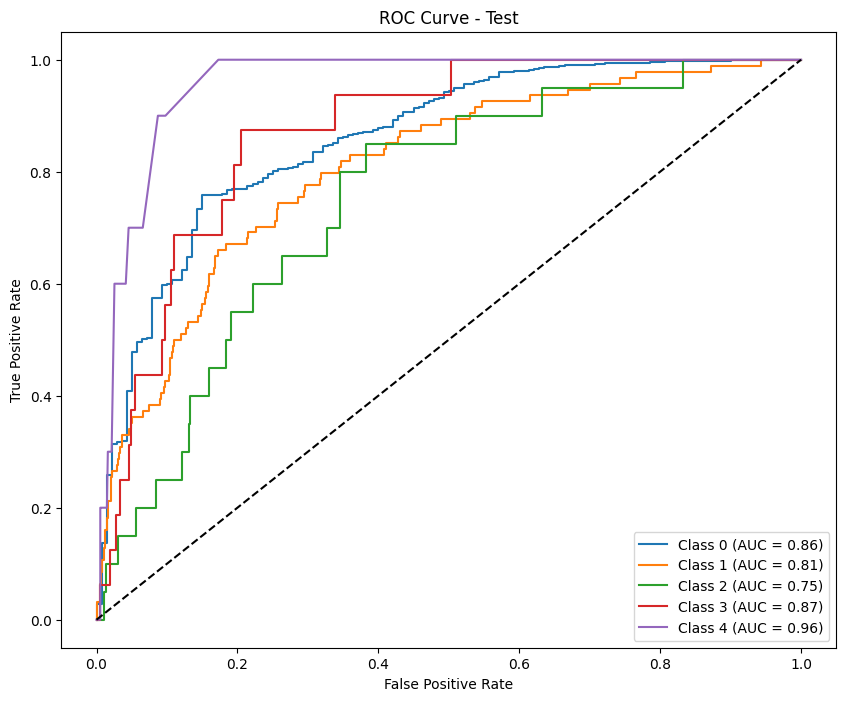

Results saved as test_results_calibrate_undersample_robust_f1_macro_phase1.csv
Results for phase: phase1

--- Train Metrics ---
F1 Score (per class): [0.85137482 0.66053696 0.70319046 0.66980024 0.8457539 ]
Precision (per class): [0.85783027 0.75493905 0.59519913 0.6        0.81333333]
Recall (per class): [0.8450158  0.58711997 0.85905512 0.75797872 0.88086643]
Accuracy: 0.7779
AUC (One-vs-Rest): 0.9533

Classification Report:
              precision    recall  f1-score   support

           E       0.86      0.85      0.85      6962
           D       0.75      0.59      0.66      3059
           C       0.60      0.86      0.70      1270
           B       0.60      0.76      0.67       752
           A       0.81      0.88      0.85       277

    accuracy                           0.78     12320
   macro avg       0.72      0.79      0.75     12320
weighted avg       0.79      0.78      0.78     12320



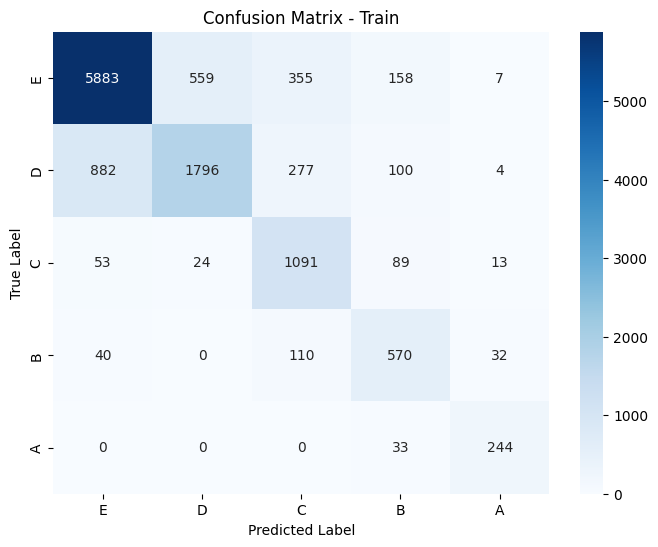

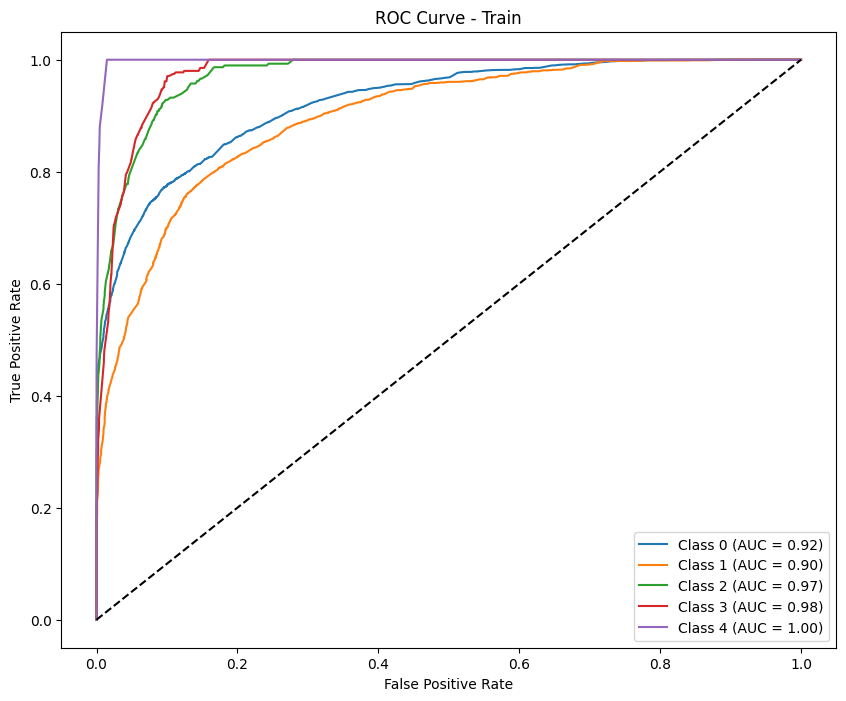


--- Test Metrics ---
F1 Score (per class): [0.9084195  0.17857143 0.         0.         0.        ]
Precision (per class): [0.83333333 0.55555556 0.         0.         0.        ]
Recall (per class): [0.99837662 0.10638298 0.         0.         0.        ]
Accuracy: 0.8267
AUC (One-vs-Rest): 0.8463

Classification Report:
              precision    recall  f1-score   support

           E       0.83      1.00      0.91       616
           D       0.56      0.11      0.18        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.83       756
   macro avg       0.28      0.22      0.22       756
weighted avg       0.75      0.83      0.76       756



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


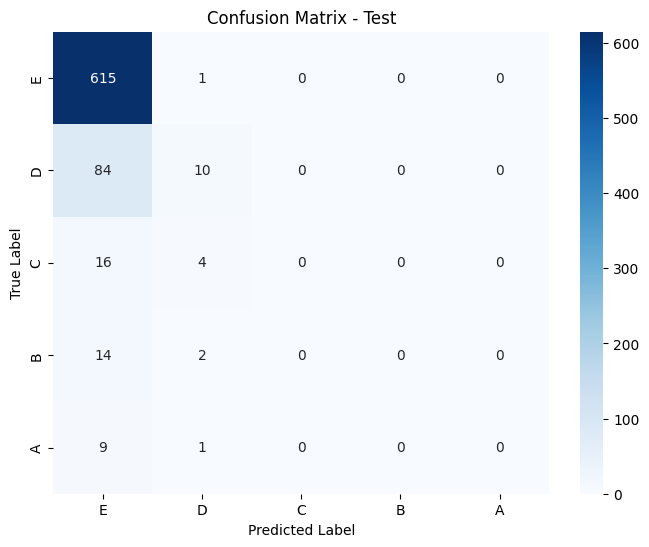

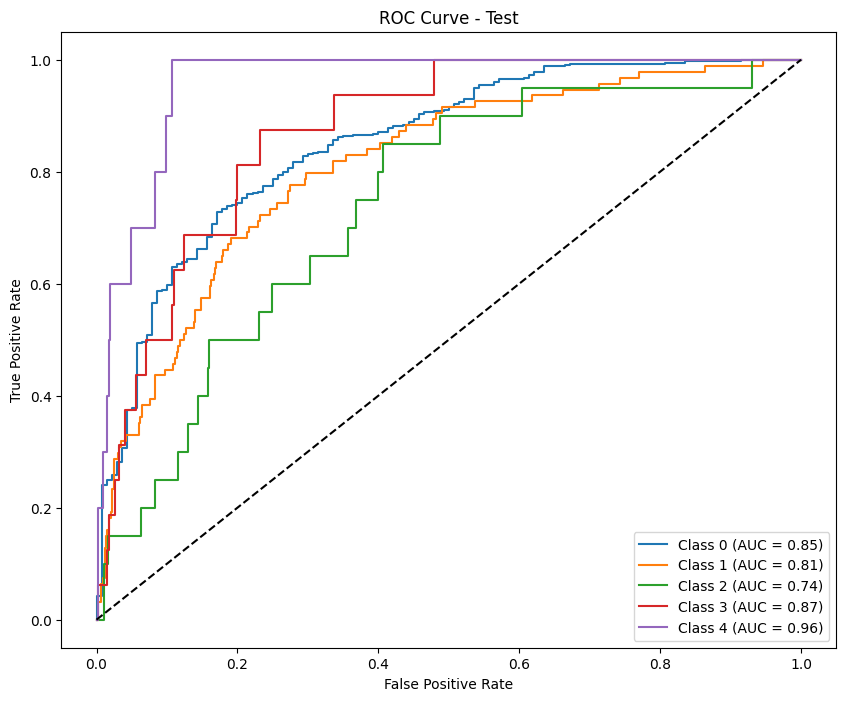


Permutation Importance for phase: phase1


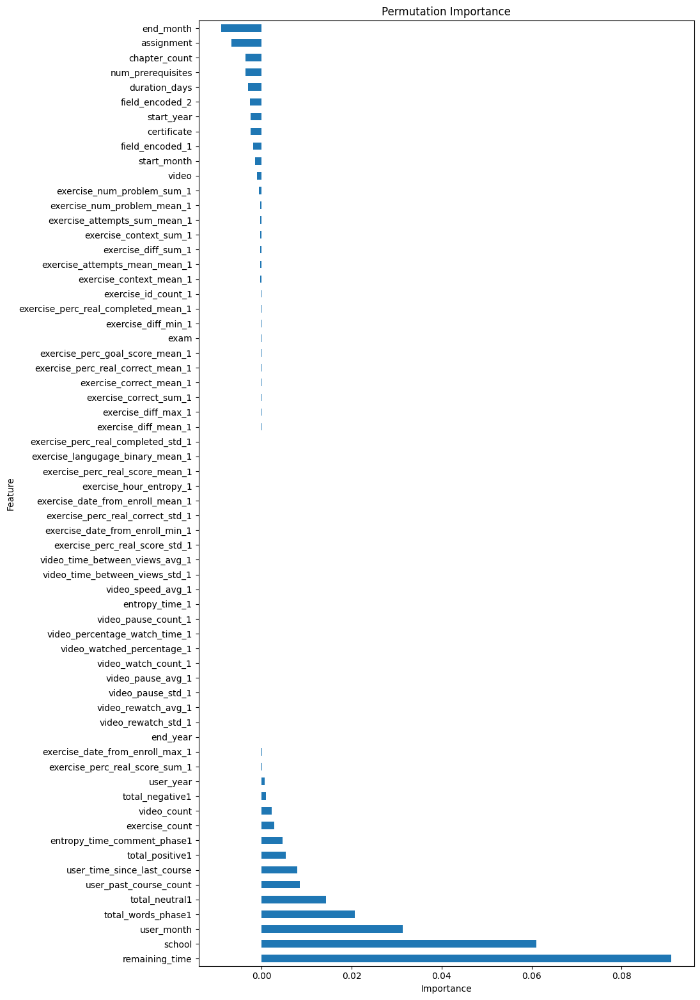

               Feature  Importance
20      remaining_time    0.091082
0               school    0.060988
8           user_month    0.031331
60  total_words_phase1    0.020728
63      total_neutral1    0.014336
..                 ...         ...
19       duration_days   -0.003095
14   num_prerequisites   -0.003663
11       chapter_count   -0.003673
16          assignment   -0.006707
6            end_month   -0.009040

[64 rows x 2 columns]

Lasso Feature Selection for phase: phase1


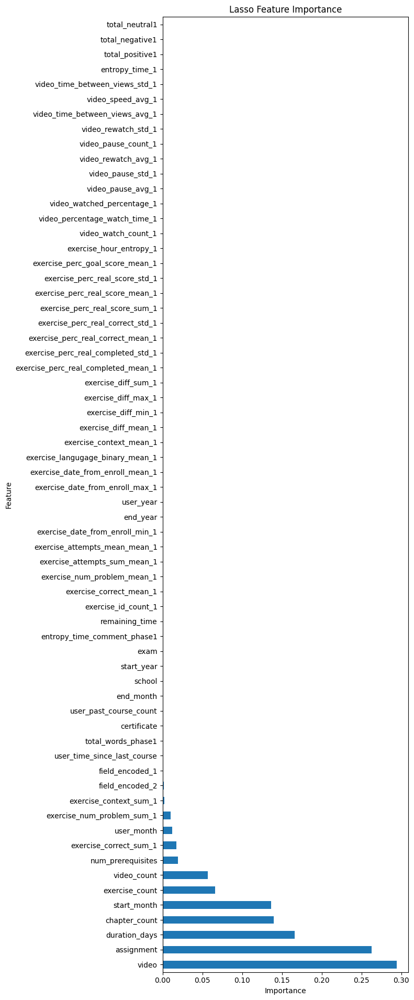

                           Feature  Importance
17                           video    0.294129
16                      assignment    0.263042
19                   duration_days    0.166154
11                   chapter_count    0.139806
4                      start_month    0.136260
..                             ...         ...
57  video_time_between_views_std_1    0.000000
59                  entropy_time_1    0.000000
61                 total_positive1    0.000000
62                 total_negative1    0.000000
63                  total_neutral1    0.000000

[64 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                          Feature  Importance
64                 Random Feature    0.168703
20                 remaining_time    0.146972
16                     assignment    0.086785
17                          video    0.079210
0                          school    0.068828
..                            ...         ...
49     video_watched_percenta

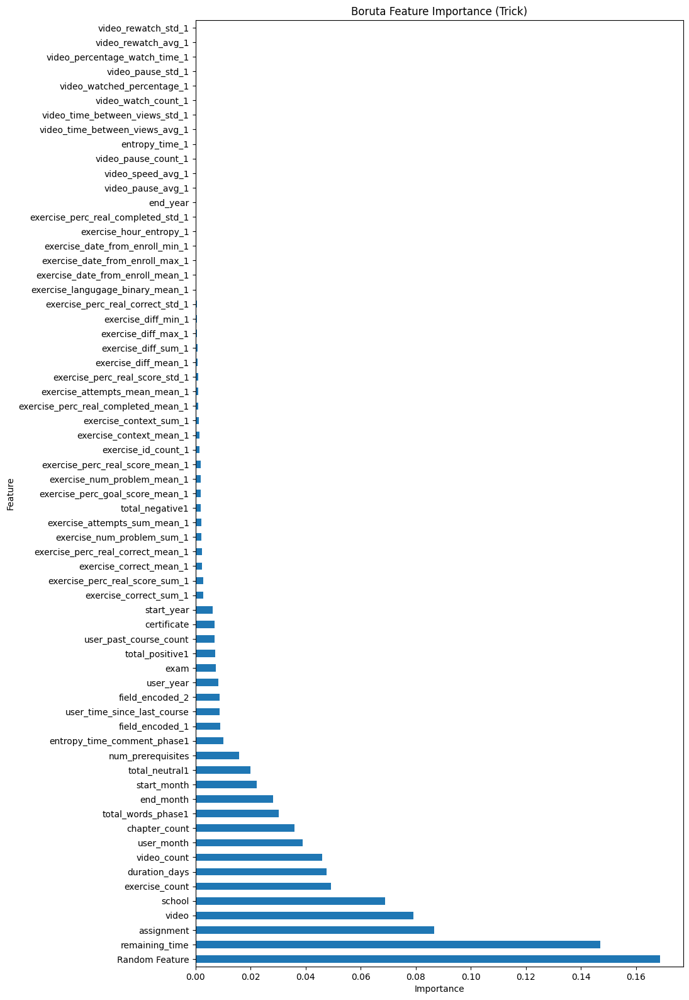

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None
Results saved as test_results_undersample_robust_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.82214506 0.66112013 0.6974359  0.64503245 0.89241623]
Precision (per class): [0.89764111 0.6555332  0.63466667 0.50746269 0.86643836]
Recall (per class): [0.75836299 0.66680311 0.77398374 0.88493151 0.92      ]
Accuracy: 0.7518
AUC (One-vs-Rest): 0.9422

Classification Report:
              precision    recall  f1-score   support

           E       0.90      0.76      0.82      5620
           D       0.66      0.67      0.66      2443
           C       0.63      0.77      0.70      1230
           B       0.51      0.88      0.65       730
           A       0.87      0.92      0.89       275

    accuracy                           0.75     10298
   macro 

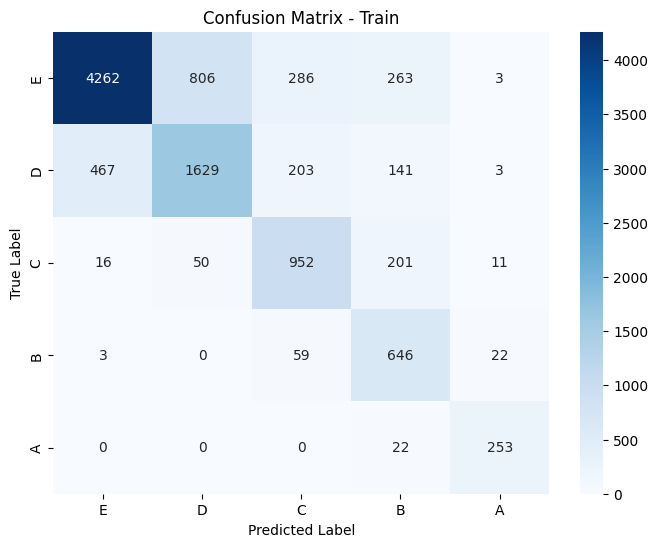

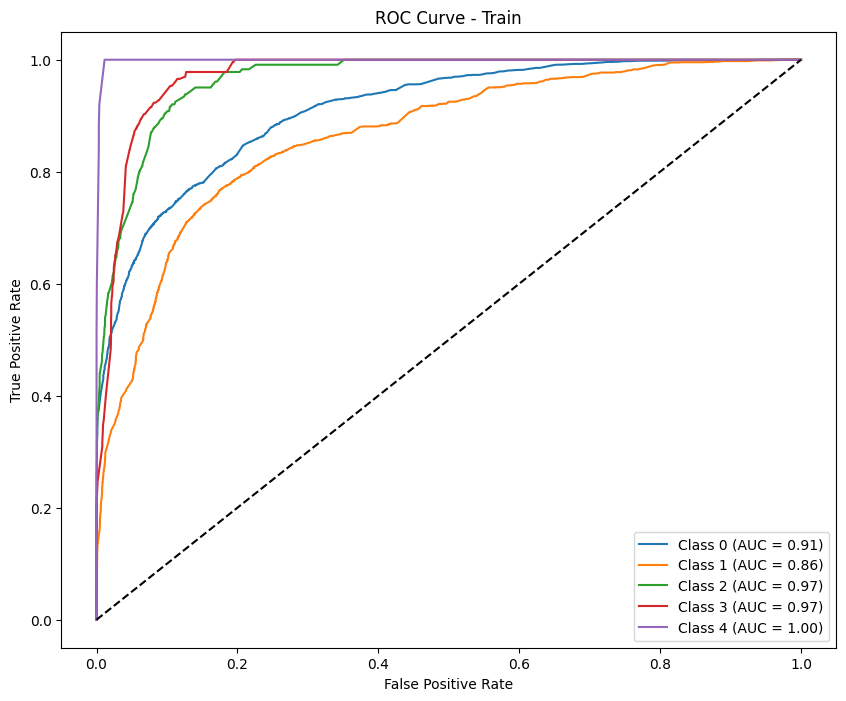


--- Test Metrics ---
F1 Score (per class): [0.90423163 0.08       0.         0.         0.        ]
Precision (per class): [0.82520325 0.5        0.         0.         0.        ]
Recall (per class): [1.         0.04347826 0.         0.         0.        ]
Accuracy: 0.8217
AUC (One-vs-Rest): 0.7504

Classification Report:
              precision    recall  f1-score   support

           E       0.83      1.00      0.90       609
           D       0.50      0.04      0.08        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.82       746
   macro avg       0.27      0.21      0.20       746
weighted avg       0.74      0.82      0.75       746



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


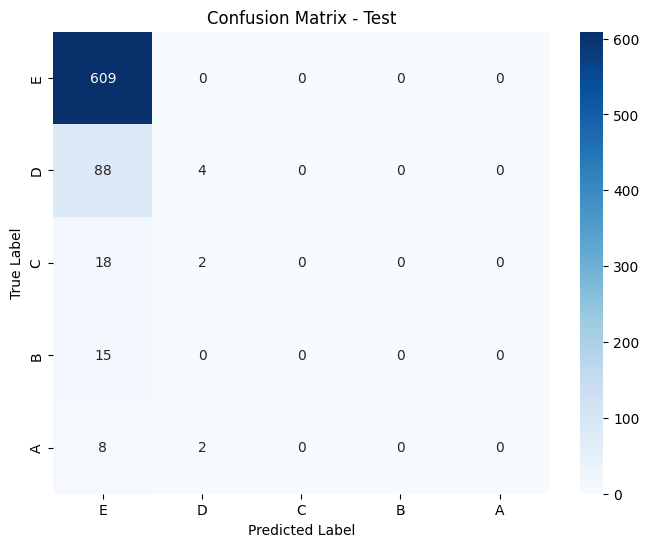

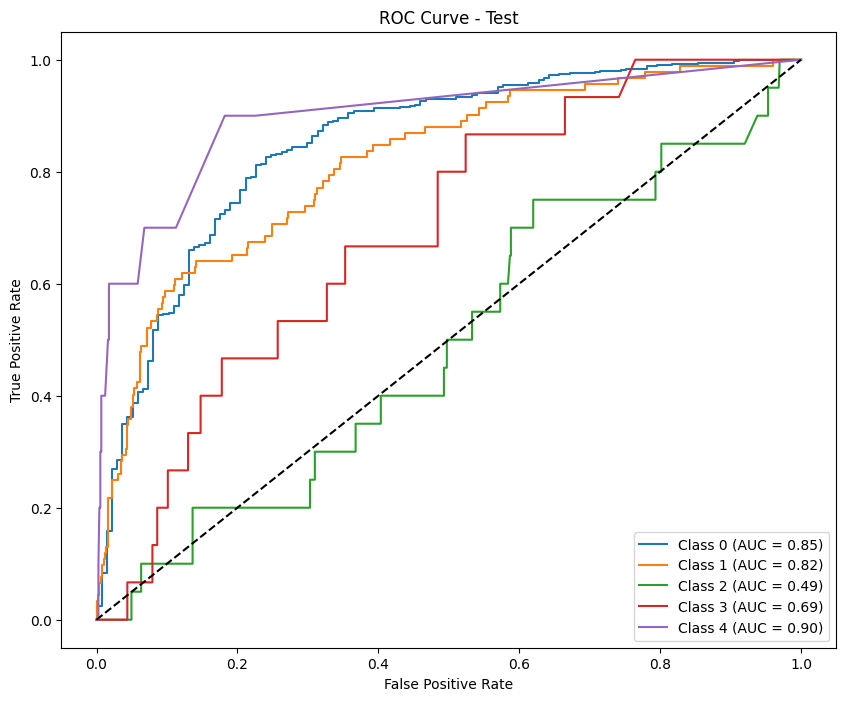

Results saved as test_results_calibrate_undersample_robust_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.84070639 0.61972477 0.71811834 0.68894009 0.89241623]
Precision (per class): [0.84281116 0.704747   0.65526492 0.5944334  0.86643836]
Recall (per class): [0.8386121  0.5530086  0.79430894 0.81917808 0.92      ]
Accuracy: 0.7664
AUC (One-vs-Rest): 0.9465

Classification Report:
              precision    recall  f1-score   support

           E       0.84      0.84      0.84      5620
           D       0.70      0.55      0.62      2443
           C       0.66      0.79      0.72      1230
           B       0.59      0.82      0.69       730
           A       0.87      0.92      0.89       275

    accuracy                           0.77     10298
   macro avg       0.73      0.79      0.75     10298
weighted avg       0.77      0.77      0.76     10298



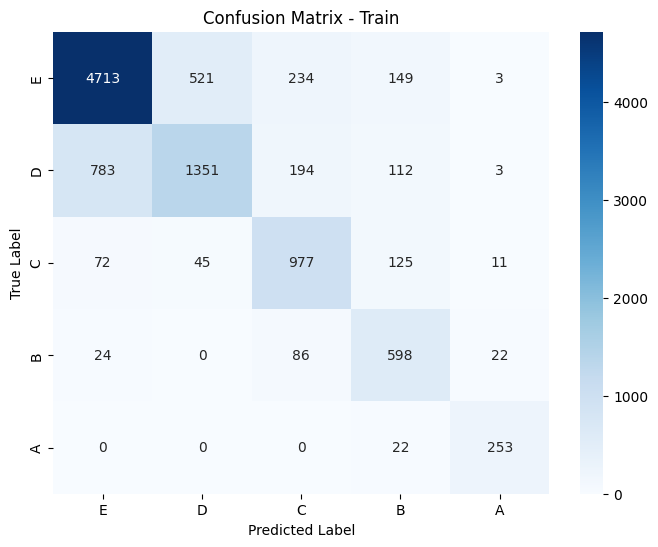

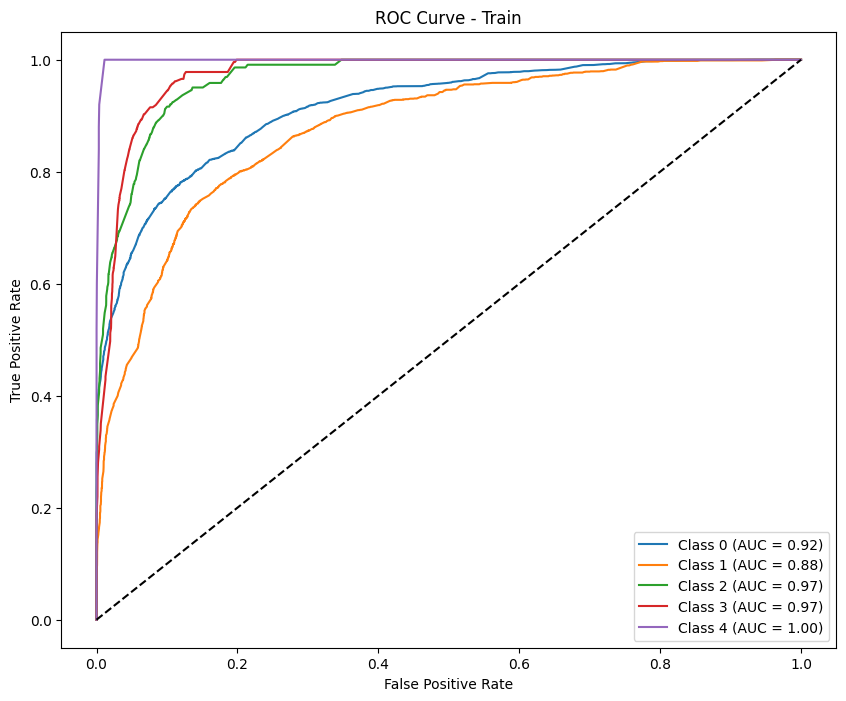


--- Test Metrics ---
F1 Score (per class): [0.89889299 0.         0.         0.         0.        ]
Precision (per class): [0.81635389 0.         0.         0.         0.        ]
Recall (per class): [1. 0. 0. 0. 0.]
Accuracy: 0.8164
AUC (One-vs-Rest): 0.7476

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       609
           D       0.00      0.00      0.00        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.82       746
   macro avg       0.16      0.20      0.18       746
weighted avg       0.67      0.82      0.73       746



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


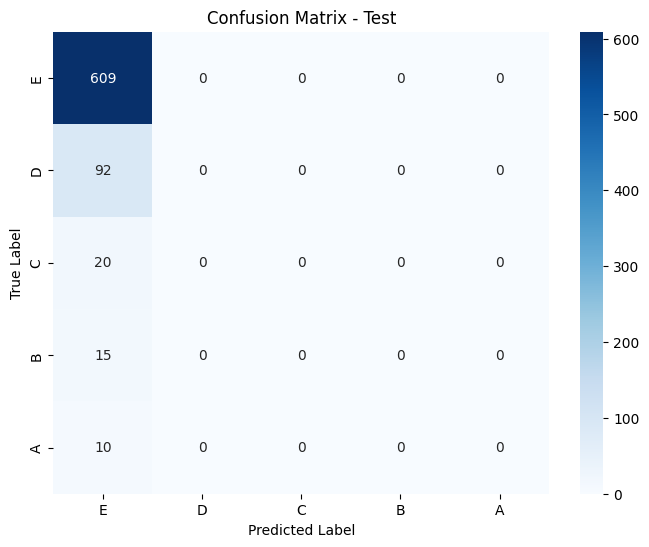

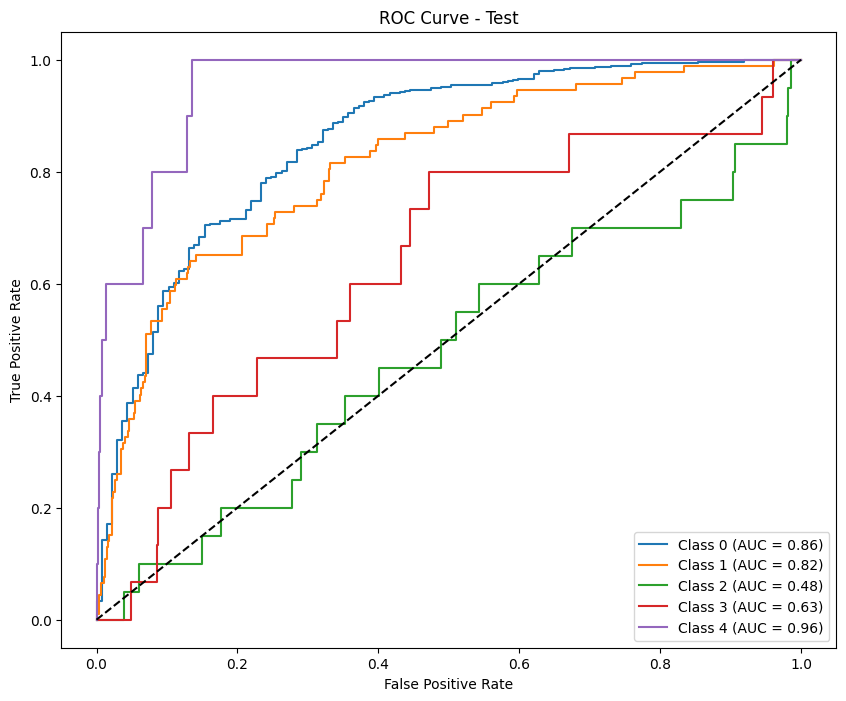


Permutation Importance for phase: phase2


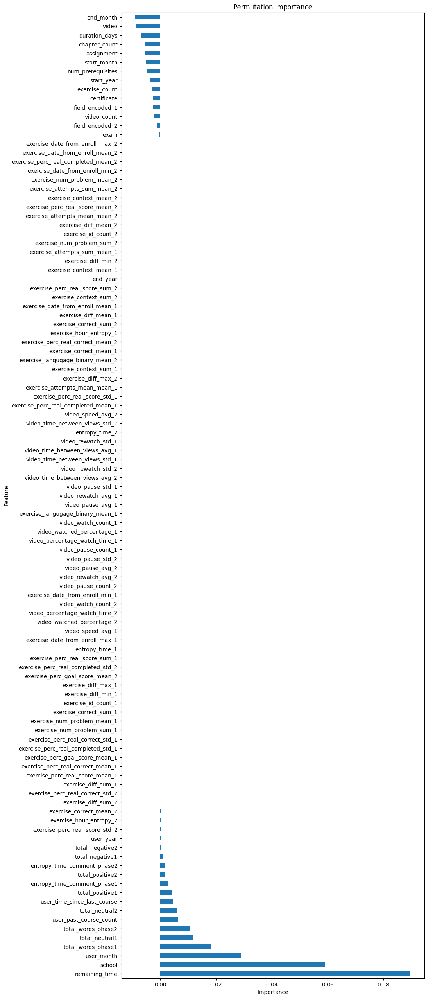

               Feature  Importance
20      remaining_time    0.089750
0               school    0.059077
8           user_month    0.028889
60  total_words_phase1    0.018086
63      total_neutral1    0.011932
..                 ...         ...
16          assignment   -0.005547
11       chapter_count   -0.005632
19       duration_days   -0.006931
17               video   -0.008509
6            end_month   -0.009007

[107 rows x 2 columns]

Lasso Feature Selection for phase: phase2


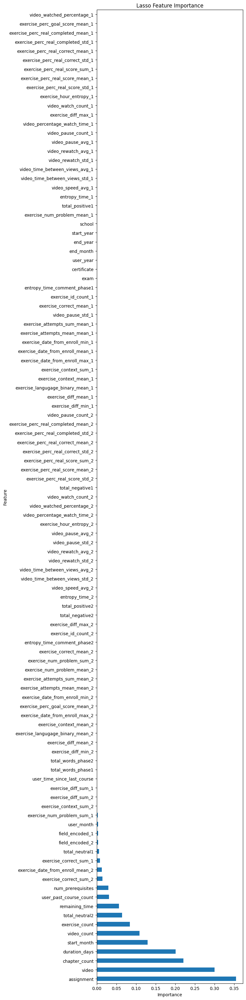

                                Feature  Importance
16                           assignment    0.354874
17                                video    0.300730
11                        chapter_count    0.220789
19                        duration_days    0.201159
4                           start_month    0.129558
..                                  ...         ...
42    exercise_perc_real_correct_mean_1    0.000000
41   exercise_perc_real_completed_std_1    0.000000
40  exercise_perc_real_completed_mean_1    0.000000
39      exercise_perc_goal_score_mean_1    0.000000
49           video_watched_percentage_1    0.000000

[107 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                 Feature  Importance
107       Random Feature    0.131913
20        remaining_time    0.128656
16            assignment    0.085476
17                 video    0.083156
0                 school    0.073505
..                   ...         ...
53     video_pause_std_1    0.0

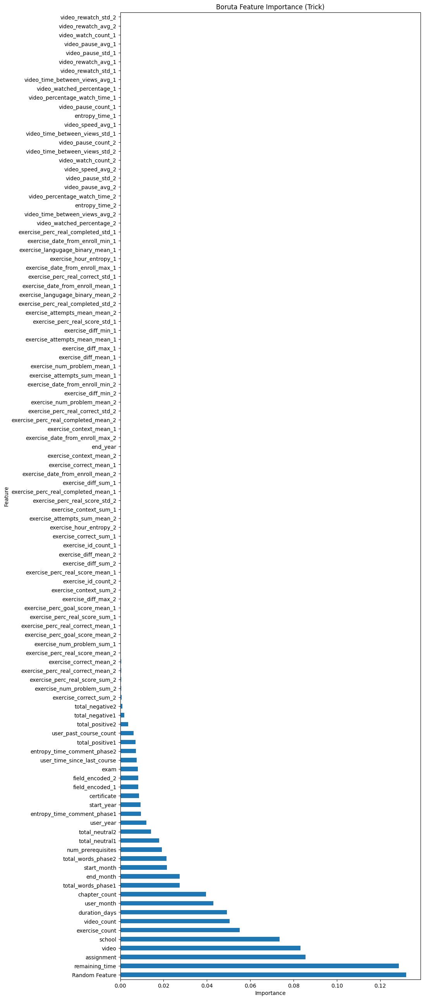

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None
Results saved as test_results_undersample_robust_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.82691903 0.66548043 0.71233886 0.66013072 0.87431694]
Precision (per class): [0.89648883 0.66905188 0.63534823 0.53675819 0.85714286]
Recall (per class): [0.76736924 0.6619469  0.81056161 0.85714286 0.89219331]
Accuracy: 0.7580
AUC (One-vs-Rest): 0.9434

Classification Report:
              precision    recall  f1-score   support

           E       0.90      0.77      0.83      5124
           D       0.67      0.66      0.67      2260
           C       0.64      0.81      0.71      1193
           B       0.54      0.86      0.66       707
           A       0.86      0.89      0.87       269

    accuracy                           0.76      9553
   macro 

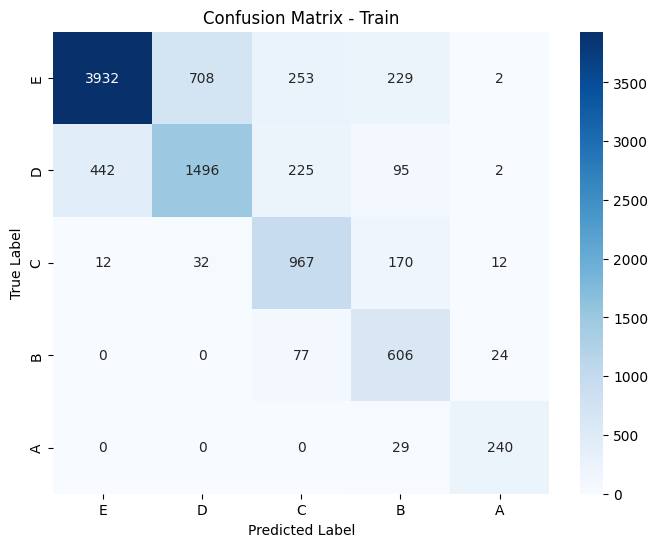

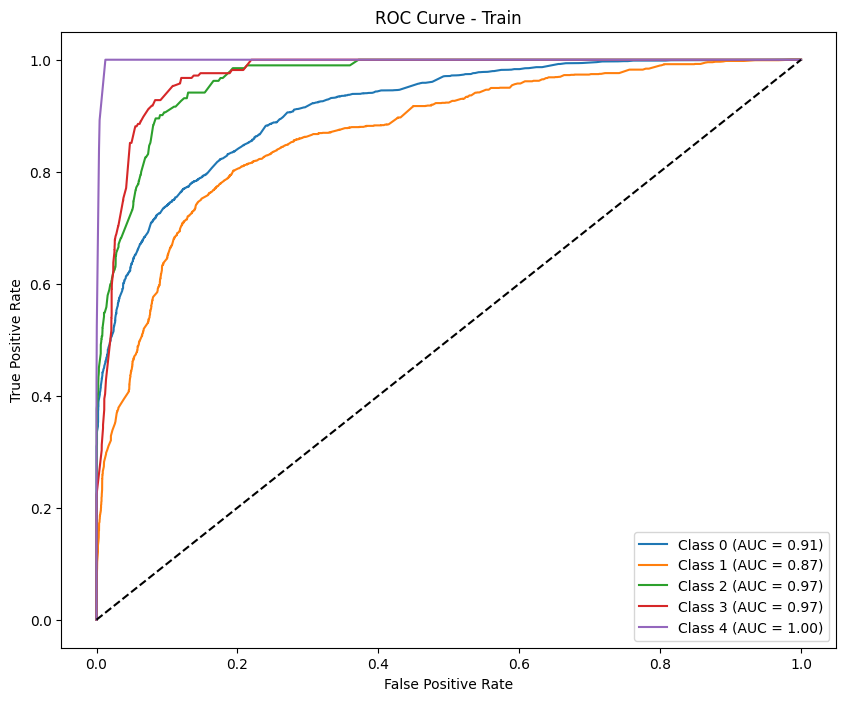


--- Test Metrics ---
F1 Score (per class): [0.89824024 0.         0.         0.         0.        ]
Precision (per class): [0.81641168 0.         0.         0.         0.        ]
Recall (per class): [0.99829932 0.         0.         0.         0.        ]
Accuracy: 0.8141
AUC (One-vs-Rest): 0.5927

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       588
           D       0.00      0.00      0.00        87
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.81       721
   macro avg       0.16      0.20      0.18       721
weighted avg       0.67      0.81      0.73       721



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


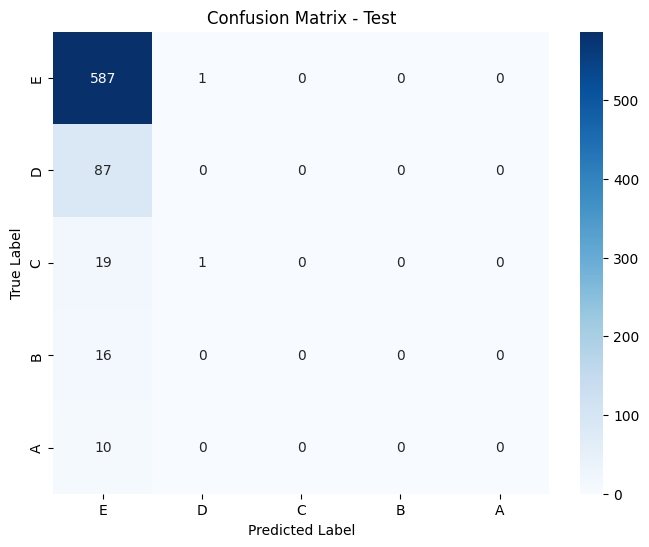

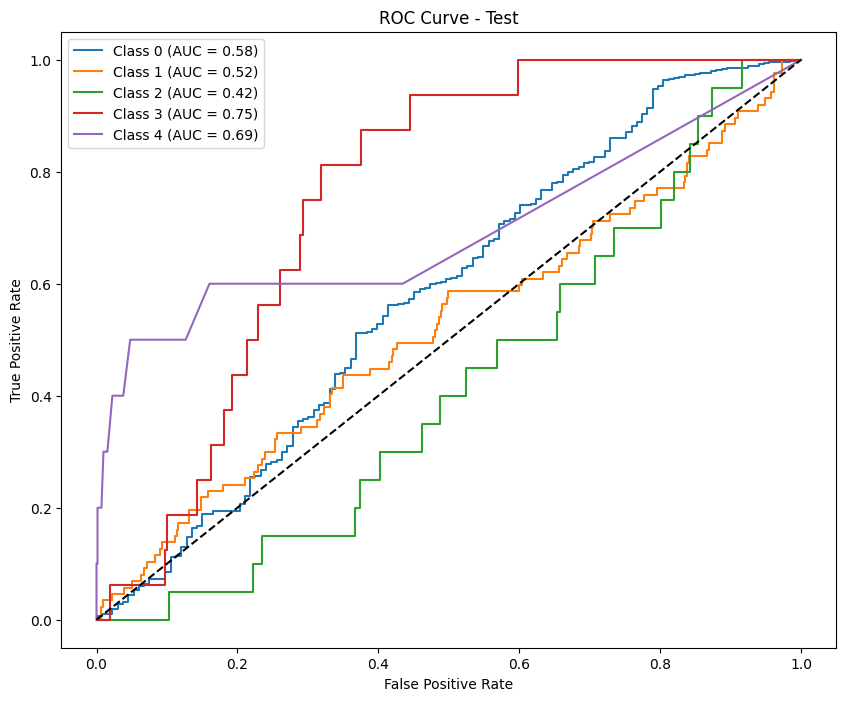

Results saved as test_results_calibrate_undersample_robust_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.8462059  0.63142145 0.72115761 0.70395137 0.87431694]
Precision (per class): [0.83834514 0.72342857 0.67595308 0.61727079 0.85714286]
Recall (per class): [0.85421546 0.56017699 0.77284158 0.81895332 0.89219331]
Accuracy: 0.7730
AUC (One-vs-Rest): 0.9476

Classification Report:
              precision    recall  f1-score   support

           E       0.84      0.85      0.85      5124
           D       0.72      0.56      0.63      2260
           C       0.68      0.77      0.72      1193
           B       0.62      0.82      0.70       707
           A       0.86      0.89      0.87       269

    accuracy                           0.77      9553
   macro avg       0.74      0.78      0.76      9553
weighted avg       0.78      0.77      0.77      9553



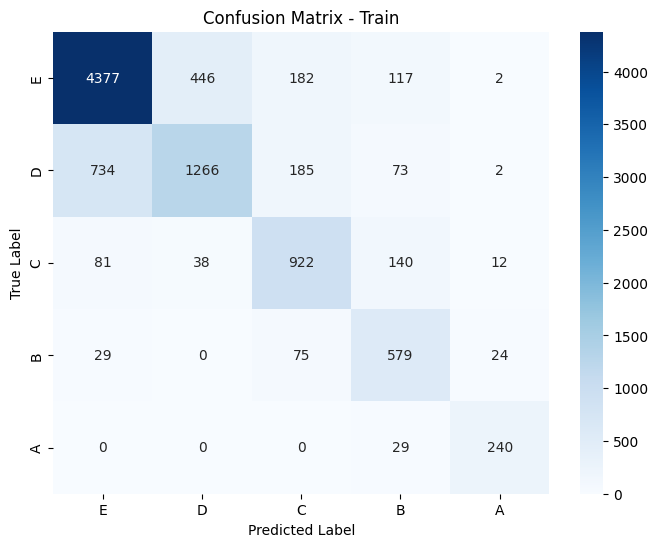

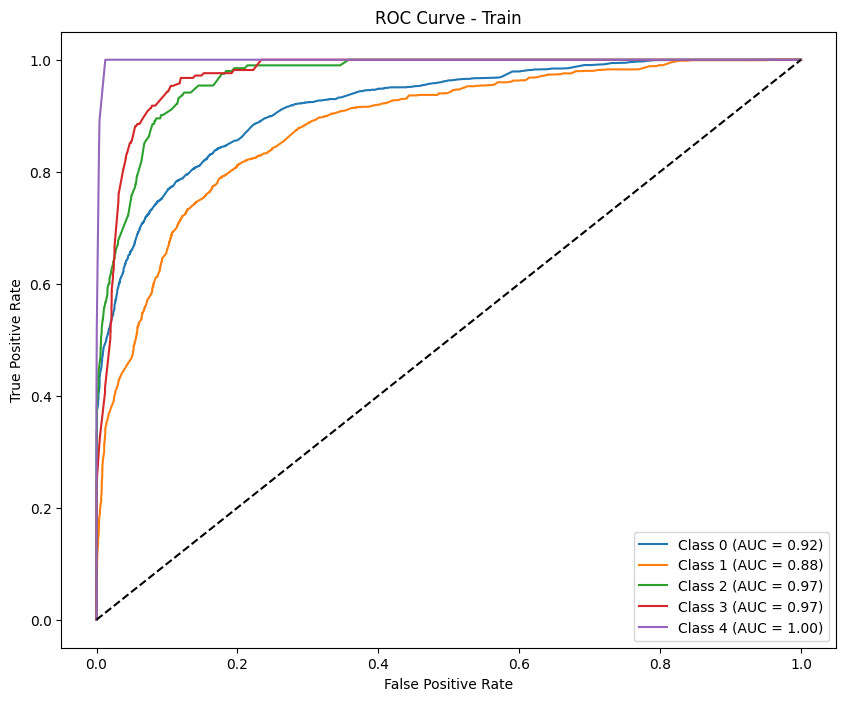


--- Test Metrics ---
F1 Score (per class): [0.89824024 0.         0.         0.         0.        ]
Precision (per class): [0.81641168 0.         0.         0.         0.        ]
Recall (per class): [0.99829932 0.         0.         0.         0.        ]
Accuracy: 0.8141
AUC (One-vs-Rest): 0.6318

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       588
           D       0.00      0.00      0.00        87
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.81       721
   macro avg       0.16      0.20      0.18       721
weighted avg       0.67      0.81      0.73       721



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


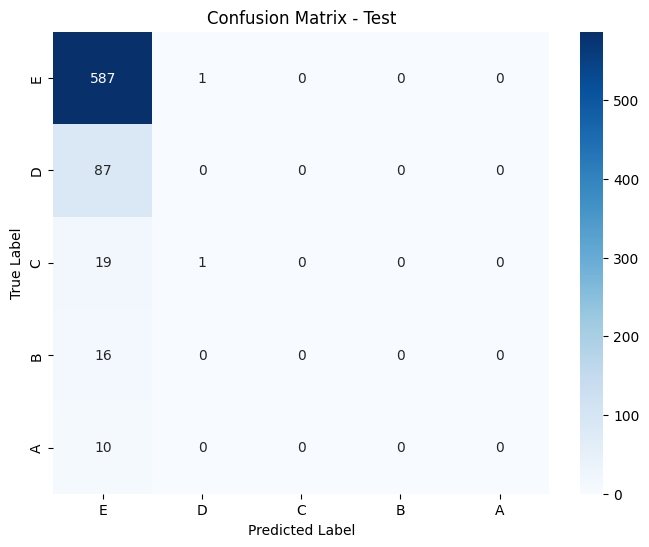

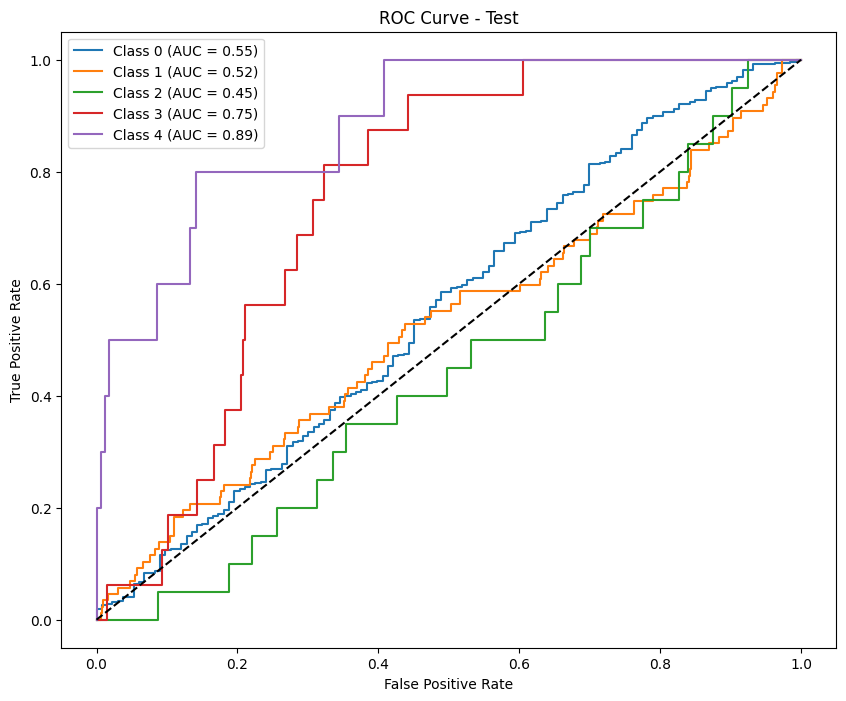

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None
Results saved as test_results_undersample_robust_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.82454784 0.69335055 0.76037588 0.75526316 0.9025641 ]
Precision (per class): [0.90040513 0.70844327 0.66827254 0.66666667 0.82242991]
Recall (per class): [0.76047904 0.67888748 0.88192552 0.87101669 1.        ]
Accuracy: 0.7803
AUC (One-vs-Rest): 0.9525

Classification Report:
              precision    recall  f1-score   support

           E       0.90      0.76      0.82      3507
           D       0.71      0.68      0.69      1582
           C       0.67      0.88      0.76      1101
           B       0.67      0.87      0.76       659
           A       0.82      1.00      0.90       264

    accuracy                           0.78      7113
   macro 

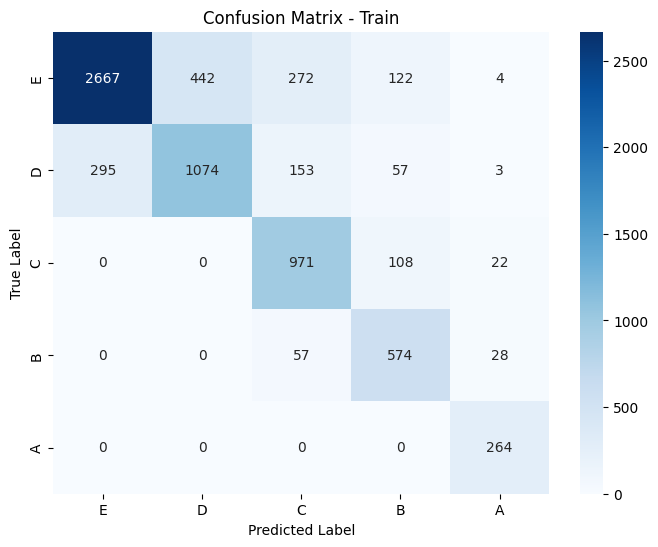

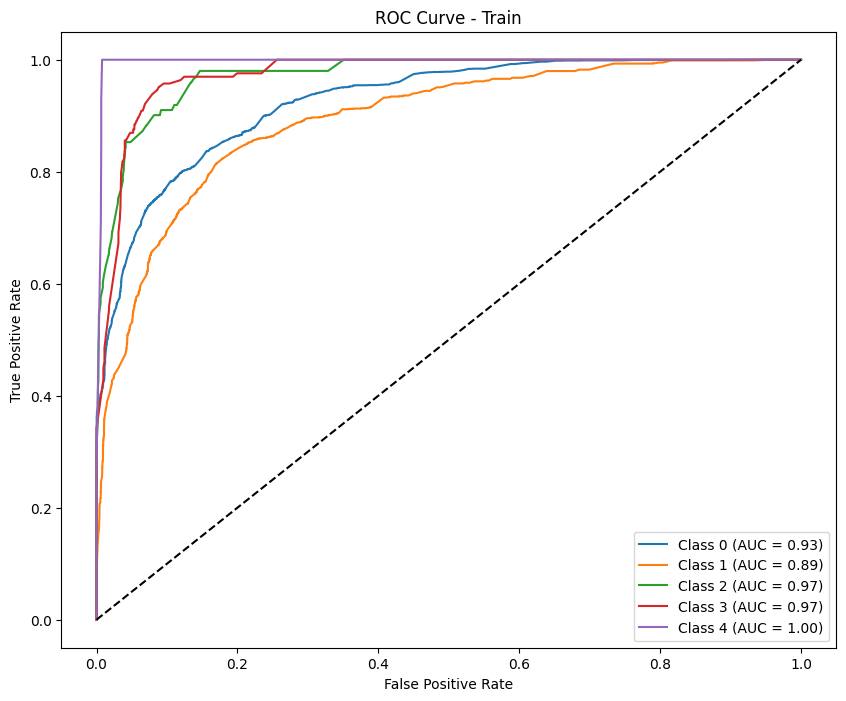


--- Test Metrics ---
F1 Score (per class): [0.88798701 0.02105263 0.         0.         0.        ]
Precision (per class): [0.80797637 0.1        0.         0.         0.        ]
Recall (per class): [0.98558559 0.01176471 0.         0.         0.        ]
Accuracy: 0.7977
AUC (One-vs-Rest): 0.5626

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.99      0.89       555
           D       0.10      0.01      0.02        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.80       687
   macro avg       0.18      0.20      0.18       687
weighted avg       0.67      0.80      0.72       687



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


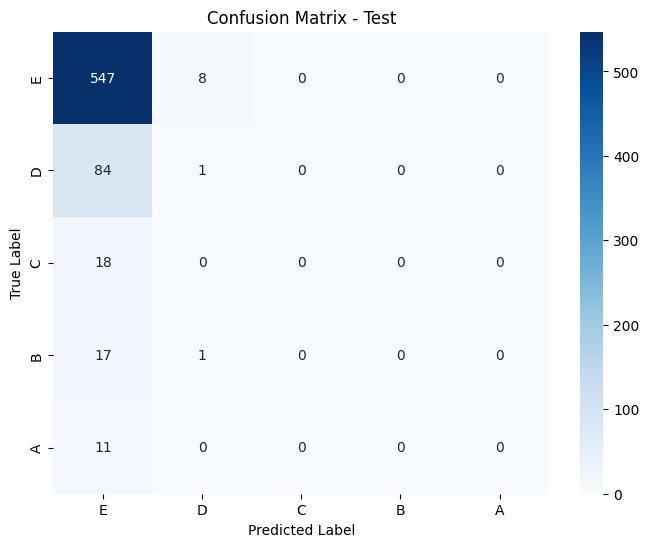

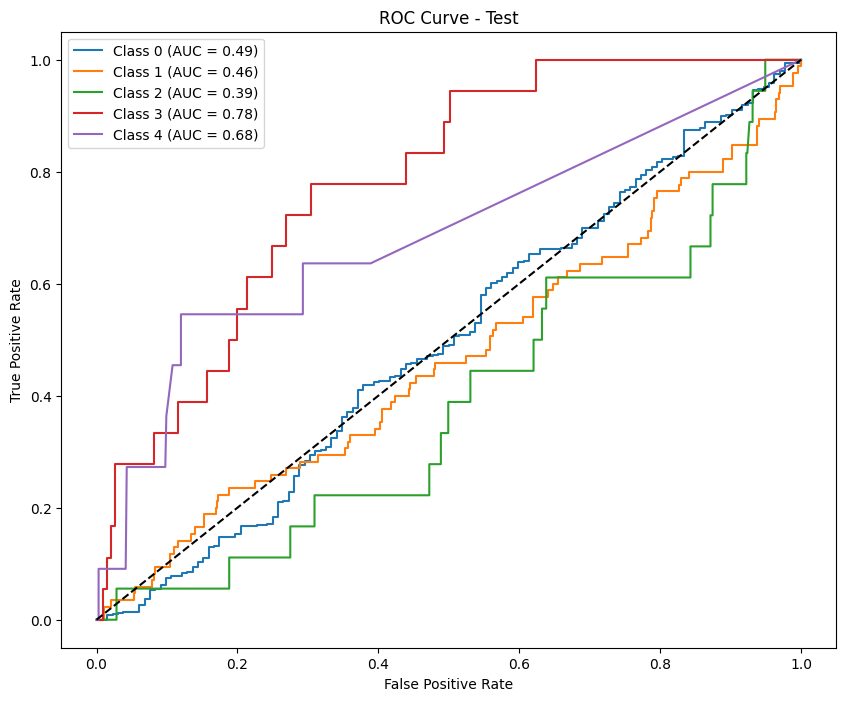

Results saved as test_results_calibrate_undersample_robust_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.84463833 0.65226782 0.81158168 0.75656985 0.90721649]
Precision (per class): [0.83384273 0.75752508 0.77411377 0.69504447 0.83018868]
Recall (per class): [0.85571714 0.57269279 0.85286104 0.83004552 1.        ]
Accuracy: 0.7953
AUC (One-vs-Rest): 0.9554

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.86      0.84      3507
           D       0.76      0.57      0.65      1582
           C       0.77      0.85      0.81      1101
           B       0.70      0.83      0.76       659
           A       0.83      1.00      0.91       264

    accuracy                           0.80      7113
   macro avg       0.78      0.82      0.79      7113
weighted avg       0.79      0.80      0.79      7113



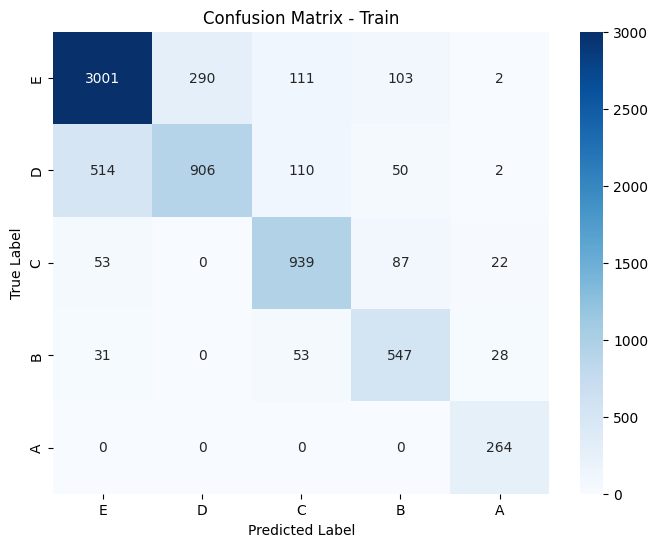

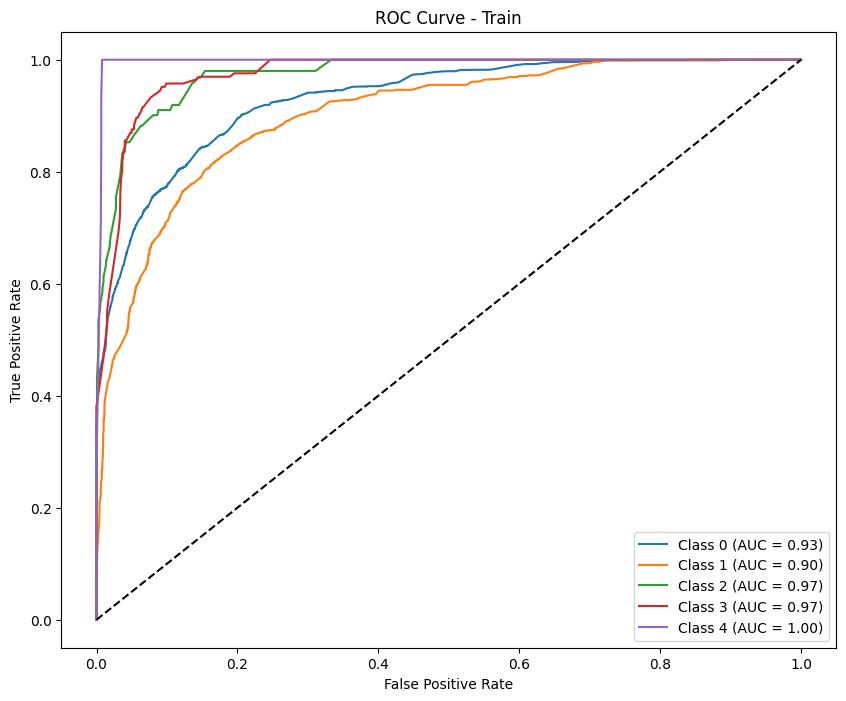


--- Test Metrics ---
F1 Score (per class): [0.89282836 0.         0.         0.         0.        ]
Precision (per class): [0.80758017 0.         0.         0.         0.        ]
Recall (per class): [0.9981982 0.        0.        0.        0.       ]
Accuracy: 0.8064
AUC (One-vs-Rest): 0.6015

Classification Report:
              precision    recall  f1-score   support

           E       0.81      1.00      0.89       555
           D       0.00      0.00      0.00        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.81       687
   macro avg       0.16      0.20      0.18       687
weighted avg       0.65      0.81      0.72       687



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


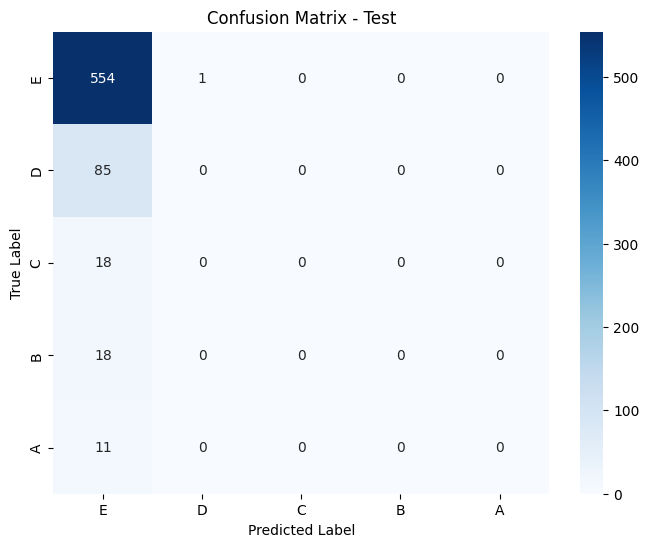

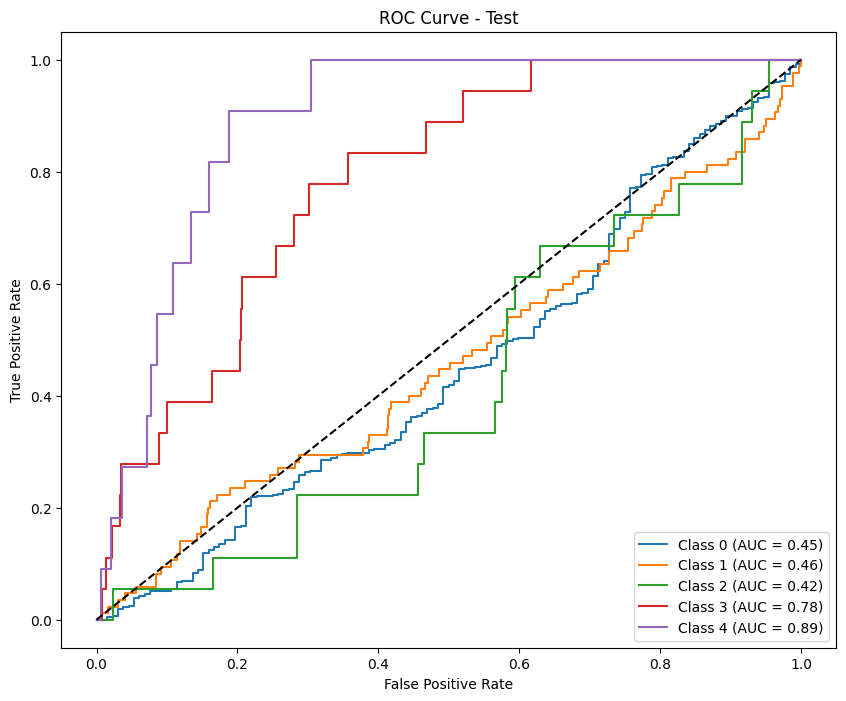

In [30]:
hyperparams = {
    "phase1": hp_1,
    "phase2": hp_2,
    "phase3": hp_3,
    "phase4": hp_4
}

for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_oversample_phase(phase, metric='f1_macro', scale='robust', hyper=hyperparams[phase]) 

### smote

In [31]:
# for phase in ["phase1", "phase2", "phase3", "phase4"]:
#     process_smote_phase(phase, scale='robust', metric='f1_macro')

# 3. Scale dữ liệu theo Log

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

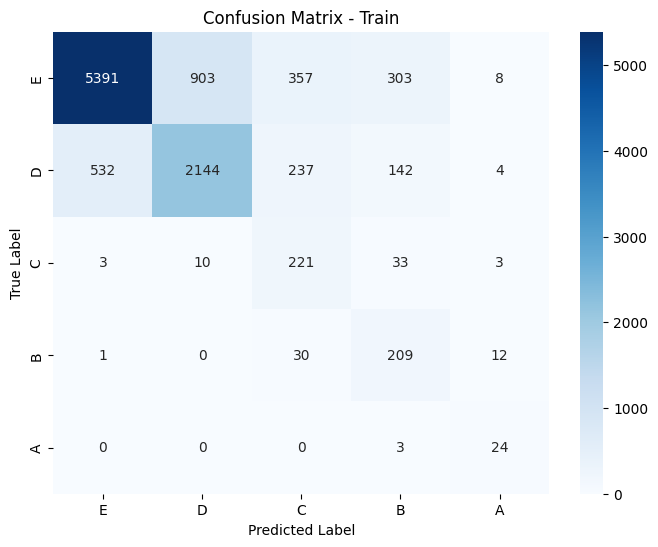

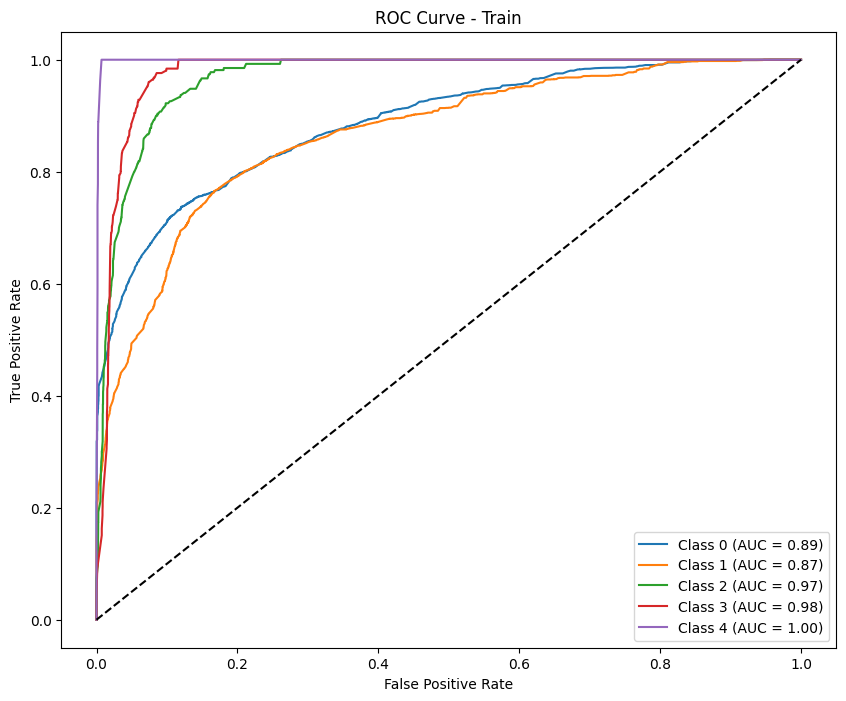


--- Test Metrics ---
F1 Score (per class): [0.92238131 0.38848921 0.         0.         0.        ]
Precision (per class): [0.86075949 0.6        0.         0.         0.        ]
Recall (per class): [0.99350649 0.28723404 0.         0.         0.        ]
Accuracy: 0.8452
AUC (One-vs-Rest): 0.8479

Classification Report:
              precision    recall  f1-score   support

           E       0.86      0.99      0.92       616
           D       0.60      0.29      0.39        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.85       756
   macro avg       0.29      0.26      0.26       756
weighted avg       0.78      0.85      0.80       756



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


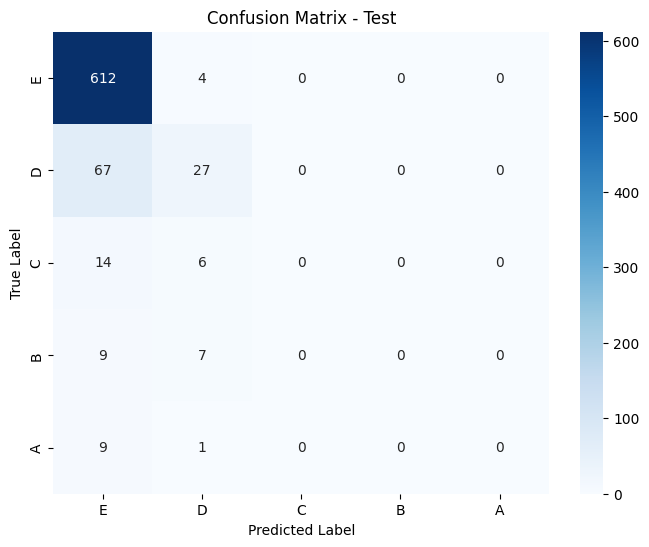

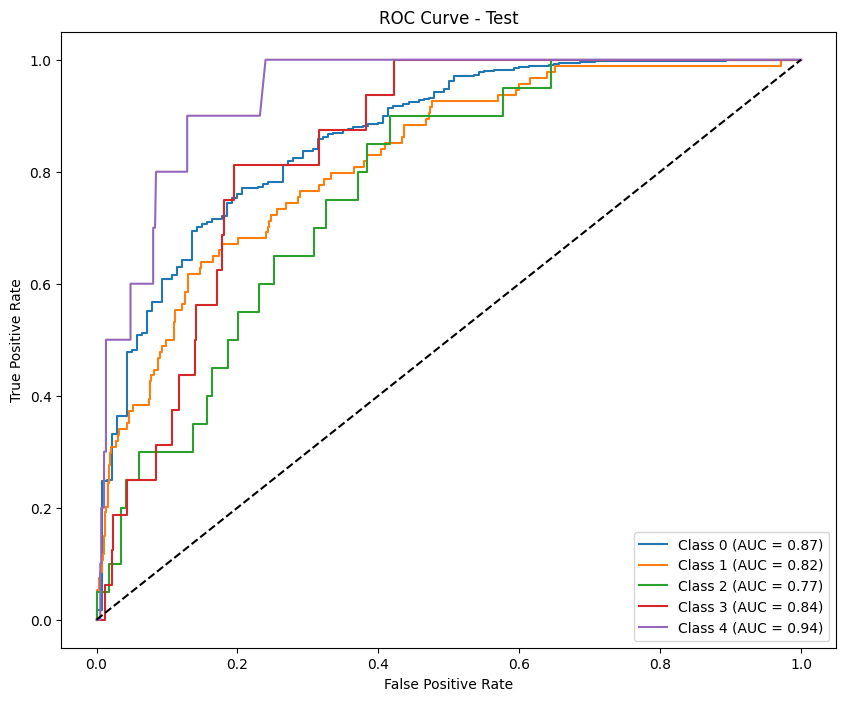

Results saved as test_results_calibrate_log_f1_macro_phase1.csv
-------------Results for calibrate phase: phase1---------------

--- Train Metrics ---
F1 Score (per class): [0.86456983 0.6602944  0.49494949 0.51170569 0.6       ]
Precision (per class): [0.82339181 0.79511971 0.4537037  0.44219653 0.54545455]
Recall (per class): [0.91008331 0.56456358 0.54444444 0.60714286 0.66666667]
Accuracy: 0.7929
AUC (One-vs-Rest): 0.9471

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.91      0.86      6962
           D       0.80      0.56      0.66      3059
           C       0.45      0.54      0.49       270
           B       0.44      0.61      0.51       252
           A       0.55      0.67      0.60        27

    accuracy                           0.79     10570
   macro avg       0.61      0.66      0.63     10570
weighted avg       0.80      0.79      0.79     10570



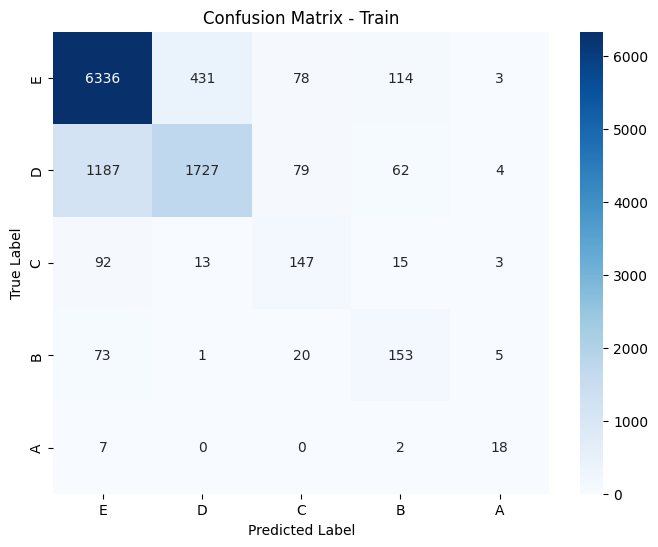

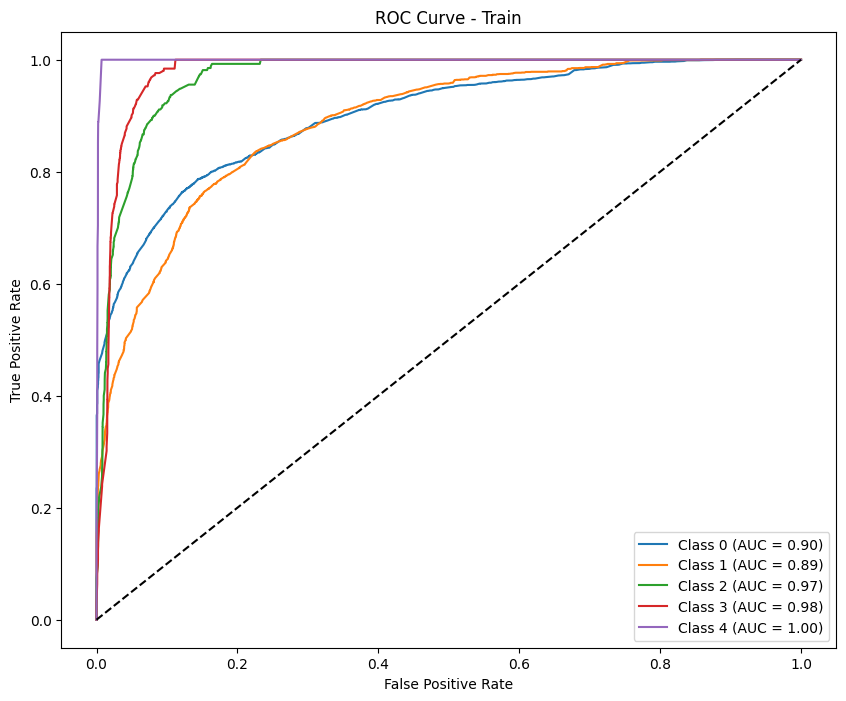


--- Test Metrics ---
F1 Score (per class): [0.90774908 0.18018018 0.         0.         0.        ]
Precision (per class): [0.83220568 0.58823529 0.         0.         0.        ]
Recall (per class): [0.99837662 0.10638298 0.         0.         0.        ]
Accuracy: 0.8267
AUC (One-vs-Rest): 0.8454

Classification Report:
              precision    recall  f1-score   support

           E       0.83      1.00      0.91       616
           D       0.59      0.11      0.18        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.83       756
   macro avg       0.28      0.22      0.22       756
weighted avg       0.75      0.83      0.76       756



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


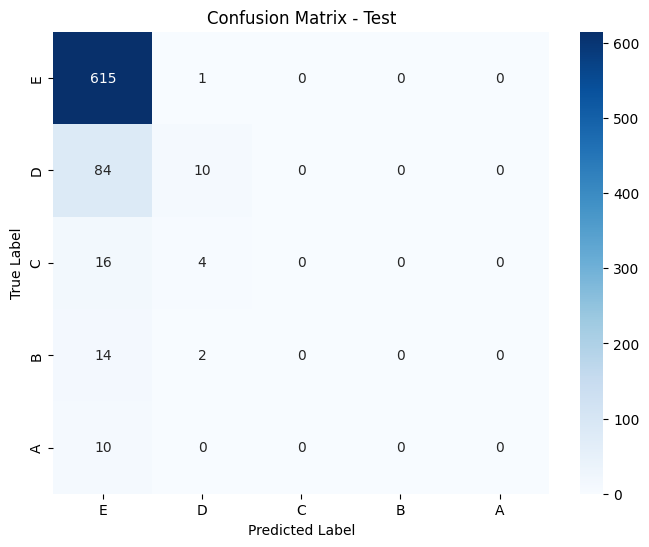

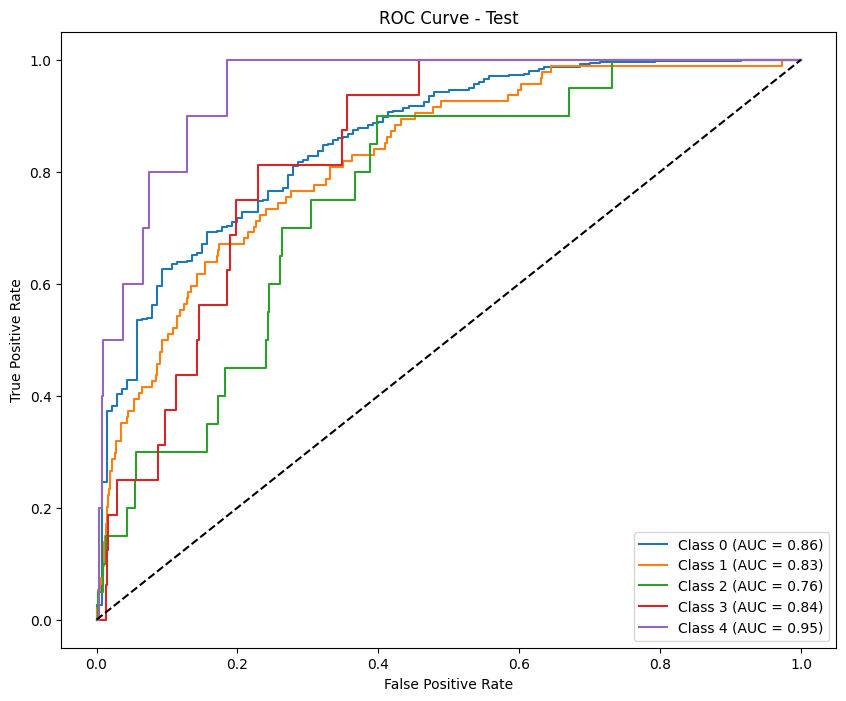


-------------Permutation Importance for phase: phase1---------


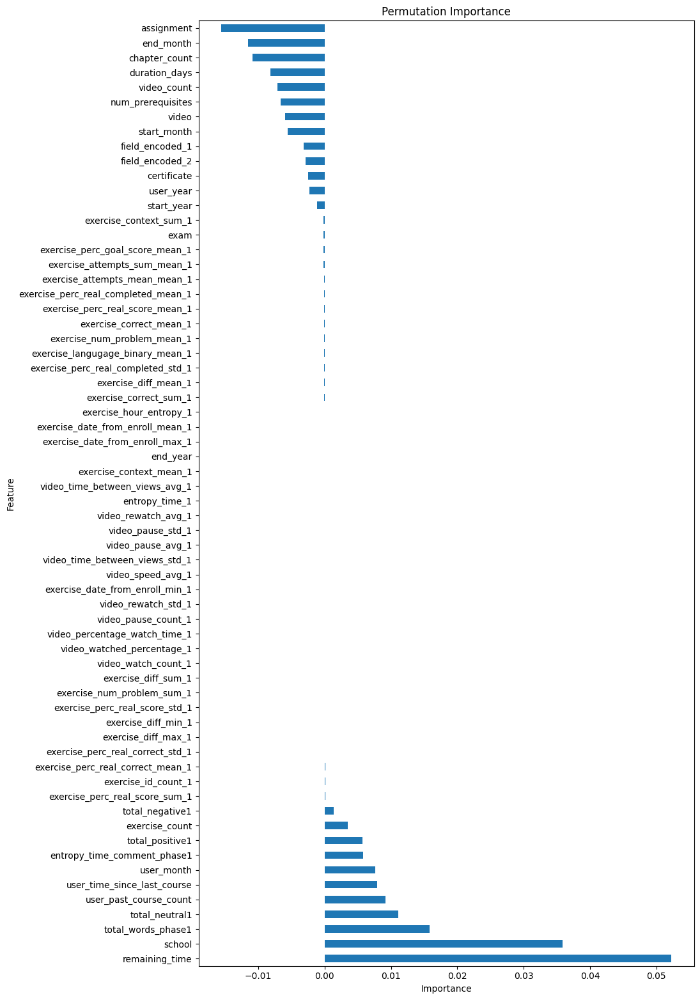

                   Feature  Importance
20          remaining_time    0.052271
0                   school    0.035844
60      total_words_phase1    0.015788
63          total_neutral1    0.011057
12  user_past_course_count    0.009130
..                     ...         ...
9              video_count   -0.007131
19           duration_days   -0.008184
11           chapter_count   -0.010880
6                end_month   -0.011578
16              assignment   -0.015610

[64 rows x 2 columns]

-----------SHAP Feature Importance for phase: phase1------------


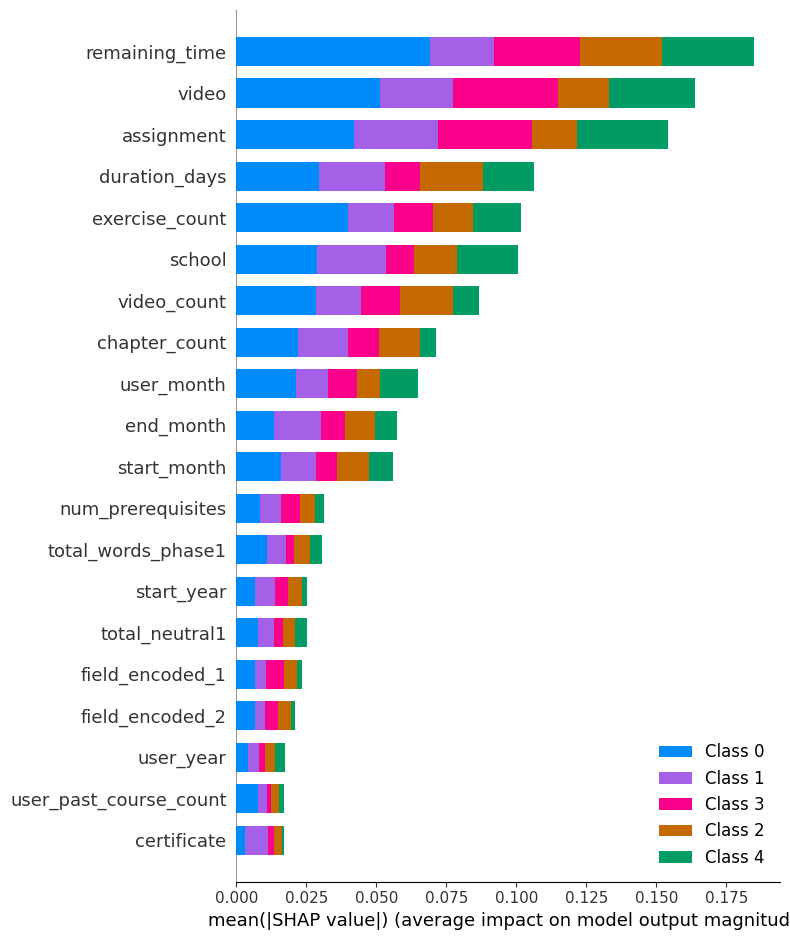


-----Lasso Feature Selection for phase: phase1----------


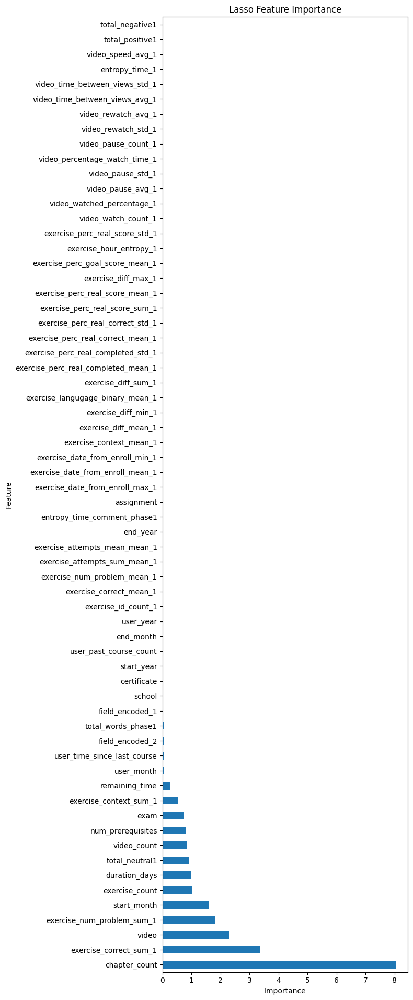

                           Feature  Importance
11                   chapter_count    8.053936
23          exercise_correct_sum_1    3.377562
17                           video    2.305080
25      exercise_num_problem_sum_1    1.825495
4                      start_month    1.603638
..                             ...         ...
57  video_time_between_views_std_1    0.000000
59                  entropy_time_1    0.000000
58               video_speed_avg_1    0.000000
61                 total_positive1    0.000000
62                 total_negative1    0.000000

[64 rows x 2 columns]

----------Boruta Trick: phase1----------
Feature Importance (Including Random Feature):
                           Feature    Importance
64                  Random Feature  2.160939e-01
20                  remaining_time  1.303490e-01
17                           video  8.733297e-02
16                      assignment  7.686138e-02
0                           school  6.180952e-02
..                            

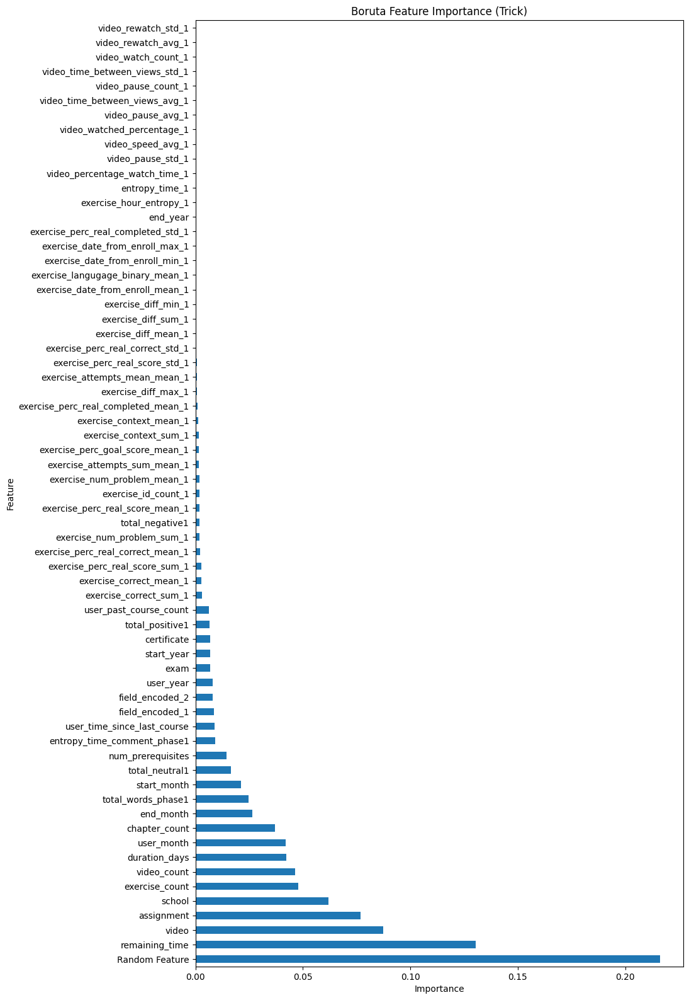

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None
Results saved as test_results_log_f1_macro_phase2.csv
----------Results for phase: phase2--------------

--- Train Metrics ---
F1 Score (per class): [0.82222222 0.66557645 0.3875969  0.45124717 0.66666667]
Precision (per class): [0.89957717 0.66476113 0.26002972 0.30521472 0.52272727]
Recall (per class): [0.75711744 0.66639378 0.76086957 0.86521739 0.92      ]
Accuracy: 0.7347
AUC (One-vs-Rest): 0.9270

Classification Report:
              precision    recall  f1-score   support

           E       0.90      0.76      0.82      5620
           D       0.66      0.67      0.67      2443
           C       0.26      0.76      0.39       230
           B       0.31      0.87      0.45       230
           A       0.52      0.92      0.67        25

    accuracy                           0.73      8548


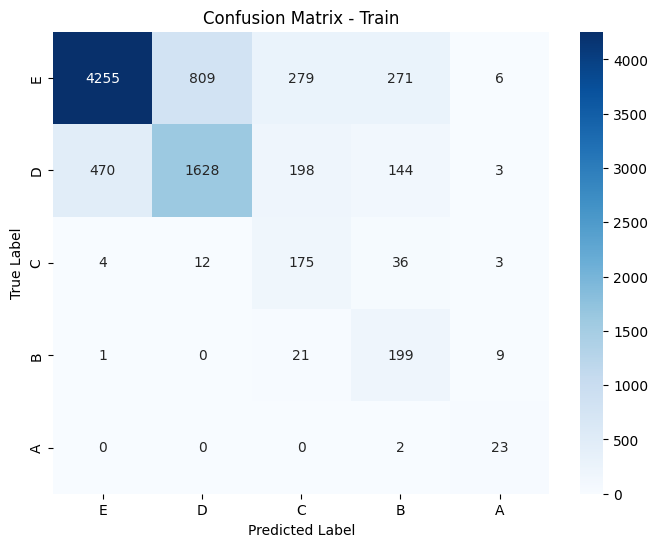

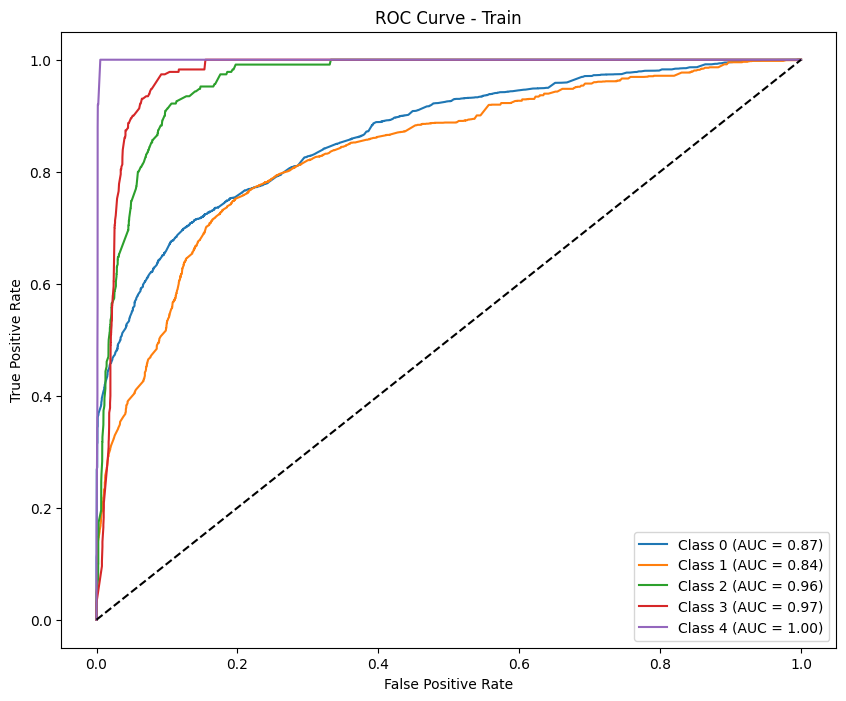

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.90356083 0.08080808 0.         0.         0.        ]
Precision (per class): [0.8240866  0.57142857 0.         0.         0.        ]
Recall (per class): [1.         0.04347826 0.         0.         0.        ]
Accuracy: 0.8217
AUC (One-vs-Rest): 0.7454

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       609
           D       0.57      0.04      0.08        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.82       746
   macro avg       0.28      0.21      0.20       746
weighted avg       0.74      0.82      0.75       746



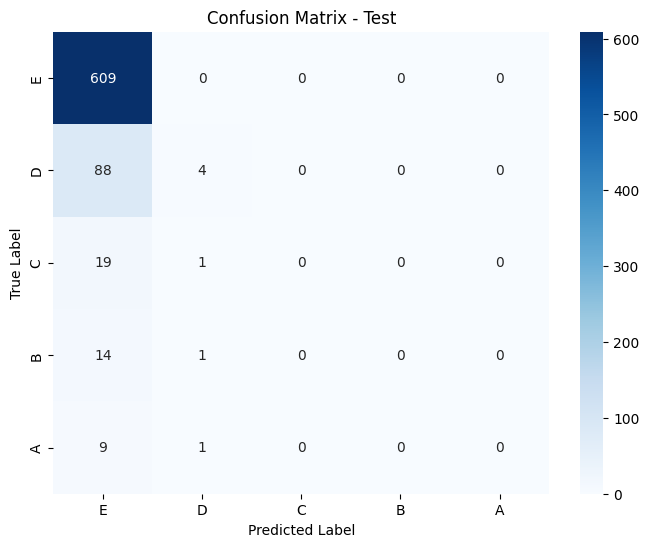

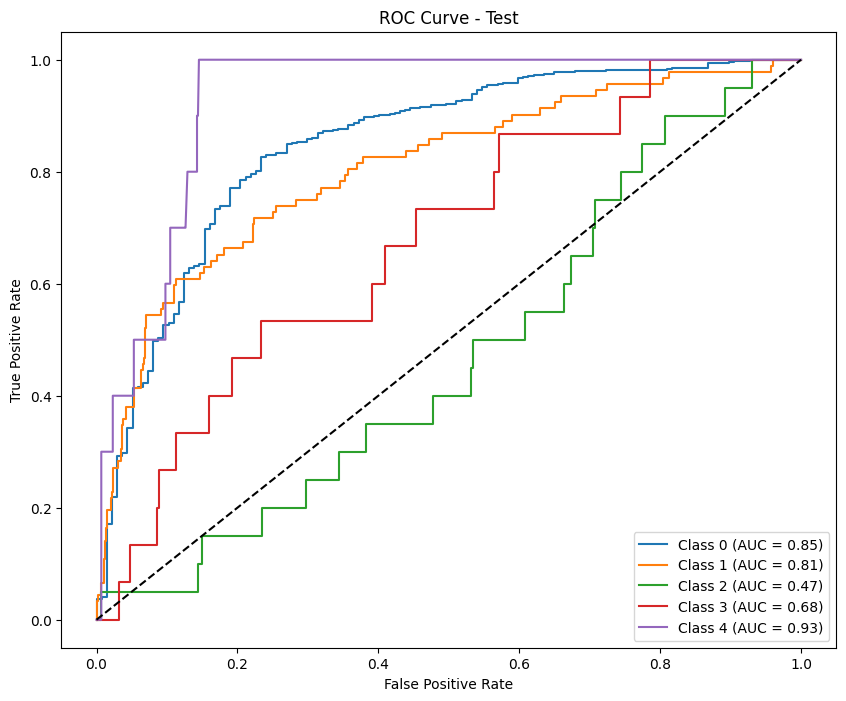

Results saved as test_results_calibrate_log_f1_macro_phase2.csv
-------------Results for calibrate phase: phase2---------------

--- Train Metrics ---
F1 Score (per class): [0.8430287  0.61876901 0.46088795 0.49369369 0.59259259]
Precision (per class): [0.80852802 0.72240437 0.44855967 0.42153846 0.55172414]
Recall (per class): [0.88060498 0.54113795 0.47391304 0.59565217 0.64      ]
Accuracy: 0.7643
AUC (One-vs-Rest): 0.9369

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.88      0.84      5620
           D       0.72      0.54      0.62      2443
           C       0.45      0.47      0.46       230
           B       0.42      0.60      0.49       230
           A       0.55      0.64      0.59        25

    accuracy                           0.76      8548
   macro avg       0.59      0.63      0.60      8548
weighted avg       0.76      0.76      0.76      8548



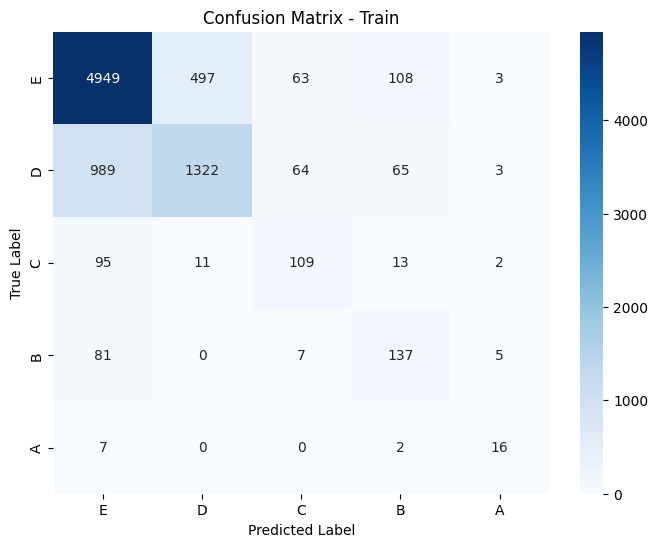

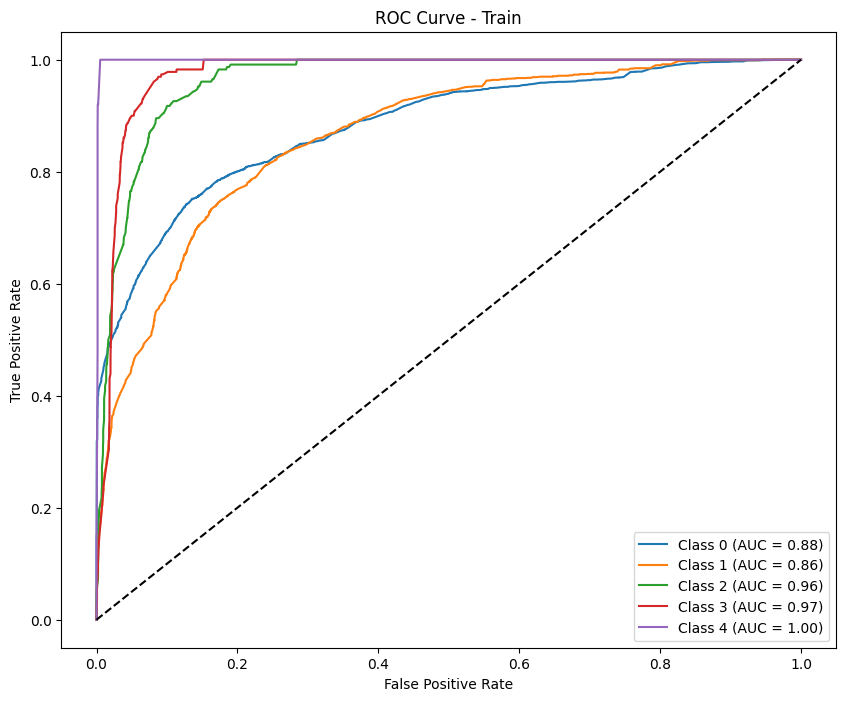


--- Test Metrics ---
F1 Score (per class): [0.89889299 0.         0.         0.         0.        ]
Precision (per class): [0.81635389 0.         0.         0.         0.        ]
Recall (per class): [1. 0. 0. 0. 0.]
Accuracy: 0.8164
AUC (One-vs-Rest): 0.7351

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       609
           D       0.00      0.00      0.00        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.82       746
   macro avg       0.16      0.20      0.18       746
weighted avg       0.67      0.82      0.73       746



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


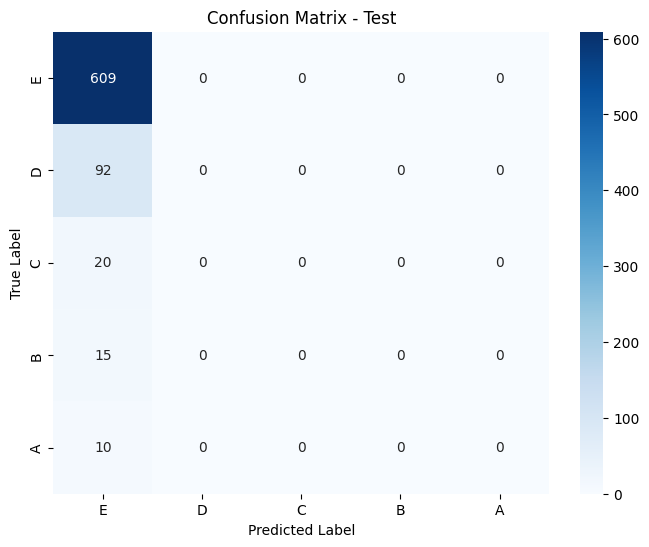

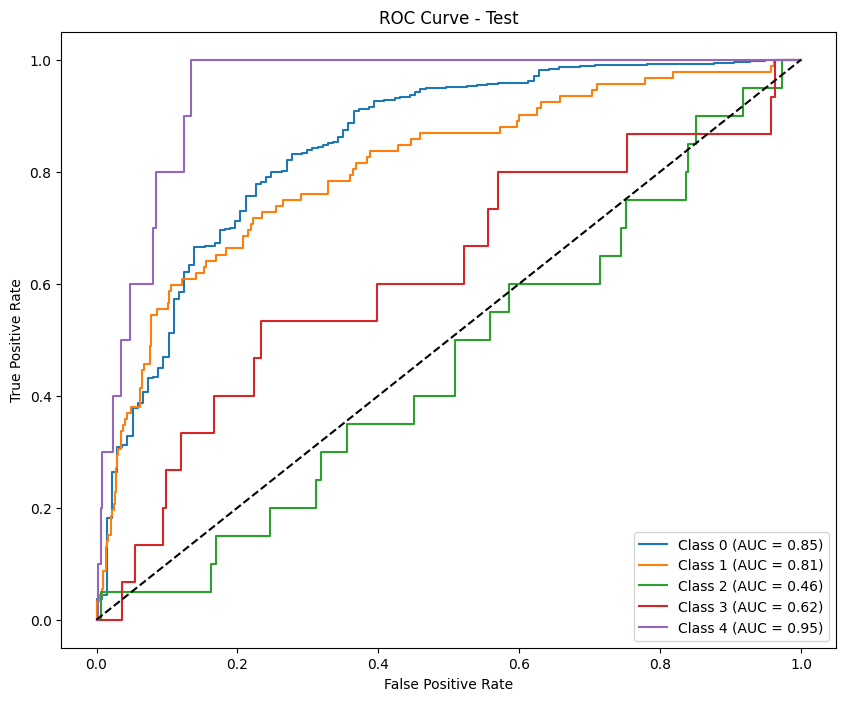


-------------Permutation Importance for phase: phase2---------


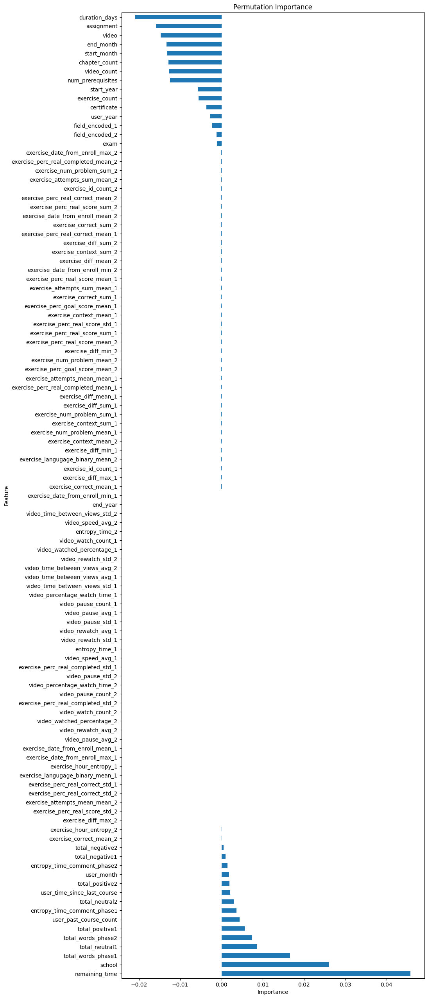

                Feature  Importance
20       remaining_time    0.045815
0                school    0.026117
60   total_words_phase1    0.016597
63       total_neutral1    0.008642
103  total_words_phase2    0.007370
..                  ...         ...
4           start_month   -0.013205
6             end_month   -0.013322
17                video   -0.014711
16           assignment   -0.015837
19        duration_days   -0.020926

[107 rows x 2 columns]

-----------SHAP Feature Importance for phase: phase2------------


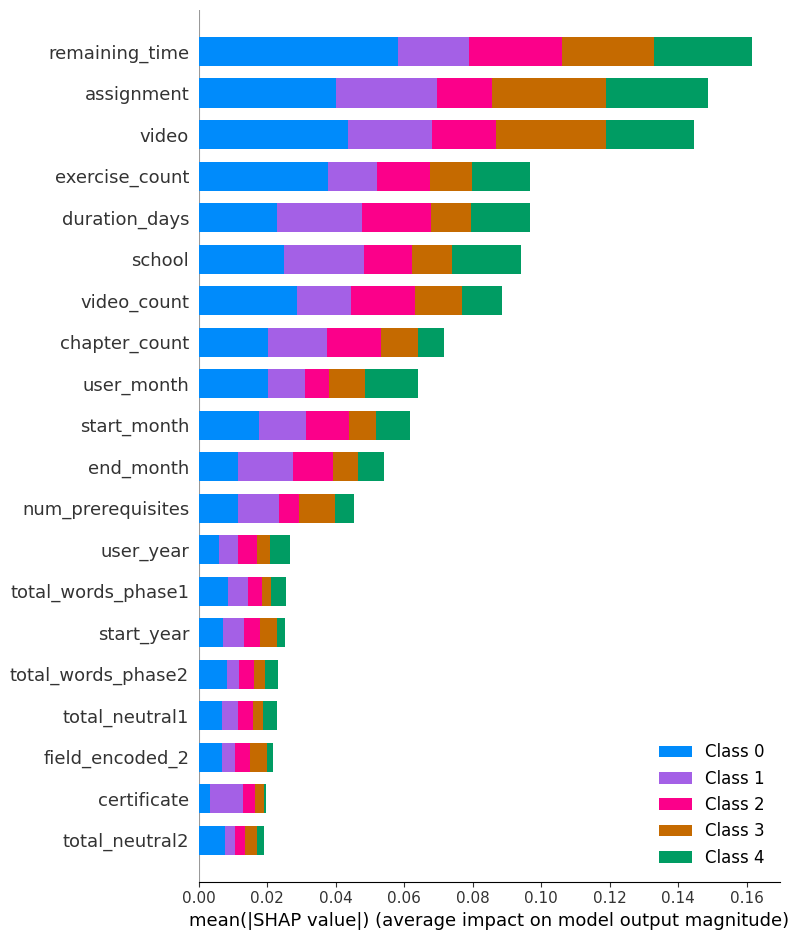


-----Lasso Feature Selection for phase: phase2----------


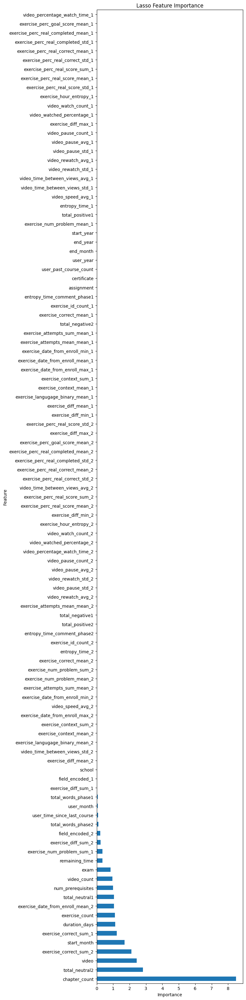

                                 Feature  Importance
11                         chapter_count    8.482410
106                       total_neutral2    2.812168
17                                 video    2.432504
66                exercise_correct_sum_2    2.110226
4                            start_month    1.698064
..                                   ...         ...
42     exercise_perc_real_correct_mean_1    0.000000
41    exercise_perc_real_completed_std_1    0.000000
40   exercise_perc_real_completed_mean_1    0.000000
39       exercise_perc_goal_score_mean_1    0.000000
50         video_percentage_watch_time_1    0.000000

[107 rows x 2 columns]

----------Boruta Trick: phase2----------
Feature Importance (Including Random Feature):
                        Feature  Importance
107              Random Feature    0.191237
20               remaining_time    0.121454
17                        video    0.082883
16                   assignment    0.075923
0                        school

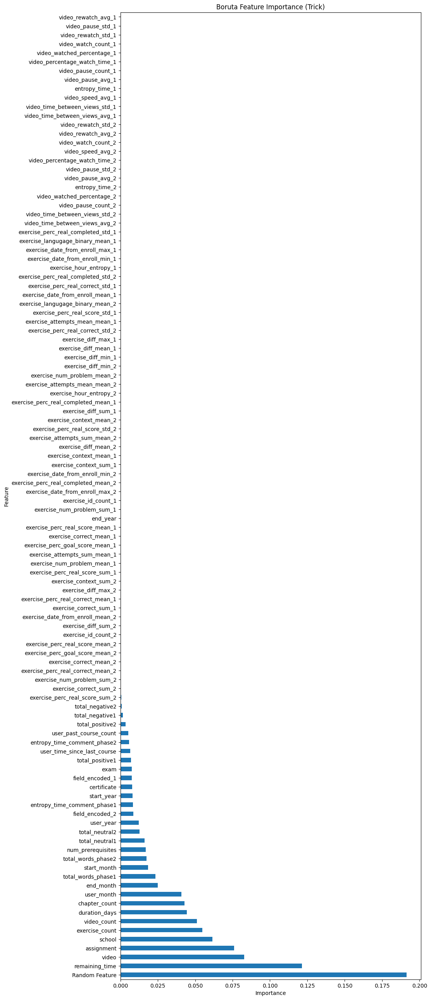

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None
Results saved as test_results_log_f1_macro_phase3.csv
----------Results for phase: phase3--------------

--- Train Metrics ---
F1 Score (per class): [0.82535004 0.66978193 0.37662338 0.45489199 0.60714286]
Precision (per class): [0.896      0.6736795  0.25129983 0.30862069 0.45945946]
Recall (per class): [0.76502732 0.6659292  0.75129534 0.8647343  0.89473684]
Accuracy: 0.7389
AUC (One-vs-Rest): 0.9279

Classification Report:
              precision    recall  f1-score   support

           E       0.90      0.77      0.83      5124
           D       0.67      0.67      0.67      2260
           C       0.25      0.75      0.38       193
           B       0.31      0.86      0.45       207
           A       0.46      0.89      0.61        19

    accuracy                           0.74      7803


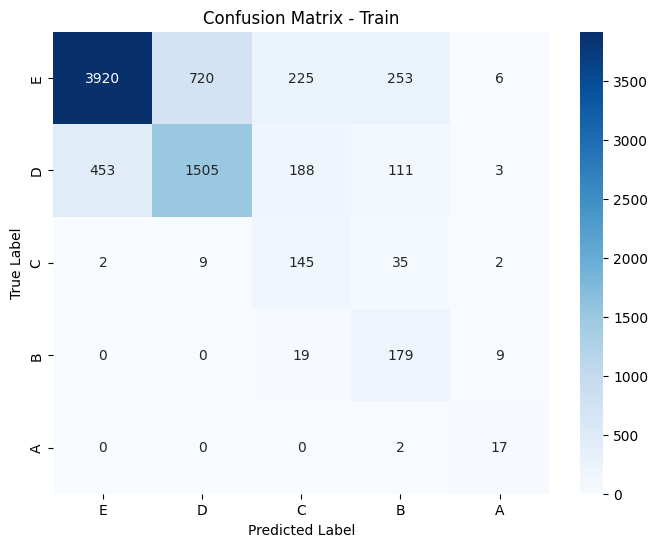

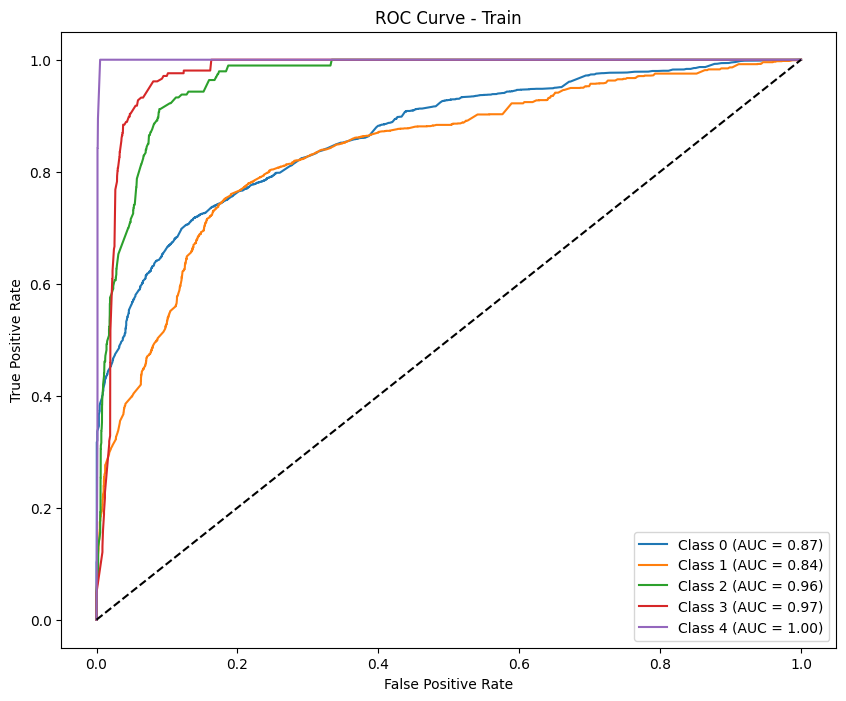

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.89586524 0.         0.         0.         0.        ]
Precision (per class): [0.81476323 0.         0.         0.         0.        ]
Recall (per class): [0.99489796 0.         0.         0.         0.        ]
Accuracy: 0.8114
AUC (One-vs-Rest): 0.6292

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.99      0.90       588
           D       0.00      0.00      0.00        87
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.81       721
   macro avg       0.16      0.20      0.18       721
weighted avg       0.66      0.81      0.73       721



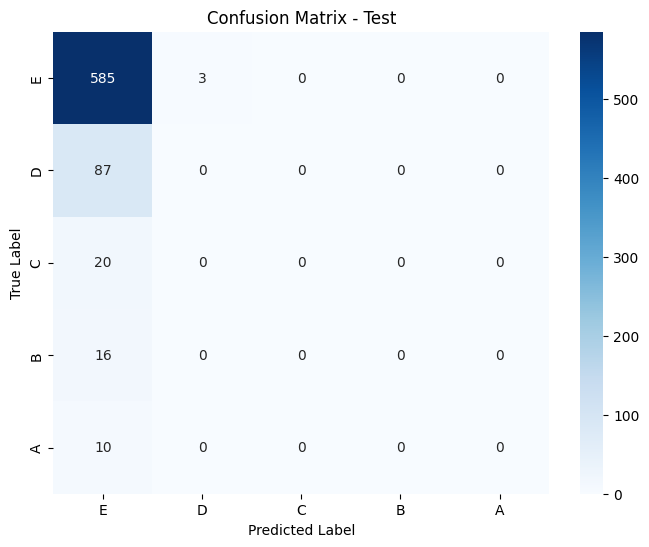

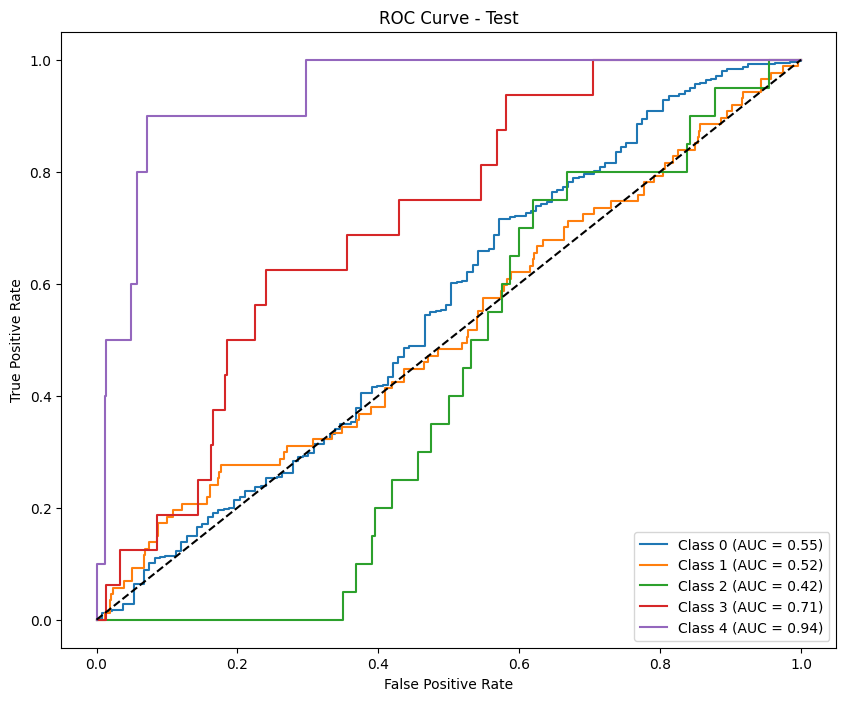

Results saved as test_results_calibrate_log_f1_macro_phase3.csv
-------------Results for calibrate phase: phase3---------------

--- Train Metrics ---
F1 Score (per class): [0.84623997 0.63393756 0.47570332 0.4679089  0.57142857]
Precision (per class): [0.81069003 0.7353972  0.46969697 0.40942029 0.52173913]
Recall (per class): [0.88505074 0.55707965 0.48186528 0.54589372 0.63157895]
Accuracy: 0.7705
AUC (One-vs-Rest): 0.9389

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.89      0.85      5124
           D       0.74      0.56      0.63      2260
           C       0.47      0.48      0.48       193
           B       0.41      0.55      0.47       207
           A       0.52      0.63      0.57        19

    accuracy                           0.77      7803
   macro avg       0.59      0.62      0.60      7803
weighted avg       0.77      0.77      0.76      7803



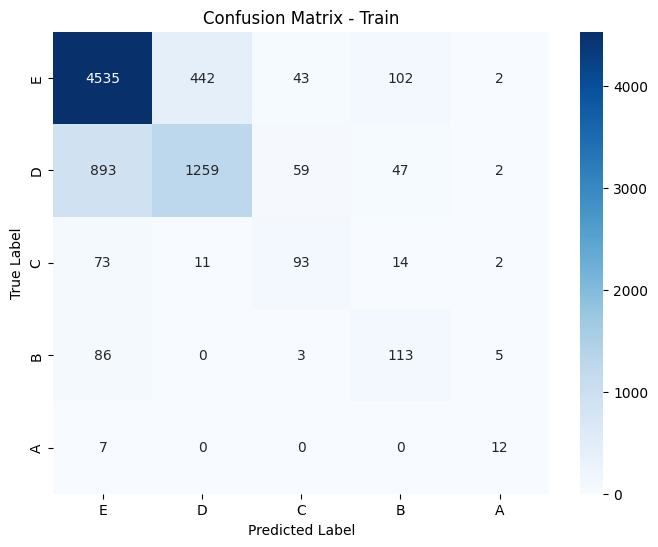

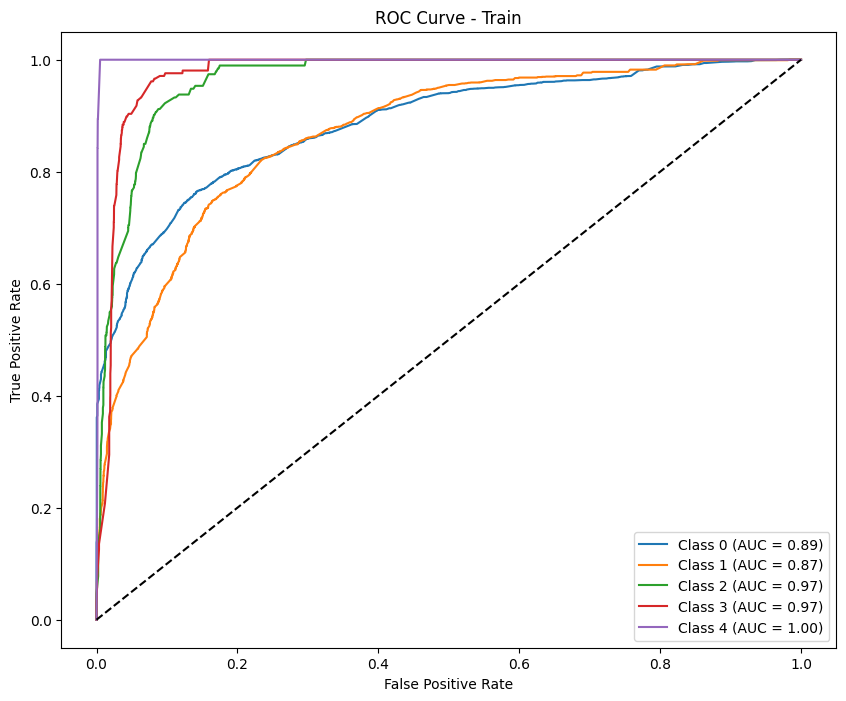


--- Test Metrics ---
F1 Score (per class): [0.89839572 0.         0.         0.         0.        ]
Precision (per class): [0.81553398 0.         0.         0.         0.        ]
Recall (per class): [1. 0. 0. 0. 0.]
Accuracy: 0.8155
AUC (One-vs-Rest): 0.6319

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       588
           D       0.00      0.00      0.00        87
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.82       721
   macro avg       0.16      0.20      0.18       721
weighted avg       0.67      0.82      0.73       721



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


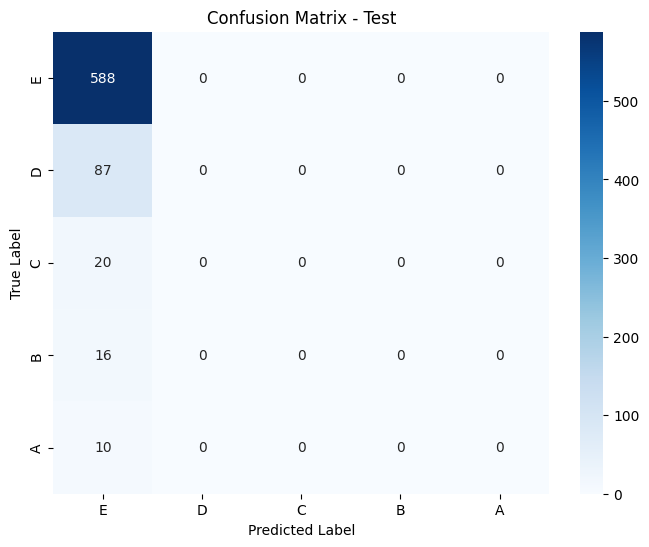

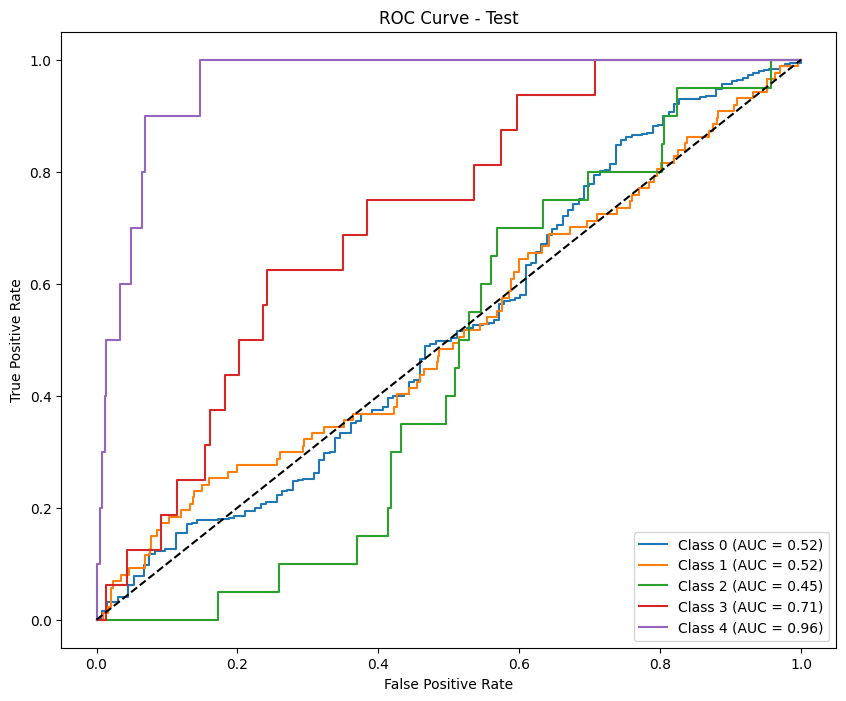

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None
Results saved as test_results_log_f1_macro_phase4.csv
----------Results for phase: phase4--------------

--- Train Metrics ---
F1 Score (per class): [0.82100684 0.69473008 0.27936508 0.53359684 0.66666667]
Precision (per class): [0.90201434 0.70653595 0.16635161 0.38904899 0.5       ]
Recall (per class): [0.75335044 0.68331226 0.87128713 0.8490566  1.        ]
Accuracy: 0.7384
AUC (One-vs-Rest): 0.9326

Classification Report:
              precision    recall  f1-score   support

           E       0.90      0.75      0.82      3507
           D       0.71      0.68      0.69      1582
           C       0.17      0.87      0.28       101
           B       0.39      0.85      0.53       159
           A       0.50      1.00      0.67        14

    accuracy                           0.74      5363


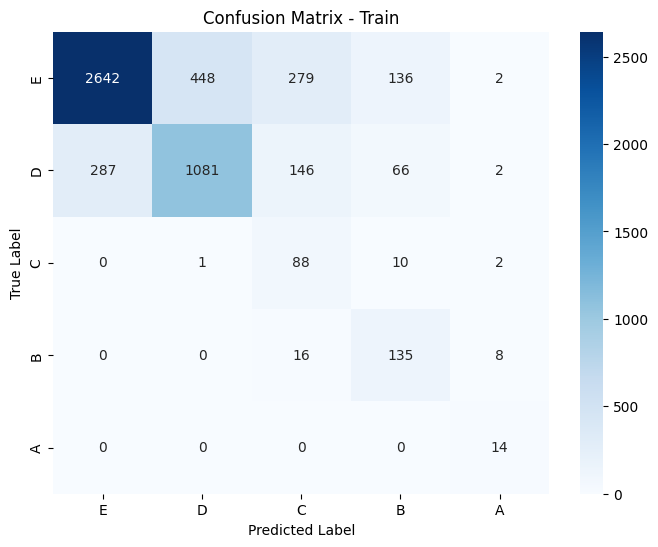

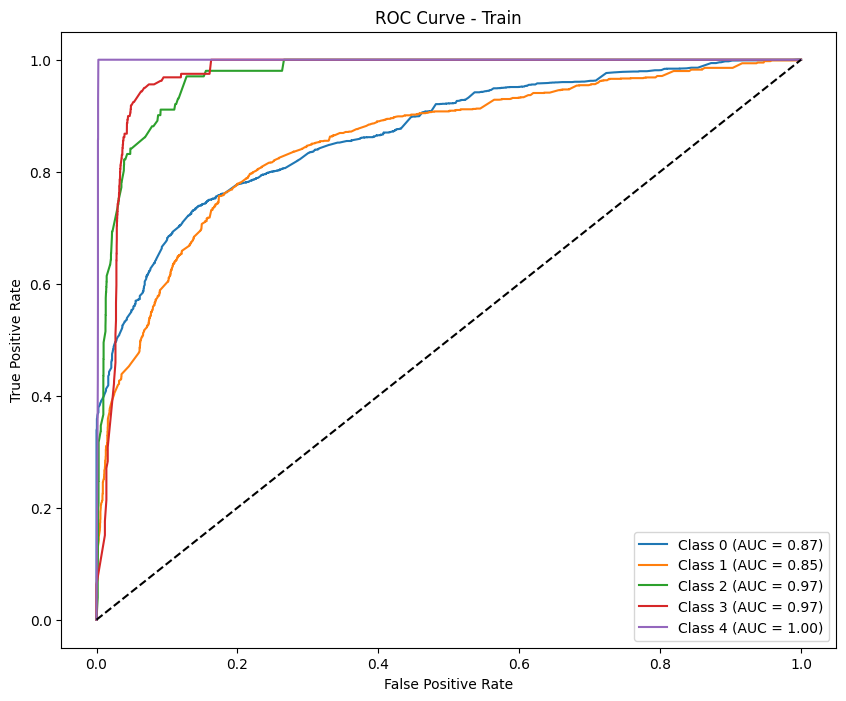


--- Test Metrics ---
F1 Score (per class): [0.88924818 0.         0.         0.         0.        ]
Precision (per class): [0.80645161 0.         0.         0.         0.        ]
Recall (per class): [0.99099099 0.         0.         0.         0.        ]
Accuracy: 0.8006
AUC (One-vs-Rest): 0.5889

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.99      0.89       555
           D       0.00      0.00      0.00        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.80       687
   macro avg       0.16      0.20      0.18       687
weighted avg       0.65      0.80      0.72       687



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


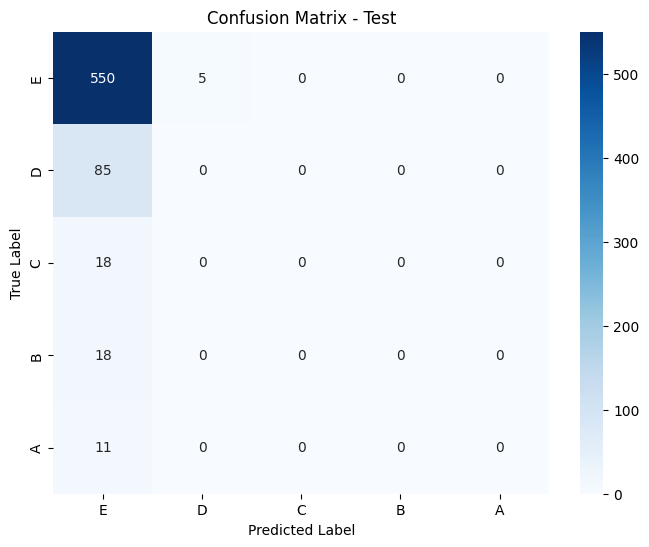

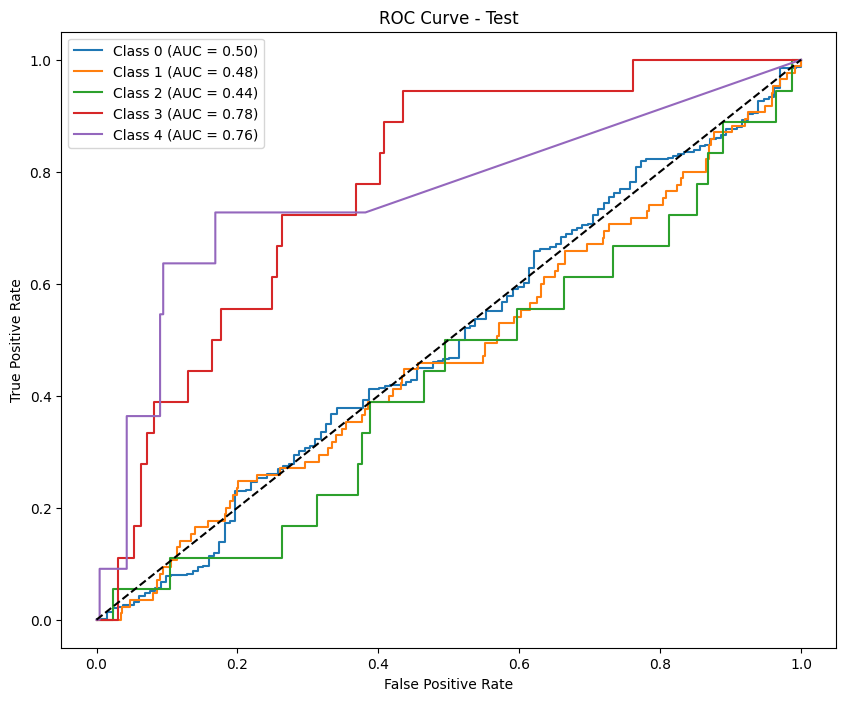

Results saved as test_results_calibrate_log_f1_macro_phase4.csv
-------------Results for calibrate phase: phase4---------------

--- Train Metrics ---
F1 Score (per class): [0.85501037 0.66381156 0.5        0.52830189 0.48484848]
Precision (per class): [0.82966738 0.76229508 0.44274809 0.42264151 0.42105263]
Recall (per class): [0.88195038 0.58786346 0.57425743 0.70440252 0.57142857]
Accuracy: 0.7833
AUC (One-vs-Rest): 0.9428

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.88      0.86      3507
           D       0.76      0.59      0.66      1582
           C       0.44      0.57      0.50       101
           B       0.42      0.70      0.53       159
           A       0.42      0.57      0.48        14

    accuracy                           0.78      5363
   macro avg       0.58      0.66      0.61      5363
weighted avg       0.79      0.78      0.78      5363



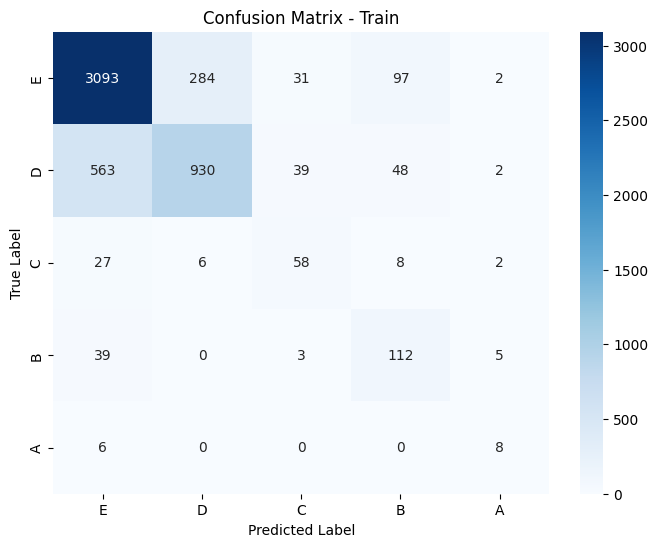

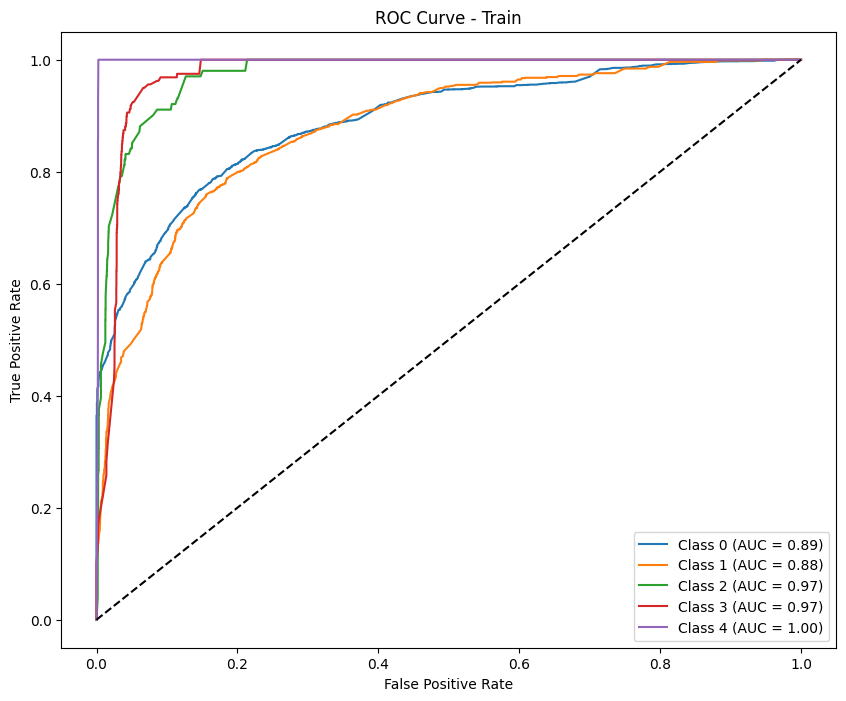


--- Test Metrics ---
F1 Score (per class): [0.89282836 0.         0.         0.         0.        ]
Precision (per class): [0.80758017 0.         0.         0.         0.        ]
Recall (per class): [0.9981982 0.        0.        0.        0.       ]
Accuracy: 0.8064
AUC (One-vs-Rest): 0.6165

Classification Report:
              precision    recall  f1-score   support

           E       0.81      1.00      0.89       555
           D       0.00      0.00      0.00        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.81       687
   macro avg       0.16      0.20      0.18       687
weighted avg       0.65      0.81      0.72       687



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


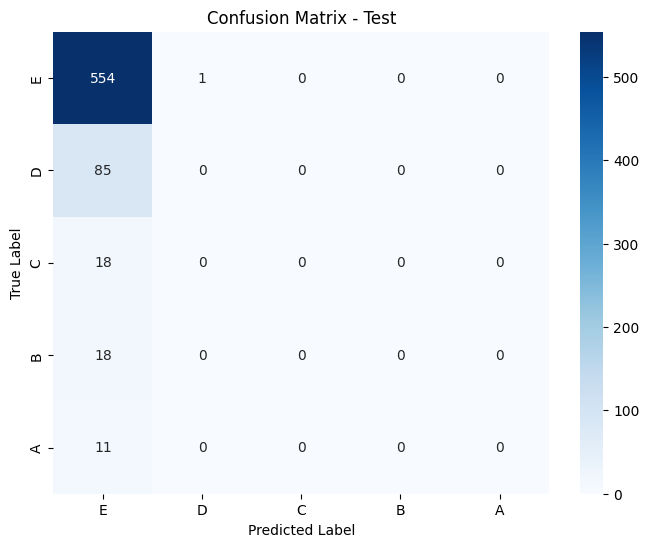

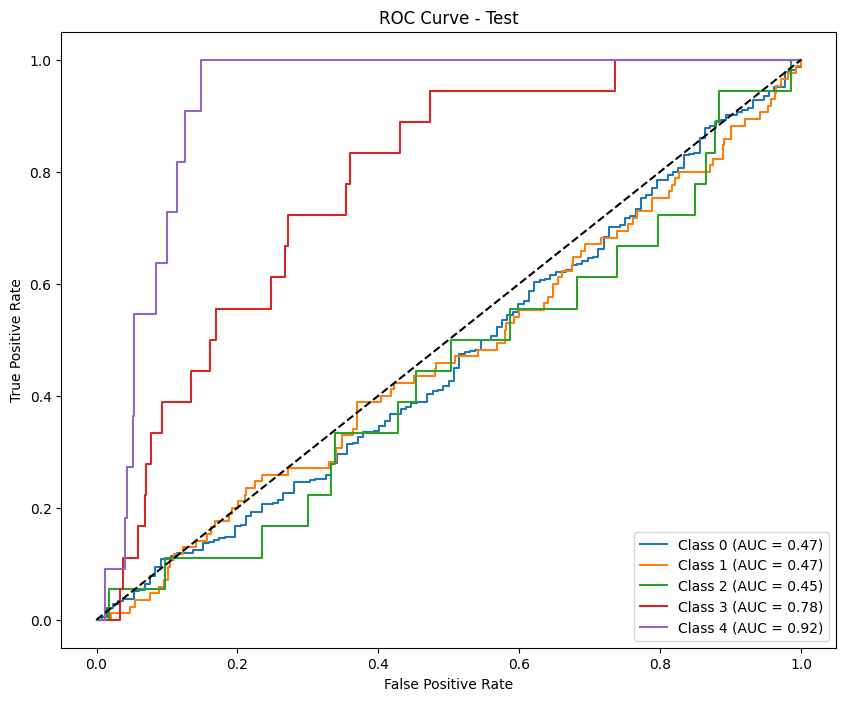

In [32]:
# Lặp qua các phase
hyperparams = {
    "phase1": hp_1,
    "phase2": hp_2,
    "phase3": hp_3,
    "phase4": hp_4
}

for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_phase(phase, metric='f1_macro', scale='log', hyper=hyperparams[phase]) 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

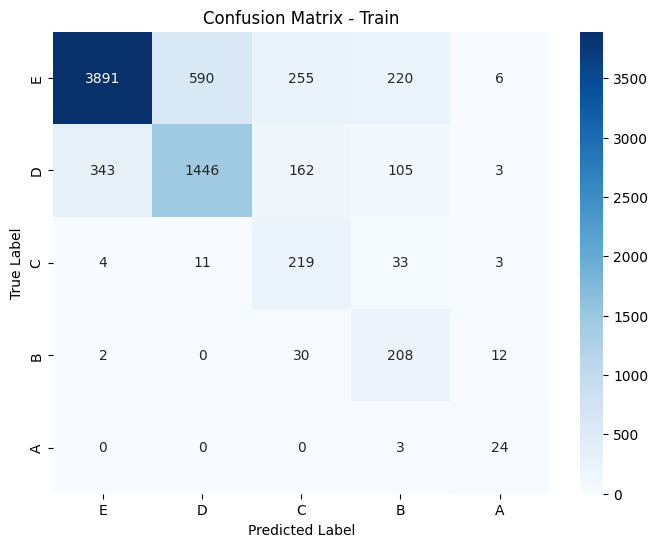

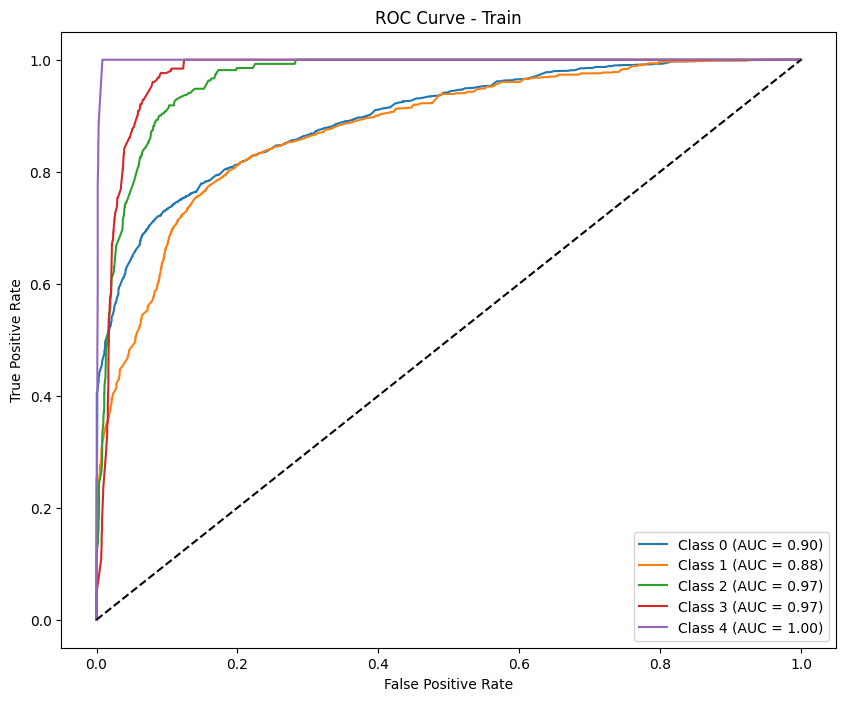


--- Test Metrics ---
F1 Score (per class): [0.92330827 0.38235294 0.         0.         0.        ]
Precision (per class): [0.85994398 0.61904762 0.         0.         0.        ]
Recall (per class): [0.99675325 0.27659574 0.         0.         0.        ]
Accuracy: 0.8466
AUC (One-vs-Rest): 0.8292

Classification Report:
              precision    recall  f1-score   support

           E       0.86      1.00      0.92       616
           D       0.62      0.28      0.38        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.85       756
   macro avg       0.30      0.25      0.26       756
weighted avg       0.78      0.85      0.80       756



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


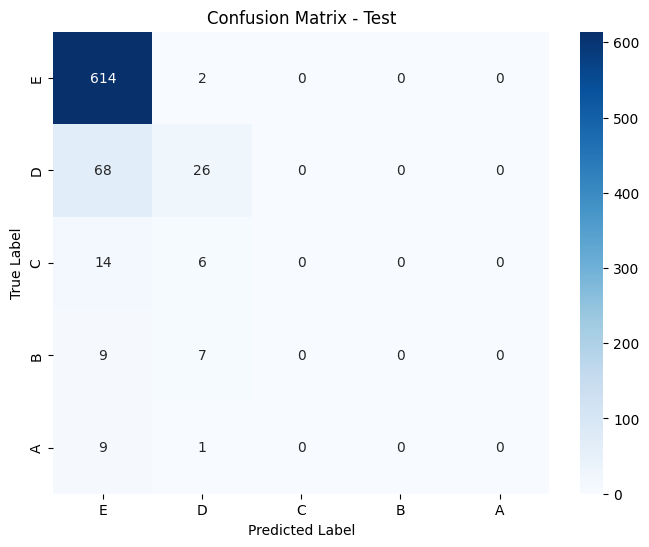

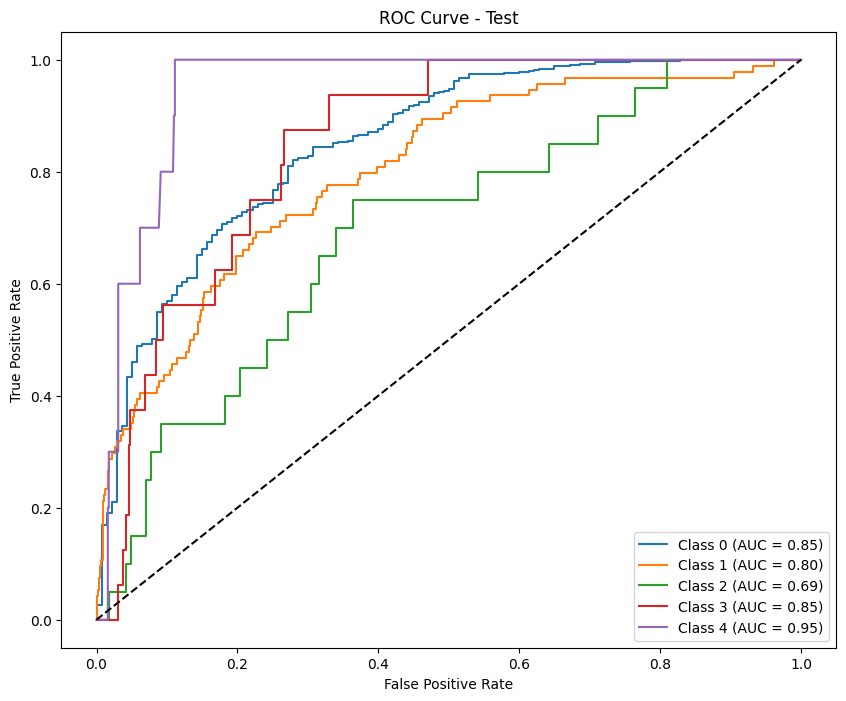

Results saved as test_results_calibrate_undersample_log_f1_macro_phase1.csv
Results for phase: phase1

--- Train Metrics ---
F1 Score (per class): [0.86341035 0.66702849 0.53846154 0.57495591 0.6440678 ]
Precision (per class): [0.83626062 0.75584256 0.50993377 0.51746032 0.59375   ]
Recall (per class): [0.8923821  0.59689169 0.57037037 0.6468254  0.7037037 ]
Accuracy: 0.7917
AUC (One-vs-Rest): 0.9496

Classification Report:
              precision    recall  f1-score   support

           E       0.84      0.89      0.86      4962
           D       0.76      0.60      0.67      2059
           C       0.51      0.57      0.54       270
           B       0.52      0.65      0.57       252
           A       0.59      0.70      0.64        27

    accuracy                           0.79      7570
   macro avg       0.64      0.68      0.66      7570
weighted avg       0.79      0.79      0.79      7570



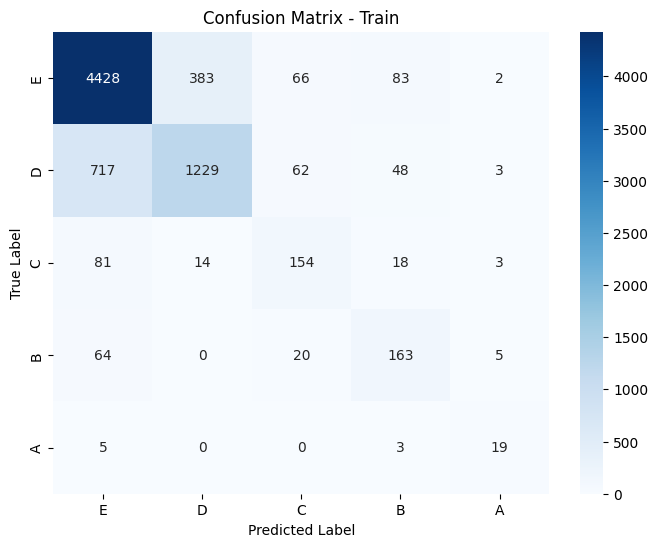

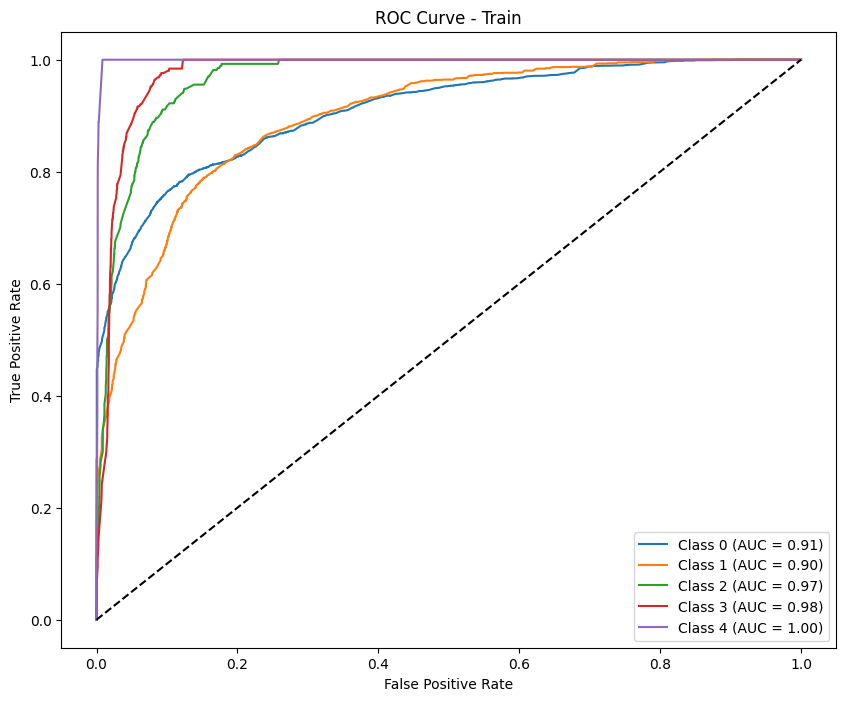


--- Test Metrics ---
F1 Score (per class): [0.90654893 0.1682243  0.         0.         0.        ]
Precision (per class): [0.82907133 0.69230769 0.         0.         0.        ]
Recall (per class): [1.         0.09574468 0.         0.         0.        ]
Accuracy: 0.8267
AUC (One-vs-Rest): 0.8287

Classification Report:
              precision    recall  f1-score   support

           E       0.83      1.00      0.91       616
           D       0.69      0.10      0.17        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.83       756
   macro avg       0.30      0.22      0.21       756
weighted avg       0.76      0.83      0.76       756



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


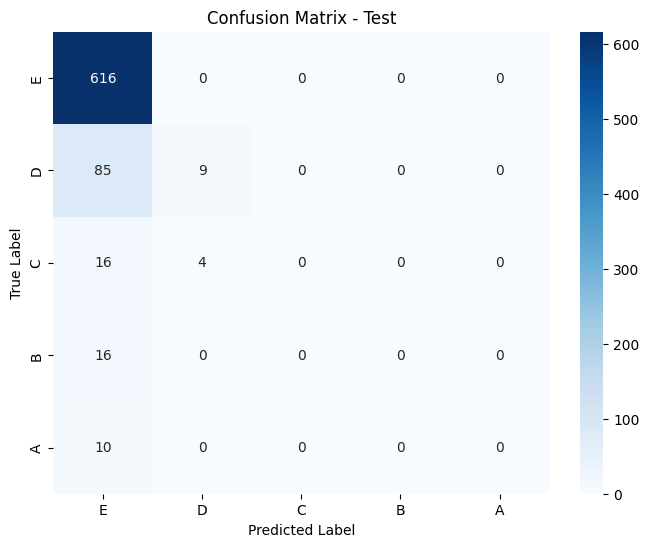

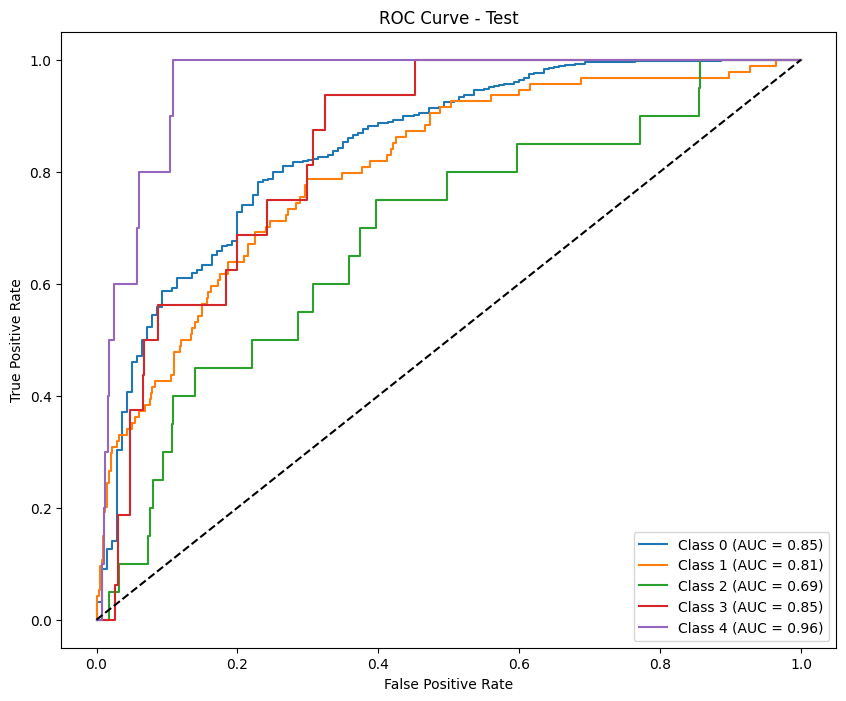


Permutation Importance for phase: phase1


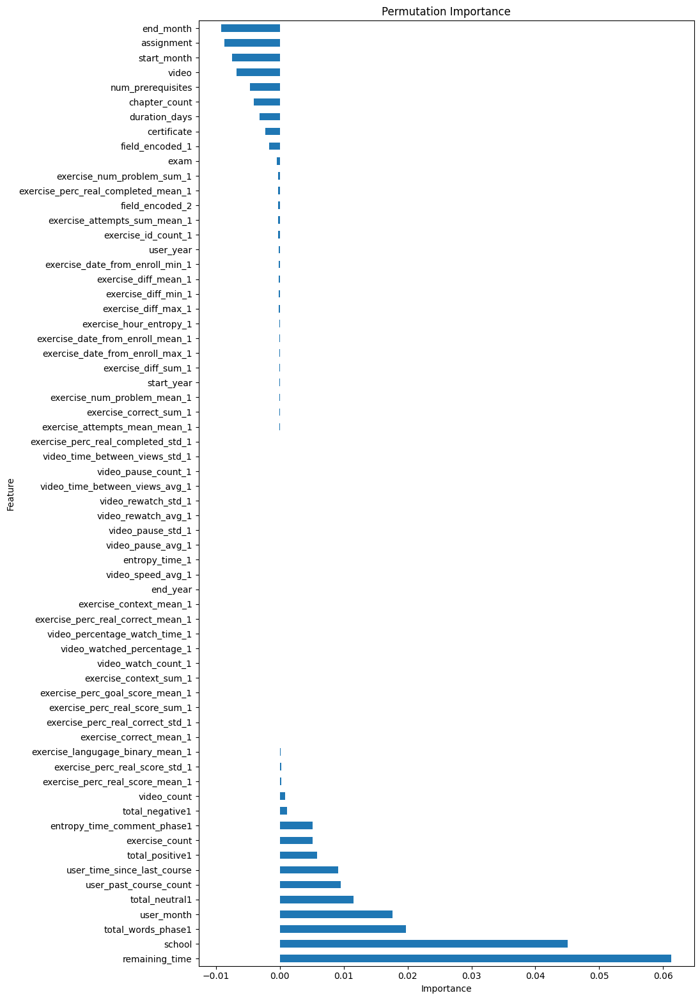

               Feature  Importance
20      remaining_time    0.061311
0               school    0.045079
60  total_words_phase1    0.019732
8           user_month    0.017602
63      total_neutral1    0.011493
..                 ...         ...
14   num_prerequisites   -0.004690
17               video   -0.006836
4          start_month   -0.007464
16          assignment   -0.008719
6            end_month   -0.009214

[64 rows x 2 columns]

Lasso Feature Selection for phase: phase1


Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.177e+00, tolerance: 4.255e-01


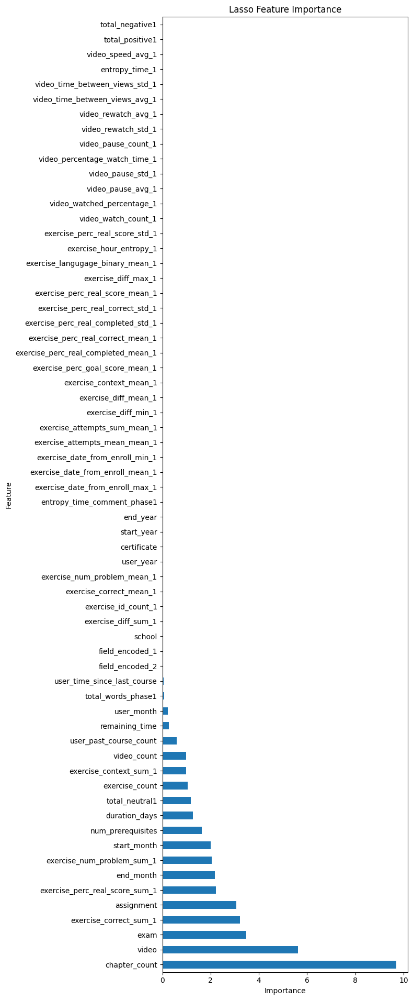

                           Feature  Importance
11                   chapter_count    9.691239
17                           video    5.618284
18                            exam    3.478487
23          exercise_correct_sum_1    3.219016
16                      assignment    3.068723
..                             ...         ...
57  video_time_between_views_std_1    0.000000
59                  entropy_time_1    0.000000
58               video_speed_avg_1    0.000000
61                 total_positive1    0.000000
62                 total_negative1    0.000000

[64 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                           Feature  Importance
64                  Random Feature    0.220978
20                  remaining_time    0.129886
17                           video    0.082599
16                      assignment    0.076737
0                           school    0.063750
..                             ...         ...
56  video_time_between

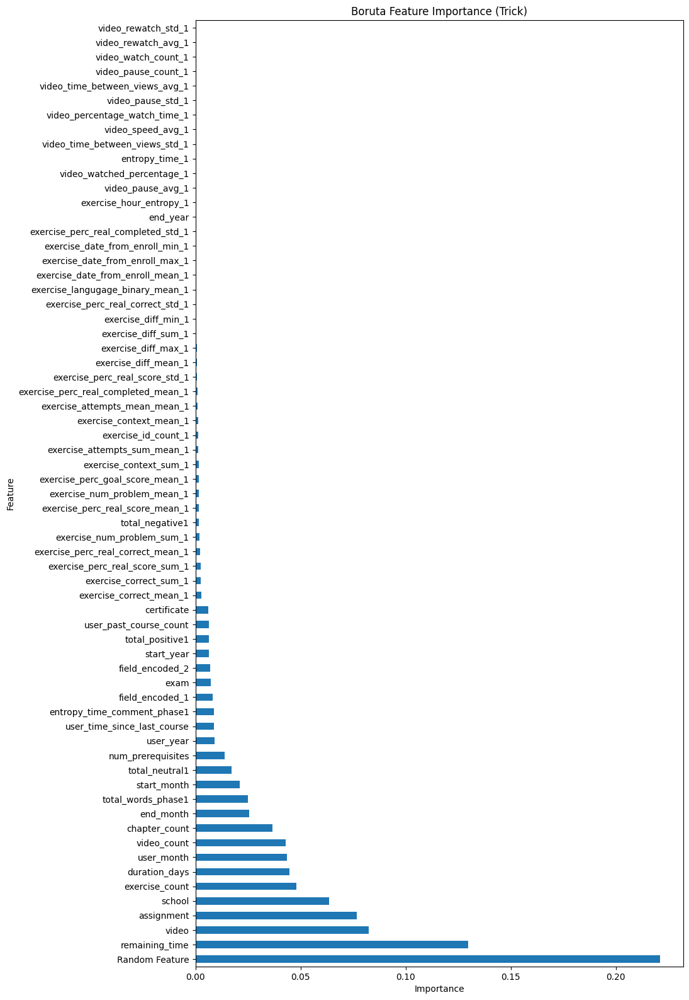

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None
Results saved as test_results_undersample_log_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.8318052  0.67260884 0.46575342 0.55388813 0.73015873]
Precision (per class): [0.91229805 0.66553596 0.34       0.40357853 0.60526316]
Recall (per class): [0.76436464 0.67983368 0.73913043 0.8826087  0.92      ]
Accuracy: 0.7469
AUC (One-vs-Rest): 0.9339

Classification Report:
              precision    recall  f1-score   support

           E       0.91      0.76      0.83      3620
           D       0.67      0.68      0.67      1443
           C       0.34      0.74      0.47       230
           B       0.40      0.88      0.55       230
           A       0.61      0.92      0.73        25

    accuracy                           0.75      5548
   macro avg

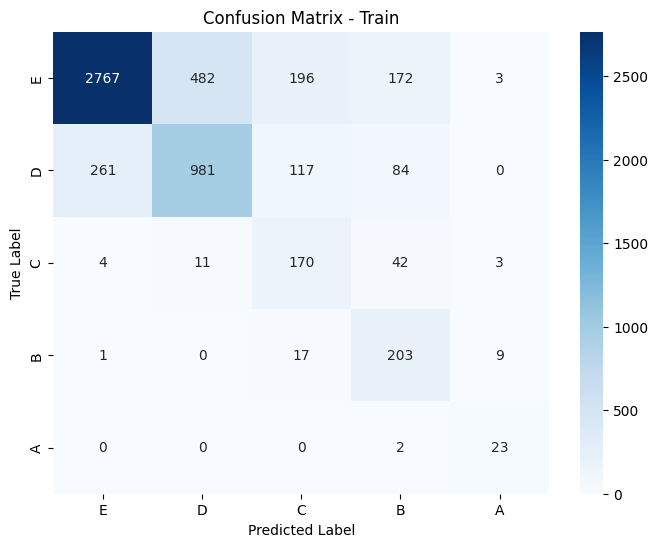

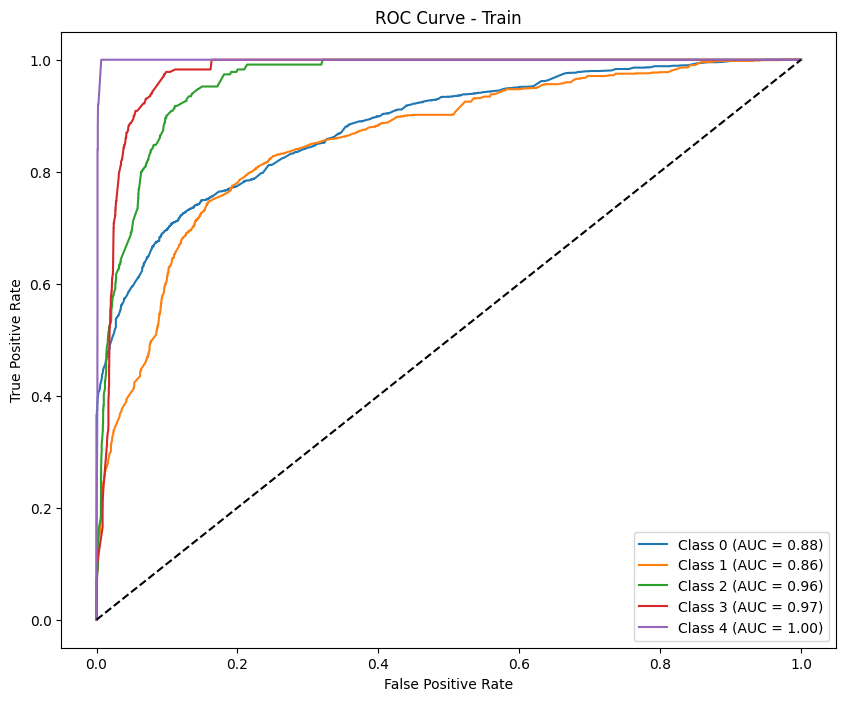


--- Test Metrics ---
F1 Score (per class): [0.90022173 0.04255319 0.         0.         0.        ]
Precision (per class): [0.81854839 1.         0.         0.         0.        ]
Recall (per class): [1.         0.02173913 0.         0.         0.        ]
Accuracy: 0.8190
AUC (One-vs-Rest): 0.7376

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       609
           D       1.00      0.02      0.04        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.82       746
   macro avg       0.36      0.20      0.19       746
weighted avg       0.79      0.82      0.74       746



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


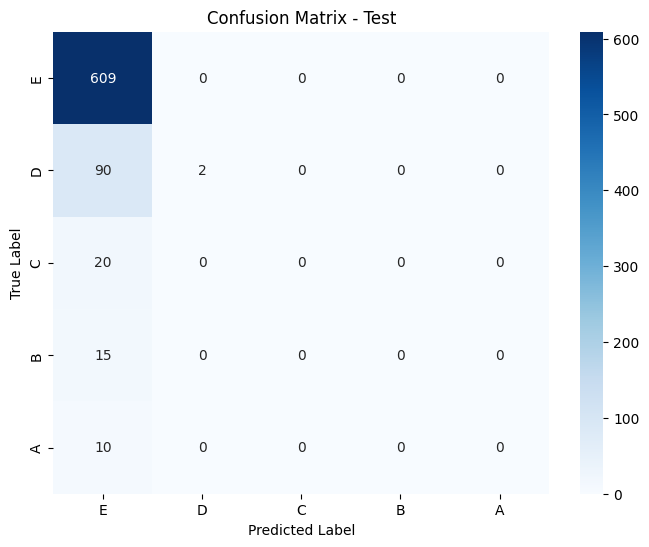

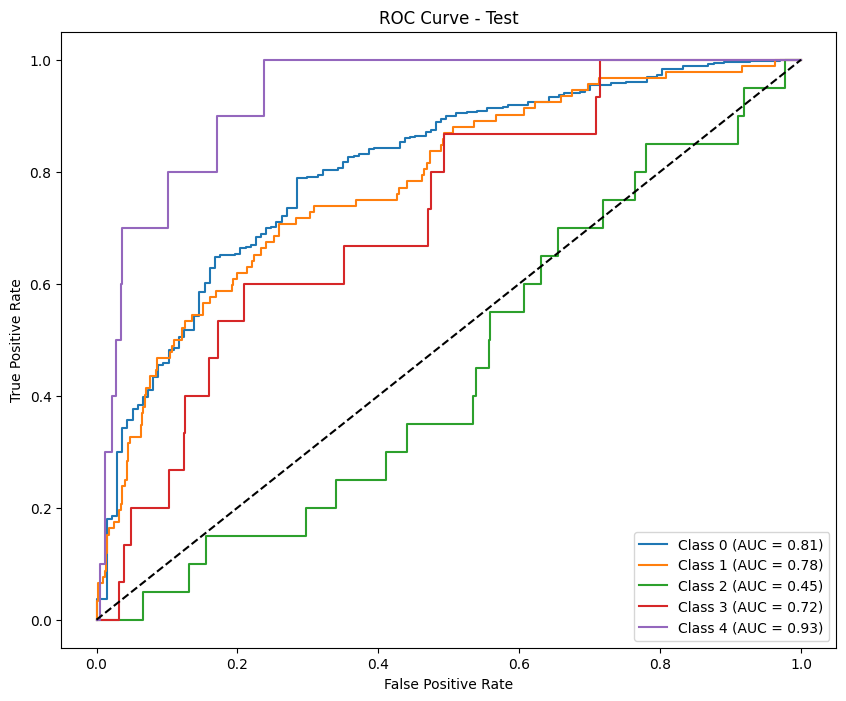

Results saved as test_results_calibrate_undersample_log_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.85220421 0.61496279 0.53626374 0.6234676  0.77777778]
Precision (per class): [0.82747853 0.70720721 0.54222222 0.52199413 0.72413793]
Recall (per class): [0.87845304 0.54400554 0.53043478 0.77391304 0.84      ]
Accuracy: 0.7725
AUC (One-vs-Rest): 0.9414

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.88      0.85      3620
           D       0.71      0.54      0.61      1443
           C       0.54      0.53      0.54       230
           B       0.52      0.77      0.62       230
           A       0.72      0.84      0.78        25

    accuracy                           0.77      5548
   macro avg       0.66      0.71      0.68      5548
weighted avg       0.77      0.77      0.77      5548



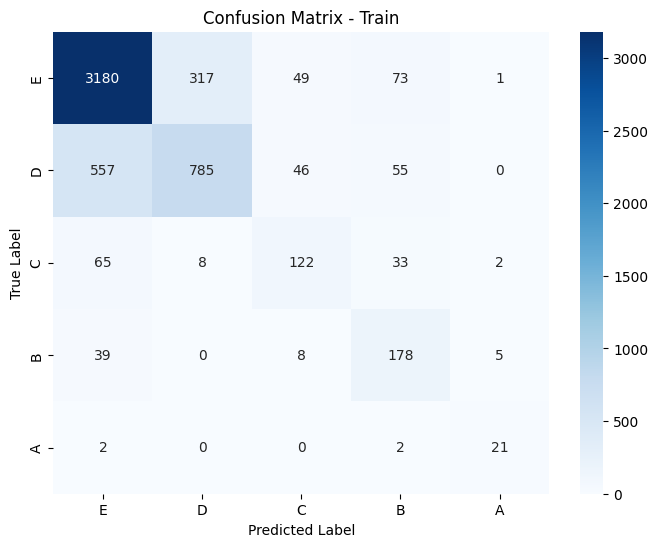

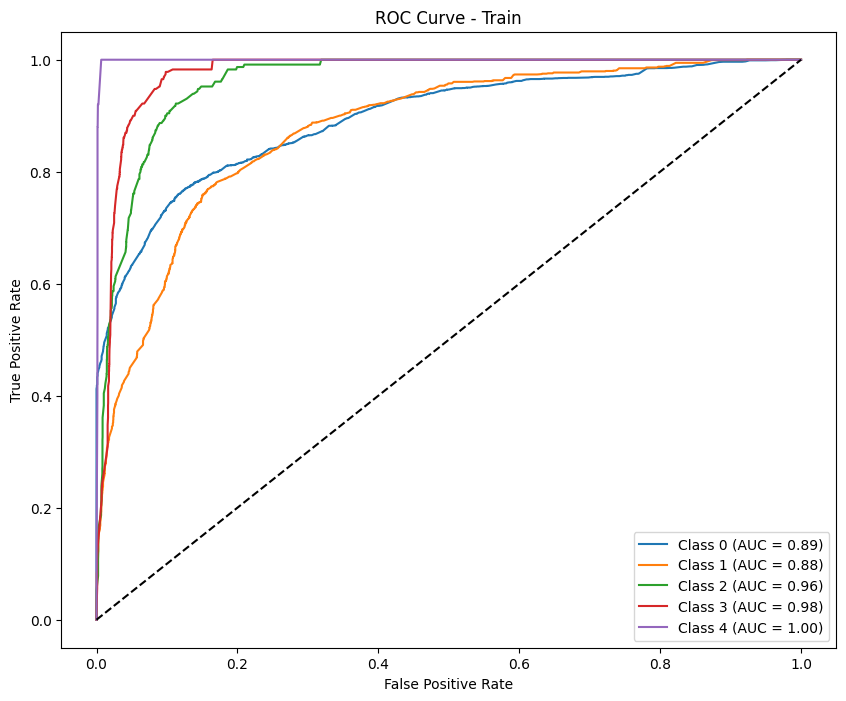


--- Test Metrics ---
F1 Score (per class): [0.89889299 0.         0.         0.         0.        ]
Precision (per class): [0.81635389 0.         0.         0.         0.        ]
Recall (per class): [1. 0. 0. 0. 0.]
Accuracy: 0.8164
AUC (One-vs-Rest): 0.7366

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       609
           D       0.00      0.00      0.00        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.82       746
   macro avg       0.16      0.20      0.18       746
weighted avg       0.67      0.82      0.73       746



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


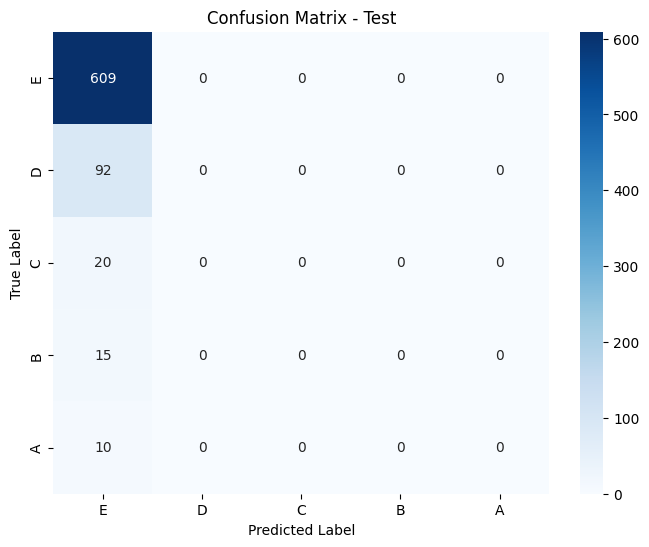

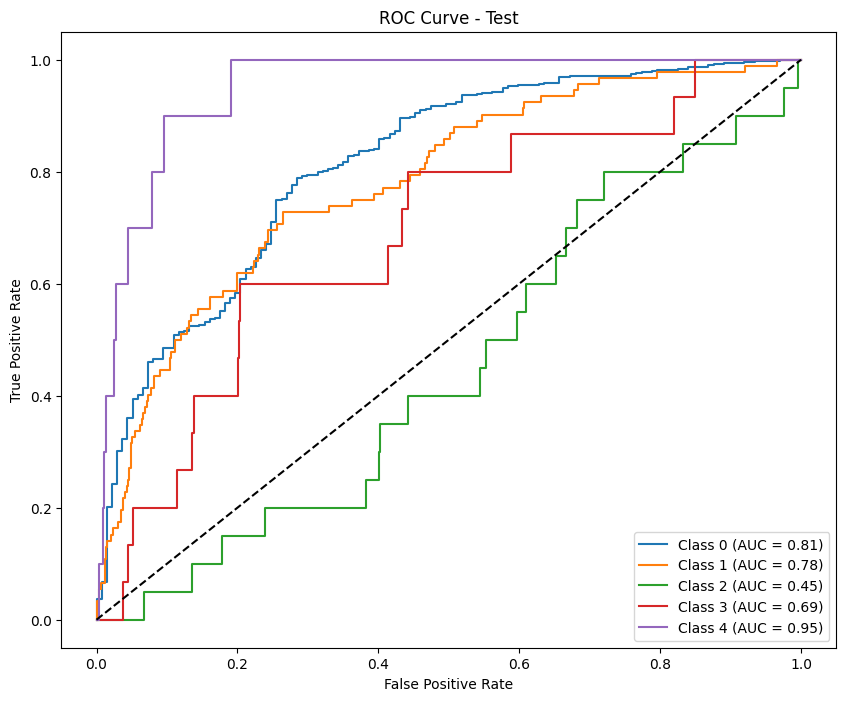


Permutation Importance for phase: phase2


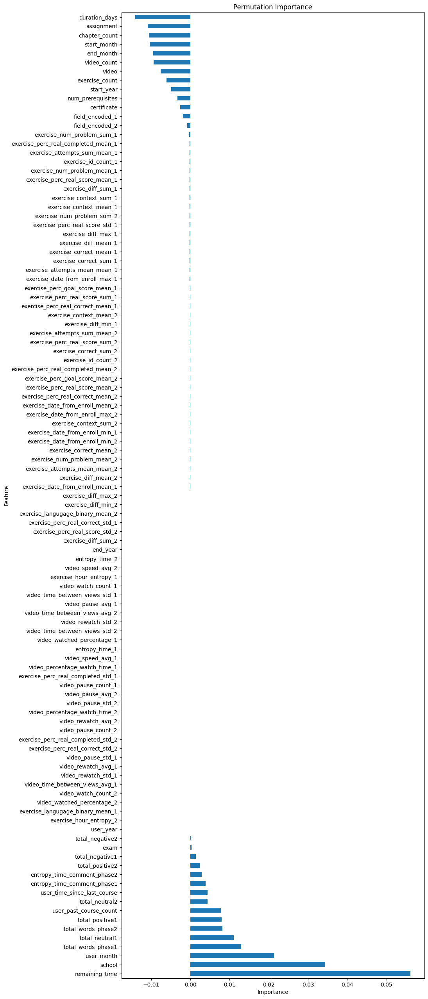

               Feature  Importance
20      remaining_time    0.056146
0               school    0.034382
8           user_month    0.021337
60  total_words_phase1    0.012978
63      total_neutral1    0.011040
..                 ...         ...
6            end_month   -0.009463
4          start_month   -0.010387
11       chapter_count   -0.010522
16          assignment   -0.010905
19       duration_days   -0.014082

[107 rows x 2 columns]

Lasso Feature Selection for phase: phase2


Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.601e+00, tolerance: 3.526e-01


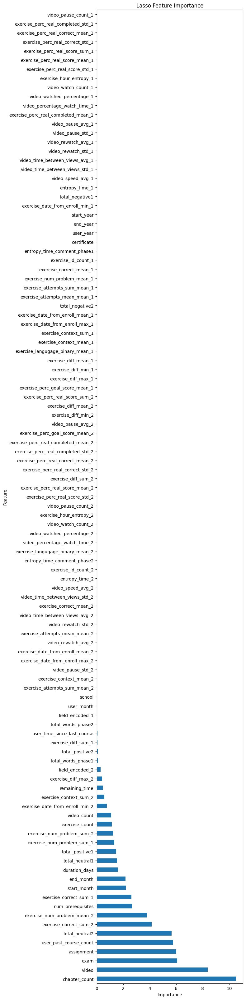

                               Feature  Importance
11                       chapter_count   10.507989
17                               video    8.368181
18                                exam    6.068094
16                          assignment    5.993612
12              user_past_course_count    5.779950
..                                 ...         ...
44      exercise_perc_real_score_sum_1    0.000000
43    exercise_perc_real_correct_std_1    0.000000
42   exercise_perc_real_correct_mean_1    0.000000
41  exercise_perc_real_completed_std_1    0.000000
51                 video_pause_count_1    0.000000

[107 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                            Feature  Importance
107                  Random Feature    0.182988
20                   remaining_time    0.126660
16                       assignment    0.079823
17                            video    0.077100
0                            school    0.061207
..            

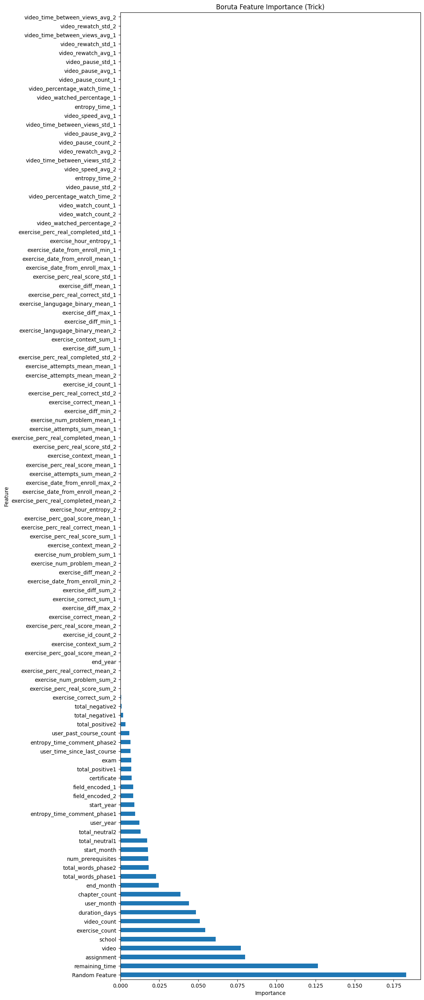

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None
Results saved as test_results_undersample_log_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.83682739 0.68761978 0.48764415 0.57467532 0.68      ]
Precision (per class): [0.92115385 0.66493699 0.35748792 0.43276284 0.5483871 ]
Recall (per class): [0.76664533 0.71190476 0.76683938 0.85507246 0.89473684]
Accuracy: 0.7566
AUC (One-vs-Rest): 0.9365

Classification Report:
              precision    recall  f1-score   support

           E       0.92      0.77      0.84      3124
           D       0.66      0.71      0.69      1260
           C       0.36      0.77      0.49       193
           B       0.43      0.86      0.57       207
           A       0.55      0.89      0.68        19

    accuracy                           0.76      4803
   macro avg

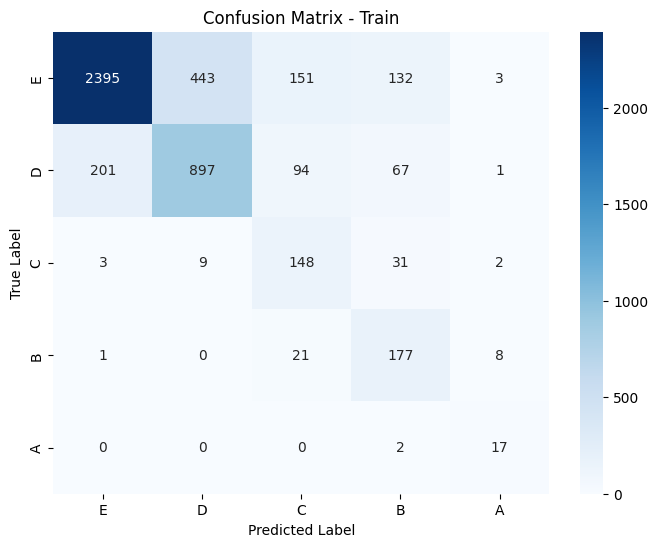

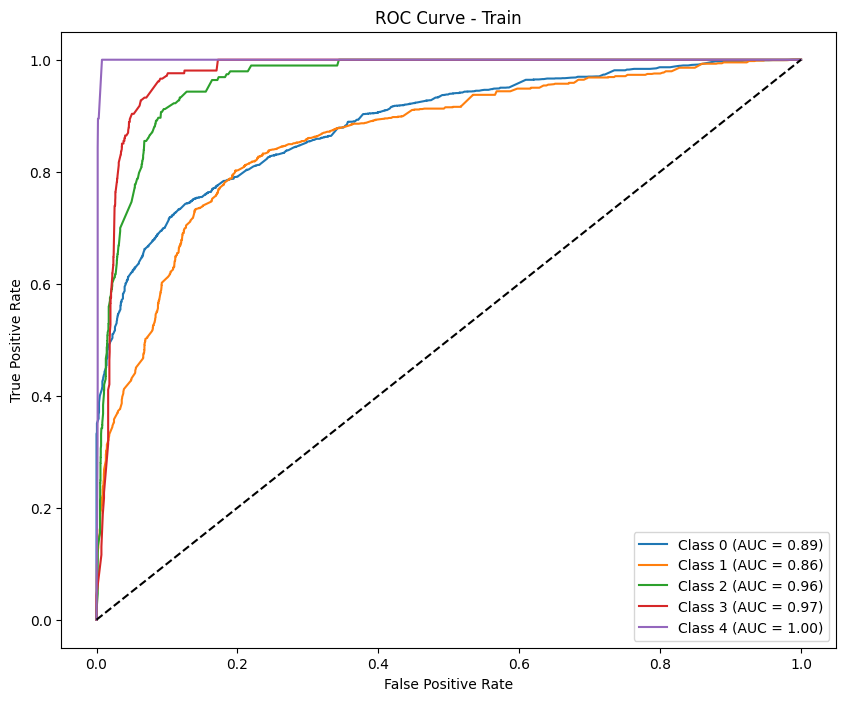


--- Test Metrics ---
F1 Score (per class): [0.89671002 0.         0.         0.         0.        ]
Precision (per class): [0.81502086 0.         0.         0.         0.        ]
Recall (per class): [0.99659864 0.         0.         0.         0.        ]
Accuracy: 0.8128
AUC (One-vs-Rest): 0.6335

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       588
           D       0.00      0.00      0.00        87
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.81       721
   macro avg       0.16      0.20      0.18       721
weighted avg       0.66      0.81      0.73       721



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


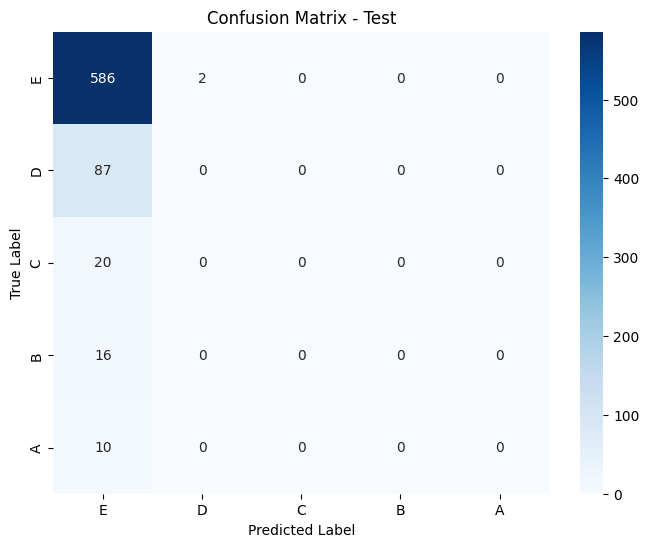

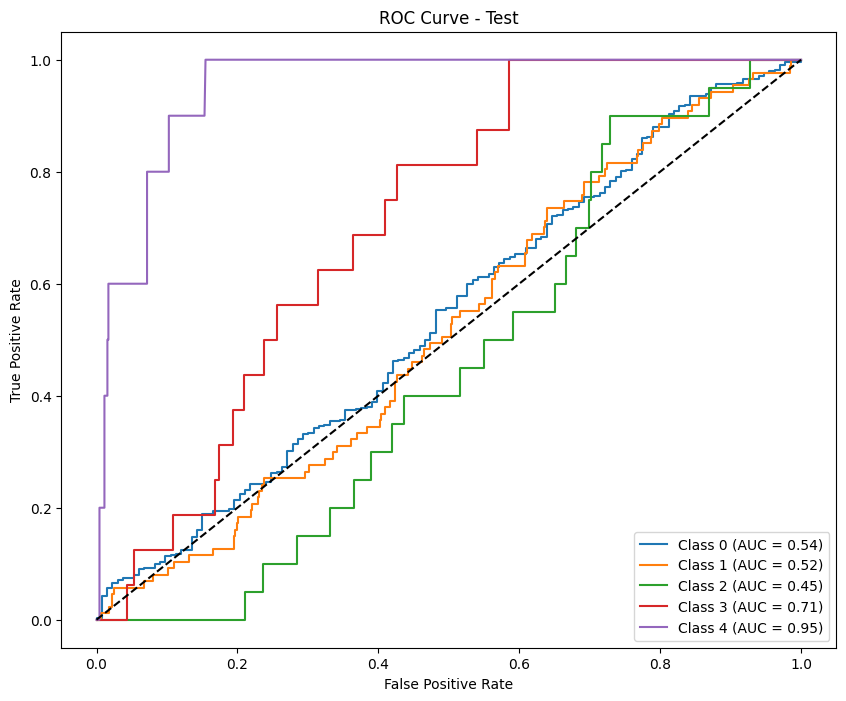

Results saved as test_results_calibrate_undersample_log_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.85887661 0.64174455 0.56265985 0.62925852 0.71428571]
Precision (per class): [0.835604   0.73049645 0.55555556 0.53767123 0.65217391]
Recall (per class): [0.88348271 0.57222222 0.56994819 0.75845411 0.78947368]
Accuracy: 0.7835
AUC (One-vs-Rest): 0.9446

Classification Report:
              precision    recall  f1-score   support

           E       0.84      0.88      0.86      3124
           D       0.73      0.57      0.64      1260
           C       0.56      0.57      0.56       193
           B       0.54      0.76      0.63       207
           A       0.65      0.79      0.71        19

    accuracy                           0.78      4803
   macro avg       0.66      0.71      0.68      4803
weighted avg       0.78      0.78      0.78      4803



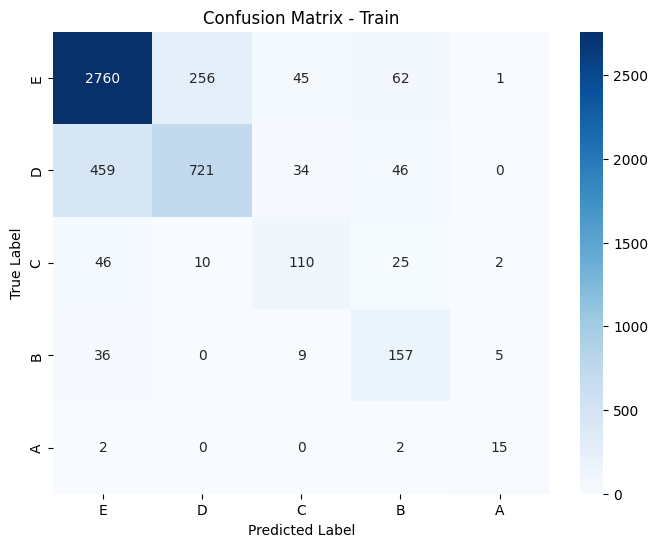

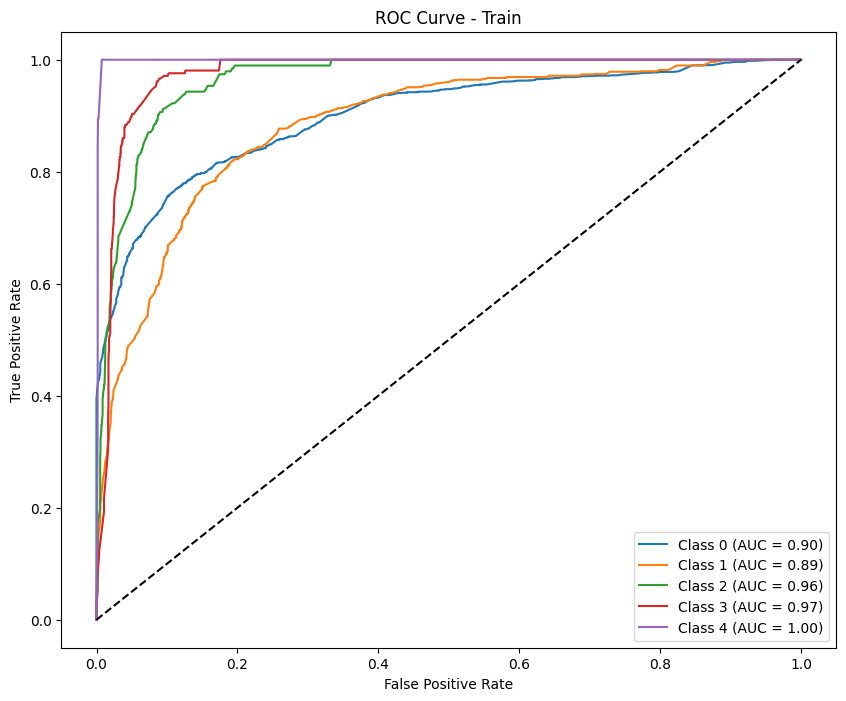


--- Test Metrics ---
F1 Score (per class): [0.89839572 0.         0.         0.         0.        ]
Precision (per class): [0.81553398 0.         0.         0.         0.        ]
Recall (per class): [1. 0. 0. 0. 0.]
Accuracy: 0.8155
AUC (One-vs-Rest): 0.6344

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       588
           D       0.00      0.00      0.00        87
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.82       721
   macro avg       0.16      0.20      0.18       721
weighted avg       0.67      0.82      0.73       721



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


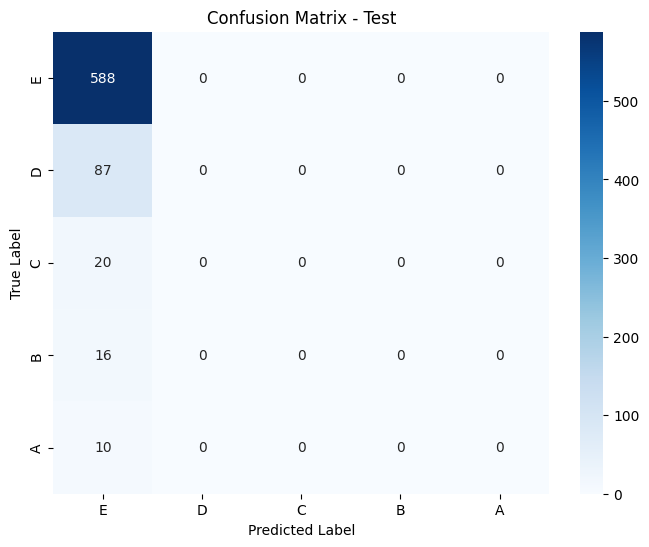

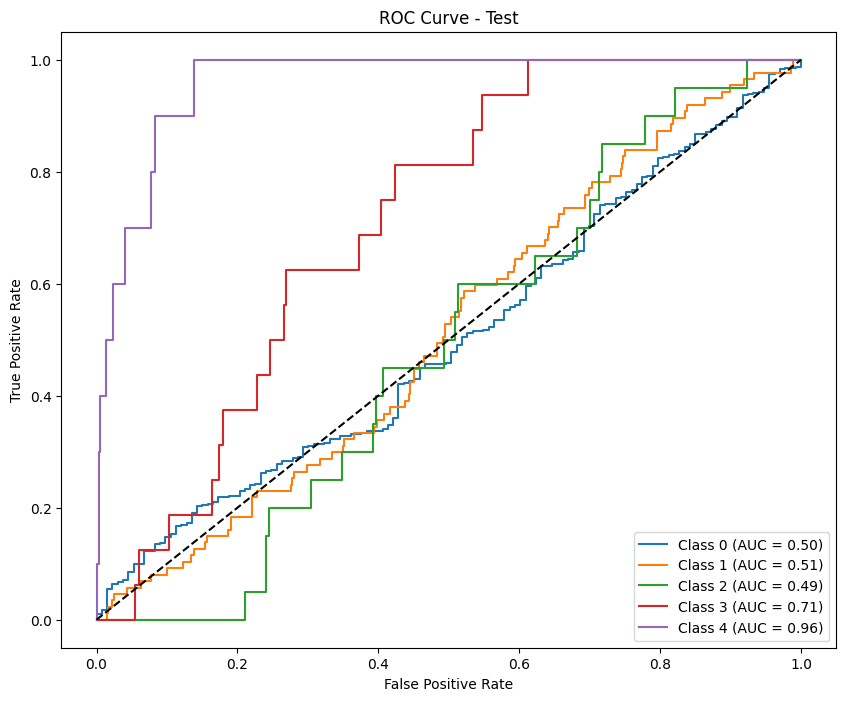

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None
Results saved as test_results_undersample_log_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.83833635 0.7061812  0.46280992 0.70212766 0.68292683]
Precision (per class): [0.92130366 0.69616027 0.32061069 0.60829493 0.51851852]
Recall (per class): [0.76907764 0.71649485 0.83168317 0.83018868 1.        ]
Accuracy: 0.7643
AUC (One-vs-Rest): 0.9433

Classification Report:
              precision    recall  f1-score   support

           E       0.92      0.77      0.84      1507
           D       0.70      0.72      0.71       582
           C       0.32      0.83      0.46       101
           B       0.61      0.83      0.70       159
           A       0.52      1.00      0.68        14

    accuracy                           0.76      2363
   macro avg

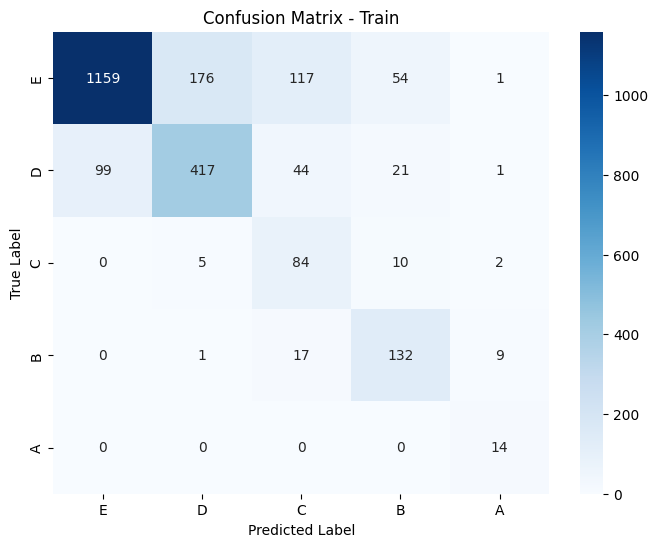

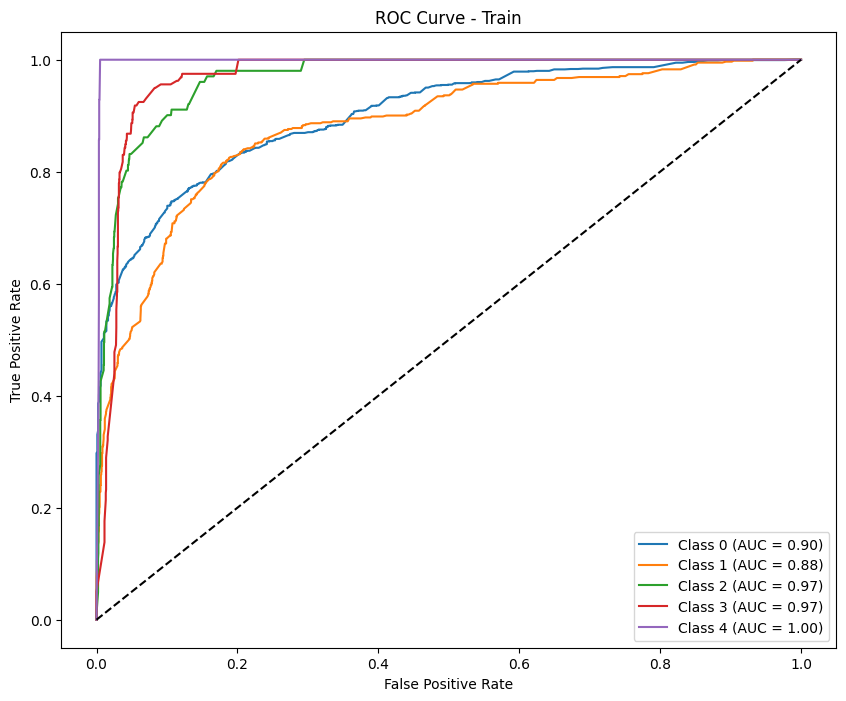


--- Test Metrics ---
F1 Score (per class): [0.88527258 0.02040816 0.         0.         0.        ]
Precision (per class): [0.80712166 0.07692308 0.         0.         0.        ]
Recall (per class): [0.98018018 0.01176471 0.         0.         0.        ]
Accuracy: 0.7933
AUC (One-vs-Rest): 0.5973

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.98      0.89       555
           D       0.08      0.01      0.02        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.79       687
   macro avg       0.18      0.20      0.18       687
weighted avg       0.66      0.79      0.72       687



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


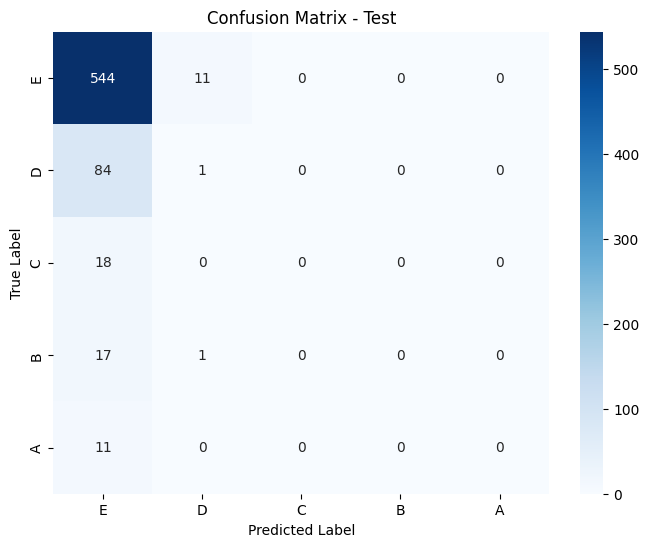

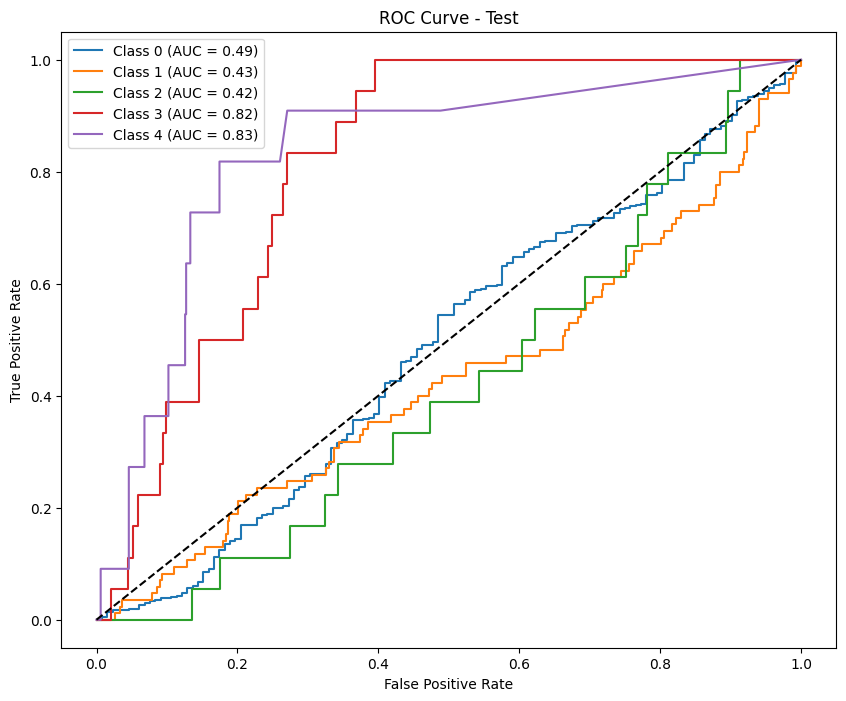

Results saved as test_results_calibrate_undersample_log_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.87943716 0.67418033 0.61206897 0.70588235 0.70588235]
Precision (per class): [0.84876543 0.83502538 0.54198473 0.63636364 0.6       ]
Recall (per class): [0.91240876 0.5652921  0.7029703  0.79245283 0.85714286]
Accuracy: 0.8096
AUC (One-vs-Rest): 0.9505

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.91      0.88      1507
           D       0.84      0.57      0.67       582
           C       0.54      0.70      0.61       101
           B       0.64      0.79      0.71       159
           A       0.60      0.86      0.71        14

    accuracy                           0.81      2363
   macro avg       0.69      0.77      0.72      2363
weighted avg       0.82      0.81      0.80      2363



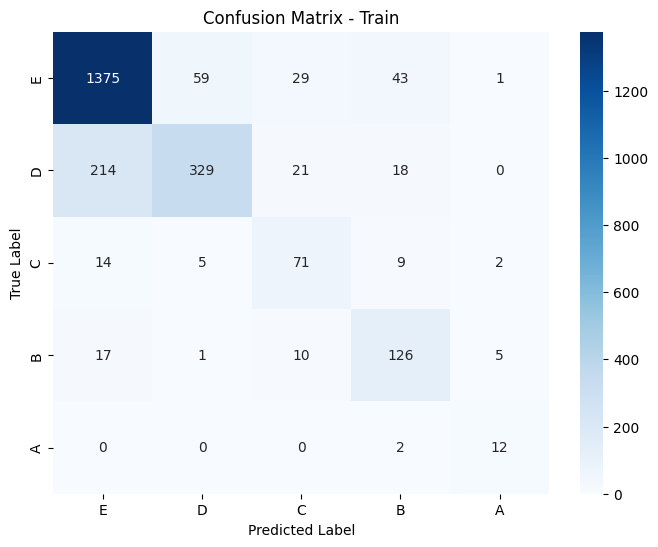

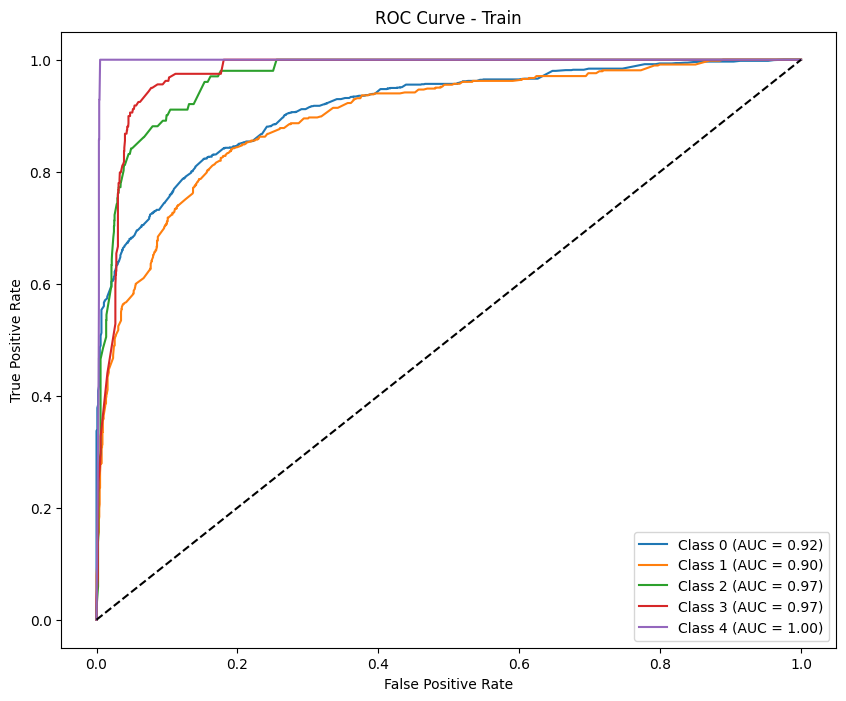


--- Test Metrics ---
F1 Score (per class): [0.89371981 0.         0.         0.         0.        ]
Precision (per class): [0.80786026 0.         0.         0.         0.        ]
Recall (per class): [1. 0. 0. 0. 0.]
Accuracy: 0.8079
AUC (One-vs-Rest): 0.6041

Classification Report:
              precision    recall  f1-score   support

           E       0.81      1.00      0.89       555
           D       0.00      0.00      0.00        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.81       687
   macro avg       0.16      0.20      0.18       687
weighted avg       0.65      0.81      0.72       687



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


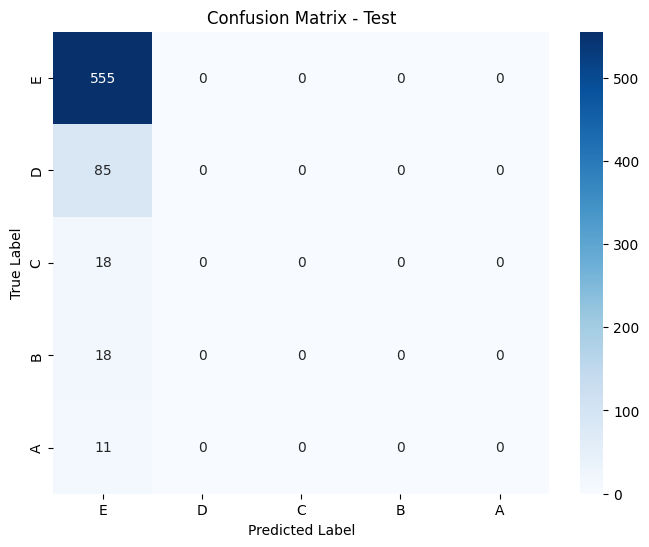

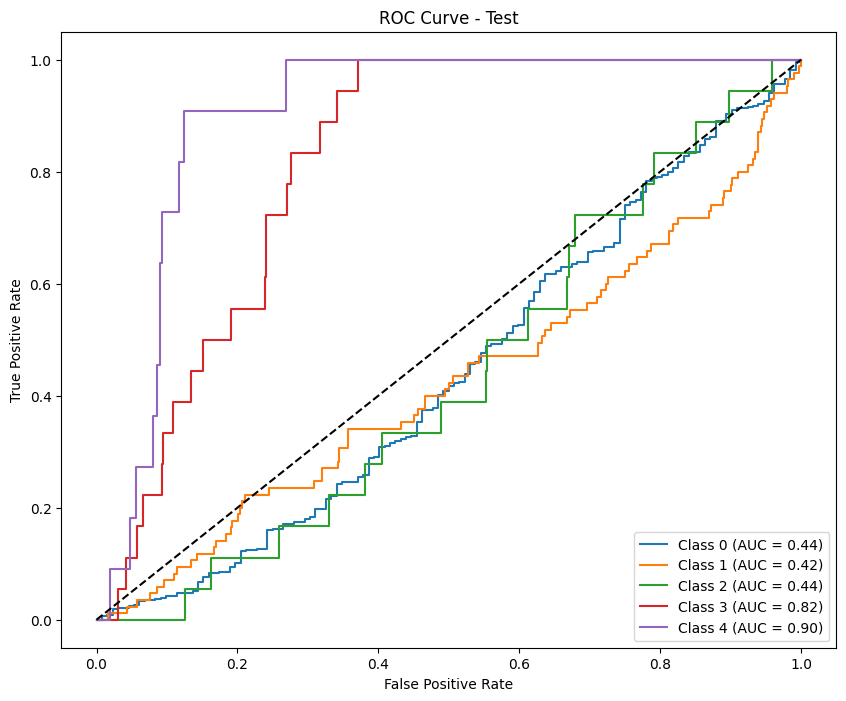

In [33]:
hyperparams = {
    "phase1": hp_1,
    "phase2": hp_2,
    "phase3": hp_3,
    "phase4": hp_4
}

for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_undersample_phase(phase, metric='f1_macro', scale='log', hyper=hyperparams[phase]) 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

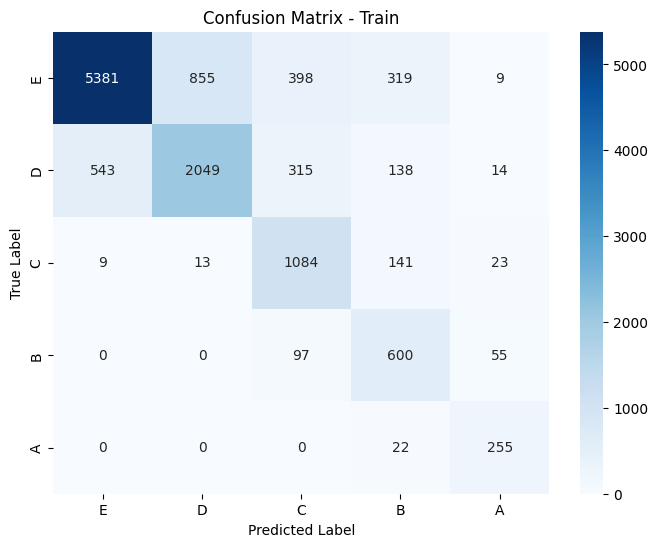

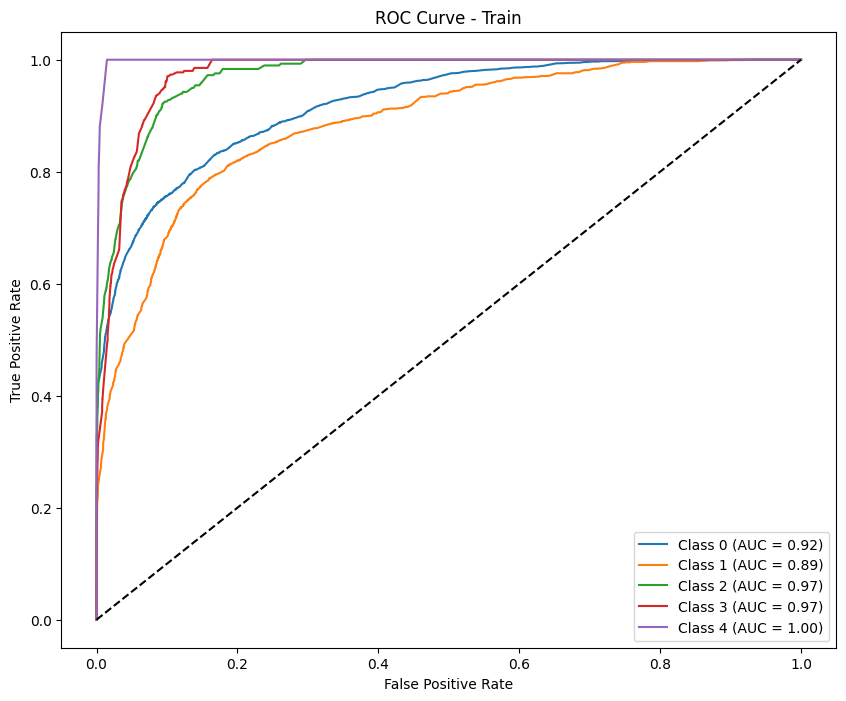


--- Test Metrics ---
F1 Score (per class): [0.92087415 0.35971223 0.         0.         0.        ]
Precision (per class): [0.85935302 0.55555556 0.         0.         0.        ]
Recall (per class): [0.99188312 0.26595745 0.         0.         0.        ]
Accuracy: 0.8413
AUC (One-vs-Rest): 0.8488

Classification Report:
              precision    recall  f1-score   support

           E       0.86      0.99      0.92       616
           D       0.56      0.27      0.36        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.84       756
   macro avg       0.28      0.25      0.26       756
weighted avg       0.77      0.84      0.80       756



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


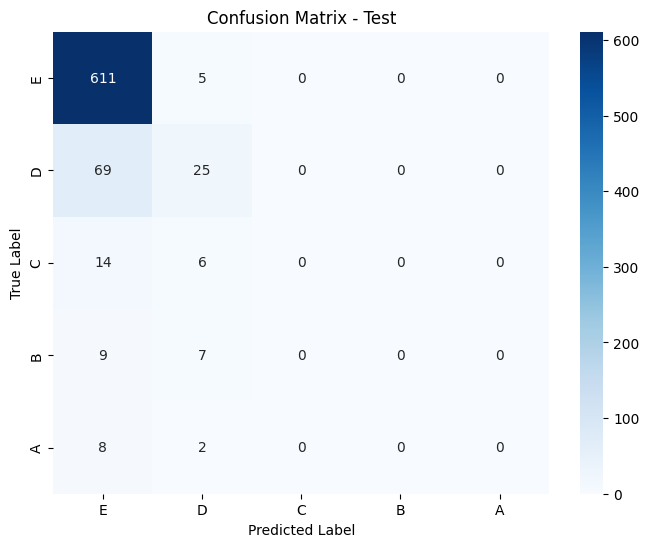

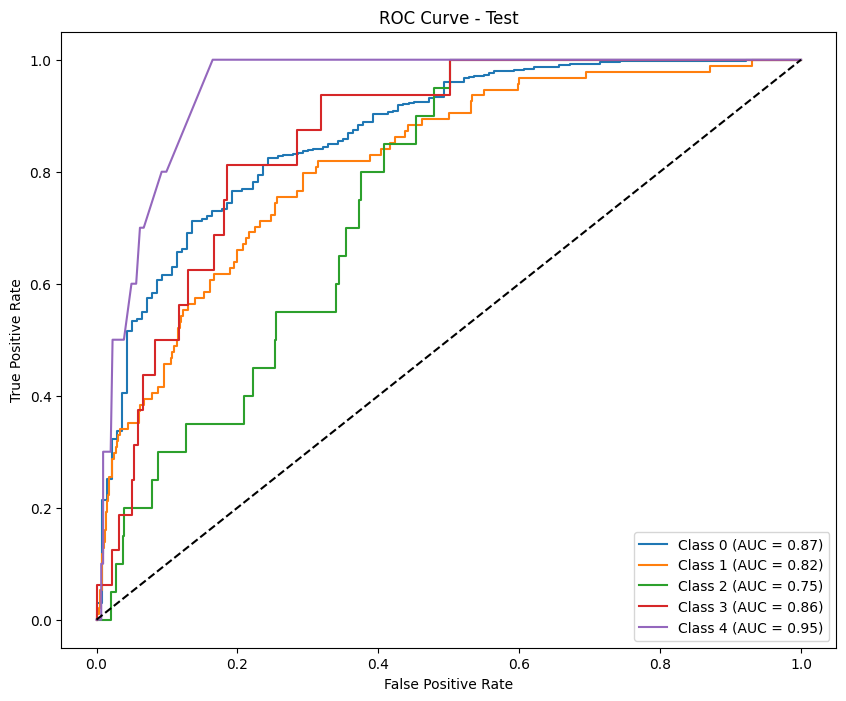

Results saved as test_results_calibrate_undersample_log_f1_macro_phase1.csv
Results for phase: phase1

--- Train Metrics ---
F1 Score (per class): [0.85093795 0.66041207 0.70219638 0.67504488 0.8457539 ]
Precision (per class): [0.85488547 0.75515355 0.59529025 0.61371055 0.81333333]
Recall (per class): [0.84702672 0.58679307 0.85590551 0.75       0.88086643]
Accuracy: 0.7782
AUC (One-vs-Rest): 0.9532

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.85      0.85      6962
           D       0.76      0.59      0.66      3059
           C       0.60      0.86      0.70      1270
           B       0.61      0.75      0.68       752
           A       0.81      0.88      0.85       277

    accuracy                           0.78     12320
   macro avg       0.73      0.78      0.75     12320
weighted avg       0.79      0.78      0.78     12320



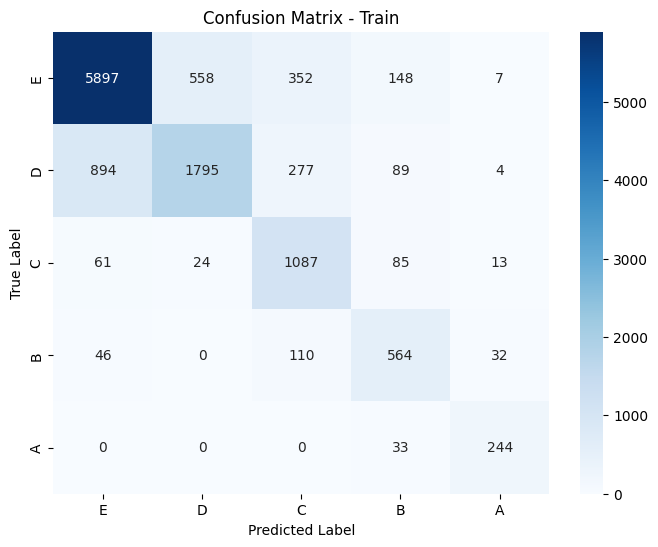

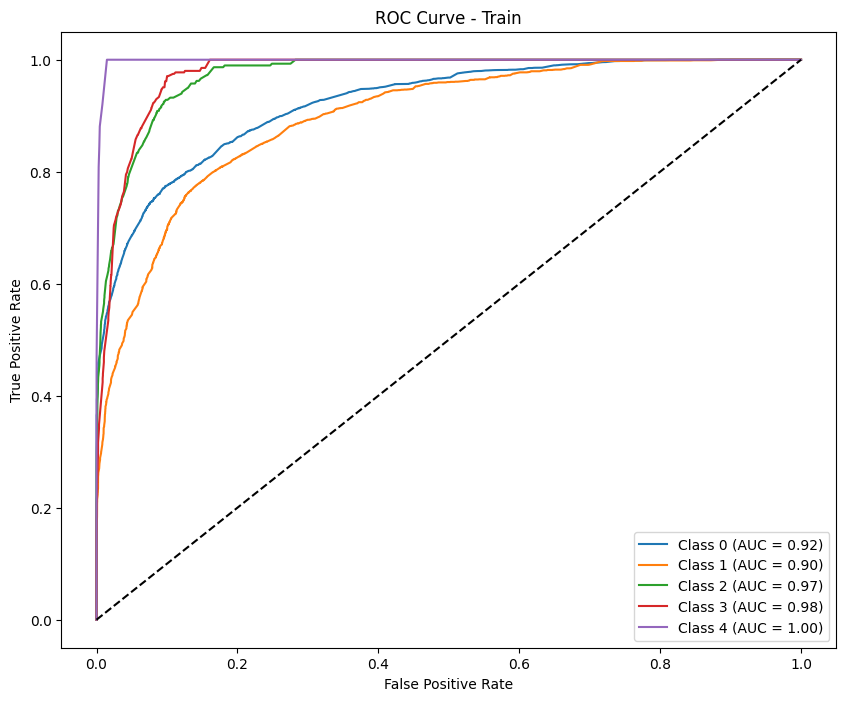


--- Test Metrics ---
F1 Score (per class): [0.9084195  0.17857143 0.         0.         0.        ]
Precision (per class): [0.83333333 0.55555556 0.         0.         0.        ]
Recall (per class): [0.99837662 0.10638298 0.         0.         0.        ]
Accuracy: 0.8267
AUC (One-vs-Rest): 0.8476

Classification Report:
              precision    recall  f1-score   support

           E       0.83      1.00      0.91       616
           D       0.56      0.11      0.18        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.83       756
   macro avg       0.28      0.22      0.22       756
weighted avg       0.75      0.83      0.76       756



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


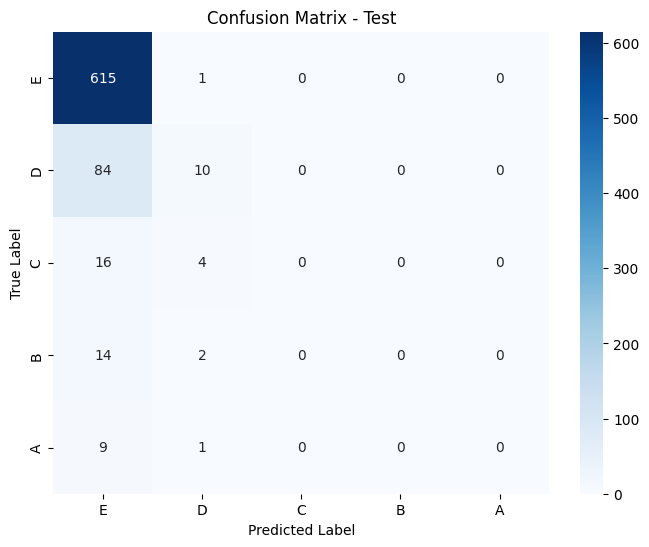

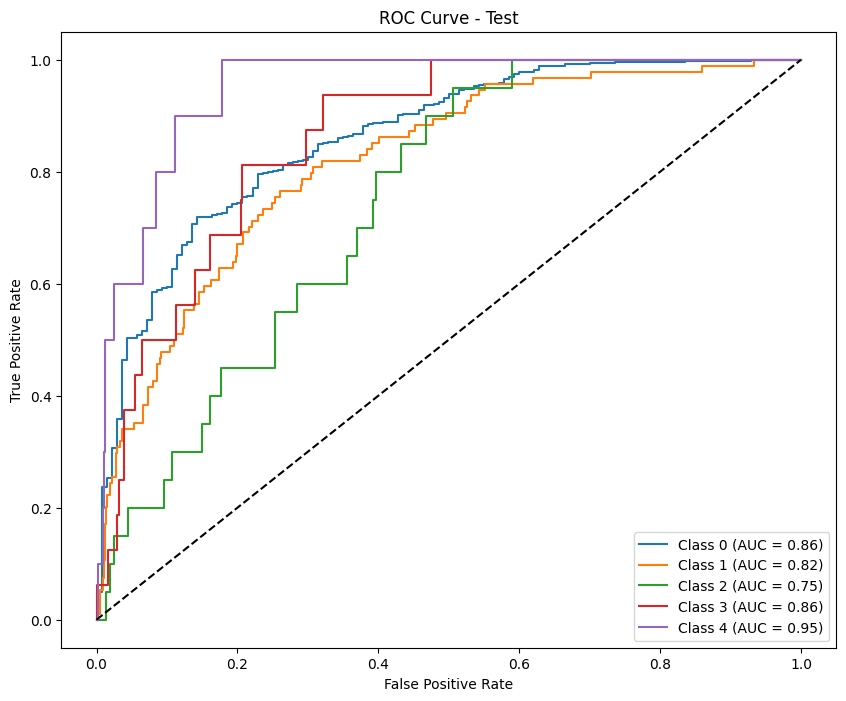


Permutation Importance for phase: phase1


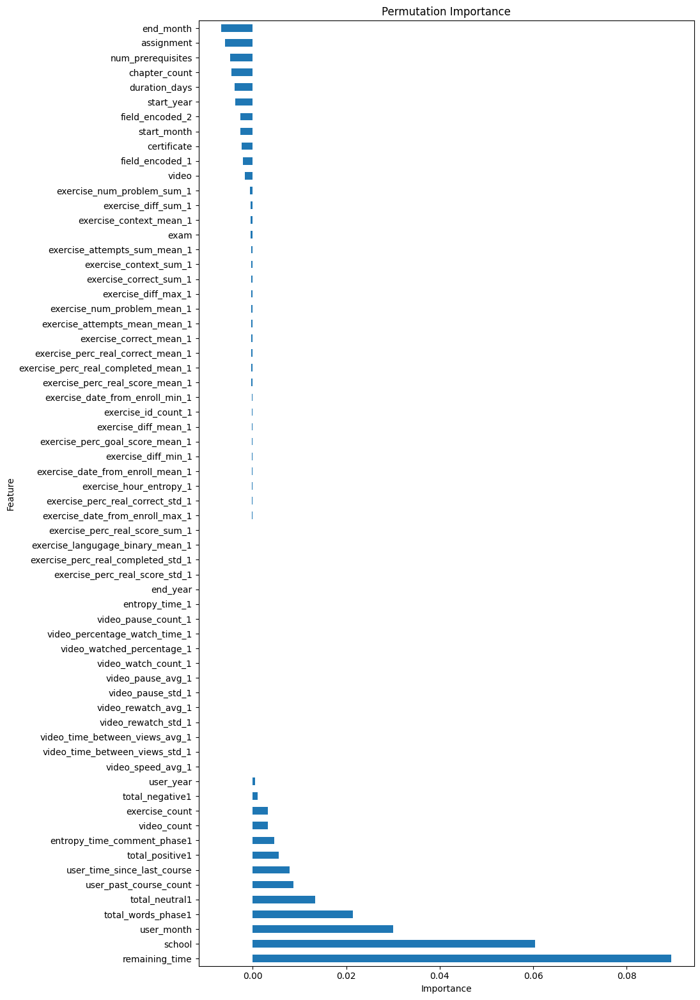

               Feature  Importance
20      remaining_time    0.089570
0               school    0.060349
8           user_month    0.030063
60  total_words_phase1    0.021388
63      total_neutral1    0.013393
..                 ...         ...
19       duration_days   -0.003805
11       chapter_count   -0.004525
14   num_prerequisites   -0.004870
16          assignment   -0.005976
6            end_month   -0.006767

[64 rows x 2 columns]

Lasso Feature Selection for phase: phase1


Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.314e+01, tolerance: 1.282e+00


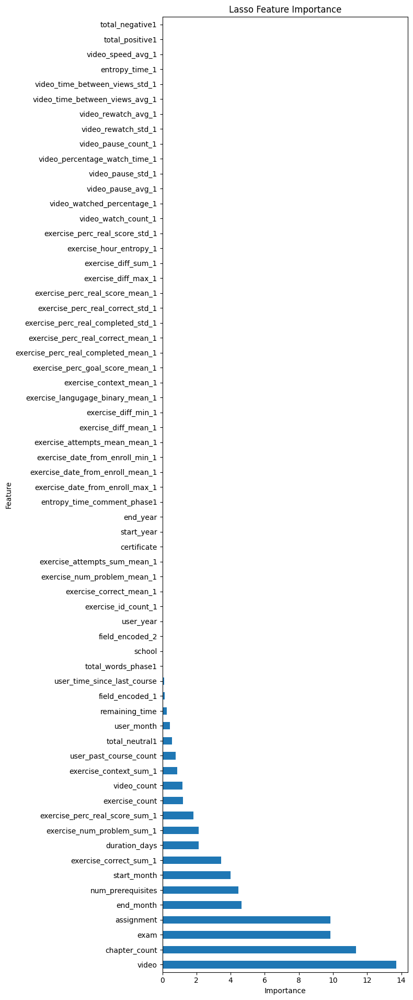

                           Feature  Importance
17                           video   13.697189
11                   chapter_count   11.344376
18                            exam    9.859732
16                      assignment    9.851117
6                        end_month    4.650374
..                             ...         ...
57  video_time_between_views_std_1    0.000000
59                  entropy_time_1    0.000000
58               video_speed_avg_1    0.000000
61                 total_positive1    0.000000
62                 total_negative1    0.000000

[64 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                           Feature    Importance
64                  Random Feature  1.698723e-01
20                  remaining_time  1.463008e-01
16                      assignment  8.551745e-02
17                           video  7.971077e-02
0                           school  6.771132e-02
..                             ...           ...
53      

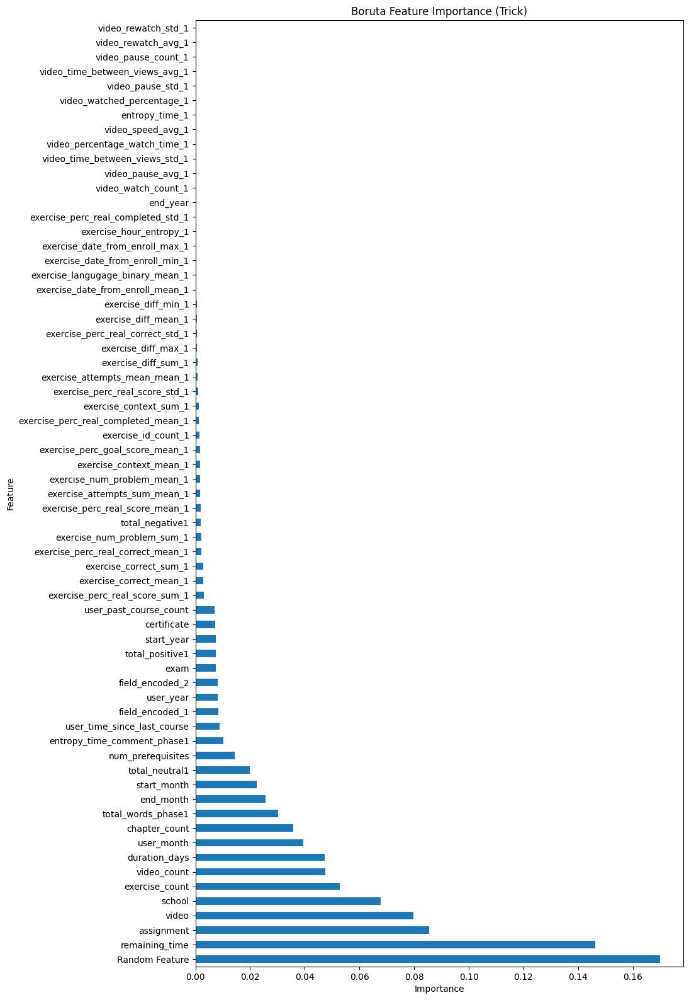

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None
Results saved as test_results_undersample_log_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.82213439 0.66030457 0.69845928 0.64438903 0.89241623]
Precision (per class): [0.89711761 0.65511684 0.63636364 0.50666667 0.86643836]
Recall (per class): [0.75871886 0.66557511 0.77398374 0.88493151 0.92      ]
Accuracy: 0.7517
AUC (One-vs-Rest): 0.9422

Classification Report:
              precision    recall  f1-score   support

           E       0.90      0.76      0.82      5620
           D       0.66      0.67      0.66      2443
           C       0.64      0.77      0.70      1230
           B       0.51      0.88      0.64       730
           A       0.87      0.92      0.89       275

    accuracy                           0.75     10298
   macro avg

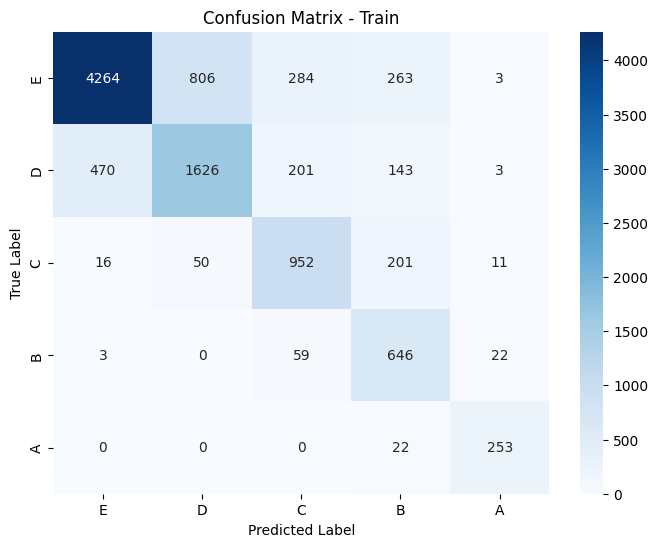

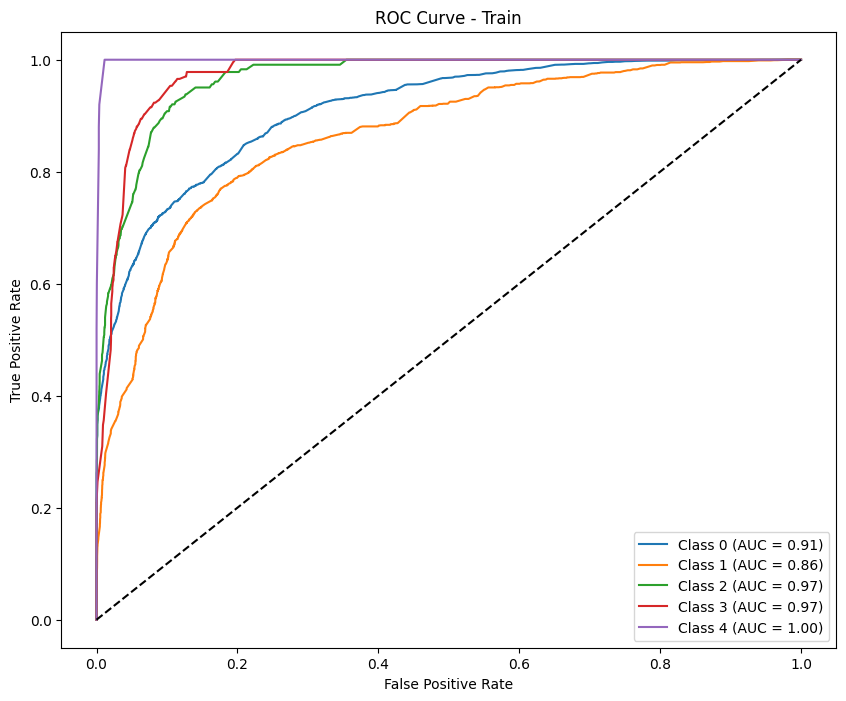


--- Test Metrics ---
F1 Score (per class): [0.90490342 0.0990099  0.         0.         0.        ]
Precision (per class): [0.82632293 0.55555556 0.         0.         0.        ]
Recall (per class): [1.         0.05434783 0.         0.         0.        ]
Accuracy: 0.8231
AUC (One-vs-Rest): 0.7498

Classification Report:
              precision    recall  f1-score   support

           E       0.83      1.00      0.90       609
           D       0.56      0.05      0.10        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.82       746
   macro avg       0.28      0.21      0.20       746
weighted avg       0.74      0.82      0.75       746



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


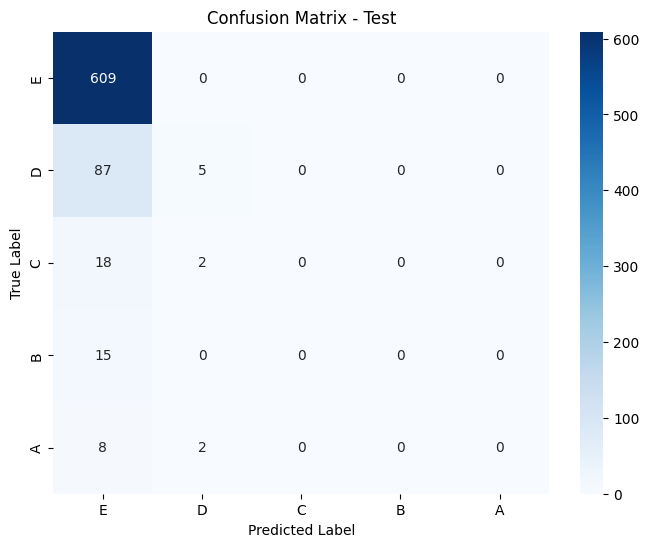

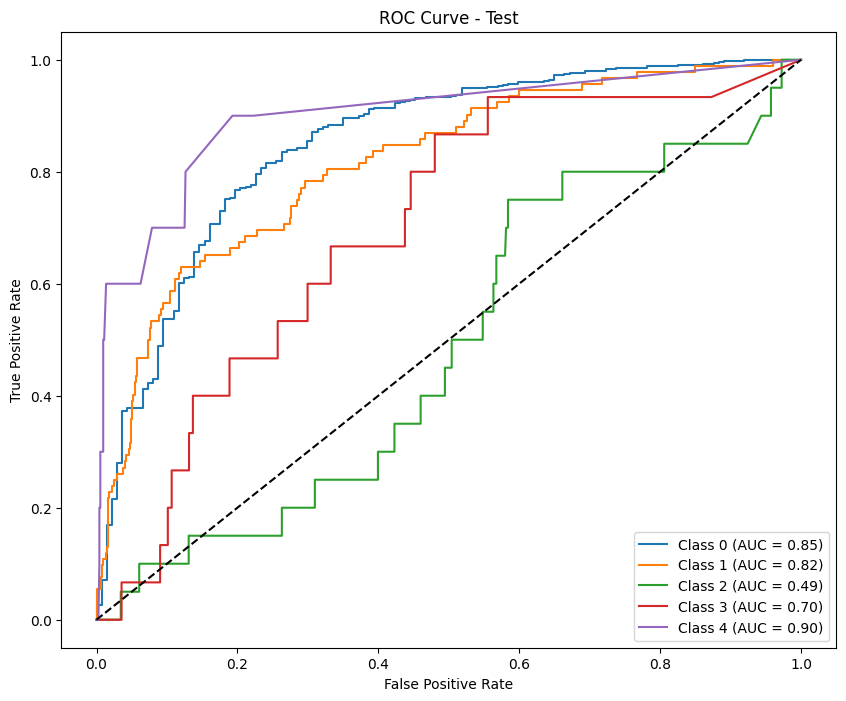

Results saved as test_results_calibrate_undersample_log_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.84075297 0.62021545 0.71838235 0.68854347 0.89241623]
Precision (per class): [0.84308463 0.7046875  0.6557047  0.5938431  0.86643836]
Recall (per class): [0.83843416 0.55382726 0.79430894 0.81917808 0.92      ]
Accuracy: 0.7665
AUC (One-vs-Rest): 0.9466

Classification Report:
              precision    recall  f1-score   support

           E       0.84      0.84      0.84      5620
           D       0.70      0.55      0.62      2443
           C       0.66      0.79      0.72      1230
           B       0.59      0.82      0.69       730
           A       0.87      0.92      0.89       275

    accuracy                           0.77     10298
   macro avg       0.73      0.79      0.75     10298
weighted avg       0.77      0.77      0.76     10298



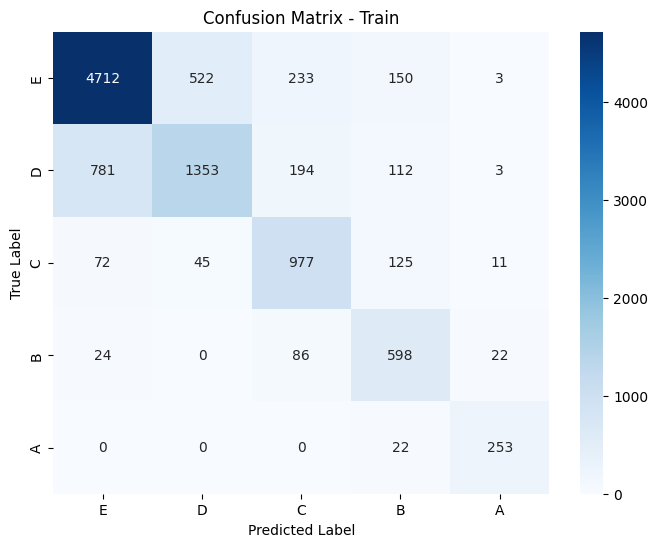

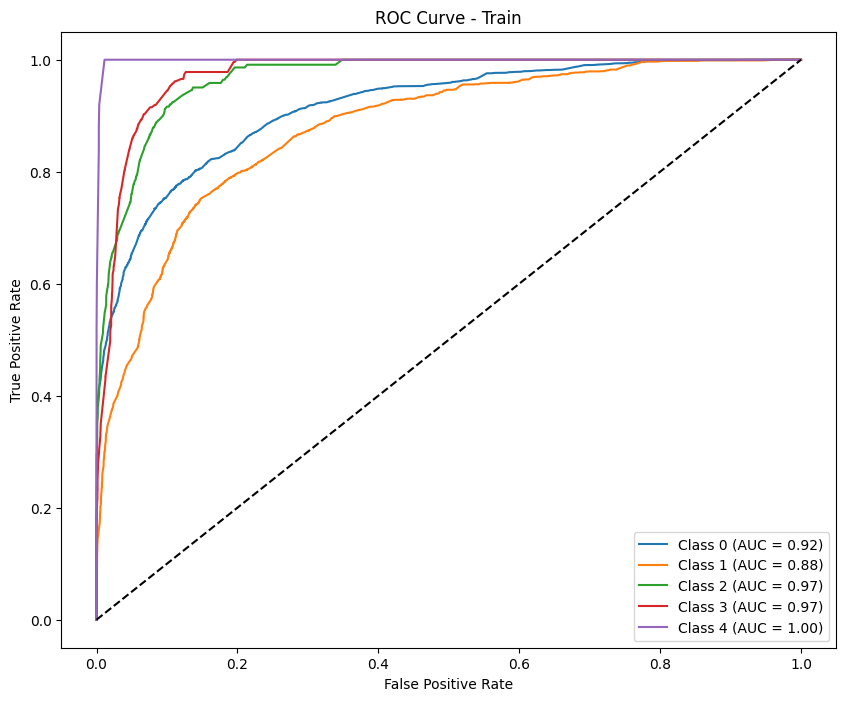


--- Test Metrics ---
F1 Score (per class): [0.89889299 0.         0.         0.         0.        ]
Precision (per class): [0.81635389 0.         0.         0.         0.        ]
Recall (per class): [1. 0. 0. 0. 0.]
Accuracy: 0.8164
AUC (One-vs-Rest): 0.7483

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       609
           D       0.00      0.00      0.00        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.82       746
   macro avg       0.16      0.20      0.18       746
weighted avg       0.67      0.82      0.73       746



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


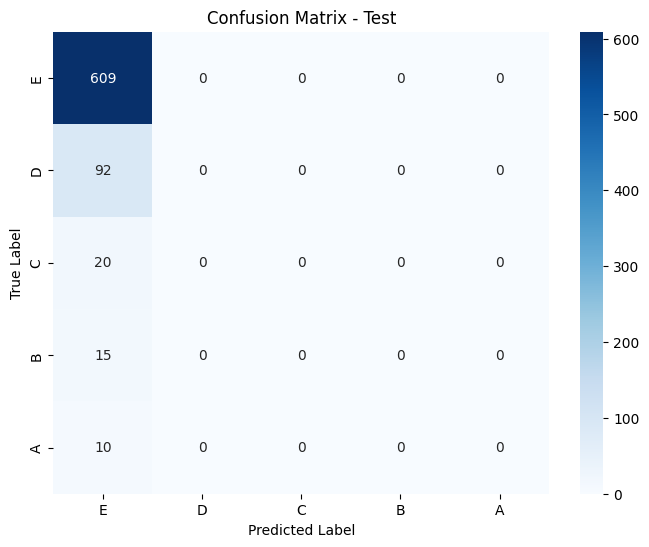

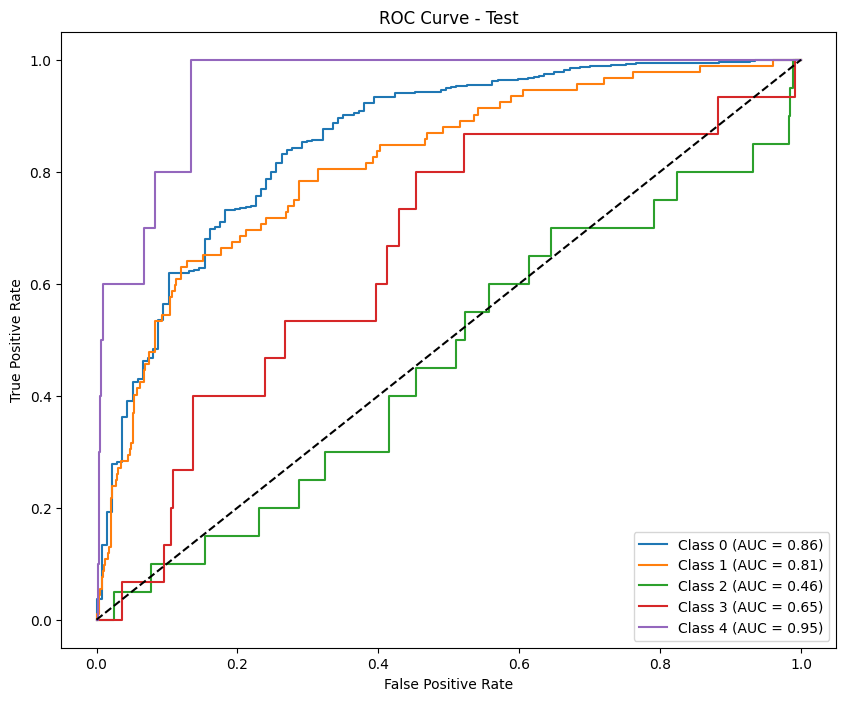


Permutation Importance for phase: phase2


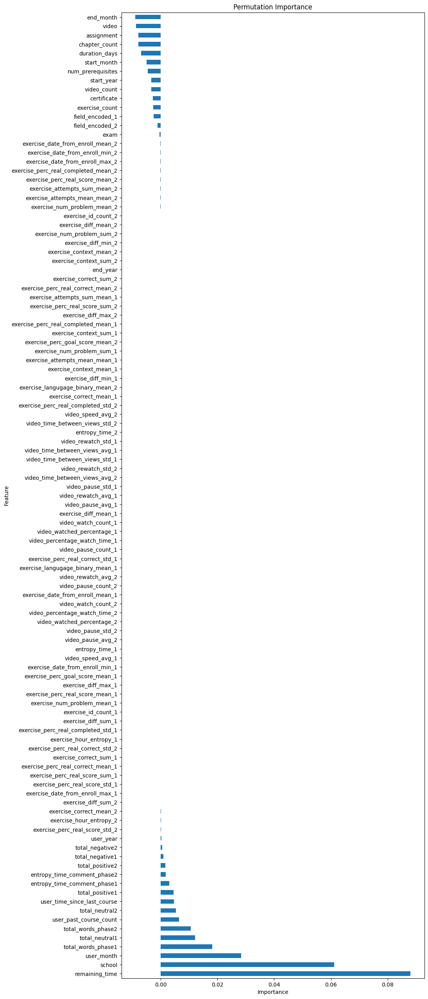

               Feature  Importance
20      remaining_time    0.088051
0               school    0.061213
8           user_month    0.028428
60  total_words_phase1    0.018110
63      total_neutral1    0.012138
..                 ...         ...
19       duration_days   -0.006955
11       chapter_count   -0.007878
16          assignment   -0.007938
17               video   -0.008630
6            end_month   -0.009007

[107 rows x 2 columns]

Lasso Feature Selection for phase: phase2


Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.427e+00, tolerance: 1.181e+00


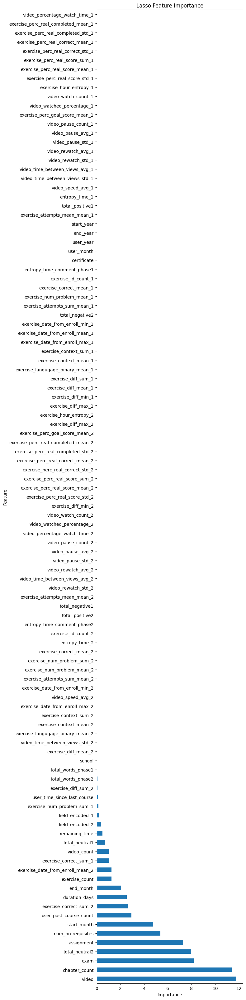

                                 Feature  Importance
17                                 video   11.758057
11                         chapter_count   11.403660
18                                  exam    8.196602
106                       total_neutral2    7.971058
16                            assignment    7.301690
..                                   ...         ...
43      exercise_perc_real_correct_std_1    0.000000
42     exercise_perc_real_correct_mean_1    0.000000
41    exercise_perc_real_completed_std_1    0.000000
40   exercise_perc_real_completed_mean_1    0.000000
50         video_percentage_watch_time_1    0.000000

[107 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                           Feature  Importance
107                 Random Feature    0.129473
20                  remaining_time    0.129289
17                           video    0.087554
16                      assignment    0.080303
0                           school    0.073

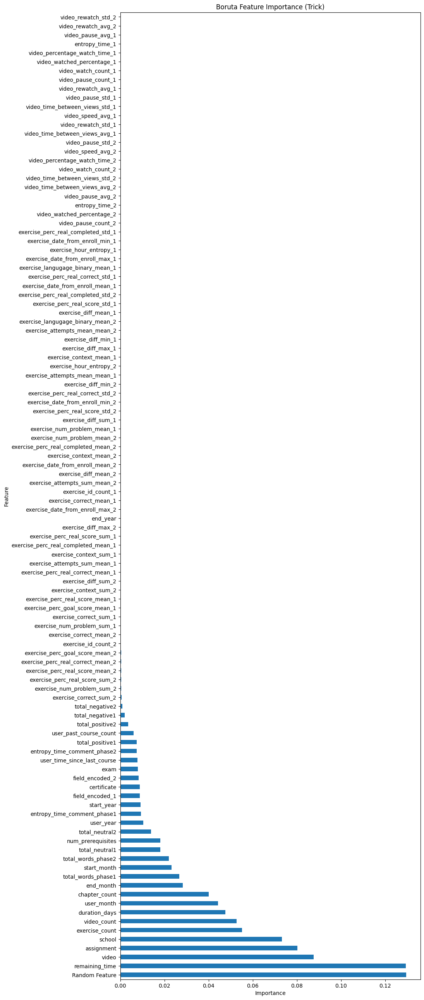

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None
Results saved as test_results_undersample_log_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.82723834 0.66473602 0.7118145  0.66049046 0.87431694]
Precision (per class): [0.89617486 0.66935846 0.63451444 0.53723404 0.85714286]
Recall (per class): [0.76814988 0.66017699 0.81056161 0.85714286 0.89219331]
Accuracy: 0.7580
AUC (One-vs-Rest): 0.9433

Classification Report:
              precision    recall  f1-score   support

           E       0.90      0.77      0.83      5124
           D       0.67      0.66      0.66      2260
           C       0.63      0.81      0.71      1193
           B       0.54      0.86      0.66       707
           A       0.86      0.89      0.87       269

    accuracy                           0.76      9553
   macro avg

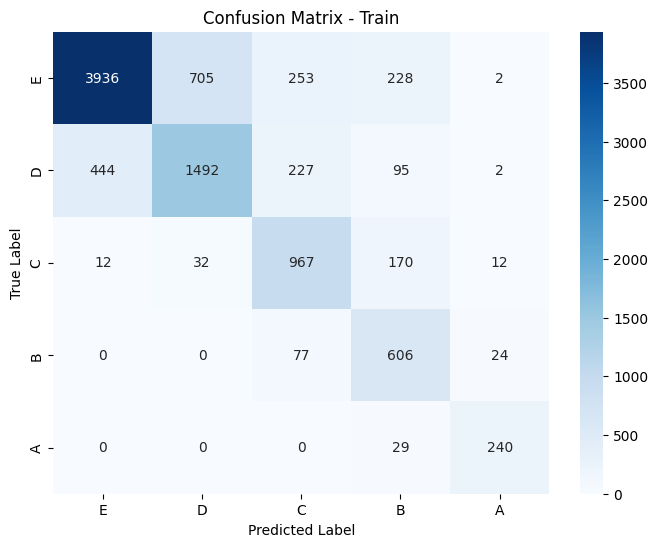

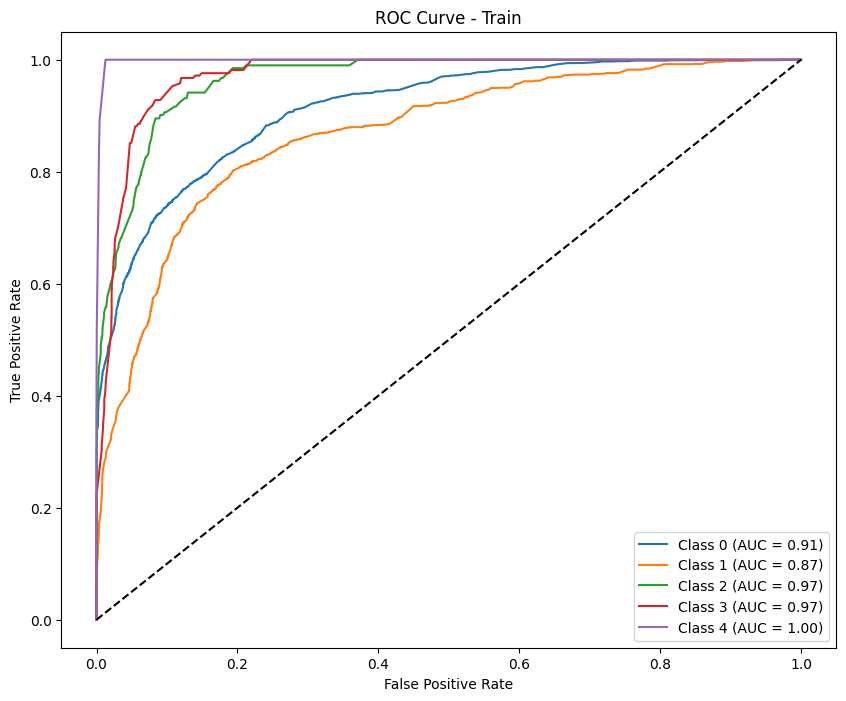


--- Test Metrics ---
F1 Score (per class): [0.89824024 0.         0.         0.         0.        ]
Precision (per class): [0.81641168 0.         0.         0.         0.        ]
Recall (per class): [0.99829932 0.         0.         0.         0.        ]
Accuracy: 0.8141
AUC (One-vs-Rest): 0.6139

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       588
           D       0.00      0.00      0.00        87
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.81       721
   macro avg       0.16      0.20      0.18       721
weighted avg       0.67      0.81      0.73       721



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


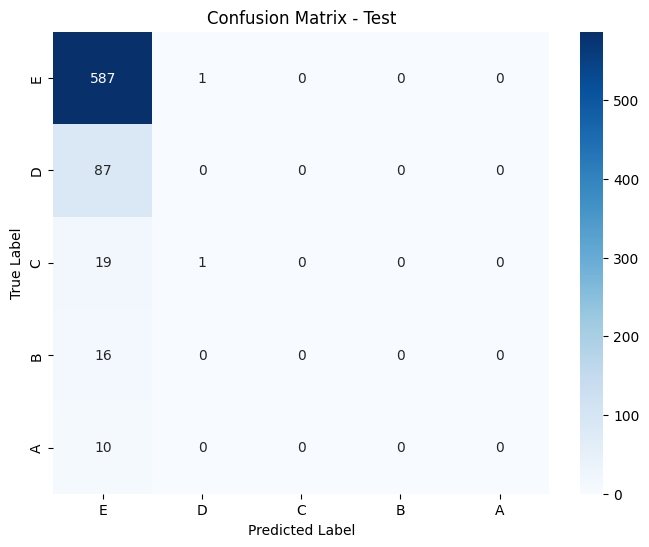

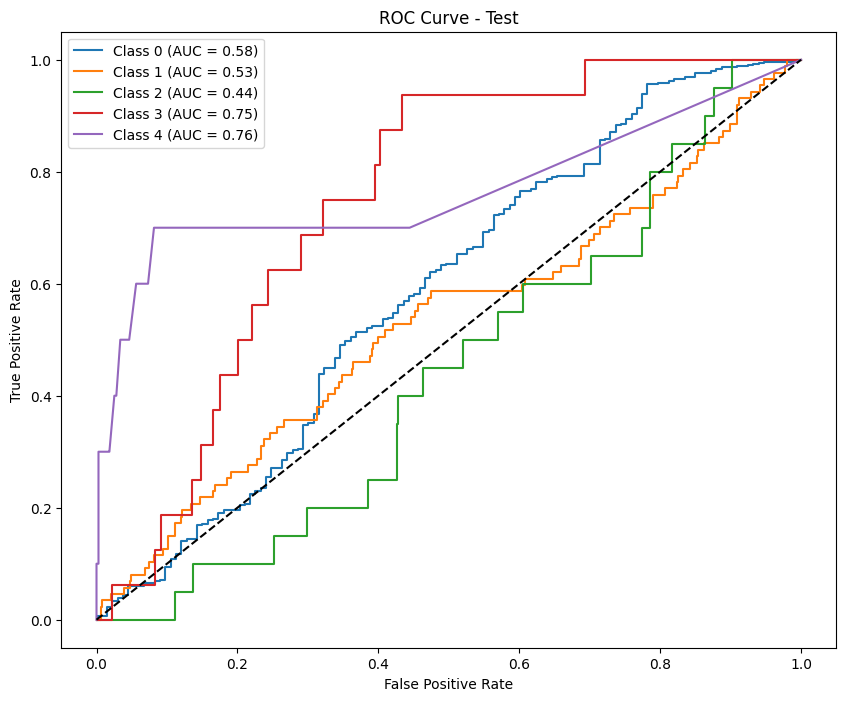

Results saved as test_results_calibrate_undersample_log_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.84587883 0.62937063 0.72059398 0.70395137 0.87431694]
Precision (per class): [0.83770335 0.72247706 0.6749634  0.61727079 0.85714286]
Recall (per class): [0.85421546 0.55752212 0.77284158 0.81895332 0.89219331]
Accuracy: 0.7723
AUC (One-vs-Rest): 0.9476

Classification Report:
              precision    recall  f1-score   support

           E       0.84      0.85      0.85      5124
           D       0.72      0.56      0.63      2260
           C       0.67      0.77      0.72      1193
           B       0.62      0.82      0.70       707
           A       0.86      0.89      0.87       269

    accuracy                           0.77      9553
   macro avg       0.74      0.78      0.75      9553
weighted avg       0.77      0.77      0.77      9553



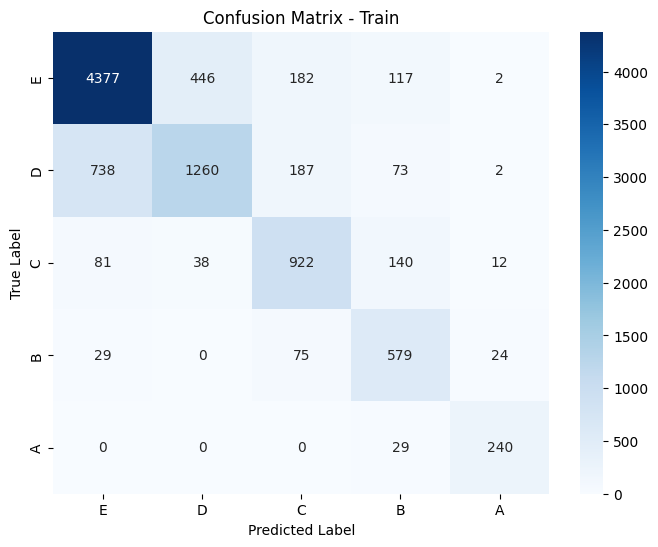

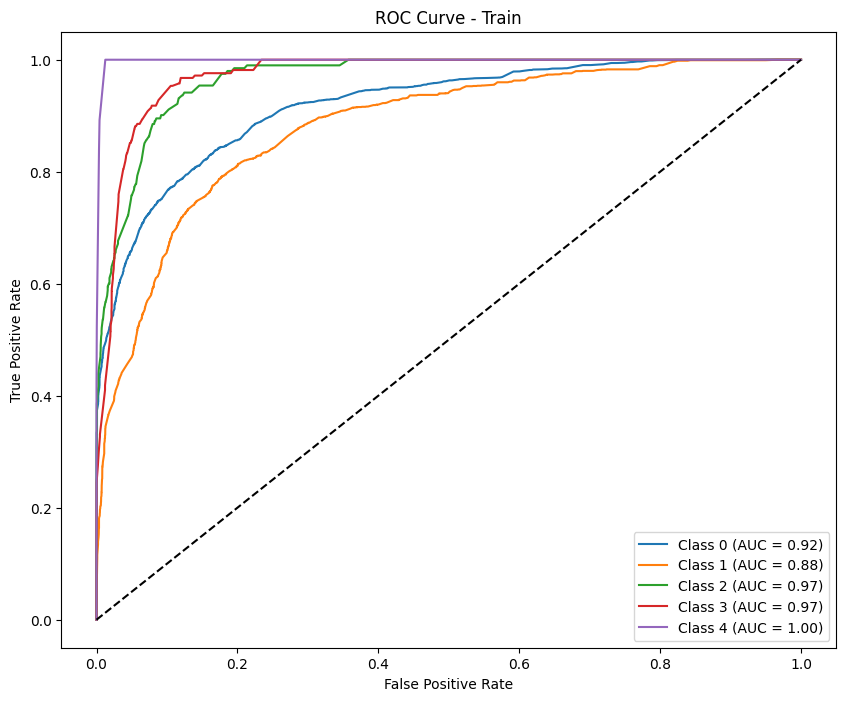


--- Test Metrics ---
F1 Score (per class): [0.89824024 0.         0.         0.         0.        ]
Precision (per class): [0.81641168 0.         0.         0.         0.        ]
Recall (per class): [0.99829932 0.         0.         0.         0.        ]
Accuracy: 0.8141
AUC (One-vs-Rest): 0.6379

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       588
           D       0.00      0.00      0.00        87
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.81       721
   macro avg       0.16      0.20      0.18       721
weighted avg       0.67      0.81      0.73       721



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


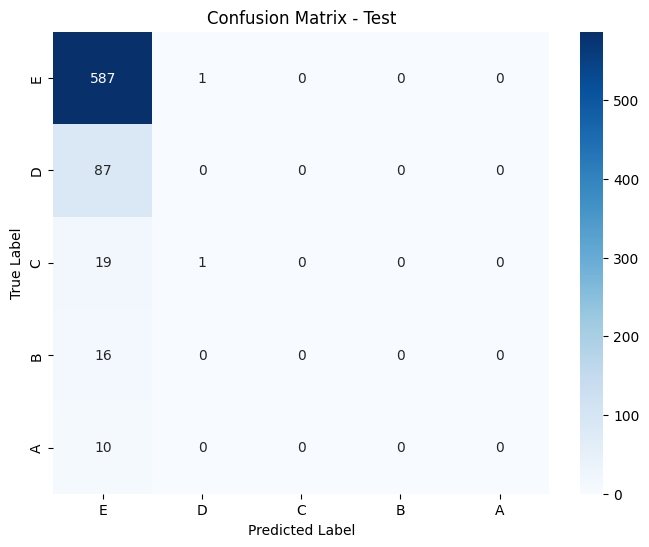

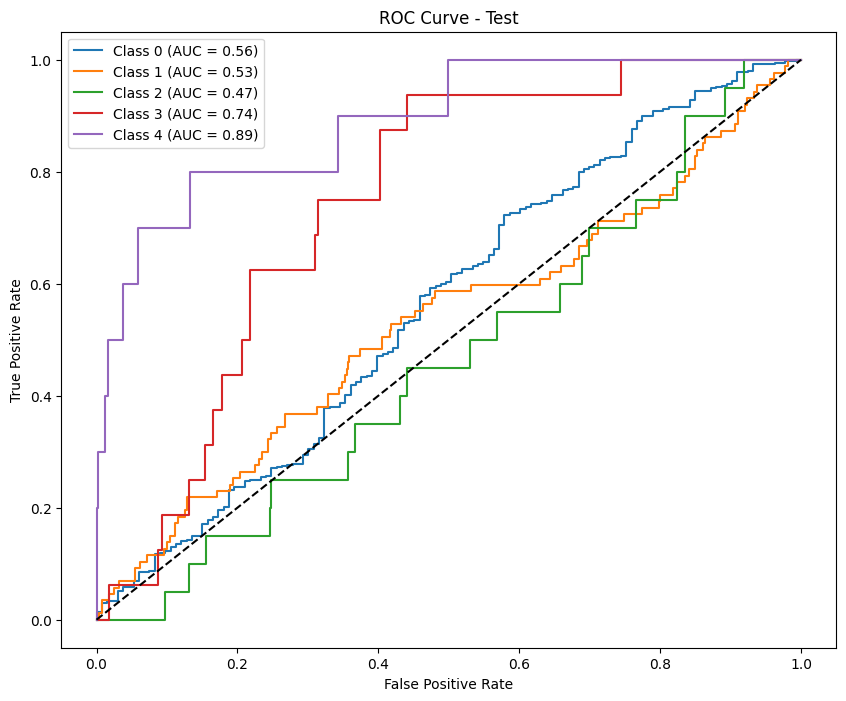

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None
Results saved as test_results_undersample_log_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.82389353 0.69441755 0.75652513 0.75082617 0.9025641 ]
Precision (per class): [0.90084602 0.70929466 0.66234652 0.66510539 0.82242991]
Recall (per class): [0.75905332 0.68015171 0.88192552 0.86191199 1.        ]
Accuracy: 0.7790
AUC (One-vs-Rest): 0.9525

Classification Report:
              precision    recall  f1-score   support

           E       0.90      0.76      0.82      3507
           D       0.71      0.68      0.69      1582
           C       0.66      0.88      0.76      1101
           B       0.67      0.86      0.75       659
           A       0.82      1.00      0.90       264

    accuracy                           0.78      7113
   macro avg

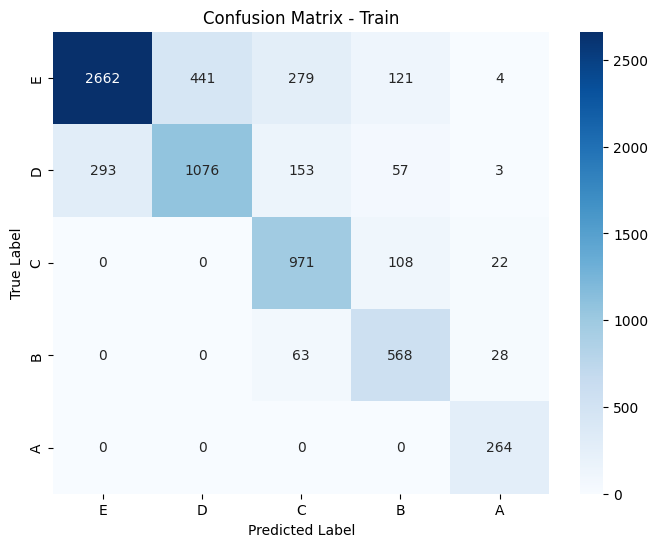

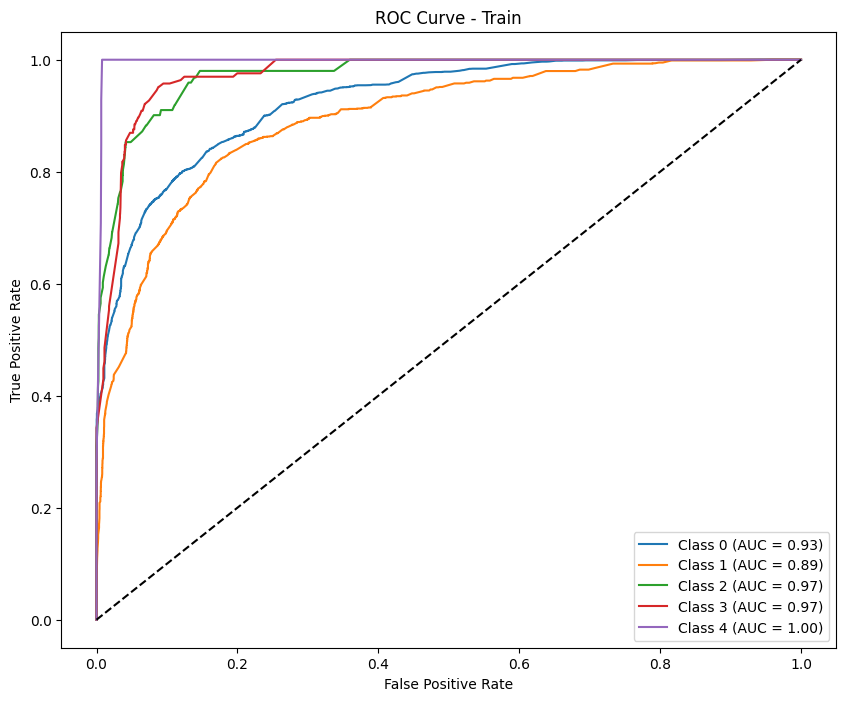


--- Test Metrics ---
F1 Score (per class): [0.88545898 0.02083333 0.         0.         0.        ]
Precision (per class): [0.80621302 0.09090909 0.         0.         0.        ]
Recall (per class): [0.98198198 0.01176471 0.         0.         0.        ]
Accuracy: 0.7948
AUC (One-vs-Rest): 0.5555

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.98      0.89       555
           D       0.09      0.01      0.02        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.79       687
   macro avg       0.18      0.20      0.18       687
weighted avg       0.66      0.79      0.72       687



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


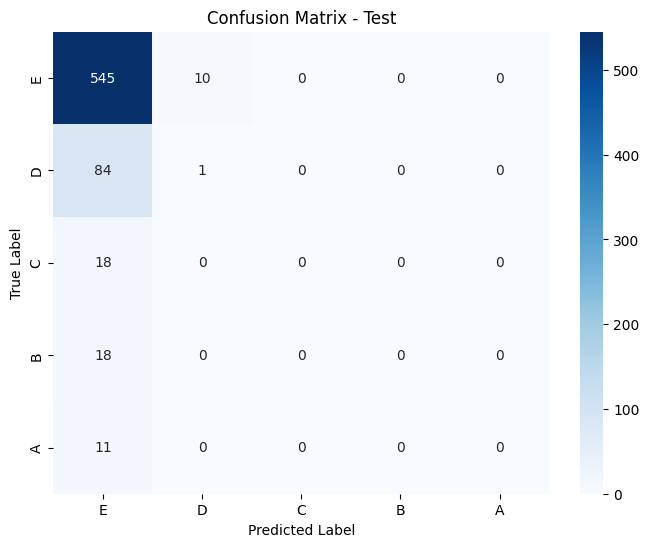

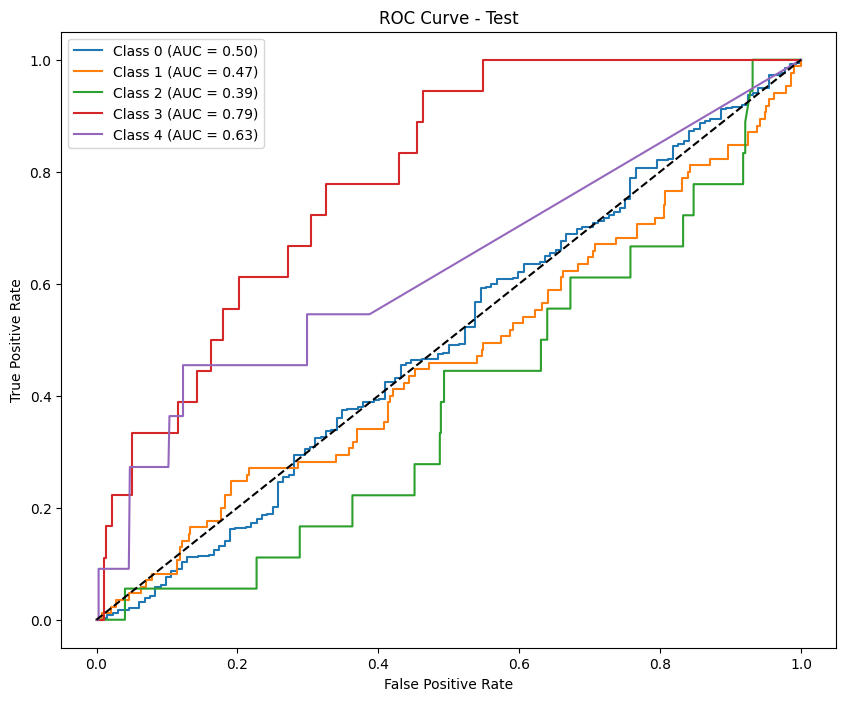

Results saved as test_results_calibrate_undersample_log_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.84542765 0.65395683 0.80913399 0.75656985 0.90721649]
Precision (per class): [0.8356546  0.75876461 0.76967213 0.69504447 0.83018868]
Recall (per class): [0.85543199 0.57458913 0.85286104 0.83004552 1.        ]
Accuracy: 0.7956
AUC (One-vs-Rest): 0.9555

Classification Report:
              precision    recall  f1-score   support

           E       0.84      0.86      0.85      3507
           D       0.76      0.57      0.65      1582
           C       0.77      0.85      0.81      1101
           B       0.70      0.83      0.76       659
           A       0.83      1.00      0.91       264

    accuracy                           0.80      7113
   macro avg       0.78      0.82      0.79      7113
weighted avg       0.80      0.80      0.79      7113



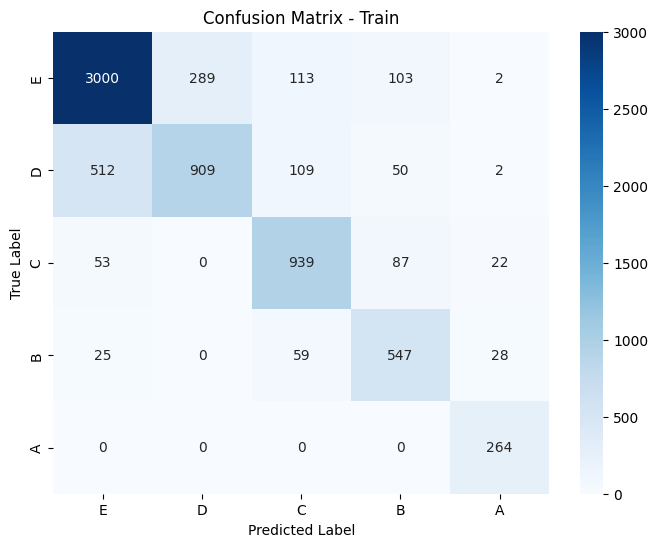

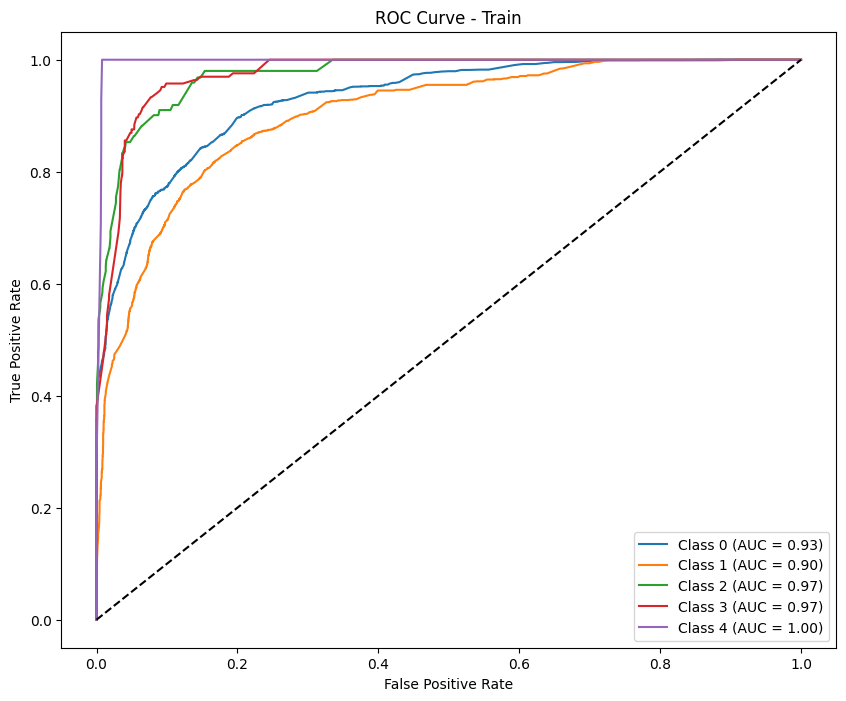


--- Test Metrics ---
F1 Score (per class): [0.89282836 0.         0.         0.         0.        ]
Precision (per class): [0.80758017 0.         0.         0.         0.        ]
Recall (per class): [0.9981982 0.        0.        0.        0.       ]
Accuracy: 0.8064
AUC (One-vs-Rest): 0.6039

Classification Report:
              precision    recall  f1-score   support

           E       0.81      1.00      0.89       555
           D       0.00      0.00      0.00        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.81       687
   macro avg       0.16      0.20      0.18       687
weighted avg       0.65      0.81      0.72       687



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


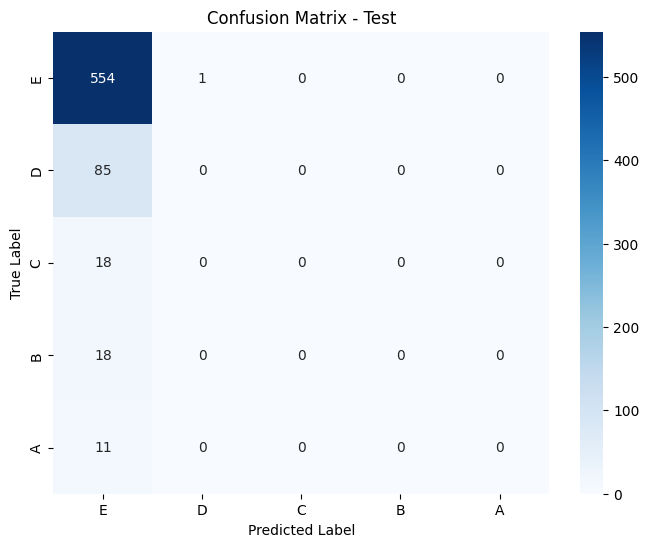

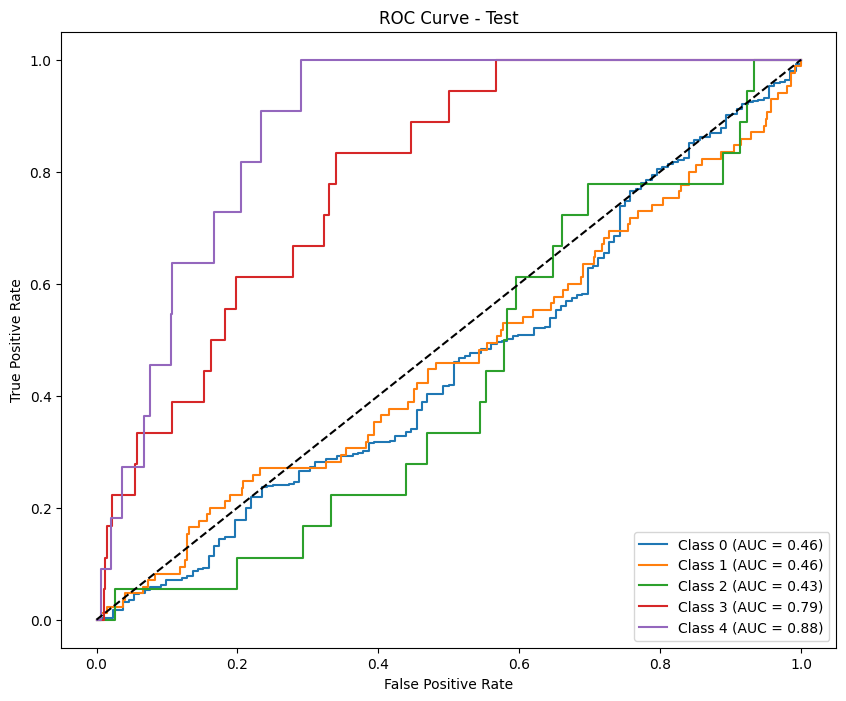

In [34]:
hyperparams = {
    "phase1": hp_1,
    "phase2": hp_2,
    "phase3": hp_3,
    "phase4": hp_4
}

for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_oversample_phase(phase, metric='f1_macro', scale='log', hyper=hyperparams[phase]) 

# 4. Scale dữ liệu theo MinMax

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

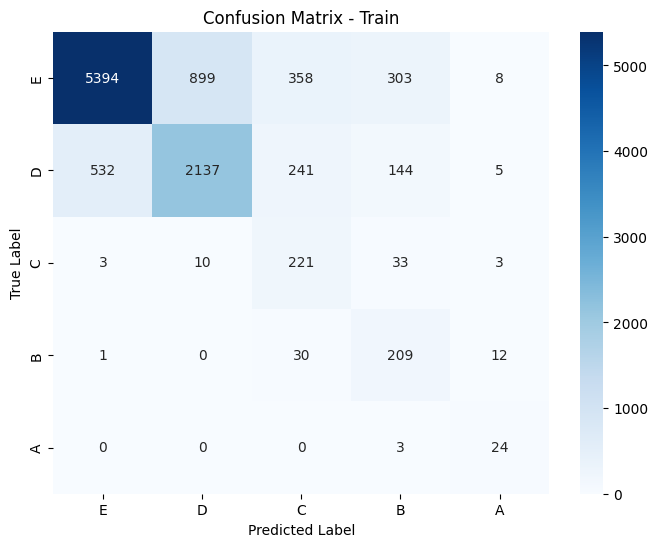

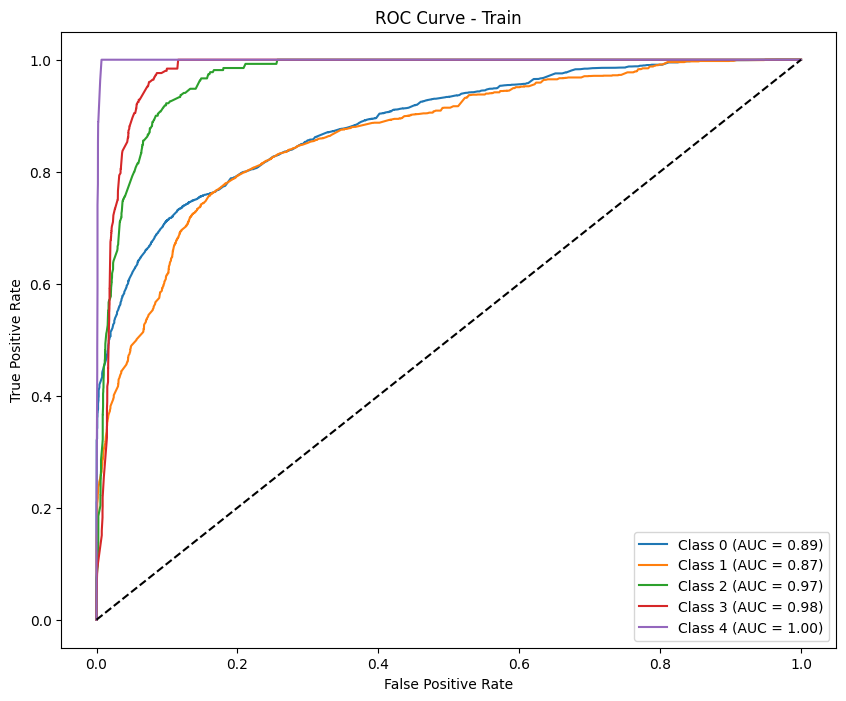


--- Test Metrics ---
F1 Score (per class): [0.92261458 0.37037037 0.         0.         0.        ]
Precision (per class): [0.85874126 0.6097561  0.         0.         0.        ]
Recall (per class): [0.99675325 0.26595745 0.         0.         0.        ]
Accuracy: 0.8452
AUC (One-vs-Rest): 0.8375

Classification Report:
              precision    recall  f1-score   support

           E       0.86      1.00      0.92       616
           D       0.61      0.27      0.37        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.85       756
   macro avg       0.29      0.25      0.26       756
weighted avg       0.78      0.85      0.80       756



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


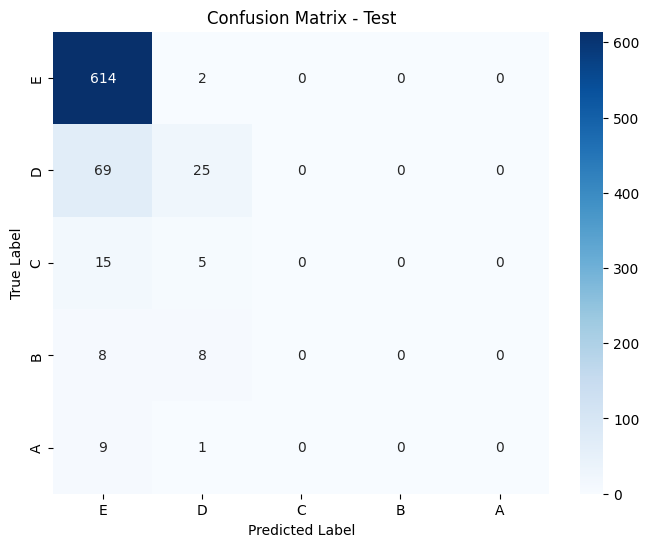

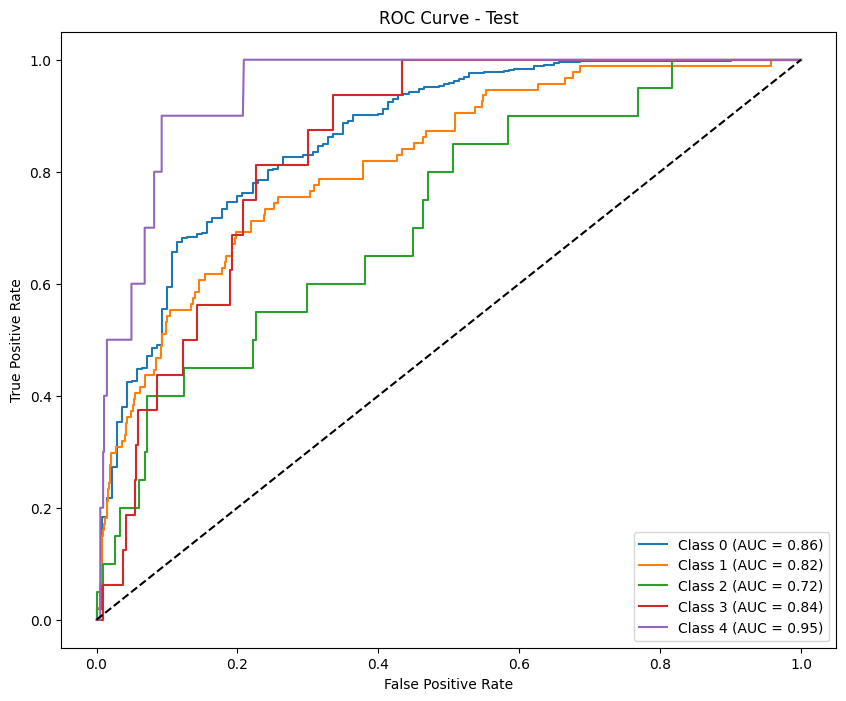

Results saved as test_results_calibrate_minmax_f1_macro_phase1.csv
-------------Results for calibrate phase: phase1---------------

--- Train Metrics ---
F1 Score (per class): [0.86449587 0.65965985 0.4966443  0.51827243 0.6       ]
Precision (per class): [0.82372837 0.79392824 0.45398773 0.44571429 0.54545455]
Recall (per class): [0.90950876 0.56423668 0.54814815 0.61904762 0.66666667]
Accuracy: 0.7928
AUC (One-vs-Rest): 0.9470

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.91      0.86      6962
           D       0.79      0.56      0.66      3059
           C       0.45      0.55      0.50       270
           B       0.45      0.62      0.52       252
           A       0.55      0.67      0.60        27

    accuracy                           0.79     10570
   macro avg       0.61      0.66      0.63     10570
weighted avg       0.80      0.79      0.79     10570



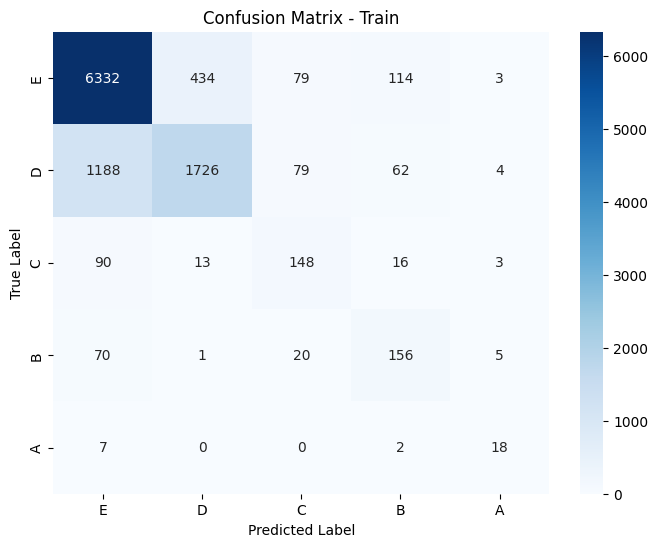

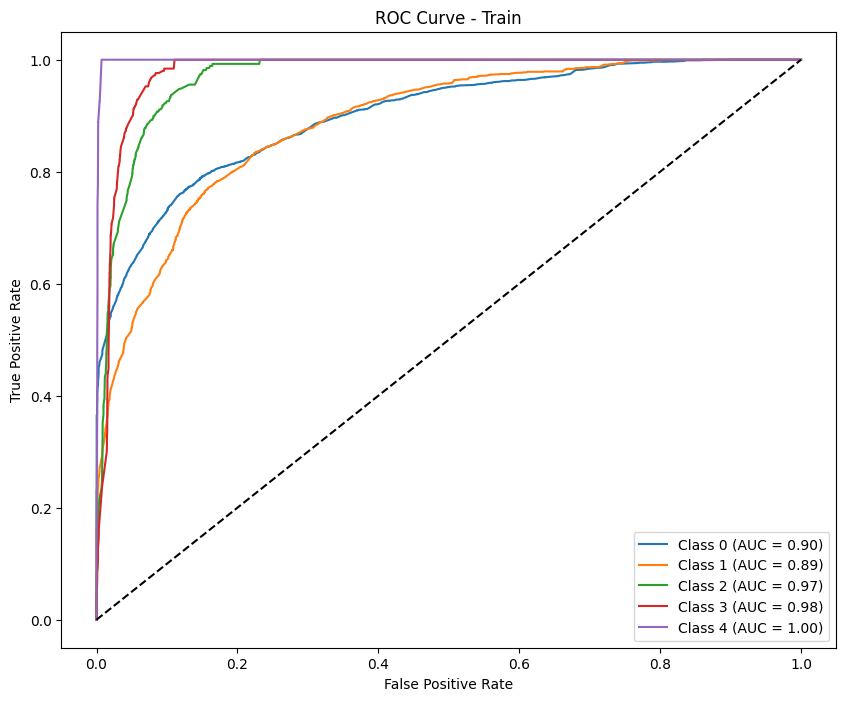


--- Test Metrics ---
F1 Score (per class): [0.90707965 0.18181818 0.         0.         0.        ]
Precision (per class): [0.83108108 0.625      0.         0.         0.        ]
Recall (per class): [0.99837662 0.10638298 0.         0.         0.        ]
Accuracy: 0.8267
AUC (One-vs-Rest): 0.8320

Classification Report:
              precision    recall  f1-score   support

           E       0.83      1.00      0.91       616
           D       0.62      0.11      0.18        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.83       756
   macro avg       0.29      0.22      0.22       756
weighted avg       0.75      0.83      0.76       756



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


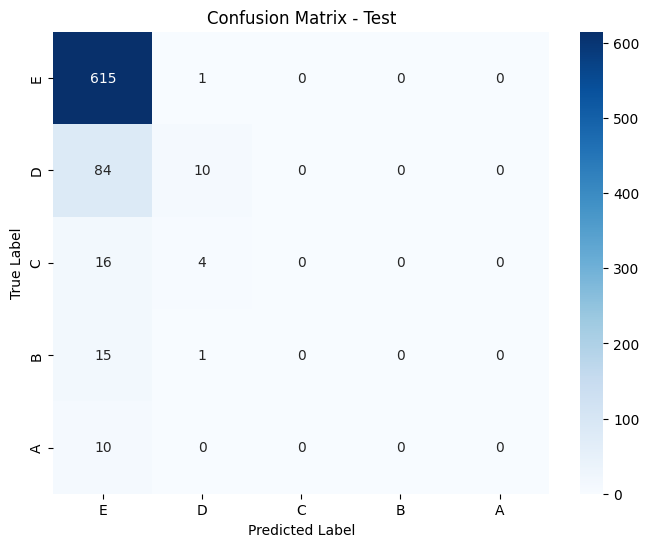

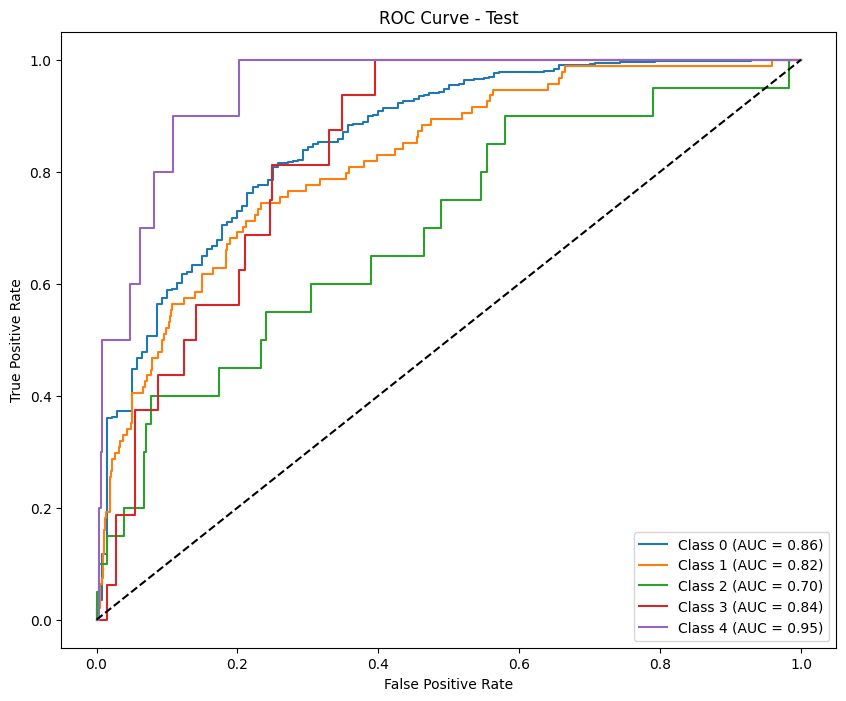


-------------Permutation Importance for phase: phase1---------


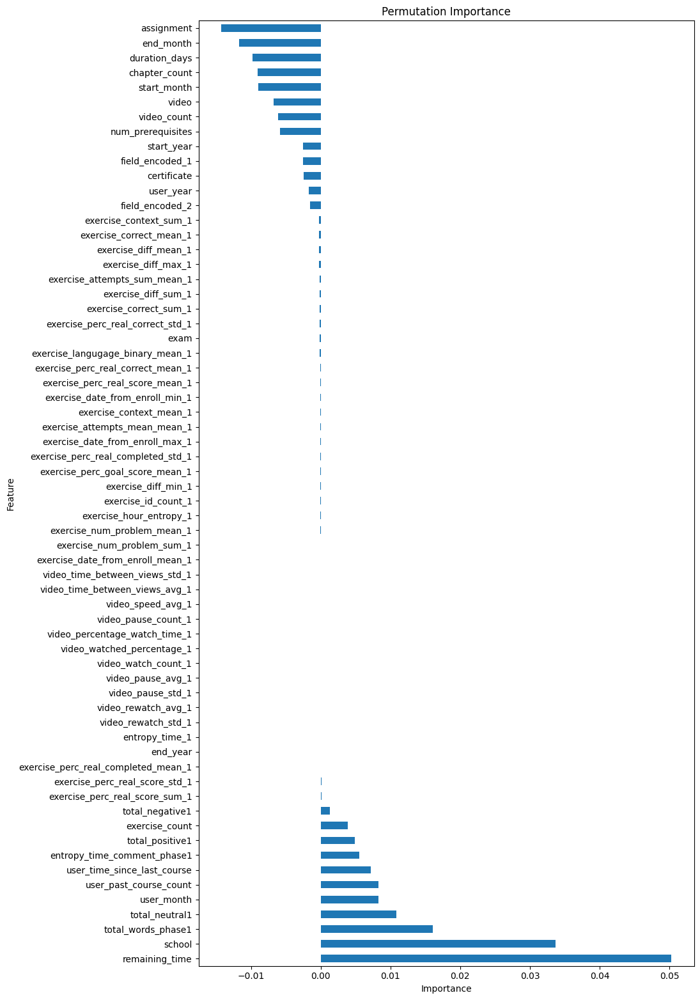

               Feature  Importance
20      remaining_time    0.050272
0               school    0.033704
60  total_words_phase1    0.016071
63      total_neutral1    0.010856
8           user_month    0.008266
..                 ...         ...
4          start_month   -0.008929
11       chapter_count   -0.009011
19       duration_days   -0.009756
6            end_month   -0.011696
16          assignment   -0.014286

[64 rows x 2 columns]

-----------SHAP Feature Importance for phase: phase1------------


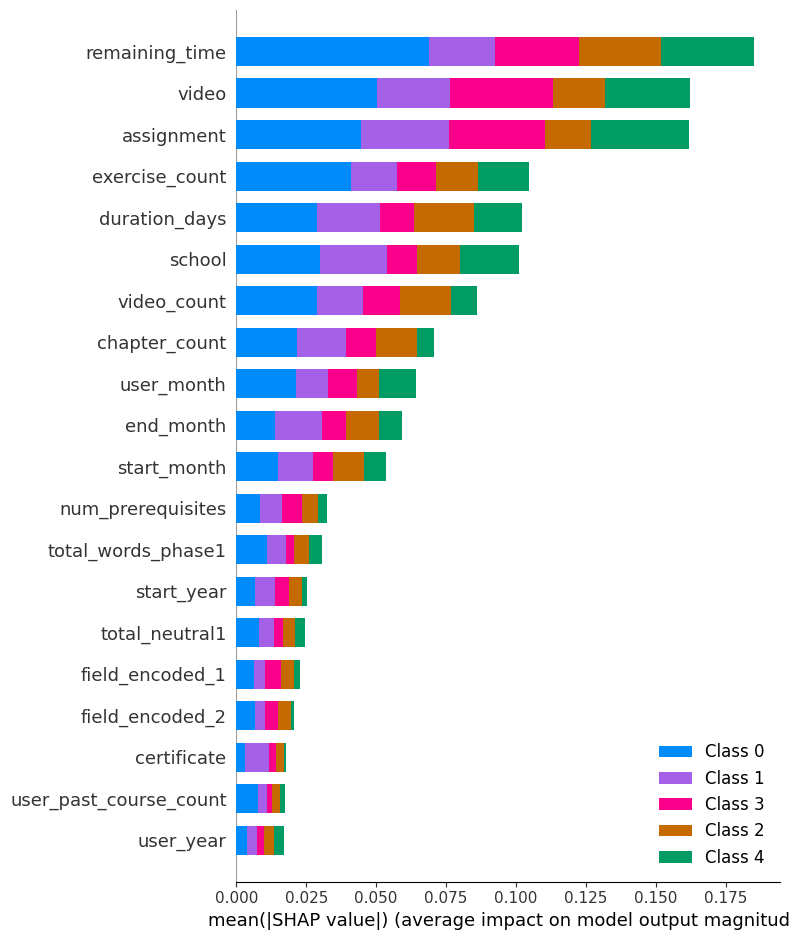


-----Lasso Feature Selection for phase: phase1----------


Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.5852856548608543, tolerance: 0.38841890964995307
Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.6451384620090721, tolerance: 0.38841890964995307
Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.332935938994524, tolerance: 0.38841890964995307
Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.684122638127519, tolerance: 0.38841890964995307
Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.032467140137669, tolerance: 0.38841890964995307
Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.075452616920302, tolerance: 0.38841890964995307
Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.32707522614419, tolerance: 0.388418

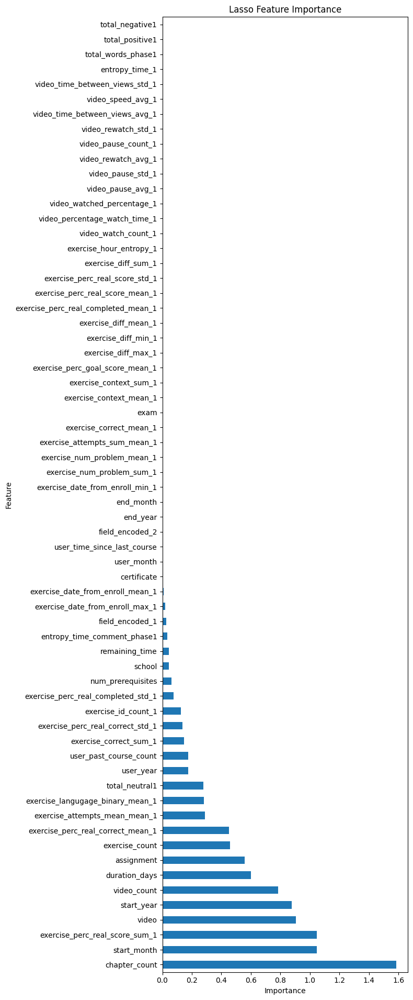

                           Feature  Importance
11                   chapter_count    1.583599
4                      start_month    1.047039
44  exercise_perc_real_score_sum_1    1.045067
17                           video    0.904924
3                       start_year    0.876312
..                             ...         ...
57  video_time_between_views_std_1    0.000000
59                  entropy_time_1    0.000000
60              total_words_phase1    0.000000
61                 total_positive1    0.000000
62                 total_negative1    0.000000

[64 rows x 2 columns]

----------Boruta Trick: phase1----------
Feature Importance (Including Random Feature):
                           Feature  Importance
64                  Random Feature    0.226041
20                  remaining_time    0.128087
17                           video    0.086187
16                      assignment    0.077486
0                           school    0.059411
..                             ...        

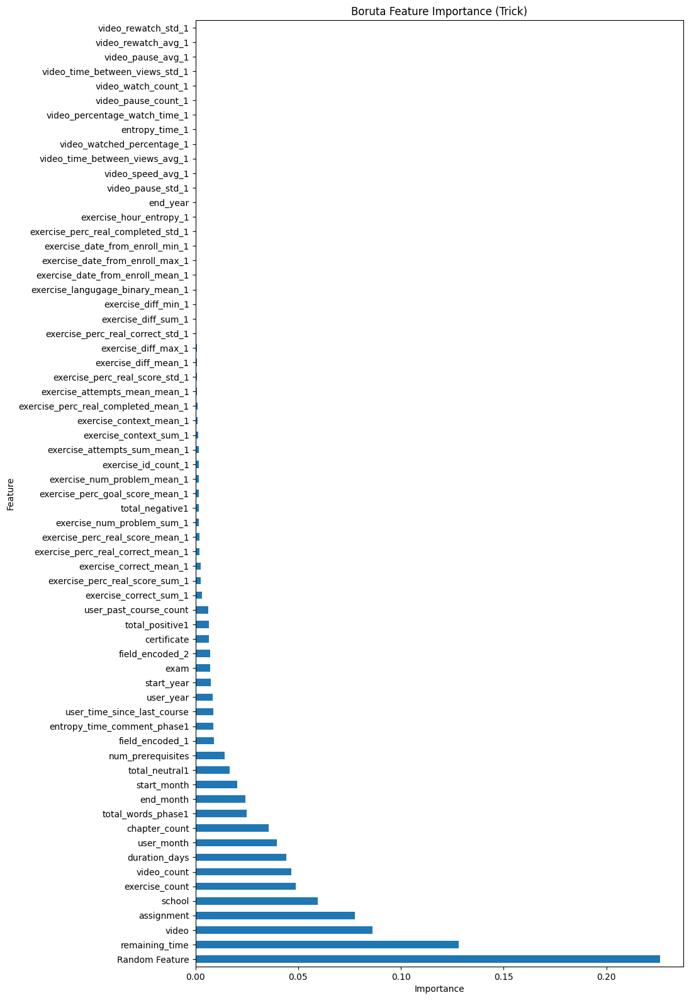

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None
Results saved as test_results_minmax_f1_macro_phase2.csv
----------Results for phase: phase2--------------

--- Train Metrics ---
F1 Score (per class): [0.82264297 0.66571312 0.38802661 0.45278726 0.66666667]
Precision (per class): [0.89983094 0.66462668 0.26041667 0.30662558 0.52272727]
Recall (per class): [0.75765125 0.66680311 0.76086957 0.86521739 0.92      ]
Accuracy: 0.7351
AUC (One-vs-Rest): 0.9270

Classification Report:
              precision    recall  f1-score   support

           E       0.90      0.76      0.82      5620
           D       0.66      0.67      0.67      2443
           C       0.26      0.76      0.39       230
           B       0.31      0.87      0.45       230
           A       0.52      0.92      0.67        25

    accuracy                           0.74      85

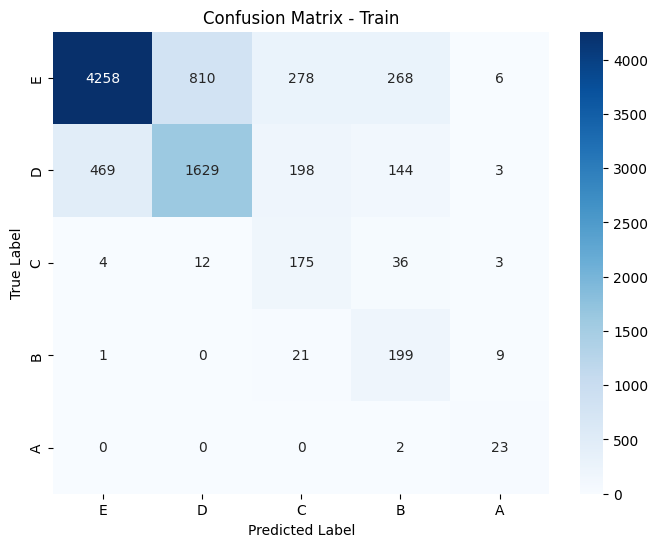

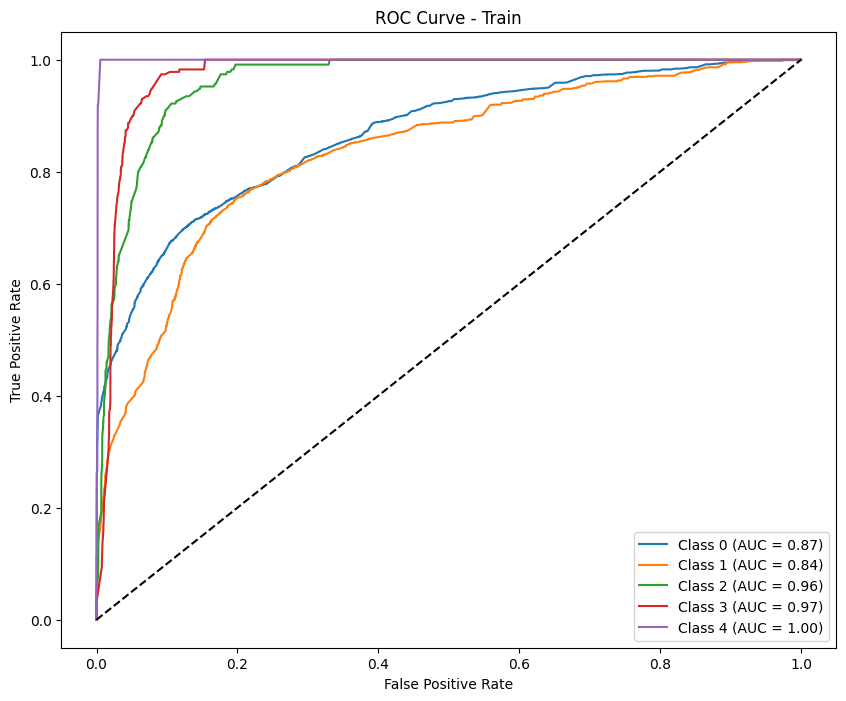


--- Test Metrics ---
F1 Score (per class): [0.90356083 0.08080808 0.         0.         0.        ]
Precision (per class): [0.8240866  0.57142857 0.         0.         0.        ]
Recall (per class): [1.         0.04347826 0.         0.         0.        ]
Accuracy: 0.8217
AUC (One-vs-Rest): 0.7425

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       609
           D       0.57      0.04      0.08        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.82       746
   macro avg       0.28      0.21      0.20       746
weighted avg       0.74      0.82      0.75       746



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


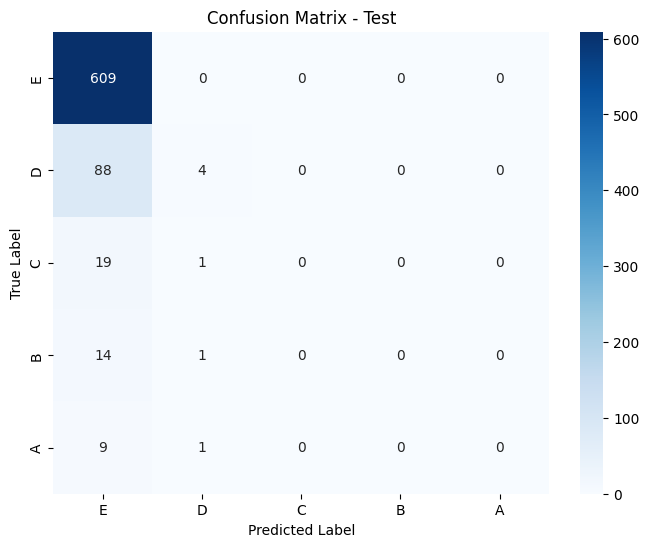

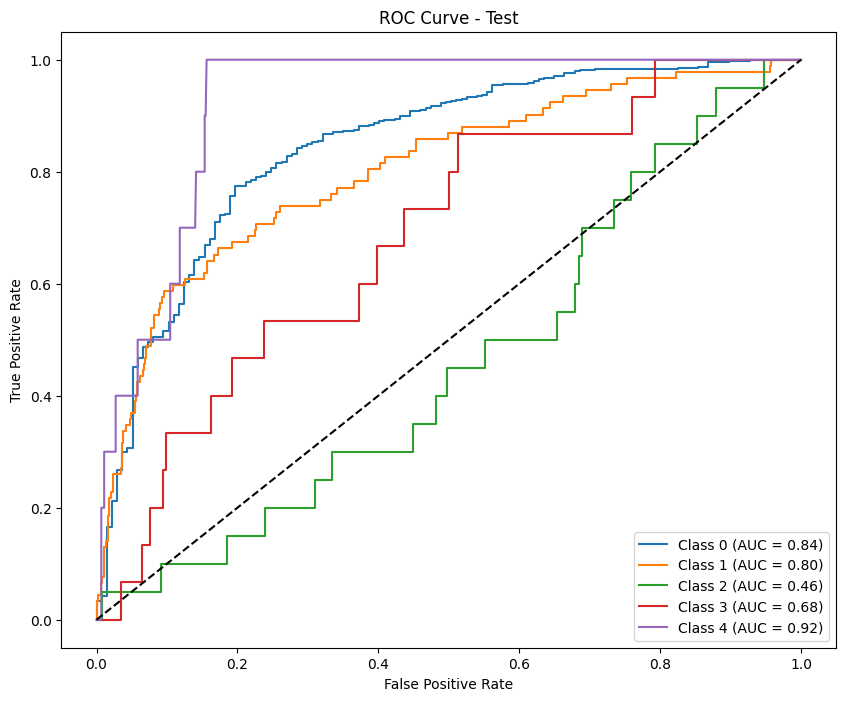

Results saved as test_results_calibrate_minmax_f1_macro_phase2.csv
-------------Results for calibrate phase: phase2---------------

--- Train Metrics ---
F1 Score (per class): [0.84363822 0.61985019 0.46186441 0.49640288 0.59259259]
Precision (per class): [0.80904933 0.72389284 0.45041322 0.42331288 0.55172414]
Recall (per class): [0.88131673 0.54195661 0.47391304 0.6        0.64      ]
Accuracy: 0.7651
AUC (One-vs-Rest): 0.9369

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.88      0.84      5620
           D       0.72      0.54      0.62      2443
           C       0.45      0.47      0.46       230
           B       0.42      0.60      0.50       230
           A       0.55      0.64      0.59        25

    accuracy                           0.77      8548
   macro avg       0.59      0.63      0.60      8548
weighted avg       0.76      0.77      0.76      8548



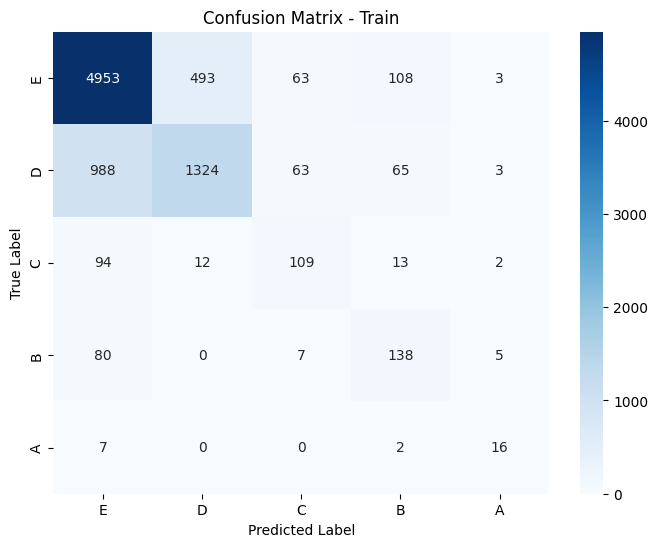

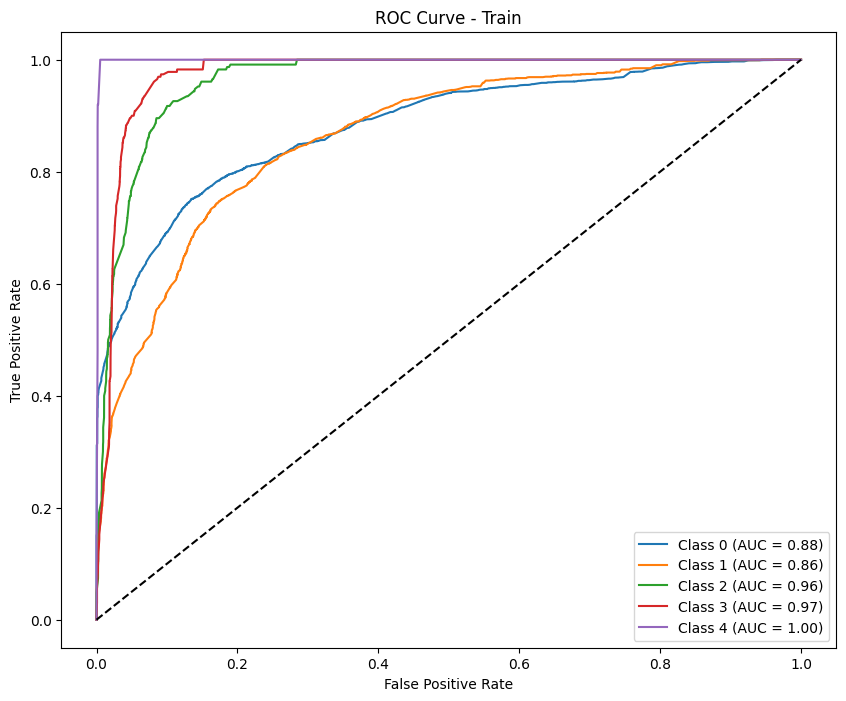

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.89889299 0.         0.         0.         0.        ]
Precision (per class): [0.81635389 0.         0.         0.         0.        ]
Recall (per class): [1. 0. 0. 0. 0.]
Accuracy: 0.8164
AUC (One-vs-Rest): 0.7350

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       609
           D       0.00      0.00      0.00        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.82       746
   macro avg       0.16      0.20      0.18       746
weighted avg       0.67      0.82      0.73       746



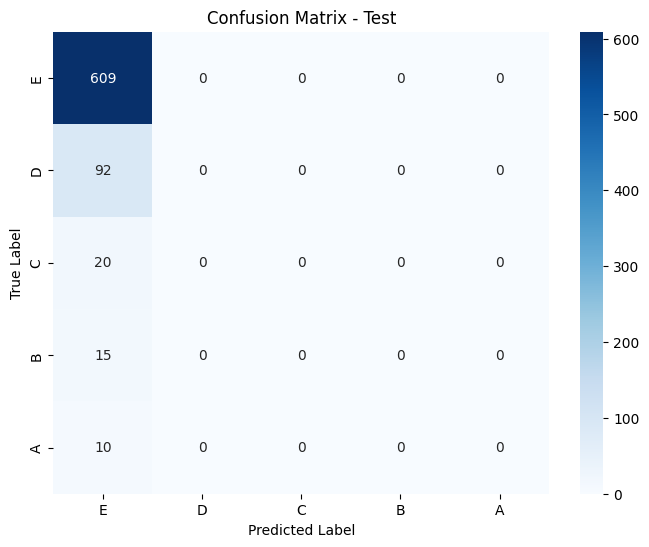

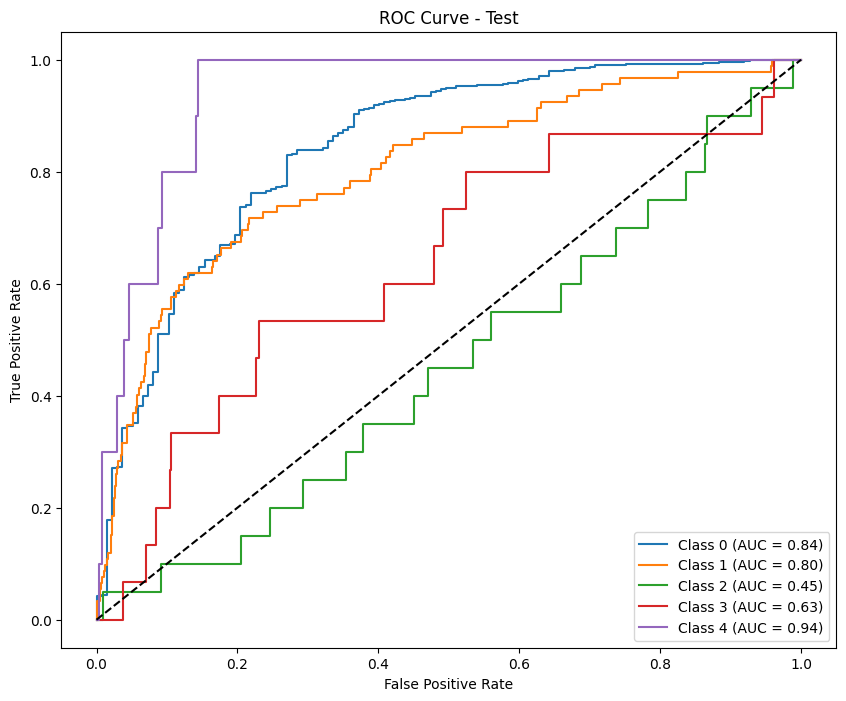


-------------Permutation Importance for phase: phase2---------


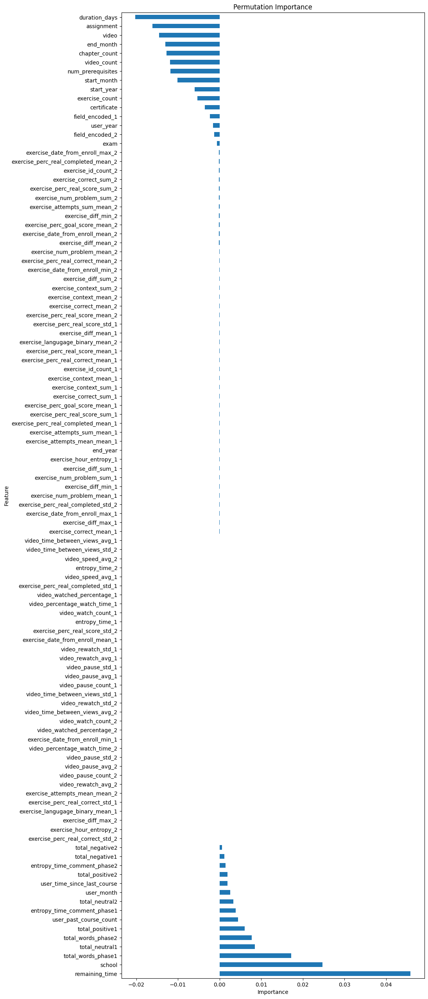

                Feature  Importance
20       remaining_time    0.045888
0                school    0.024728
60   total_words_phase1    0.017182
63       total_neutral1    0.008467
103  total_words_phase2    0.007692
..                  ...         ...
11        chapter_count   -0.012722
6             end_month   -0.012985
17                video   -0.014506
16           assignment   -0.016159
19        duration_days   -0.020268

[107 rows x 2 columns]

-----------SHAP Feature Importance for phase: phase2------------


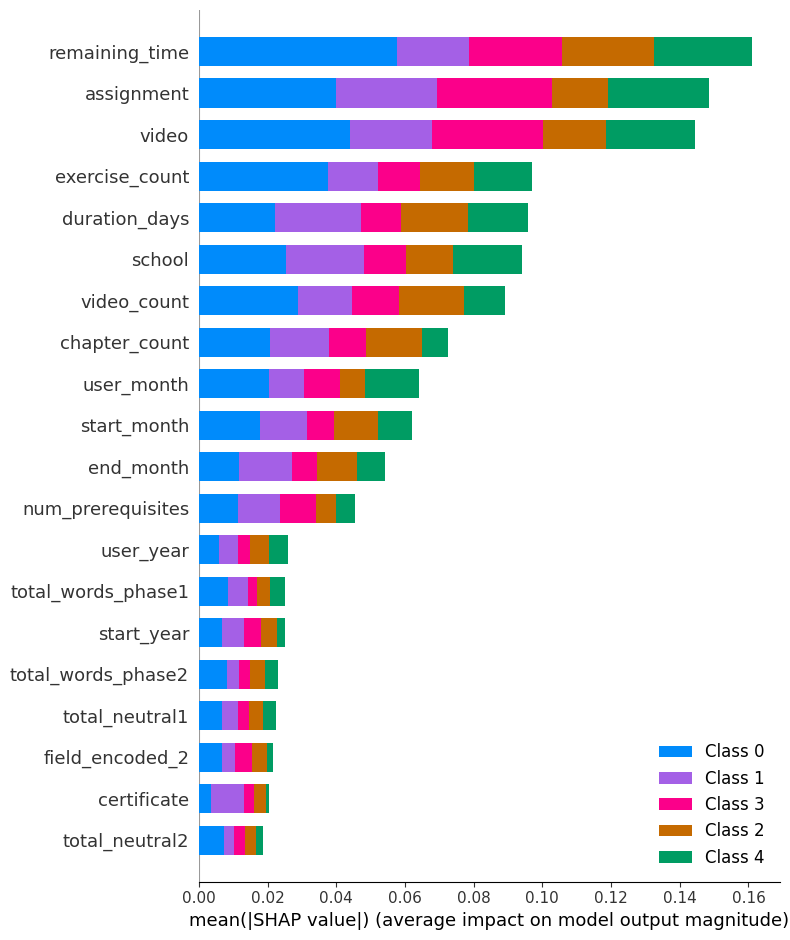


-----Lasso Feature Selection for phase: phase2----------


Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.7222294889056684, tolerance: 0.3280285609827438
Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8062741047497184, tolerance: 0.3280285609827438
Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8335539127706397, tolerance: 0.3280285609827438
Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8536040470271473, tolerance: 0.3280285609827438
Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8470164721165929, tolerance: 0.3280285609827438
Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.39004807912988326, tolerance: 0.3280285609827438
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.753790360217863, tolerance: 0.328028560

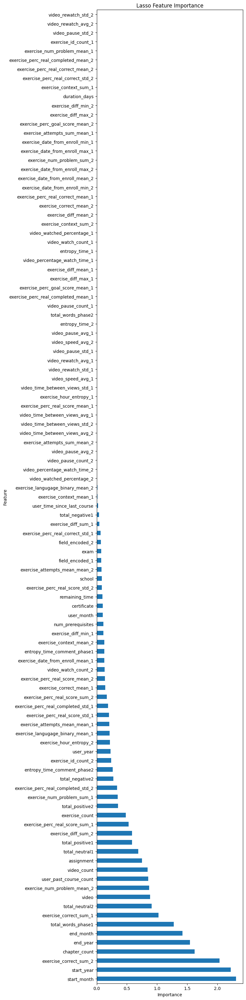

                        Feature  Importance
4                   start_month    2.305842
3                    start_year    2.217744
66       exercise_correct_sum_2    2.034287
11                chapter_count    1.623914
5                      end_year    1.542653
..                          ...         ...
26  exercise_num_problem_mean_1    0.000000
22          exercise_id_count_1    0.000000
96            video_pause_std_2    0.000000
97          video_rewatch_avg_2    0.000000
98          video_rewatch_std_2    0.000000

[107 rows x 2 columns]

----------Boruta Trick: phase2----------
Feature Importance (Including Random Feature):
                 Feature  Importance
107       Random Feature    0.189627
20        remaining_time    0.122655
16            assignment    0.081903
17                 video    0.079705
0                 school    0.063449
..                   ...         ...
54   video_rewatch_avg_1    0.000000
52     video_pause_avg_1    0.000000
48   video_watch_count_1  

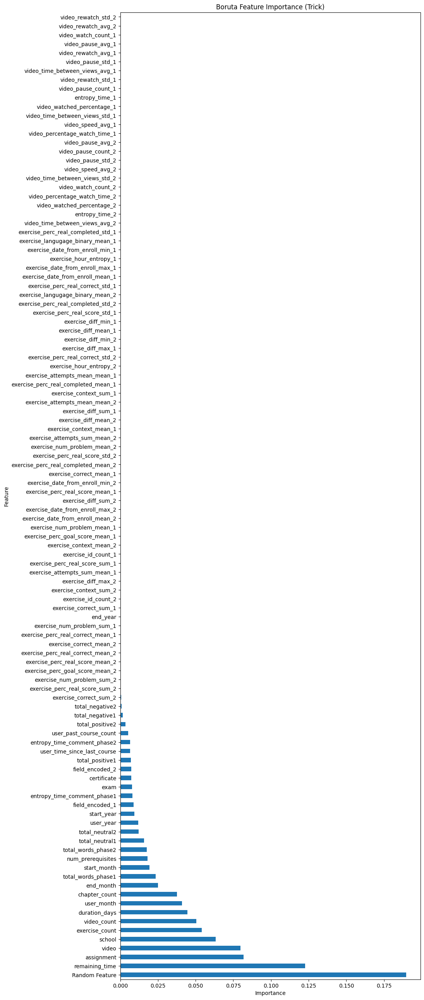

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None
Results saved as test_results_minmax_f1_macro_phase3.csv
----------Results for phase: phase3--------------

--- Train Metrics ---
F1 Score (per class): [0.8257209  0.66963689 0.37516171 0.45547074 0.60714286]
Precision (per class): [0.89607127 0.67429341 0.25       0.30915371 0.45945946]
Recall (per class): [0.7656128  0.66504425 0.75129534 0.8647343  0.89473684]
Accuracy: 0.7391
AUC (One-vs-Rest): 0.9280

Classification Report:
              precision    recall  f1-score   support

           E       0.90      0.77      0.83      5124
           D       0.67      0.67      0.67      2260
           C       0.25      0.75      0.38       193
           B       0.31      0.86      0.46       207
           A       0.46      0.89      0.61        19

    accuracy                           0.74      78

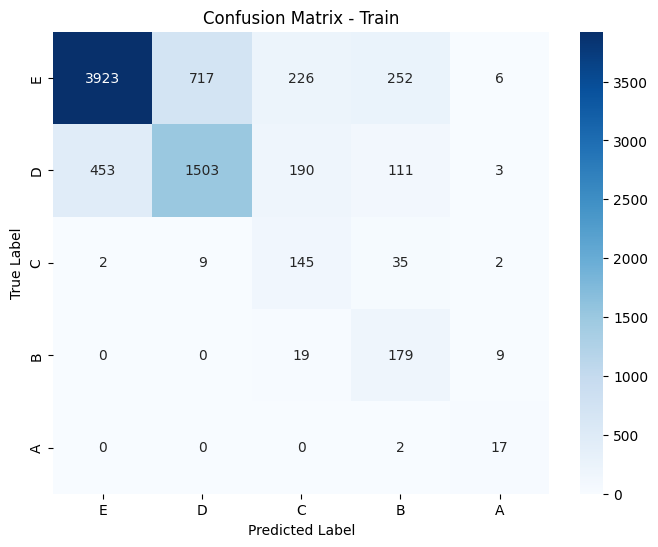

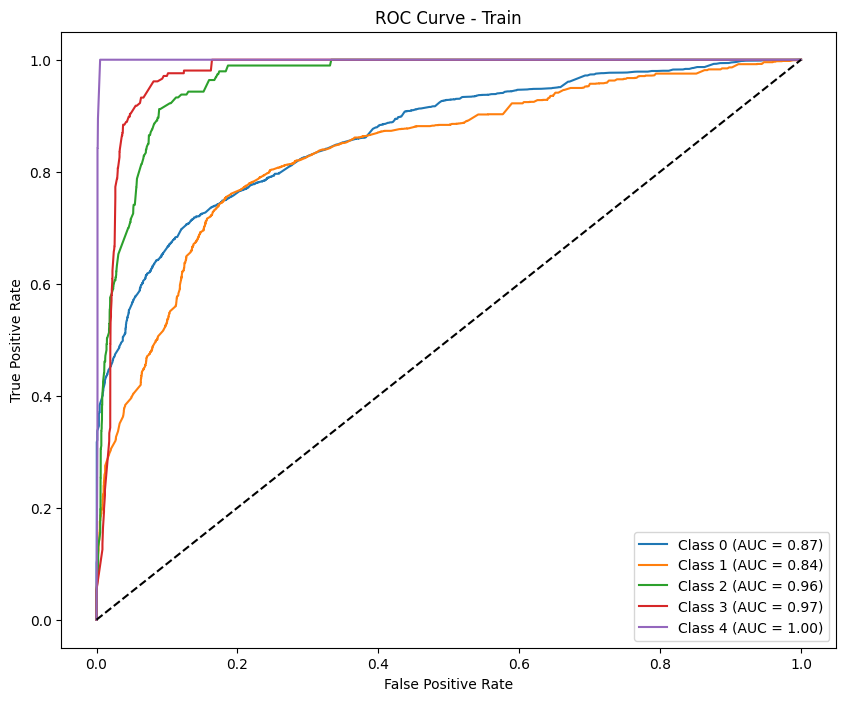


--- Test Metrics ---
F1 Score (per class): [0.89586524 0.         0.         0.         0.        ]
Precision (per class): [0.81476323 0.         0.         0.         0.        ]
Recall (per class): [0.99489796 0.         0.         0.         0.        ]
Accuracy: 0.8114
AUC (One-vs-Rest): 0.6267

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.99      0.90       588
           D       0.00      0.00      0.00        87
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.81       721
   macro avg       0.16      0.20      0.18       721
weighted avg       0.66      0.81      0.73       721



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


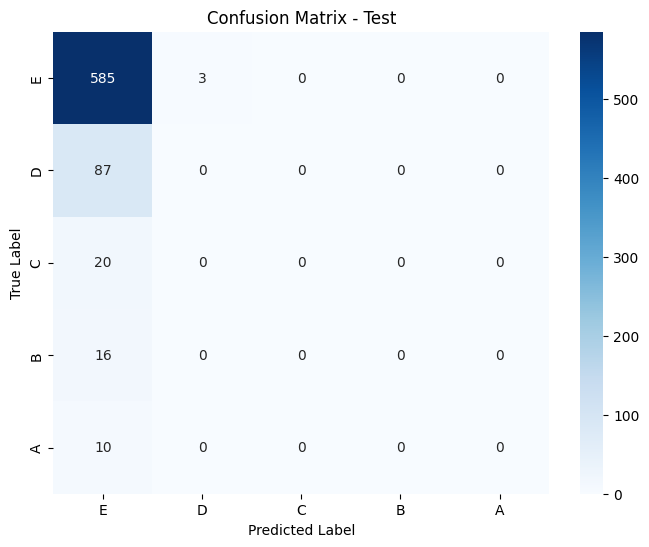

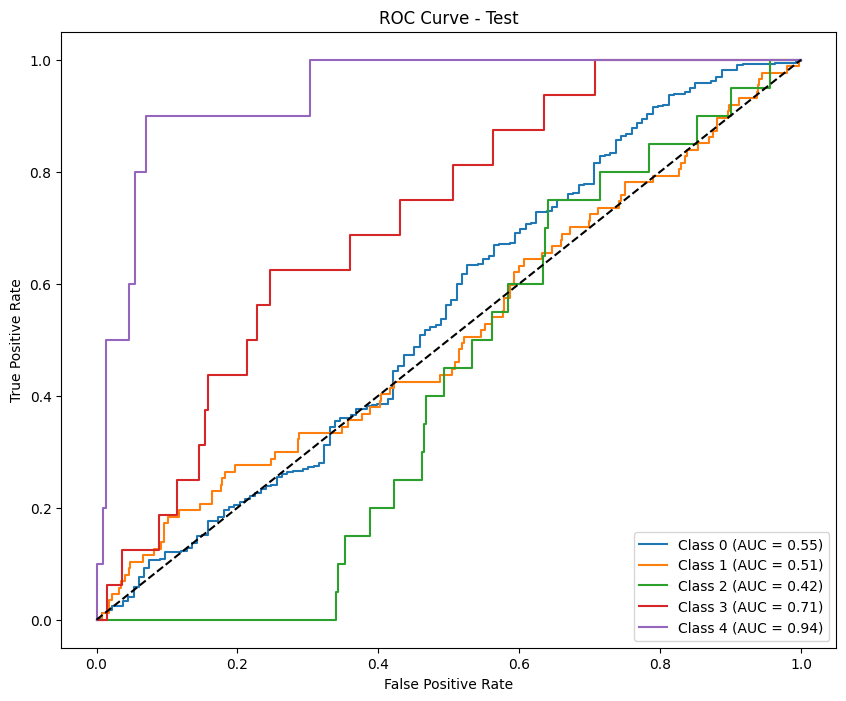

Results saved as test_results_calibrate_minmax_f1_macro_phase3.csv
-------------Results for calibrate phase: phase3---------------

--- Train Metrics ---
F1 Score (per class): [0.8464769  0.63496855 0.47570332 0.4679089  0.57142857]
Precision (per class): [0.81112502 0.73586006 0.46969697 0.40942029 0.52173913]
Recall (per class): [0.88505074 0.55840708 0.48186528 0.54589372 0.63157895]
Accuracy: 0.7709
AUC (One-vs-Rest): 0.9389

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.89      0.85      5124
           D       0.74      0.56      0.63      2260
           C       0.47      0.48      0.48       193
           B       0.41      0.55      0.47       207
           A       0.52      0.63      0.57        19

    accuracy                           0.77      7803
   macro avg       0.59      0.62      0.60      7803
weighted avg       0.77      0.77      0.77      7803



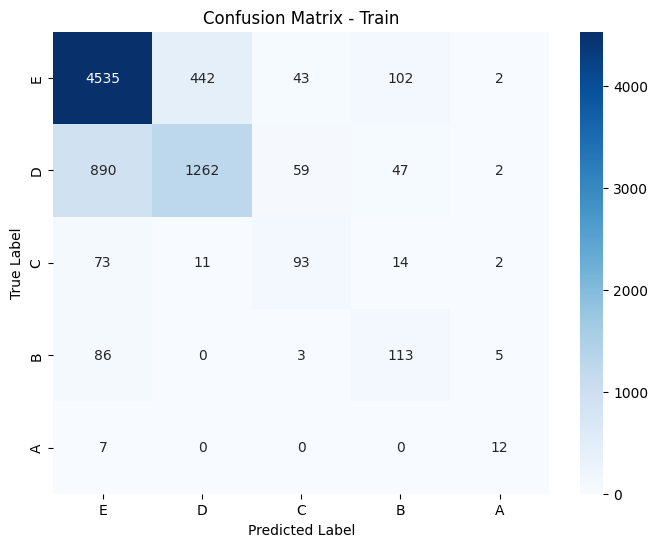

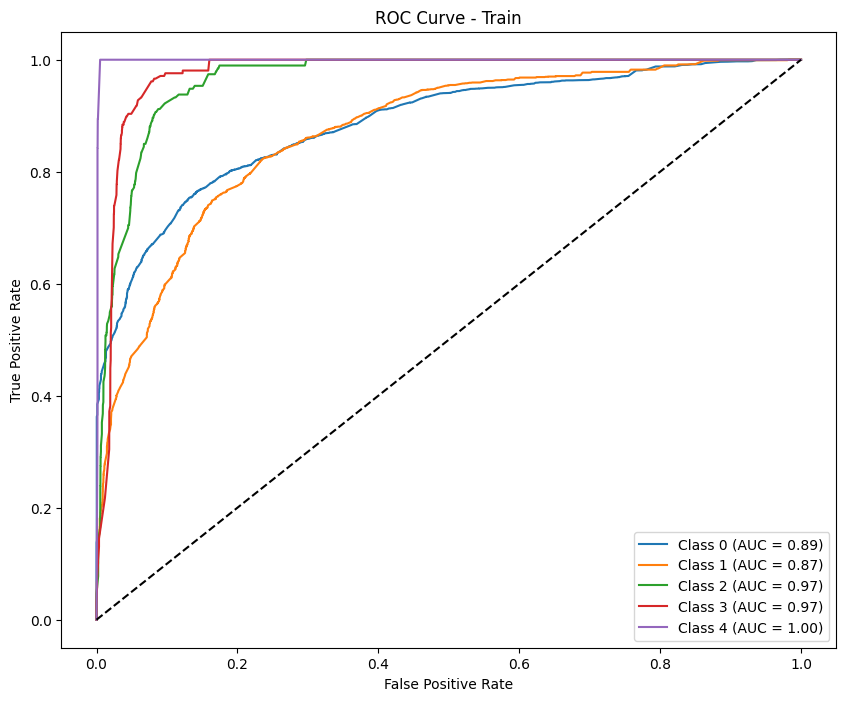

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.89839572 0.         0.         0.         0.        ]
Precision (per class): [0.81553398 0.         0.         0.         0.        ]
Recall (per class): [1. 0. 0. 0. 0.]
Accuracy: 0.8155
AUC (One-vs-Rest): 0.6286

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       588
           D       0.00      0.00      0.00        87
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.82       721
   macro avg       0.16      0.20      0.18       721
weighted avg       0.67      0.82      0.73       721



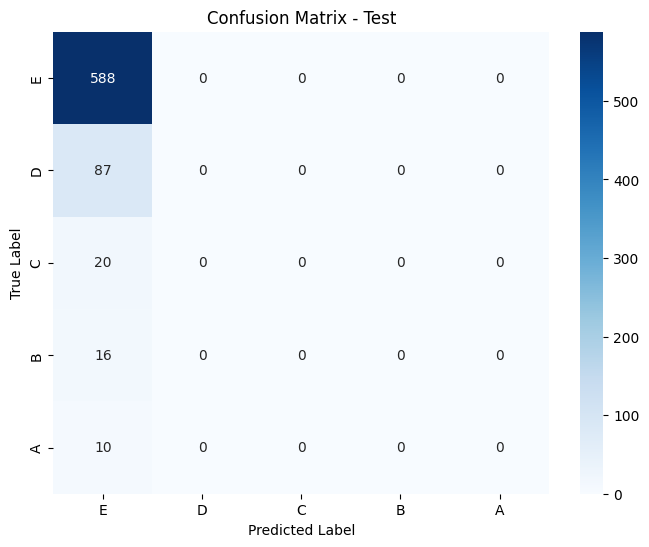

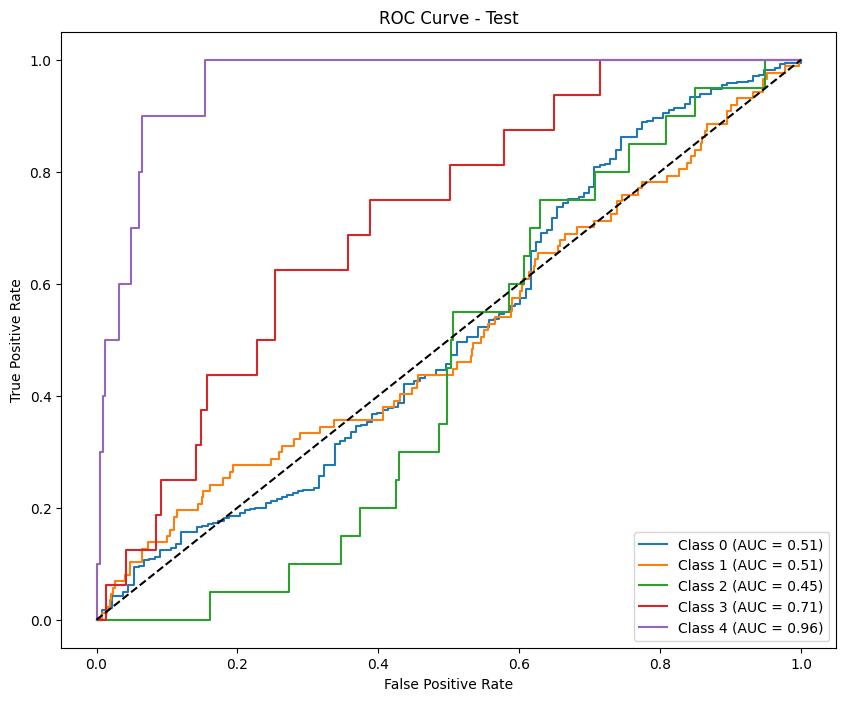

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None
Results saved as test_results_minmax_f1_macro_phase4.csv
----------Results for phase: phase4--------------

--- Train Metrics ---
F1 Score (per class): [0.82173913 0.69540045 0.27619048 0.53784861 0.62222222]
Precision (per class): [0.90214797 0.70792403 0.16446125 0.39358601 0.4516129 ]
Recall (per class): [0.75449102 0.68331226 0.86138614 0.8490566  1.        ]
Accuracy: 0.7390
AUC (One-vs-Rest): 0.9326

Classification Report:
              precision    recall  f1-score   support

           E       0.90      0.75      0.82      3507
           D       0.71      0.68      0.70      1582
           C       0.16      0.86      0.28       101
           B       0.39      0.85      0.54       159
           A       0.45      1.00      0.62        14

    accuracy                           0.74      53

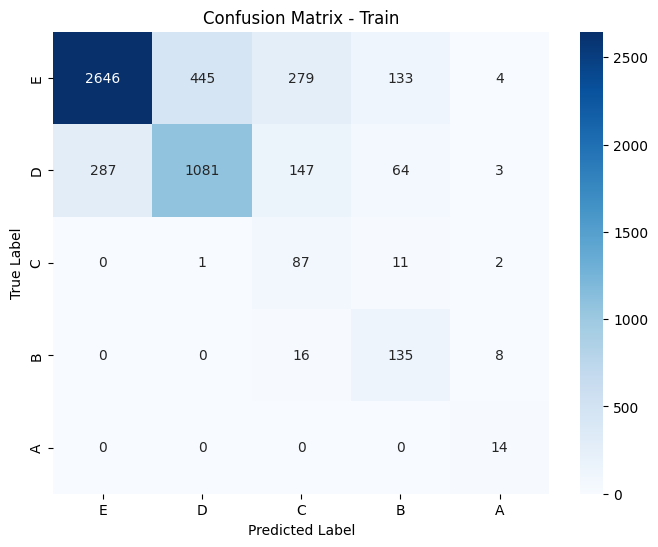

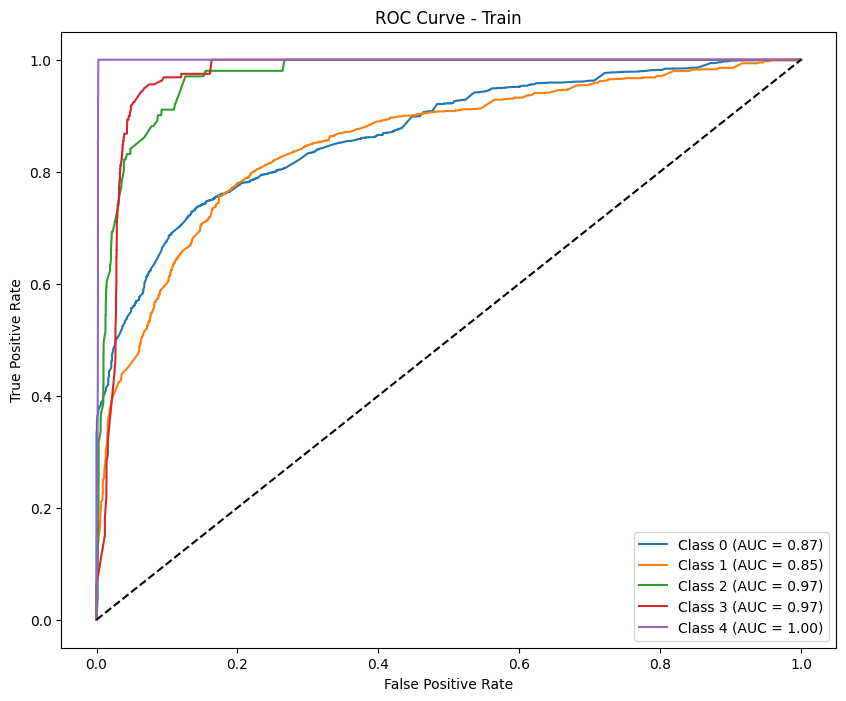


--- Test Metrics ---
F1 Score (per class): [0.88834951 0.         0.         0.         0.        ]
Precision (per class): [0.8061674 0.        0.        0.        0.       ]
Recall (per class): [0.98918919 0.         0.         0.         0.        ]
Accuracy: 0.7991
AUC (One-vs-Rest): 0.5833

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.99      0.89       555
           D       0.00      0.00      0.00        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.80       687
   macro avg       0.16      0.20      0.18       687
weighted avg       0.65      0.80      0.72       687



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


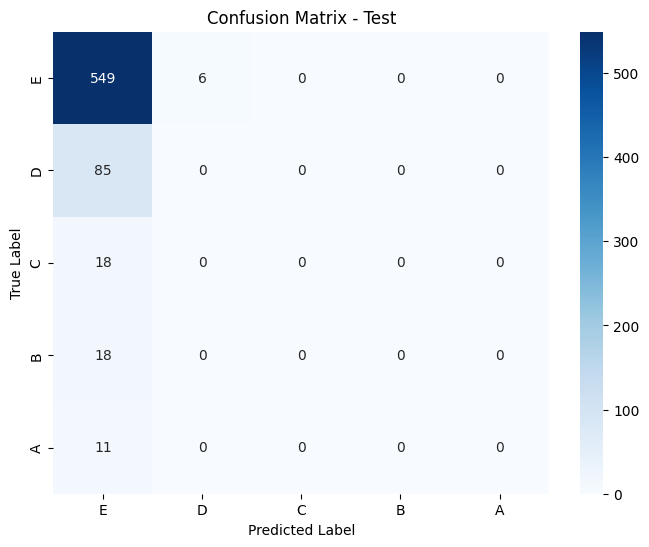

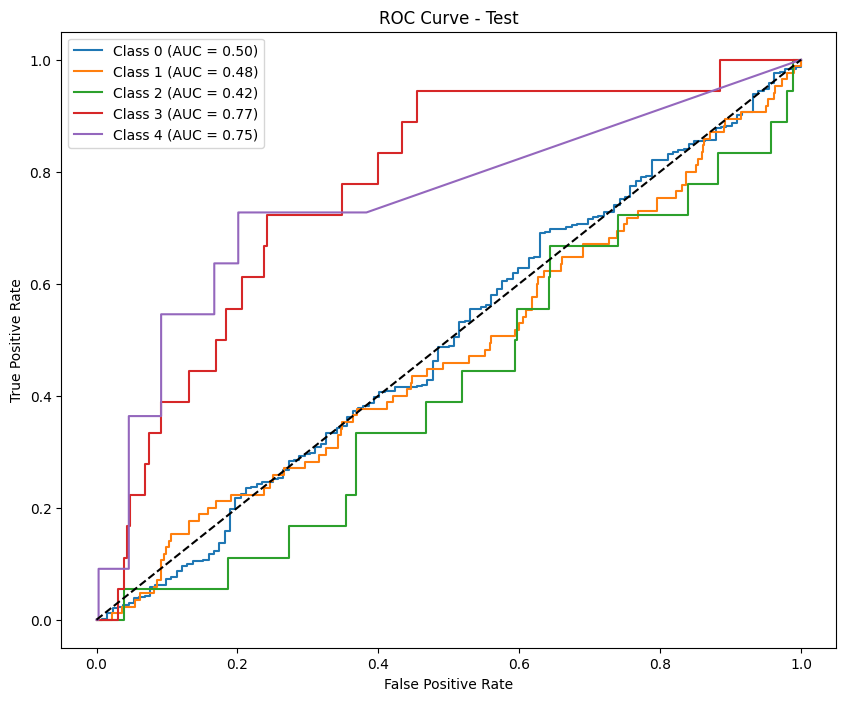

Results saved as test_results_calibrate_minmax_f1_macro_phase4.csv
-------------Results for calibrate phase: phase4---------------

--- Train Metrics ---
F1 Score (per class): [0.85485209 0.66357474 0.5        0.52830189 0.48484848]
Precision (per class): [0.82962168 0.76167076 0.44274809 0.42264151 0.42105263]
Recall (per class): [0.88166524 0.58786346 0.57425743 0.70440252 0.57142857]
Accuracy: 0.7831
AUC (One-vs-Rest): 0.9428

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.88      0.85      3507
           D       0.76      0.59      0.66      1582
           C       0.44      0.57      0.50       101
           B       0.42      0.70      0.53       159
           A       0.42      0.57      0.48        14

    accuracy                           0.78      5363
   macro avg       0.58      0.66      0.61      5363
weighted avg       0.79      0.78      0.78      5363



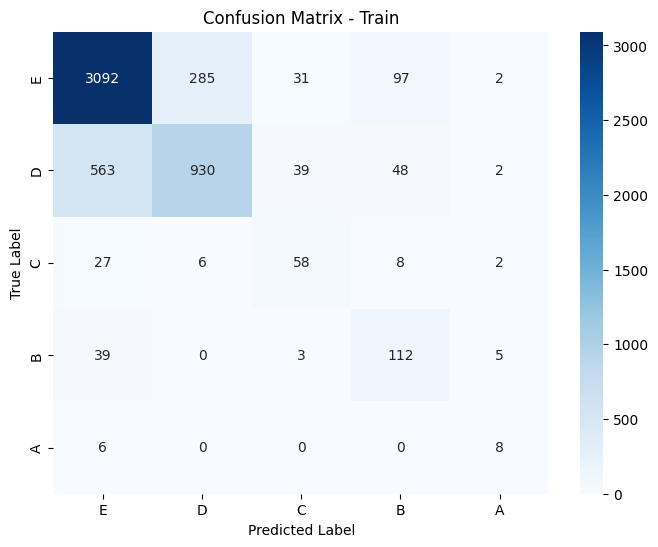

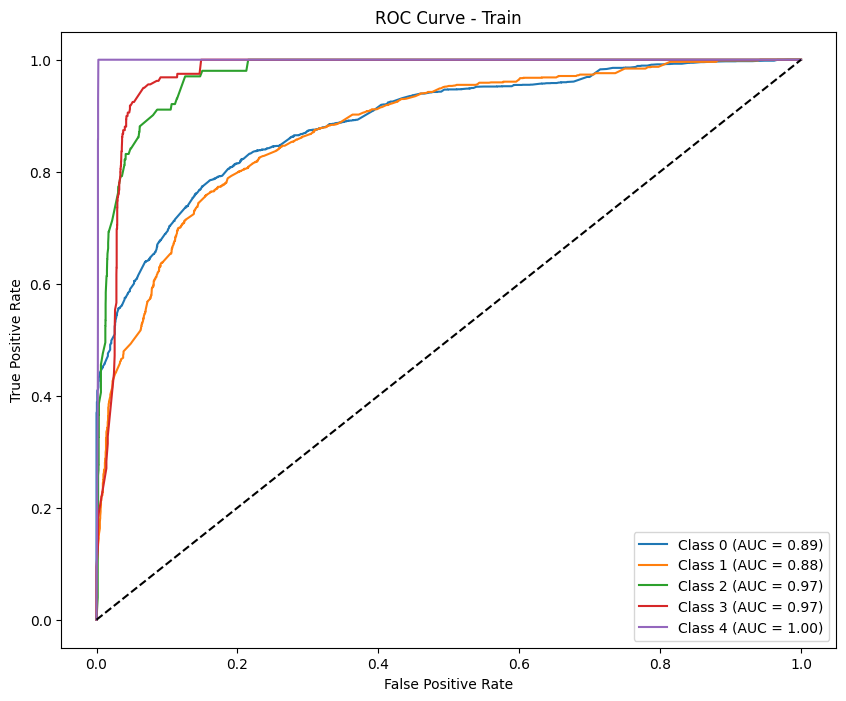


--- Test Metrics ---
F1 Score (per class): [0.89282836 0.         0.         0.         0.        ]
Precision (per class): [0.80758017 0.         0.         0.         0.        ]
Recall (per class): [0.9981982 0.        0.        0.        0.       ]
Accuracy: 0.8064
AUC (One-vs-Rest): 0.6113

Classification Report:
              precision    recall  f1-score   support

           E       0.81      1.00      0.89       555
           D       0.00      0.00      0.00        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.81       687
   macro avg       0.16      0.20      0.18       687
weighted avg       0.65      0.81      0.72       687



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


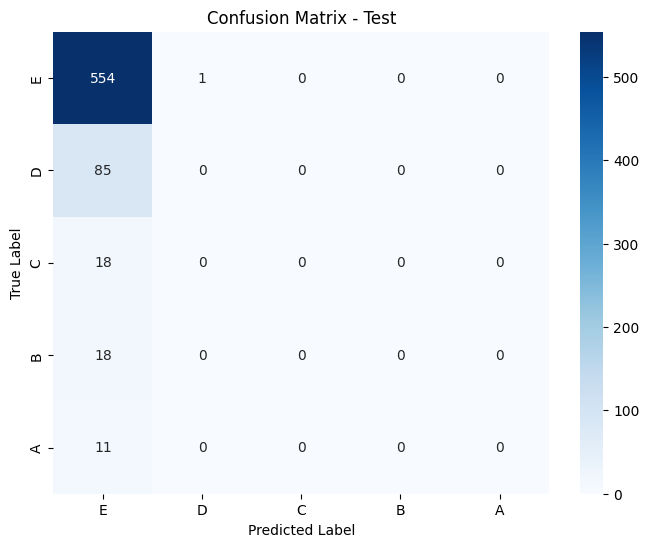

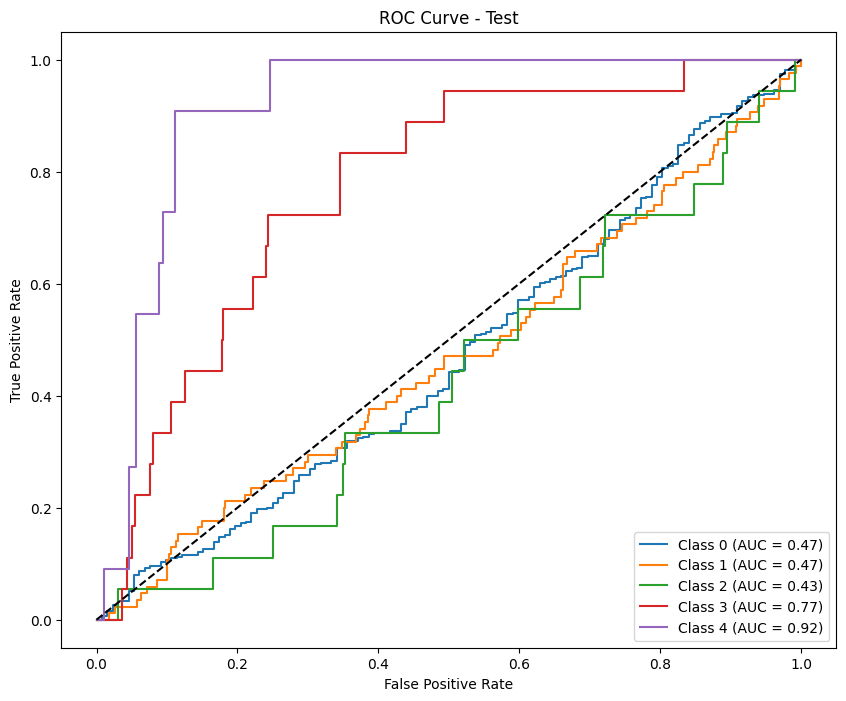

In [35]:
# Lặp qua các phase
hyperparams = {
    "phase1": hp_1,
    "phase2": hp_2,
    "phase3": hp_3,
    "phase4": hp_4
}

for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_phase(phase, metric='f1_macro', scale='minmax', hyper=hyperparams[phase]) 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

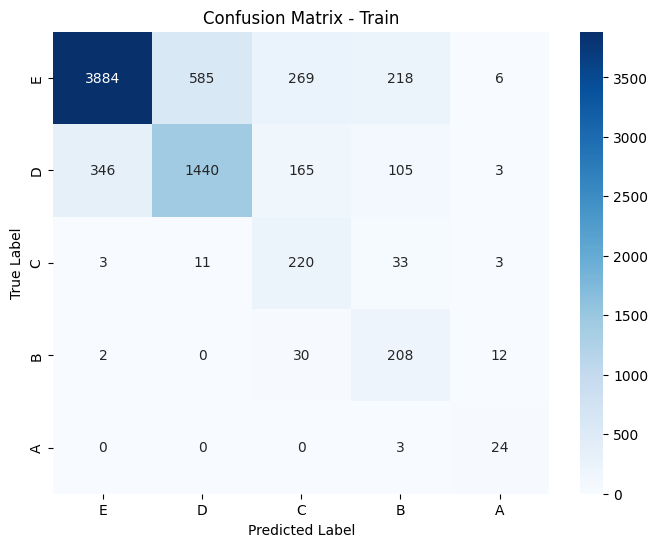

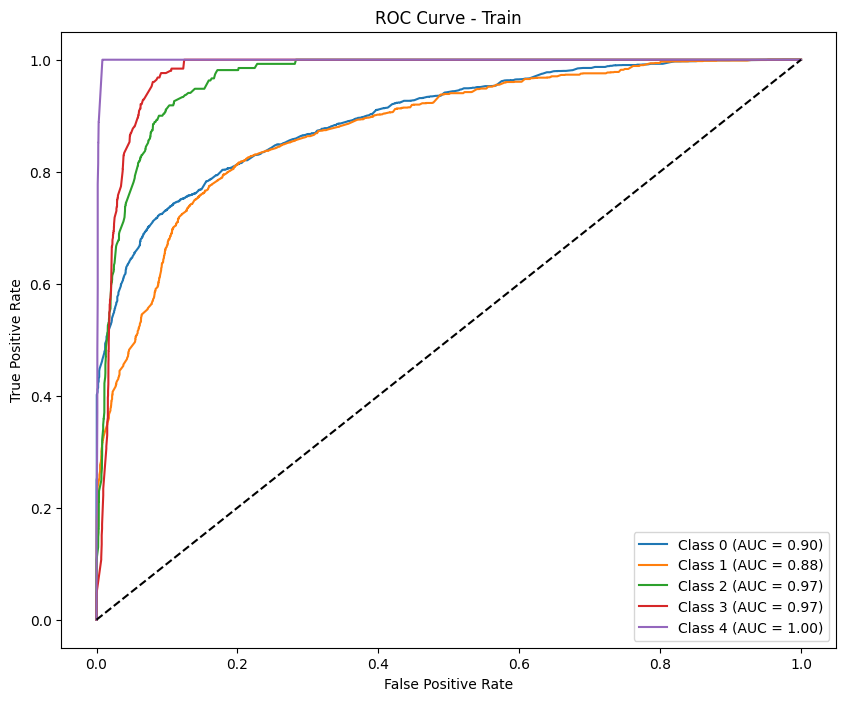


--- Test Metrics ---
F1 Score (per class): [0.92319277 0.37681159 0.         0.         0.        ]
Precision (per class): [0.86095506 0.59090909 0.         0.         0.        ]
Recall (per class): [0.99512987 0.27659574 0.         0.         0.        ]
Accuracy: 0.8452
AUC (One-vs-Rest): 0.8257

Classification Report:
              precision    recall  f1-score   support

           E       0.86      1.00      0.92       616
           D       0.59      0.28      0.38        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.85       756
   macro avg       0.29      0.25      0.26       756
weighted avg       0.77      0.85      0.80       756



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


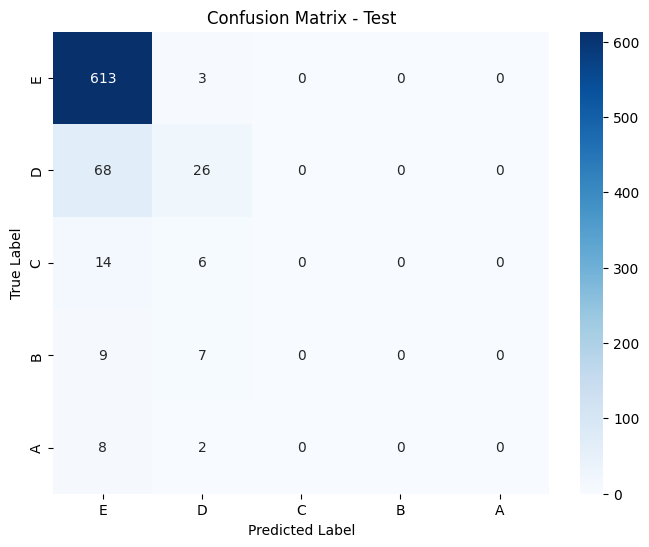

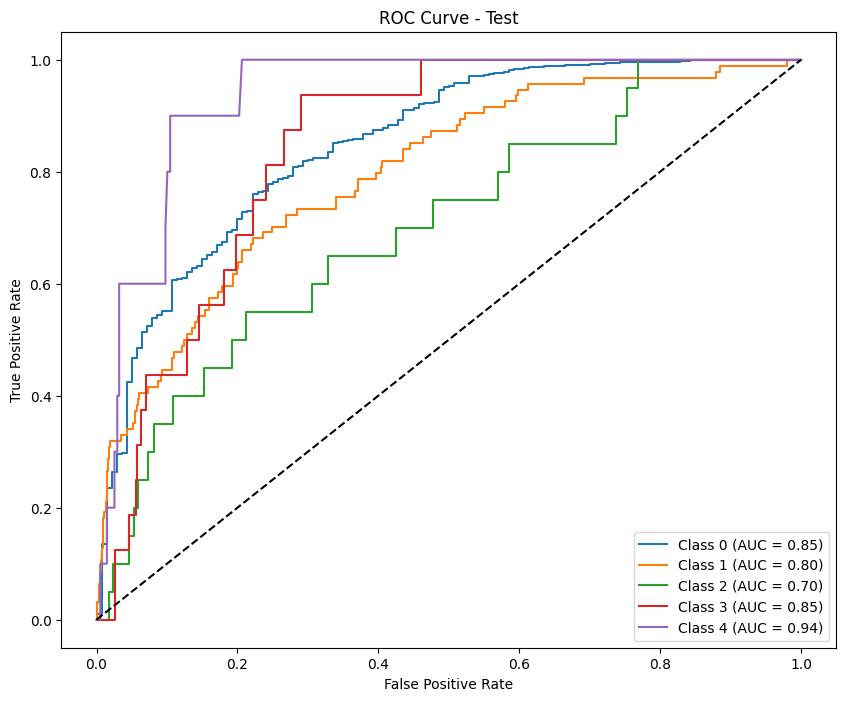

Results saved as test_results_calibrate_undersample_minmax_f1_macro_phase1.csv
Results for phase: phase1

--- Train Metrics ---
F1 Score (per class): [0.86424325 0.66829799 0.54355401 0.57746479 0.6440678 ]
Precision (per class): [0.83676165 0.75911056 0.51315789 0.51898734 0.59375   ]
Recall (per class): [0.89359129 0.59689169 0.57777778 0.65079365 0.7037037 ]
Accuracy: 0.7929
AUC (One-vs-Rest): 0.9496

Classification Report:
              precision    recall  f1-score   support

           E       0.84      0.89      0.86      4962
           D       0.76      0.60      0.67      2059
           C       0.51      0.58      0.54       270
           B       0.52      0.65      0.58       252
           A       0.59      0.70      0.64        27

    accuracy                           0.79      7570
   macro avg       0.64      0.68      0.66      7570
weighted avg       0.79      0.79      0.79      7570



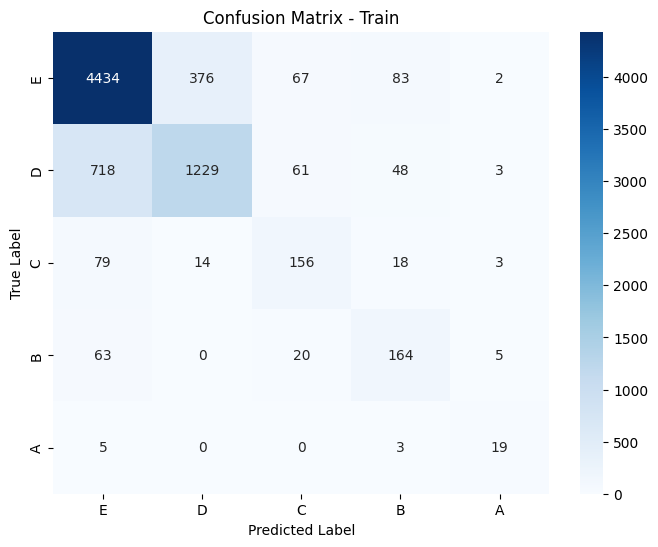

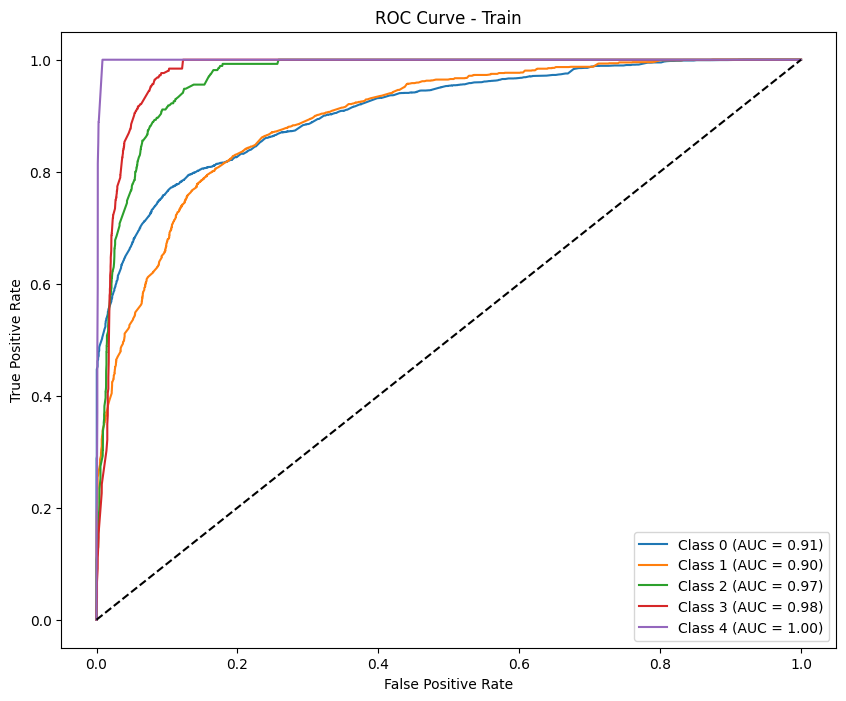


--- Test Metrics ---
F1 Score (per class): [0.90721649 0.16666667 0.         0.         0.        ]
Precision (per class): [0.83018868 0.64285714 0.         0.         0.        ]
Recall (per class): [1.         0.09574468 0.         0.         0.        ]
Accuracy: 0.8267
AUC (One-vs-Rest): 0.8251

Classification Report:
              precision    recall  f1-score   support

           E       0.83      1.00      0.91       616
           D       0.64      0.10      0.17        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.83       756
   macro avg       0.29      0.22      0.21       756
weighted avg       0.76      0.83      0.76       756



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


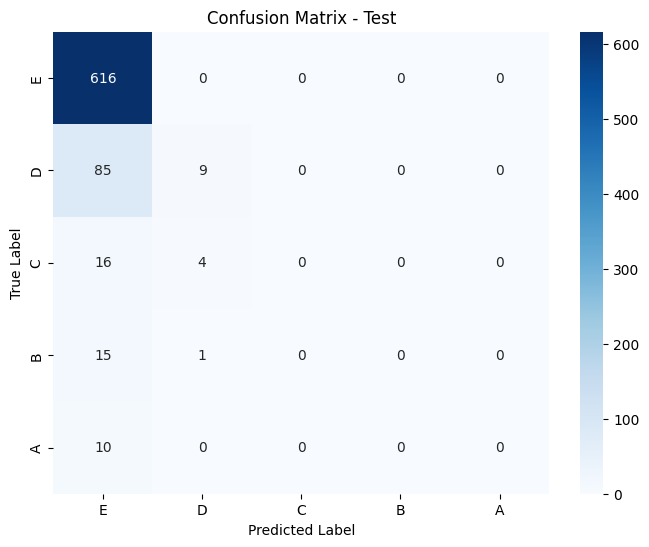

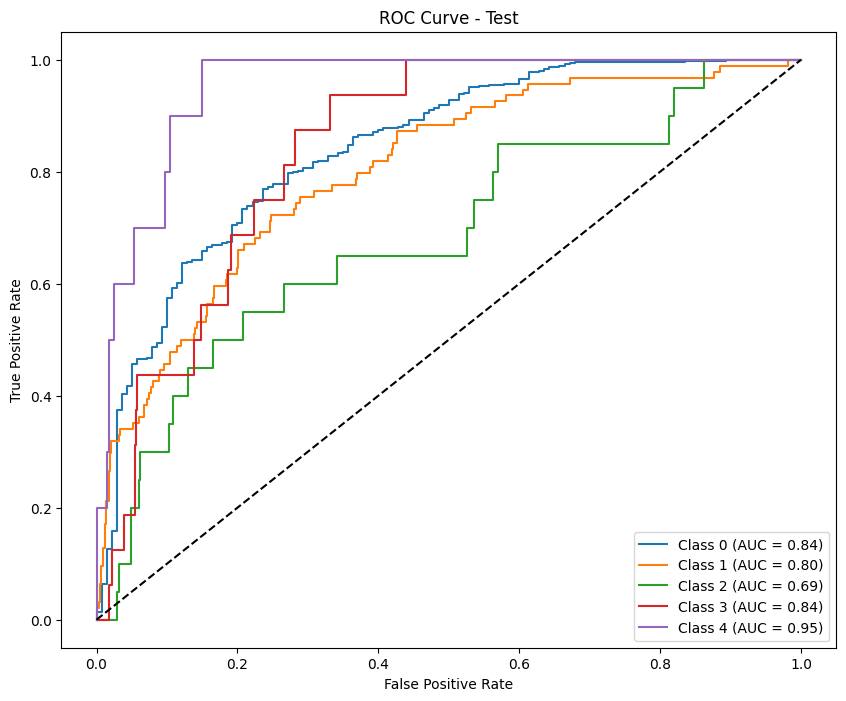


Permutation Importance for phase: phase1


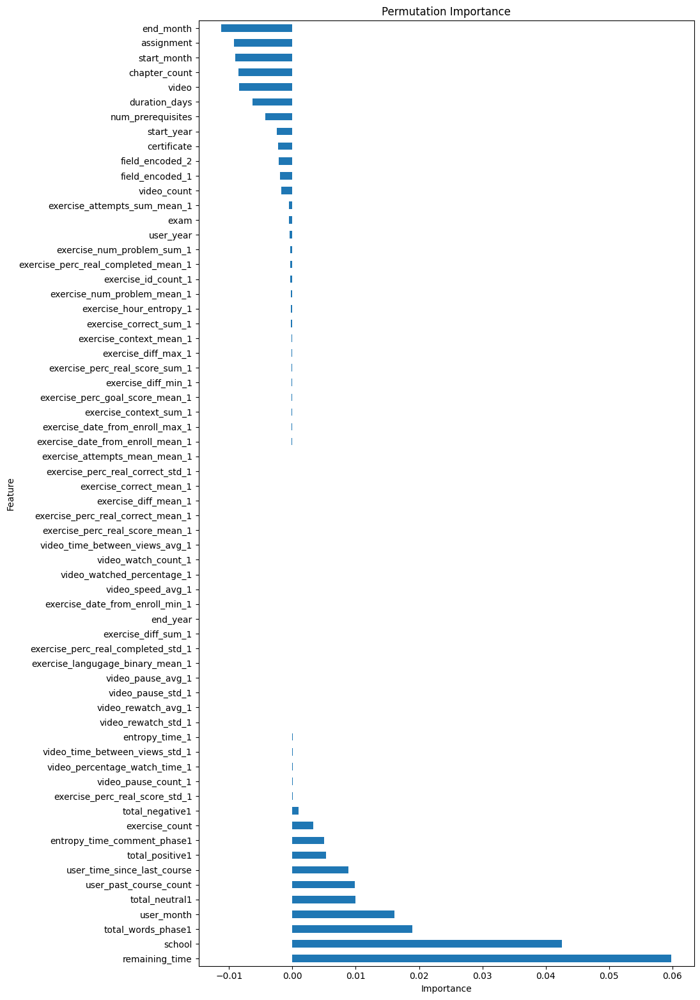

               Feature  Importance
20      remaining_time    0.059841
0               school    0.042520
60  total_words_phase1    0.018940
8           user_month    0.016149
63      total_neutral1    0.009924
..                 ...         ...
17               video   -0.008388
11       chapter_count   -0.008520
4          start_month   -0.009032
16          assignment   -0.009231
6            end_month   -0.011262

[64 rows x 2 columns]

Lasso Feature Selection for phase: phase1


Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.48665246590508104, tolerance: 0.3382939894319684
Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8947394511424136, tolerance: 0.3382939894319684
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.079270551620084, tolerance: 0.3382939894319684
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.319121743179039, tolerance: 0.3382939894319684
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.417532069265235, tolerance: 0.3382939894319684
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5108056999297332, tolerance: 0.3382939894319684
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4781083766329175, tolerance: 0.33829398943

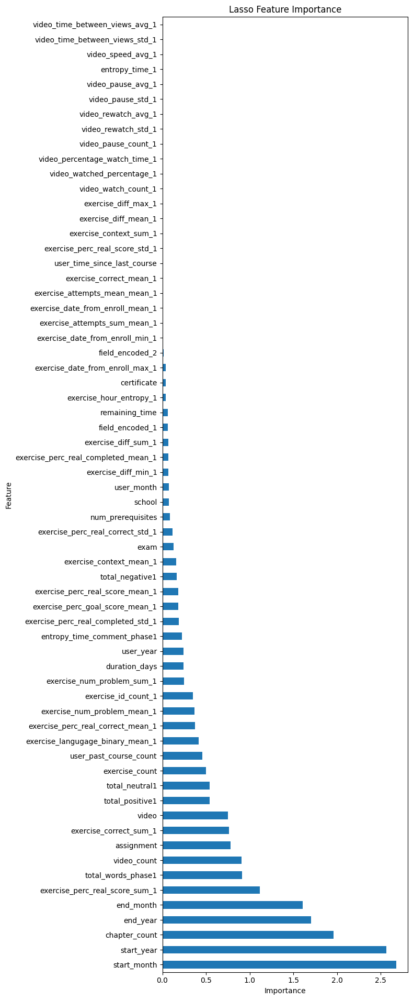

                           Feature  Importance
4                      start_month    2.676725
3                       start_year    2.562448
11                   chapter_count    1.958588
5                         end_year    1.701382
6                        end_month    1.608604
..                             ...         ...
52               video_pause_avg_1    0.000000
59                  entropy_time_1    0.000000
58               video_speed_avg_1    0.000000
57  video_time_between_views_std_1    0.000000
56  video_time_between_views_avg_1    0.000000

[64 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                       Feature  Importance
64              Random Feature    0.219985
20              remaining_time    0.134115
17                       video    0.086175
16                  assignment    0.077015
0                       school    0.059914
..                         ...         ...
51         video_pause_count_1    0.000001
49  vid

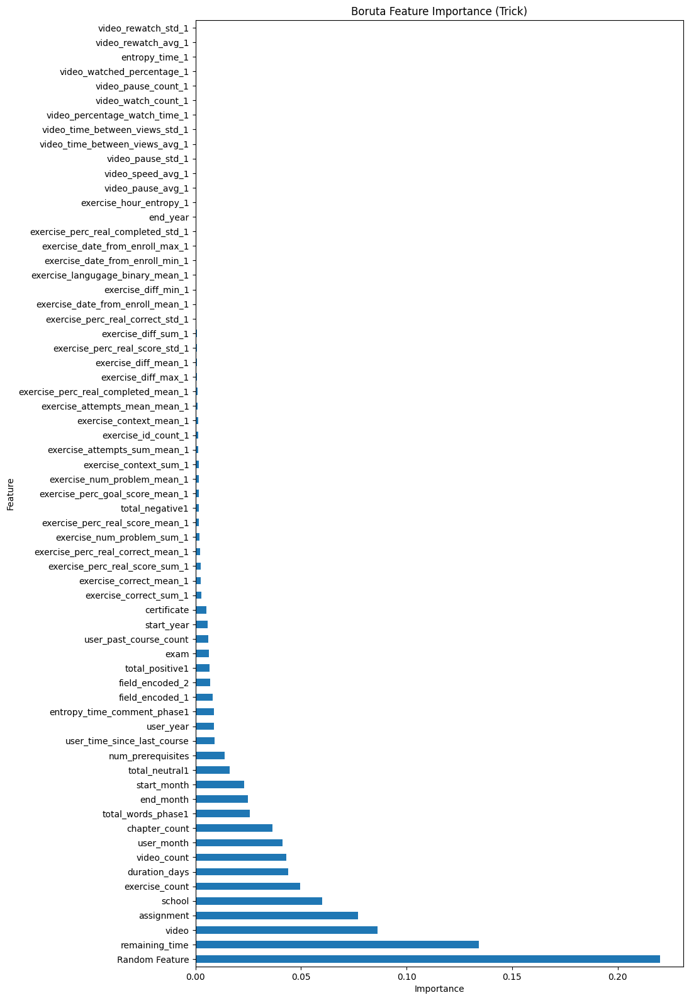

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None
Results saved as test_results_undersample_minmax_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.83198076 0.67351833 0.46767538 0.55388813 0.73015873]
Precision (per class): [0.91232696 0.66598916 0.34205231 0.40357853 0.60526316]
Recall (per class): [0.76464088 0.68121968 0.73913043 0.8826087  0.92      ]
Accuracy: 0.7475
AUC (One-vs-Rest): 0.9338

Classification Report:
              precision    recall  f1-score   support

           E       0.91      0.76      0.83      3620
           D       0.67      0.68      0.67      1443
           C       0.34      0.74      0.47       230
           B       0.40      0.88      0.55       230
           A       0.61      0.92      0.73        25

    accuracy                           0.75      5548
   macro 

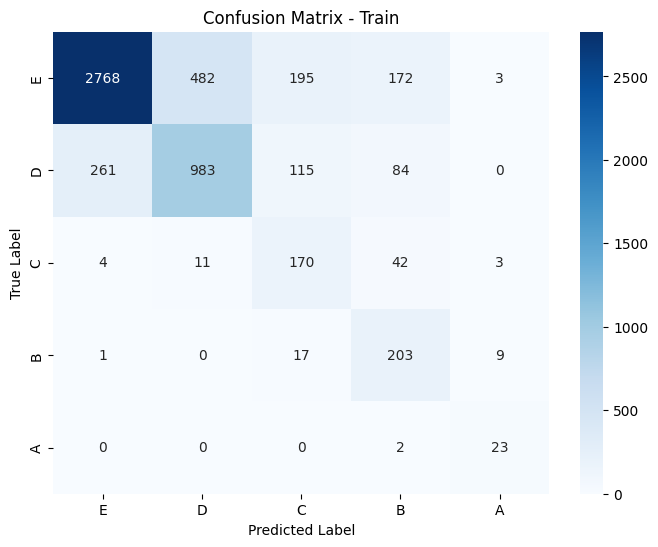

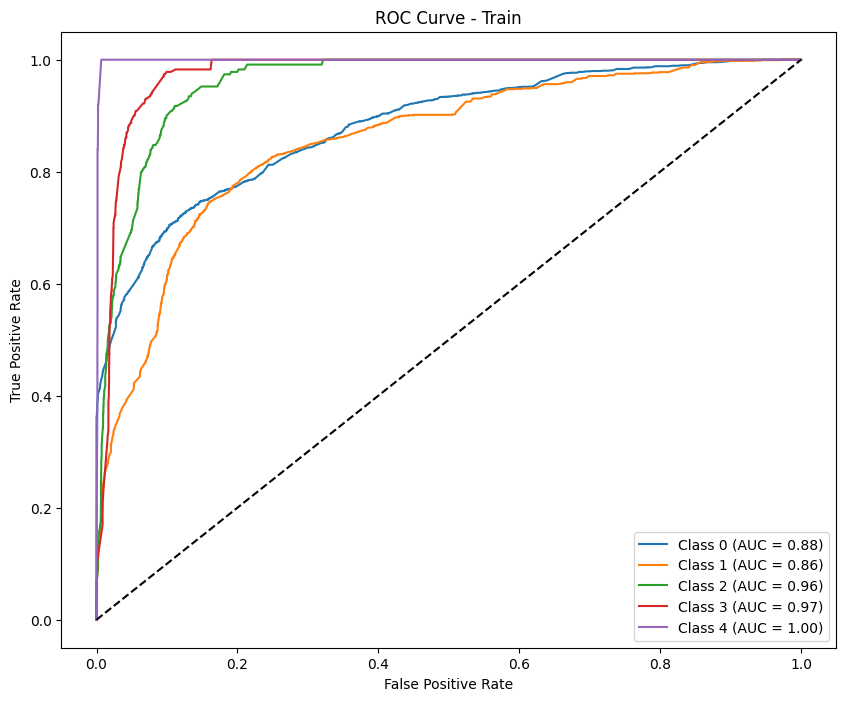


--- Test Metrics ---
F1 Score (per class): [0.90022173 0.04255319 0.         0.         0.        ]
Precision (per class): [0.81854839 1.         0.         0.         0.        ]
Recall (per class): [1.         0.02173913 0.         0.         0.        ]
Accuracy: 0.8190
AUC (One-vs-Rest): 0.7396

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       609
           D       1.00      0.02      0.04        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.82       746
   macro avg       0.36      0.20      0.19       746
weighted avg       0.79      0.82      0.74       746



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


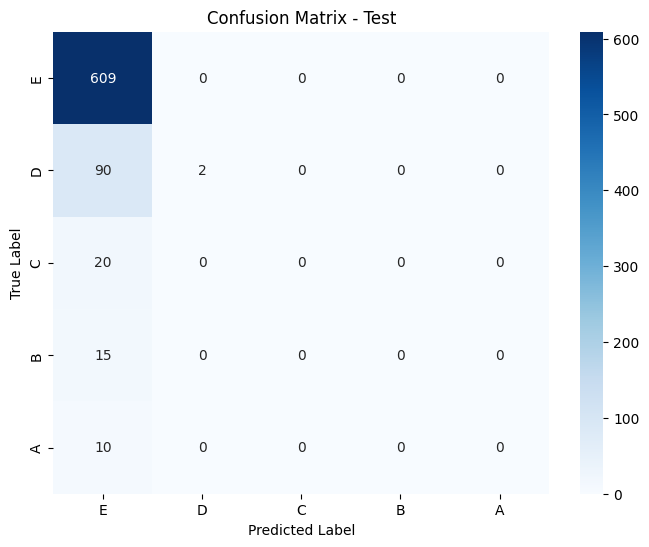

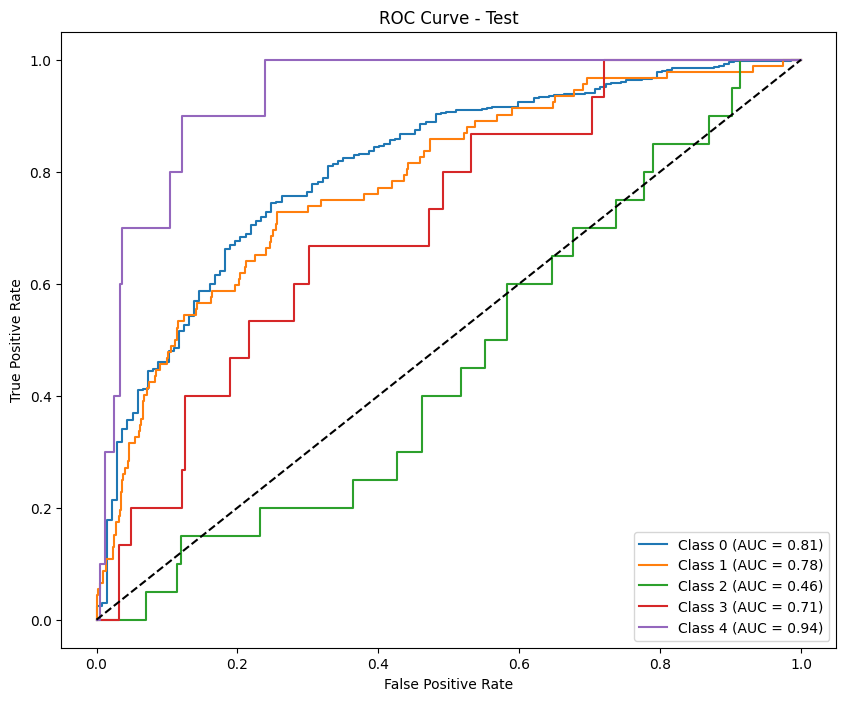

Results saved as test_results_calibrate_undersample_minmax_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.85270071 0.61682975 0.53626374 0.6234676  0.77777778]
Precision (per class): [0.82816975 0.70863309 0.54222222 0.52199413 0.72413793]
Recall (per class): [0.87872928 0.54608455 0.53043478 0.77391304 0.84      ]
Accuracy: 0.7733
AUC (One-vs-Rest): 0.9414

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.88      0.85      3620
           D       0.71      0.55      0.62      1443
           C       0.54      0.53      0.54       230
           B       0.52      0.77      0.62       230
           A       0.72      0.84      0.78        25

    accuracy                           0.77      5548
   macro avg       0.67      0.71      0.68      5548
weighted avg       0.77      0.77      0.77      5548



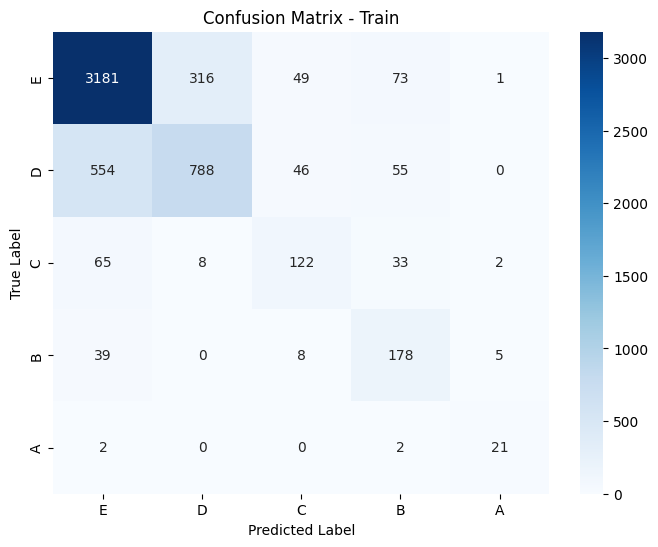

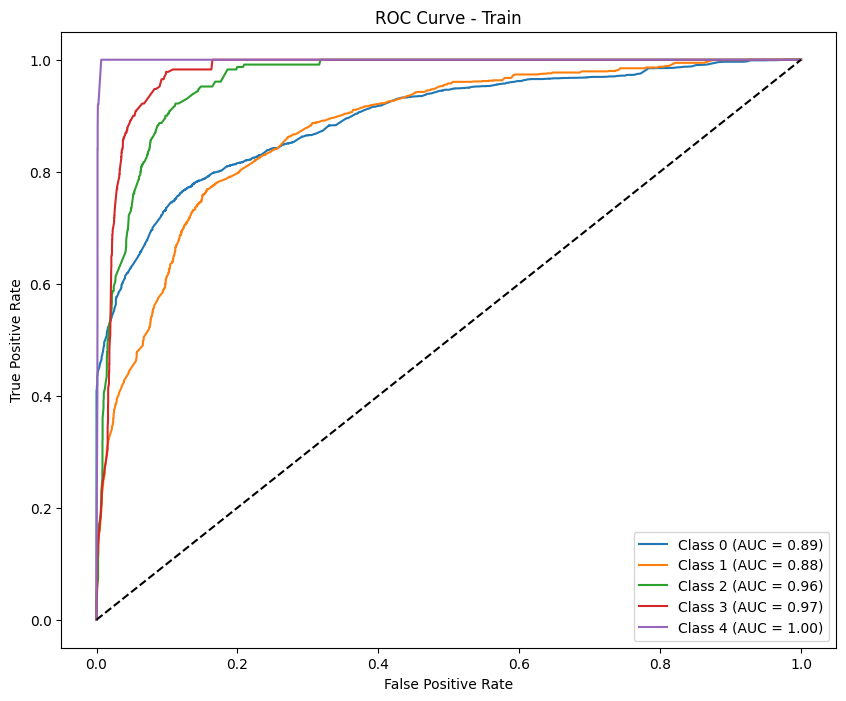


--- Test Metrics ---
F1 Score (per class): [0.89889299 0.         0.         0.         0.        ]
Precision (per class): [0.81635389 0.         0.         0.         0.        ]
Recall (per class): [1. 0. 0. 0. 0.]
Accuracy: 0.8164
AUC (One-vs-Rest): 0.7373

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       609
           D       0.00      0.00      0.00        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.82       746
   macro avg       0.16      0.20      0.18       746
weighted avg       0.67      0.82      0.73       746



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


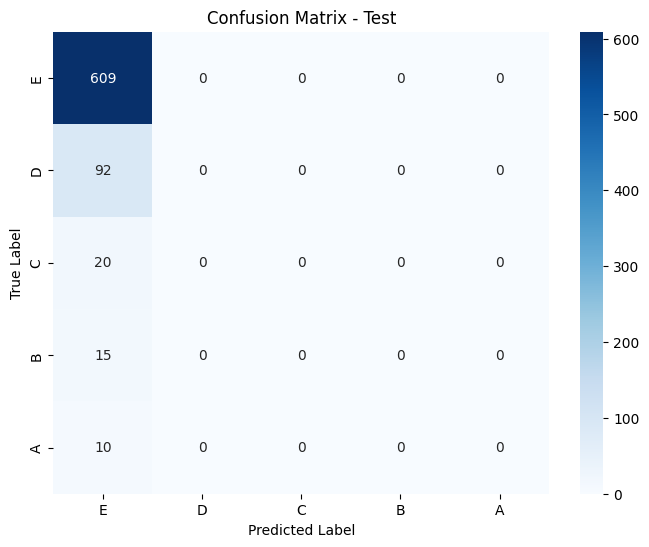

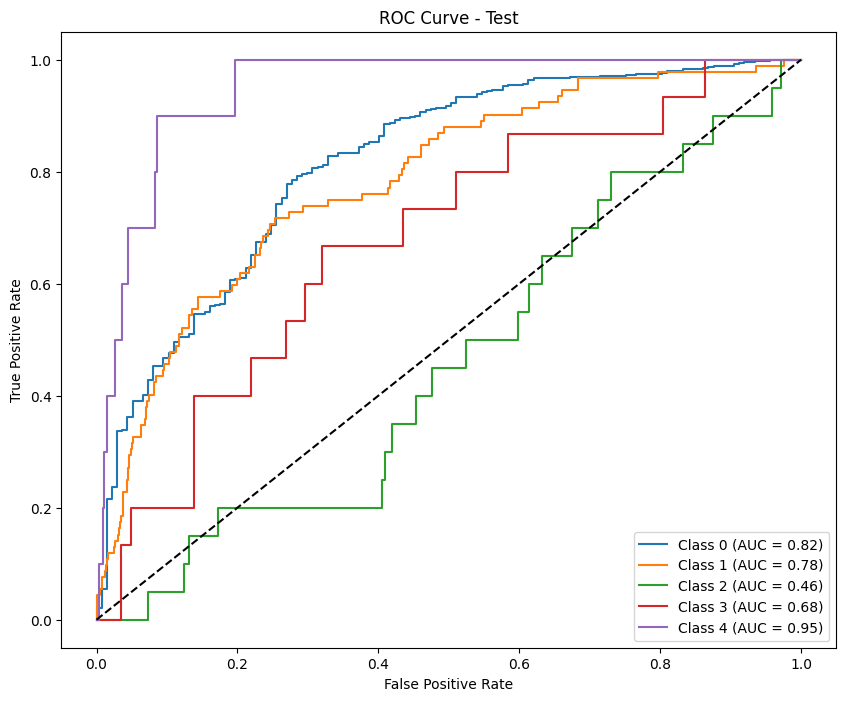


Permutation Importance for phase: phase2


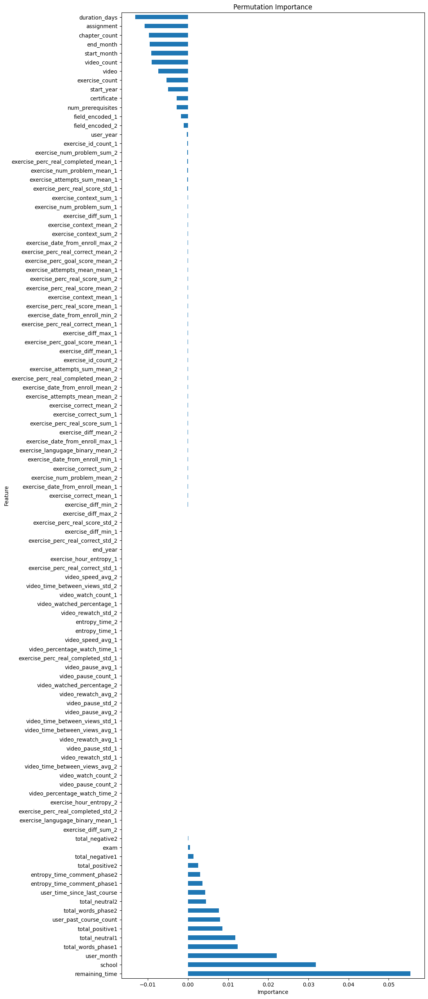

               Feature  Importance
20      remaining_time    0.055448
0               school    0.031813
8           user_month    0.022148
60  total_words_phase1    0.012392
63      total_neutral1    0.011761
..                 ...         ...
4          start_month   -0.009147
6            end_month   -0.009530
11       chapter_count   -0.009711
16          assignment   -0.010837
19       duration_days   -0.013158

[107 rows x 2 columns]

Lasso Feature Selection for phase: phase2


Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.36193450285964, tolerance: 0.2815246732762506
Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0737252829512727, tolerance: 0.2815246732762506
Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6162810256619196, tolerance: 0.2815246732762506
Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.940492641188939, tolerance: 0.2815246732762506
Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.9780231014501624, tolerance: 0.2815246732762506
Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.959352881778159, tolerance: 0.2815246732762506
Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.4418544616805775, tolerance: 0.2815246732762

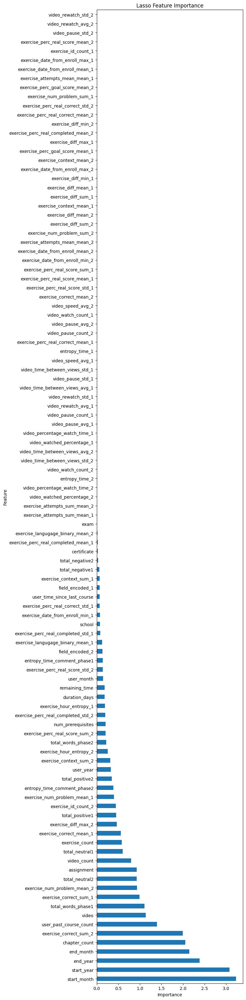

                            Feature  Importance
4                       start_month    3.226375
3                        start_year    3.081007
5                          end_year    2.385268
6                         end_month    2.147360
11                    chapter_count    2.050393
..                              ...         ...
22              exercise_id_count_1    0.000000
88  exercise_perc_real_score_mean_2    0.000000
96                video_pause_std_2    0.000000
97              video_rewatch_avg_2    0.000000
98              video_rewatch_std_2    0.000000

[107 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                            Feature  Importance
107                  Random Feature    0.187484
20                   remaining_time    0.123216
17                            video    0.077667
16                       assignment    0.075254
0                            school    0.063692
..                              ...         ...
95

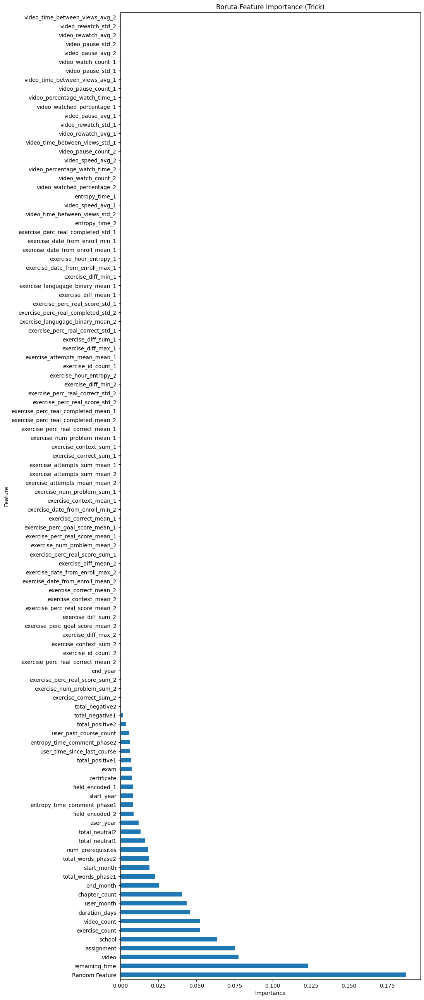

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None
Results saved as test_results_undersample_minmax_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.83612858 0.68634969 0.48684211 0.57467532 0.68      ]
Precision (per class): [0.92038462 0.66394659 0.35662651 0.43276284 0.5483871 ]
Recall (per class): [0.76600512 0.71031746 0.76683938 0.85507246 0.89473684]
Accuracy: 0.7558
AUC (One-vs-Rest): 0.9366

Classification Report:
              precision    recall  f1-score   support

           E       0.92      0.77      0.84      3124
           D       0.66      0.71      0.69      1260
           C       0.36      0.77      0.49       193
           B       0.43      0.86      0.57       207
           A       0.55      0.89      0.68        19

    accuracy                           0.76      4803
   macro 

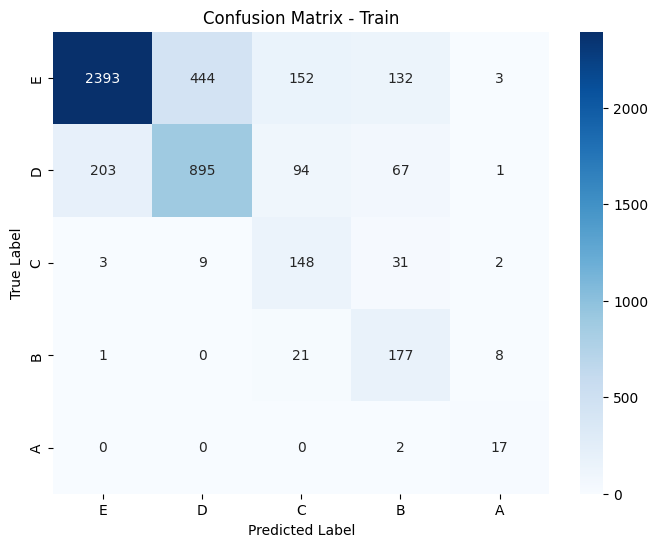

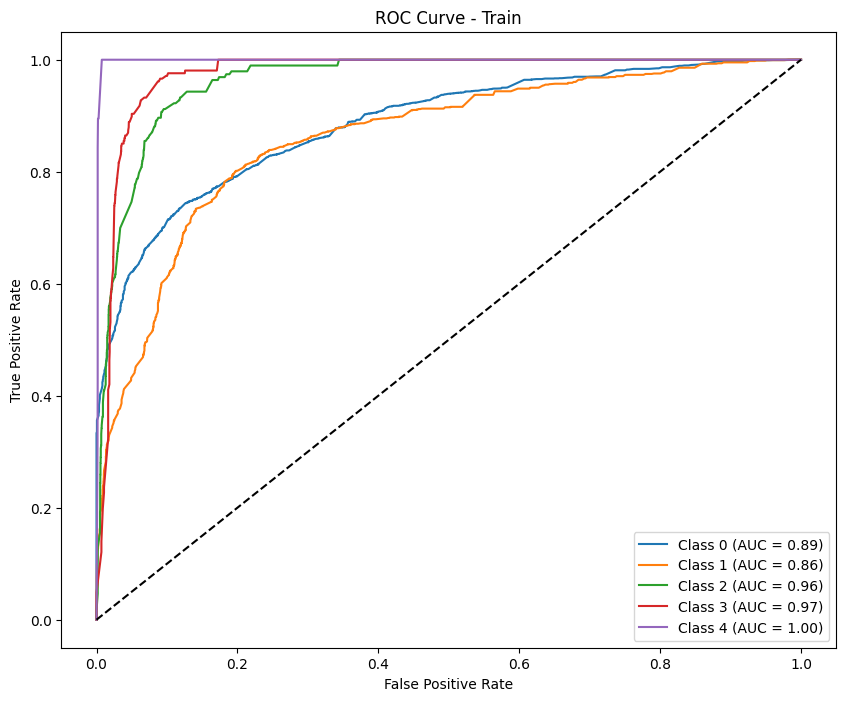


--- Test Metrics ---
F1 Score (per class): [0.89671002 0.         0.         0.         0.        ]
Precision (per class): [0.81502086 0.         0.         0.         0.        ]
Recall (per class): [0.99659864 0.         0.         0.         0.        ]
Accuracy: 0.8128
AUC (One-vs-Rest): 0.6348

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       588
           D       0.00      0.00      0.00        87
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.81       721
   macro avg       0.16      0.20      0.18       721
weighted avg       0.66      0.81      0.73       721



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


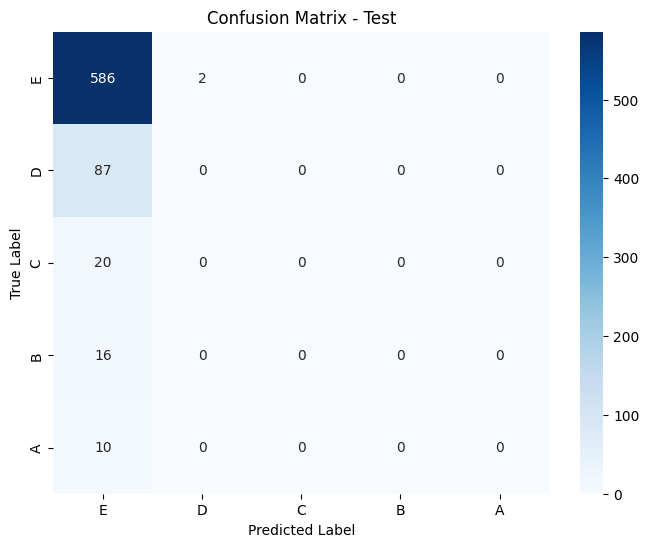

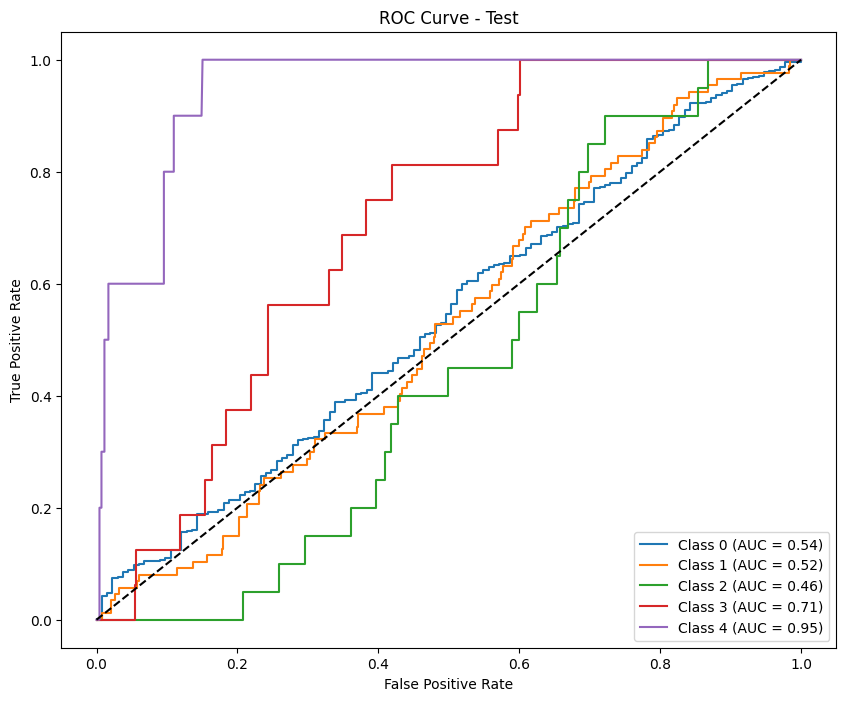

Results saved as test_results_calibrate_undersample_minmax_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.85812072 0.64024933 0.55754476 0.62925852 0.71428571]
Precision (per class): [0.83474576 0.72920892 0.55050505 0.53767123 0.65217391]
Recall (per class): [0.88284251 0.57063492 0.56476684 0.75845411 0.78947368]
Accuracy: 0.7824
AUC (One-vs-Rest): 0.9448

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.88      0.86      3124
           D       0.73      0.57      0.64      1260
           C       0.55      0.56      0.56       193
           B       0.54      0.76      0.63       207
           A       0.65      0.79      0.71        19

    accuracy                           0.78      4803
   macro avg       0.66      0.71      0.68      4803
weighted avg       0.78      0.78      0.78      4803



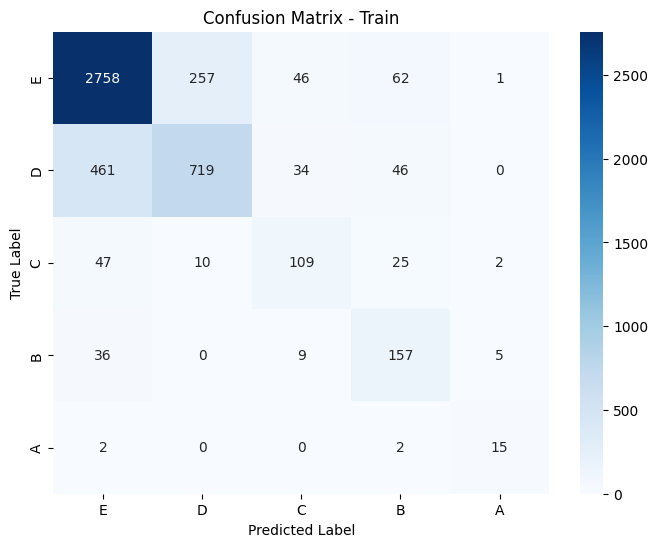

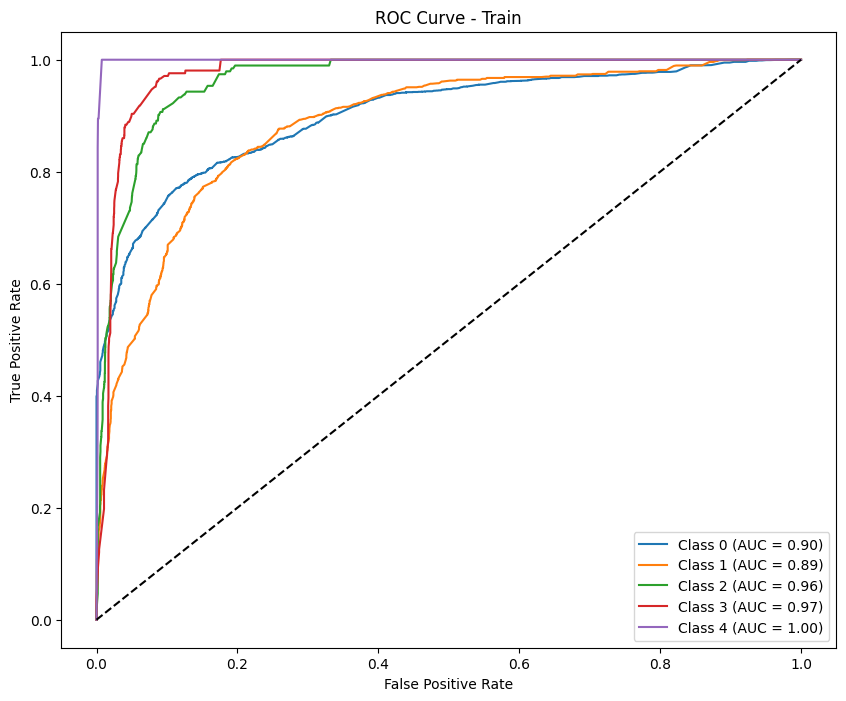


--- Test Metrics ---
F1 Score (per class): [0.89839572 0.         0.         0.         0.        ]
Precision (per class): [0.81553398 0.         0.         0.         0.        ]
Recall (per class): [1. 0. 0. 0. 0.]
Accuracy: 0.8155
AUC (One-vs-Rest): 0.6349

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       588
           D       0.00      0.00      0.00        87
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.82       721
   macro avg       0.16      0.20      0.18       721
weighted avg       0.67      0.82      0.73       721



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


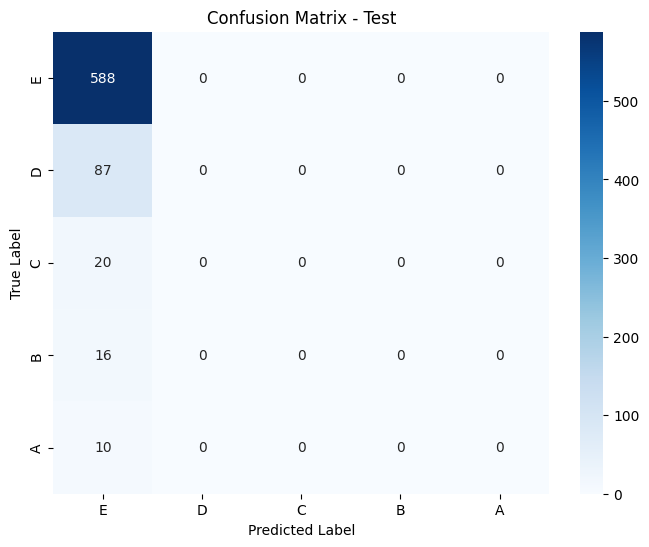

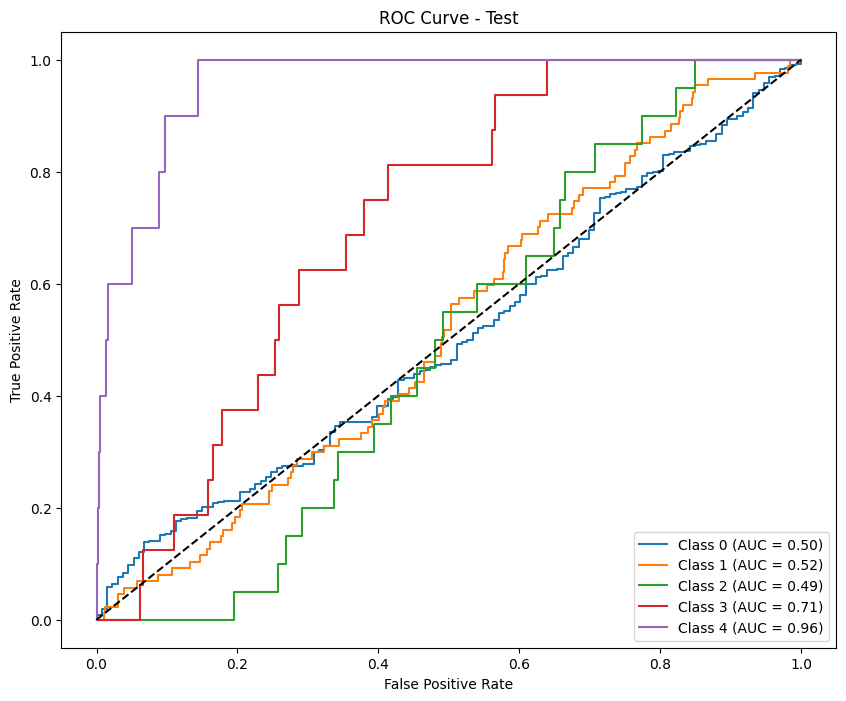

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None
Results saved as test_results_undersample_minmax_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.83852281 0.70886076 0.46111111 0.6984127  0.68292683]
Precision (per class): [0.92270916 0.69651741 0.32046332 0.60273973 0.51851852]
Recall (per class): [0.76841407 0.72164948 0.82178218 0.83018868 1.        ]
Accuracy: 0.7647
AUC (One-vs-Rest): 0.9434

Classification Report:
              precision    recall  f1-score   support

           E       0.92      0.77      0.84      1507
           D       0.70      0.72      0.71       582
           C       0.32      0.82      0.46       101
           B       0.60      0.83      0.70       159
           A       0.52      1.00      0.68        14

    accuracy                           0.76      2363
   macro 

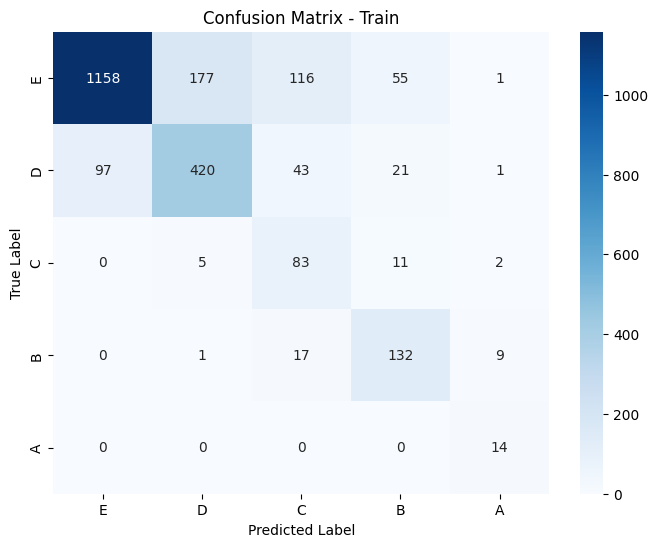

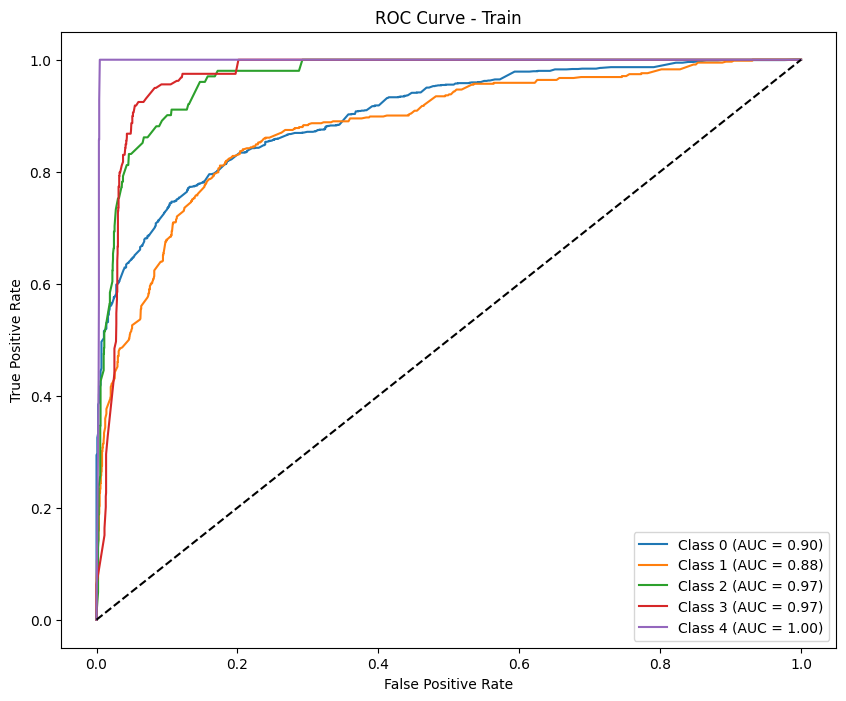

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.88436482 0.02020202 0.         0.         0.        ]
Precision (per class): [0.80683507 0.07142857 0.         0.         0.        ]
Recall (per class): [0.97837838 0.01176471 0.         0.         0.        ]
Accuracy: 0.7918
AUC (One-vs-Rest): 0.5940

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.98      0.88       555
           D       0.07      0.01      0.02        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.79       687
   macro avg       0.18      0.20      0.18       687
weighted avg       0.66      0.79      0.72       687



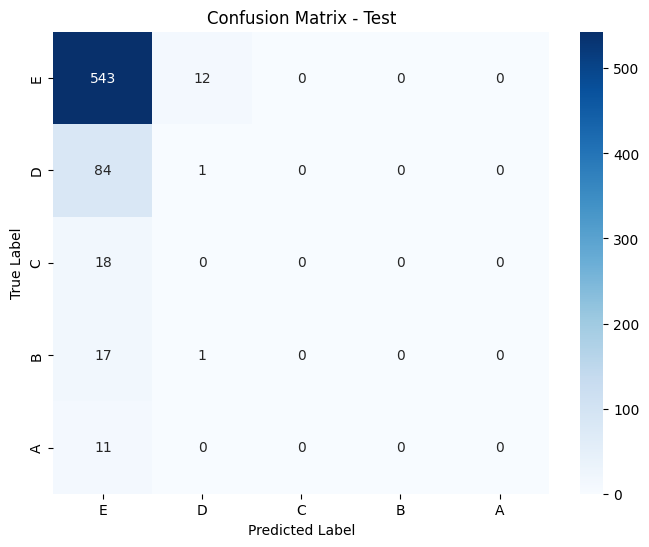

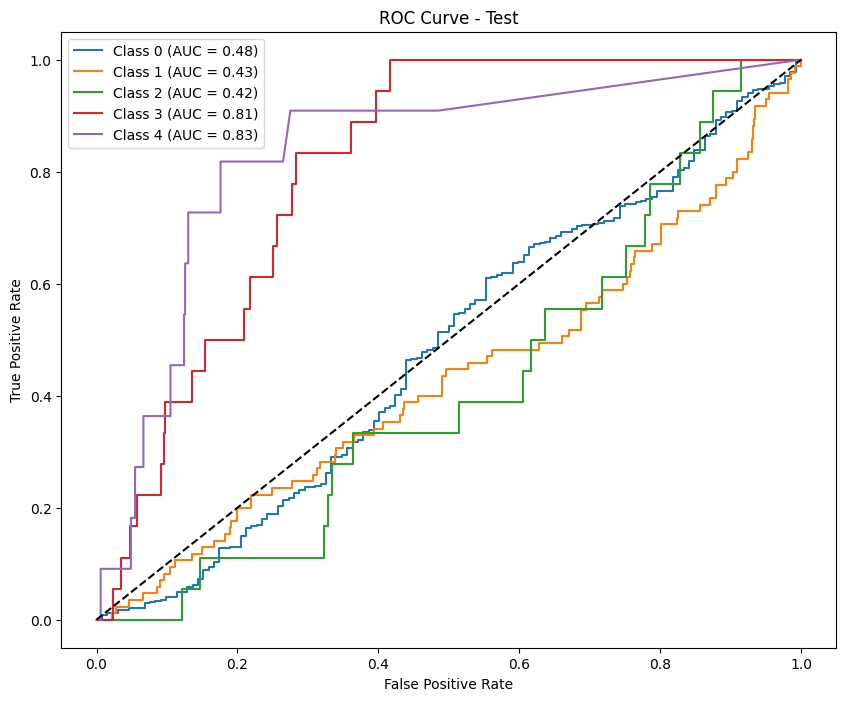

Results saved as test_results_calibrate_undersample_minmax_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.87923323 0.67078189 0.61206897 0.70391061 0.70588235]
Precision (per class): [0.84781269 0.83589744 0.54198473 0.63316583 0.6       ]
Recall (per class): [0.91307233 0.56013746 0.7029703  0.79245283 0.85714286]
Accuracy: 0.8087
AUC (One-vs-Rest): 0.9505

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.91      0.88      1507
           D       0.84      0.56      0.67       582
           C       0.54      0.70      0.61       101
           B       0.63      0.79      0.70       159
           A       0.60      0.86      0.71        14

    accuracy                           0.81      2363
   macro avg       0.69      0.77      0.71      2363
weighted avg       0.82      0.81      0.80      2363



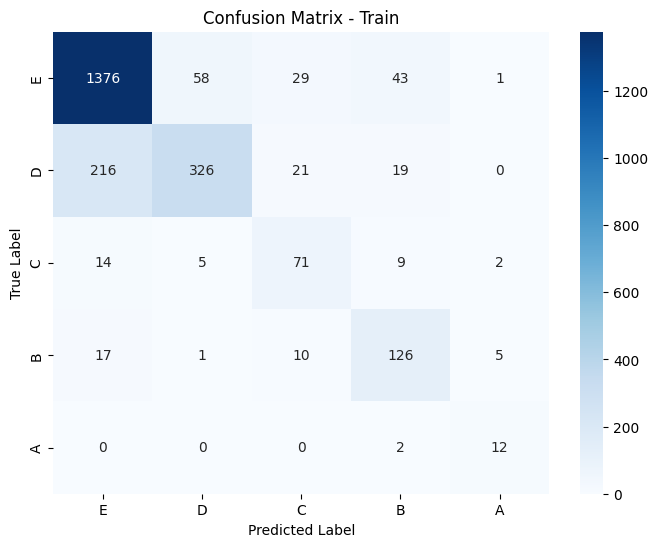

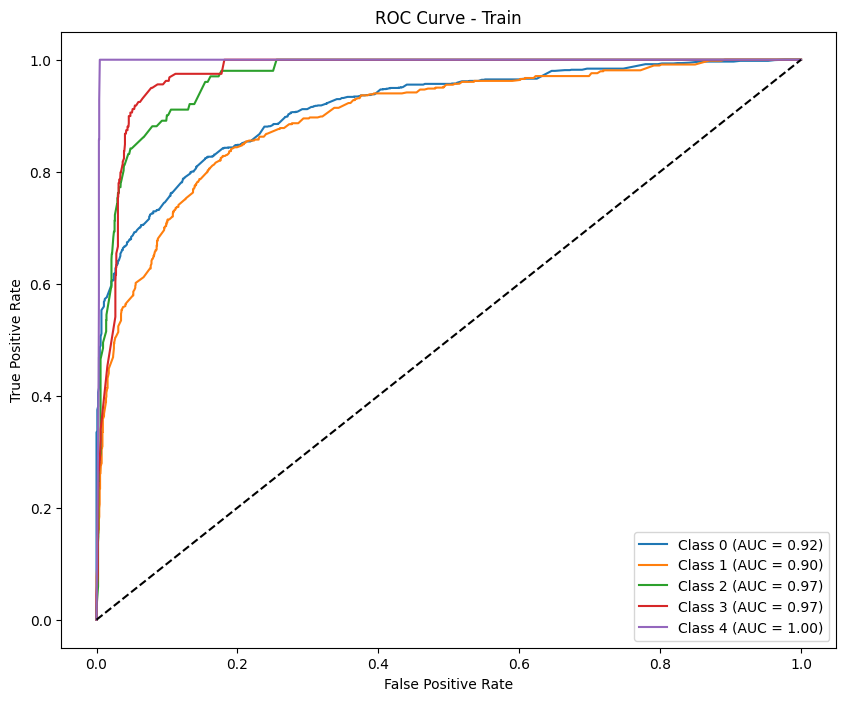


--- Test Metrics ---
F1 Score (per class): [0.89371981 0.         0.         0.         0.        ]
Precision (per class): [0.80786026 0.         0.         0.         0.        ]
Recall (per class): [1. 0. 0. 0. 0.]
Accuracy: 0.8079
AUC (One-vs-Rest): 0.6018

Classification Report:
              precision    recall  f1-score   support

           E       0.81      1.00      0.89       555
           D       0.00      0.00      0.00        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.81       687
   macro avg       0.16      0.20      0.18       687
weighted avg       0.65      0.81      0.72       687



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


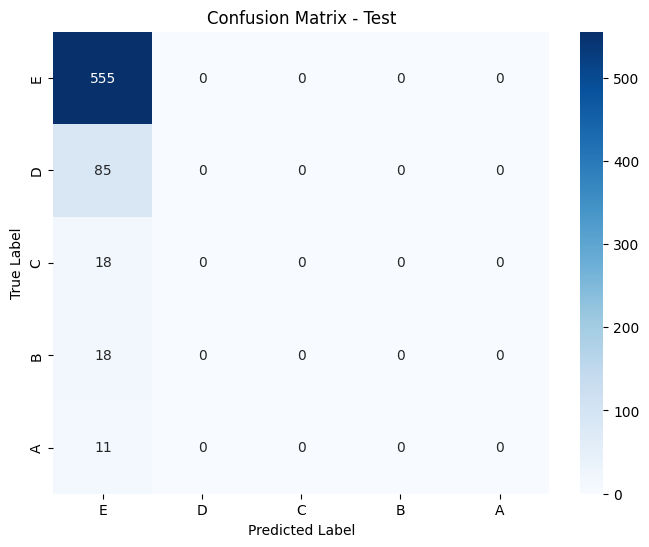

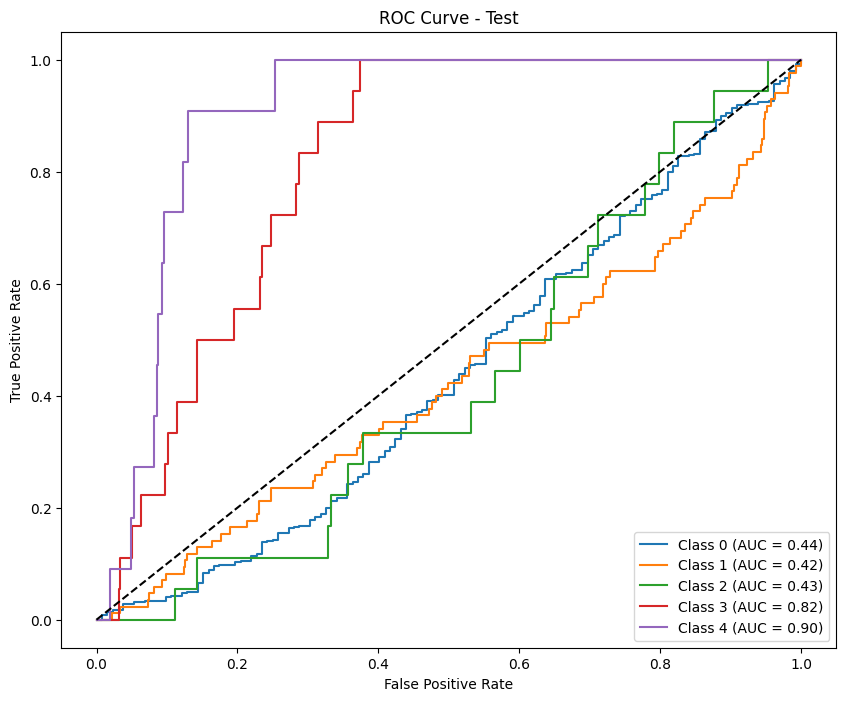

In [36]:
hyperparams = {
    "phase1": hp_1,
    "phase2": hp_2,
    "phase3": hp_3,
    "phase4": hp_4
}

for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_undersample_phase(phase, metric='f1_macro', scale='minmax',hyper=hyperparams[phase]) 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

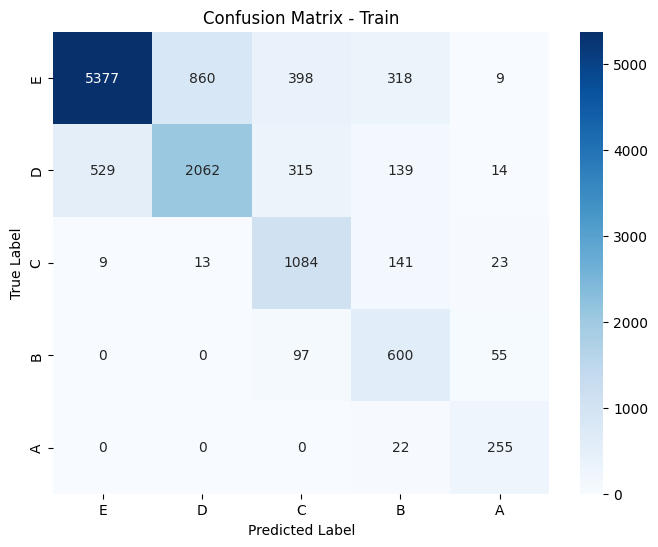

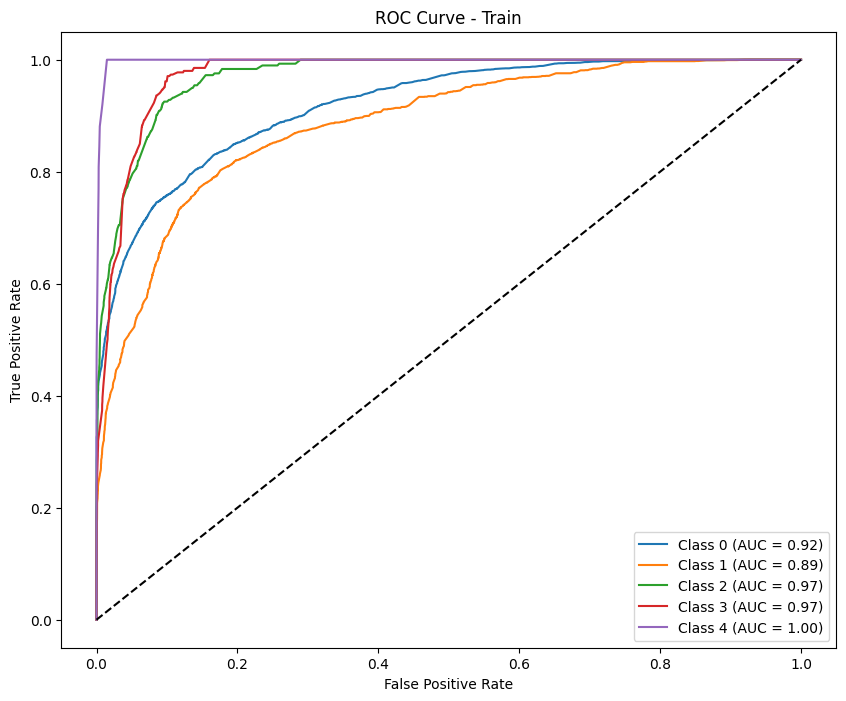

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.92018072 0.36231884 0.         0.         0.        ]
Precision (per class): [0.85814607 0.56818182 0.         0.         0.        ]
Recall (per class): [0.99188312 0.26595745 0.         0.         0.        ]
Accuracy: 0.8413
AUC (One-vs-Rest): 0.8469

Classification Report:
              precision    recall  f1-score   support

           E       0.86      0.99      0.92       616
           D       0.57      0.27      0.36        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.84       756
   macro avg       0.29      0.25      0.26       756
weighted avg       0.77      0.84      0.79       756



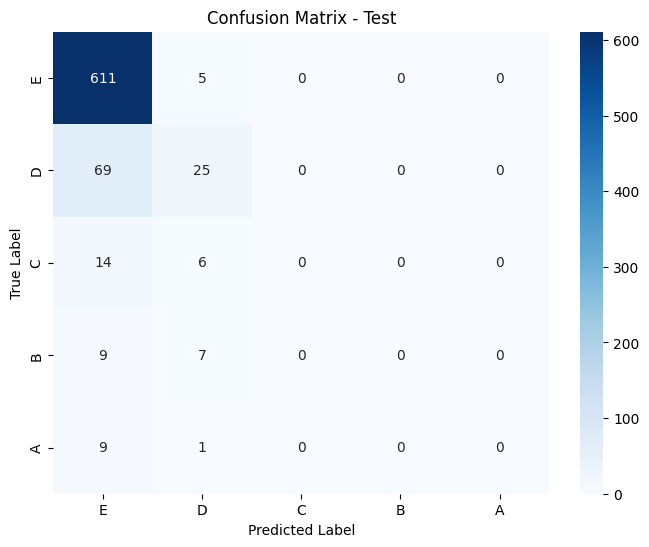

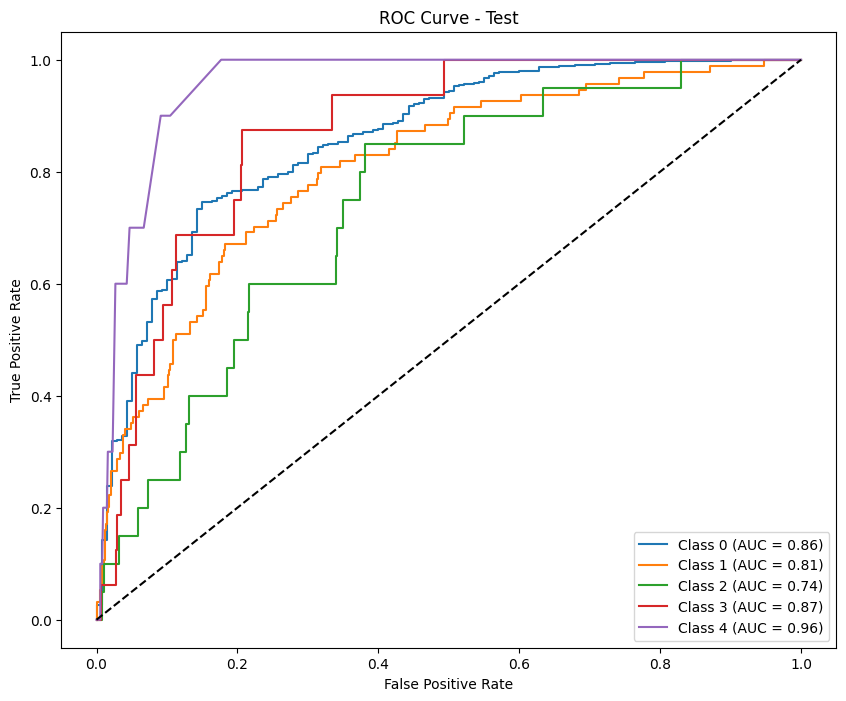

Results saved as test_results_calibrate_undersample_minmax_f1_macro_phase1.csv
Results for phase: phase1

--- Train Metrics ---
F1 Score (per class): [0.85159983 0.66176741 0.70319046 0.66940693 0.8457539 ]
Precision (per class): [0.85843549 0.75545302 0.59519913 0.59936909 0.81333333]
Recall (per class): [0.84487216 0.58875449 0.85905512 0.75797872 0.88086643]
Accuracy: 0.7782
AUC (One-vs-Rest): 0.9533

Classification Report:
              precision    recall  f1-score   support

           E       0.86      0.84      0.85      6962
           D       0.76      0.59      0.66      3059
           C       0.60      0.86      0.70      1270
           B       0.60      0.76      0.67       752
           A       0.81      0.88      0.85       277

    accuracy                           0.78     12320
   macro avg       0.72      0.79      0.75     12320
weighted avg       0.79      0.78      0.78     12320



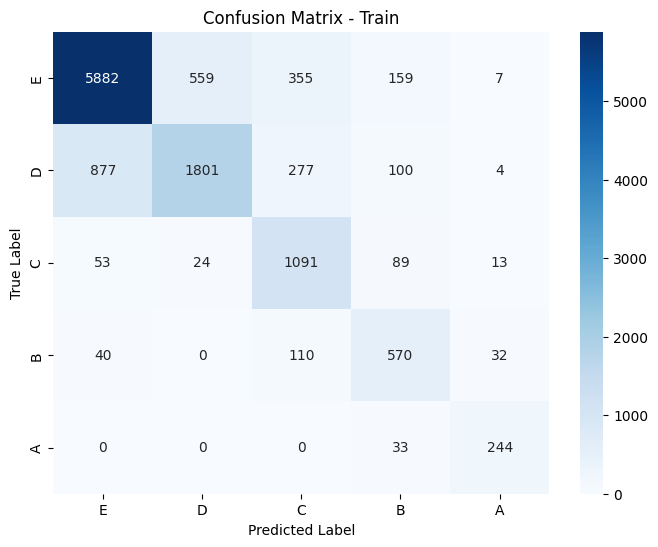

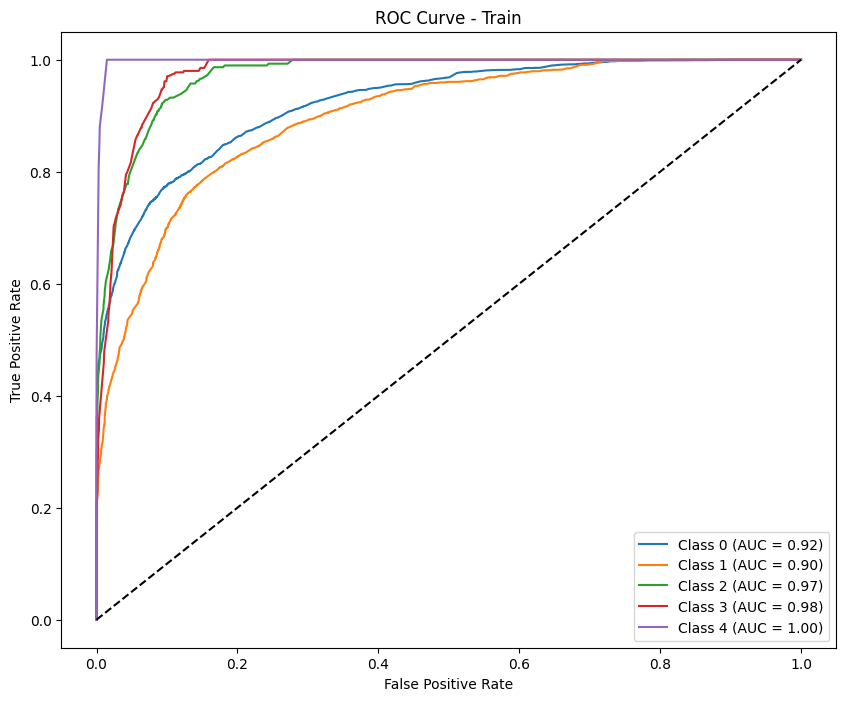


--- Test Metrics ---
F1 Score (per class): [0.90774908 0.16216216 0.         0.         0.        ]
Precision (per class): [0.83220568 0.52941176 0.         0.         0.        ]
Recall (per class): [0.99837662 0.09574468 0.         0.         0.        ]
Accuracy: 0.8254
AUC (One-vs-Rest): 0.8443

Classification Report:
              precision    recall  f1-score   support

           E       0.83      1.00      0.91       616
           D       0.53      0.10      0.16        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.83       756
   macro avg       0.27      0.22      0.21       756
weighted avg       0.74      0.83      0.76       756



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


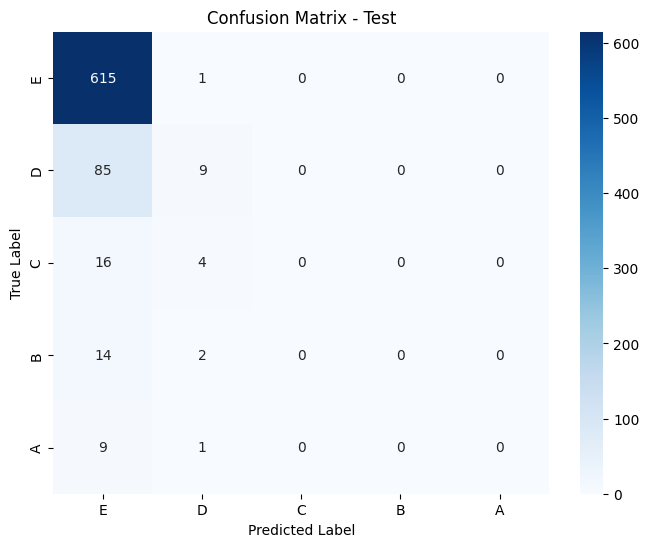

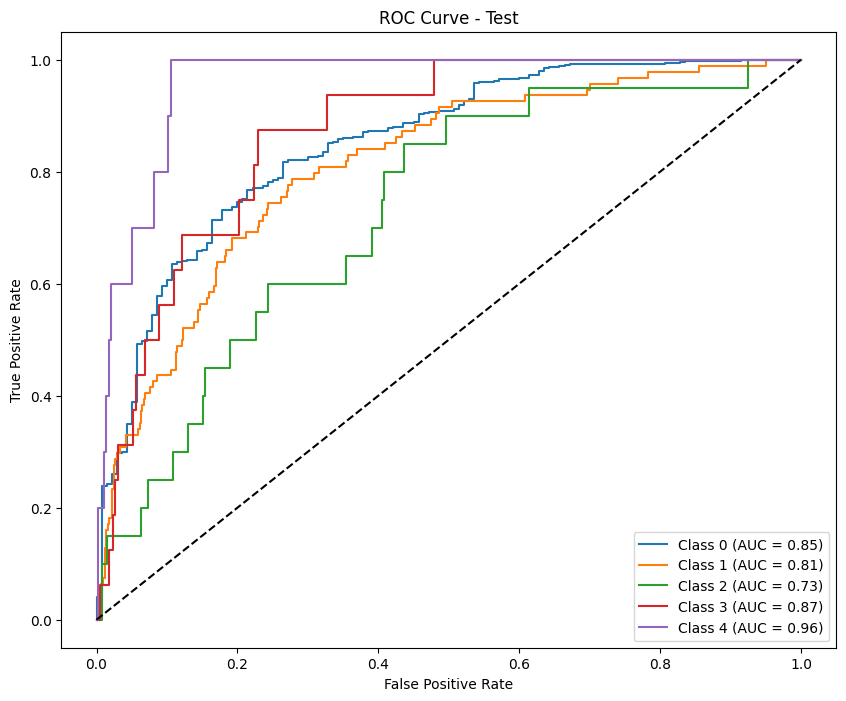


Permutation Importance for phase: phase1


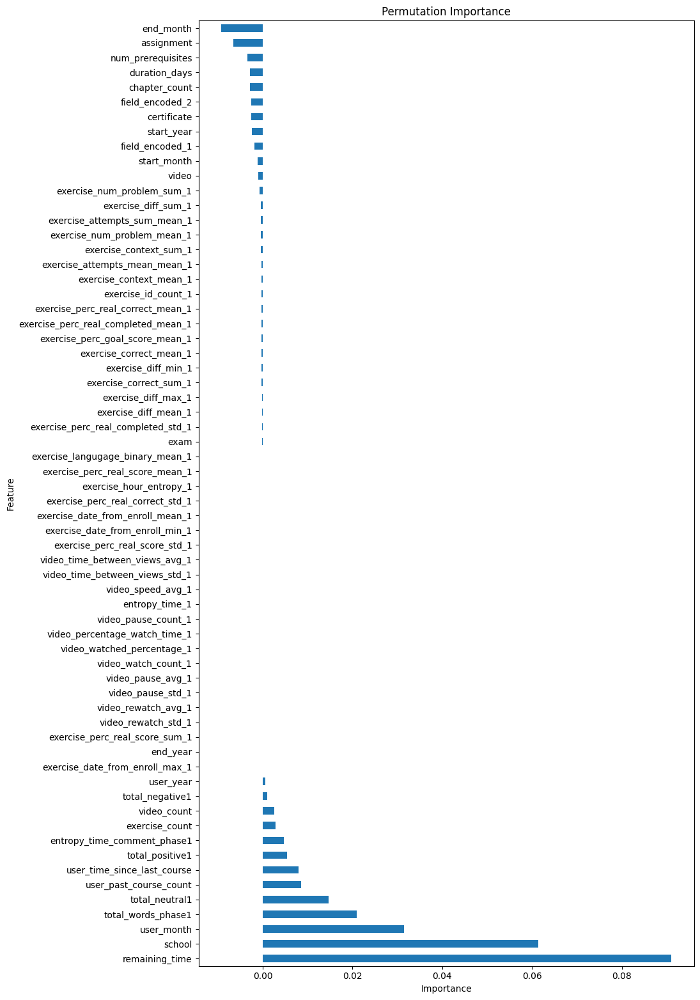

               Feature  Importance
20      remaining_time    0.091041
0               school    0.061343
8           user_month    0.031494
60  total_words_phase1    0.020992
63      total_neutral1    0.014661
..                 ...         ...
11       chapter_count   -0.002831
19       duration_days   -0.002892
14   num_prerequisites   -0.003490
16          assignment   -0.006605
6            end_month   -0.009294

[64 rows x 2 columns]

Lasso Feature Selection for phase: phase1


Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.1400730627165103, tolerance: 1.0302982853084406
Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4538682079291902, tolerance: 1.0302982853084406
Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.454513782266076, tolerance: 1.0302982853084406
Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.426857995971659, tolerance: 1.0302982853084406
Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.399785578899355, tolerance: 1.0302982853084406
Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.475707852710002, tolerance: 1.0302982853084406
Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.39726077060368, tolerance: 1.030298285308440

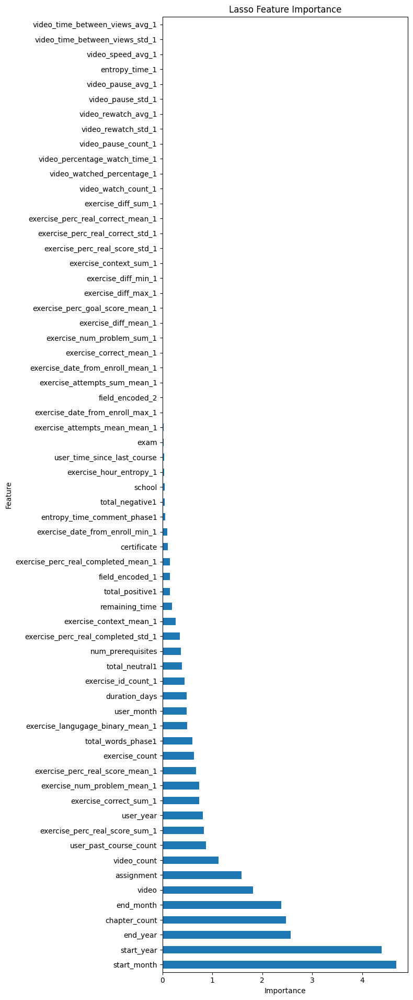

                           Feature  Importance
4                      start_month    4.680003
3                       start_year    4.391702
5                         end_year    2.571755
11                   chapter_count    2.470676
6                        end_month    2.379714
..                             ...         ...
52               video_pause_avg_1    0.000000
59                  entropy_time_1    0.000000
58               video_speed_avg_1    0.000000
57  video_time_between_views_std_1    0.000000
56  video_time_between_views_avg_1    0.000000

[64 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                       Feature    Importance
64              Random Feature  1.721096e-01
20              remaining_time  1.467200e-01
16                  assignment  8.176078e-02
17                       video  8.032040e-02
0                       school  6.835902e-02
..                         ...           ...
52           video_pause_avg_1  1.25

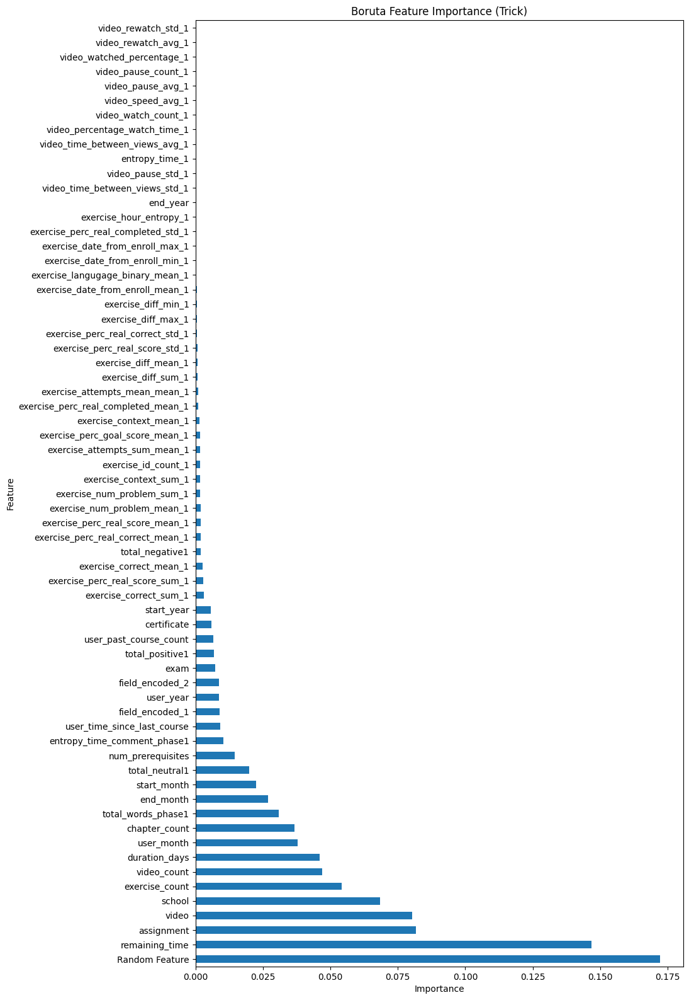

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None
Results saved as test_results_undersample_minmax_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.82195216 0.66071429 0.69769146 0.64471058 0.89241623]
Precision (per class): [0.8974305  0.65513078 0.63509006 0.50706436 0.86643836]
Recall (per class): [0.75818505 0.66639378 0.77398374 0.88493151 0.92      ]
Accuracy: 0.7516
AUC (One-vs-Rest): 0.9422

Classification Report:
              precision    recall  f1-score   support

           E       0.90      0.76      0.82      5620
           D       0.66      0.67      0.66      2443
           C       0.64      0.77      0.70      1230
           B       0.51      0.88      0.64       730
           A       0.87      0.92      0.89       275

    accuracy                           0.75     10298
   macro 

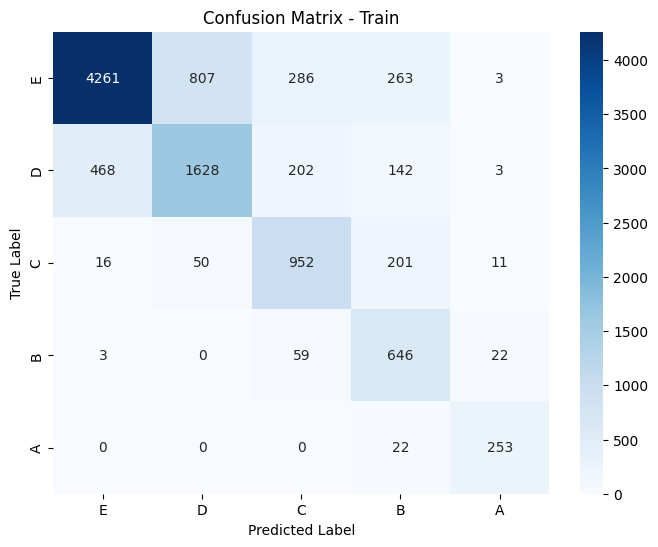

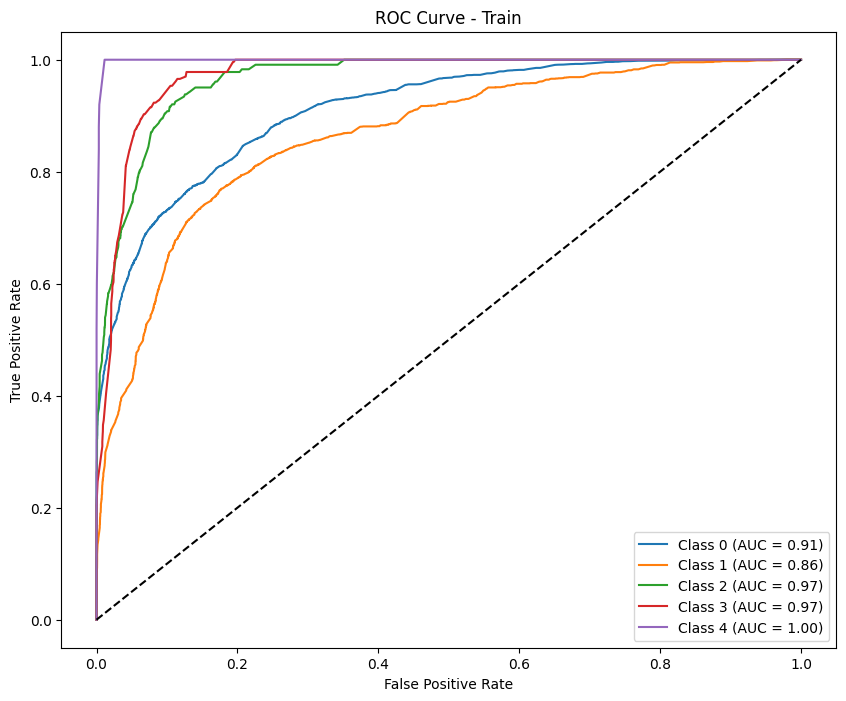


--- Test Metrics ---
F1 Score (per class): [0.90423163 0.08       0.         0.         0.        ]
Precision (per class): [0.82520325 0.5        0.         0.         0.        ]
Recall (per class): [1.         0.04347826 0.         0.         0.        ]
Accuracy: 0.8217
AUC (One-vs-Rest): 0.7461

Classification Report:
              precision    recall  f1-score   support

           E       0.83      1.00      0.90       609
           D       0.50      0.04      0.08        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.82       746
   macro avg       0.27      0.21      0.20       746
weighted avg       0.74      0.82      0.75       746



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


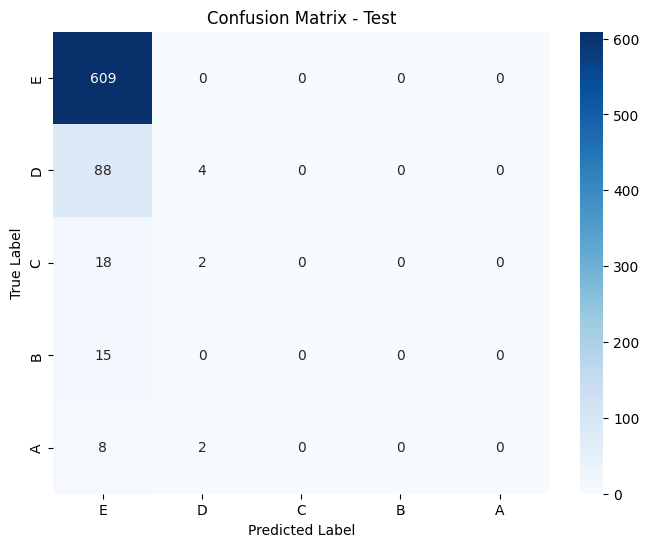

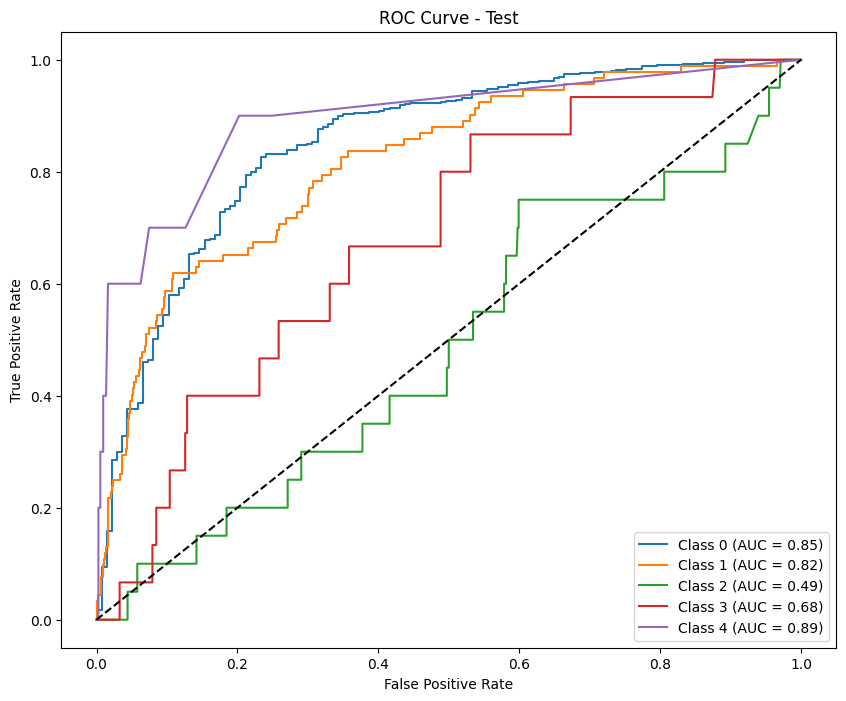

Results saved as test_results_calibrate_undersample_minmax_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.84080977 0.62018349 0.71838235 0.68894009 0.89241623]
Precision (per class): [0.84283926 0.70526865 0.6557047  0.5944334  0.86643836]
Recall (per class): [0.83879004 0.55341793 0.79430894 0.81917808 0.92      ]
Accuracy: 0.7666
AUC (One-vs-Rest): 0.9466

Classification Report:
              precision    recall  f1-score   support

           E       0.84      0.84      0.84      5620
           D       0.71      0.55      0.62      2443
           C       0.66      0.79      0.72      1230
           B       0.59      0.82      0.69       730
           A       0.87      0.92      0.89       275

    accuracy                           0.77     10298
   macro avg       0.73      0.79      0.75     10298
weighted avg       0.77      0.77      0.76     10298



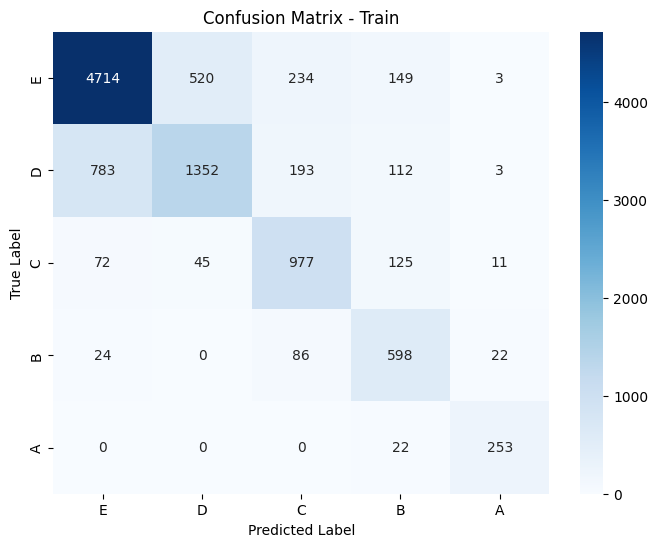

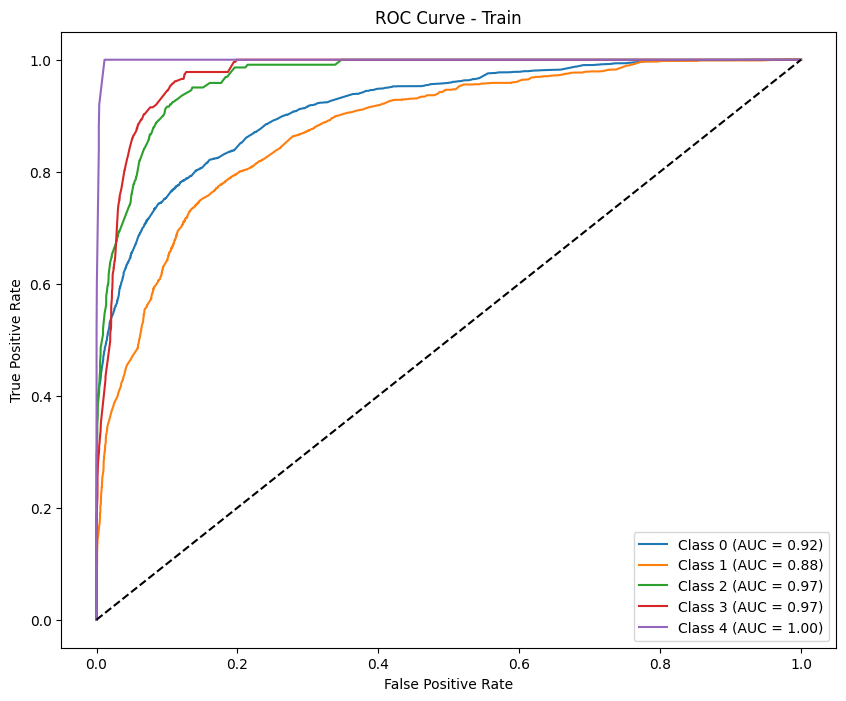


--- Test Metrics ---
F1 Score (per class): [0.89889299 0.         0.         0.         0.        ]
Precision (per class): [0.81635389 0.         0.         0.         0.        ]
Recall (per class): [1. 0. 0. 0. 0.]
Accuracy: 0.8164
AUC (One-vs-Rest): 0.7451

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       609
           D       0.00      0.00      0.00        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.82       746
   macro avg       0.16      0.20      0.18       746
weighted avg       0.67      0.82      0.73       746



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


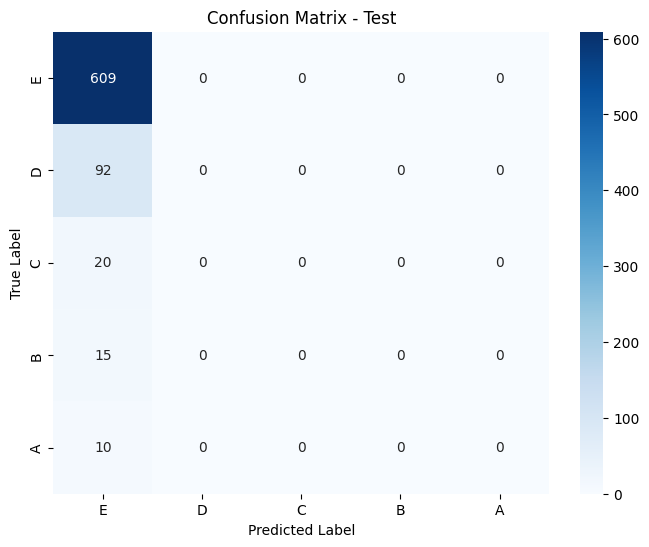

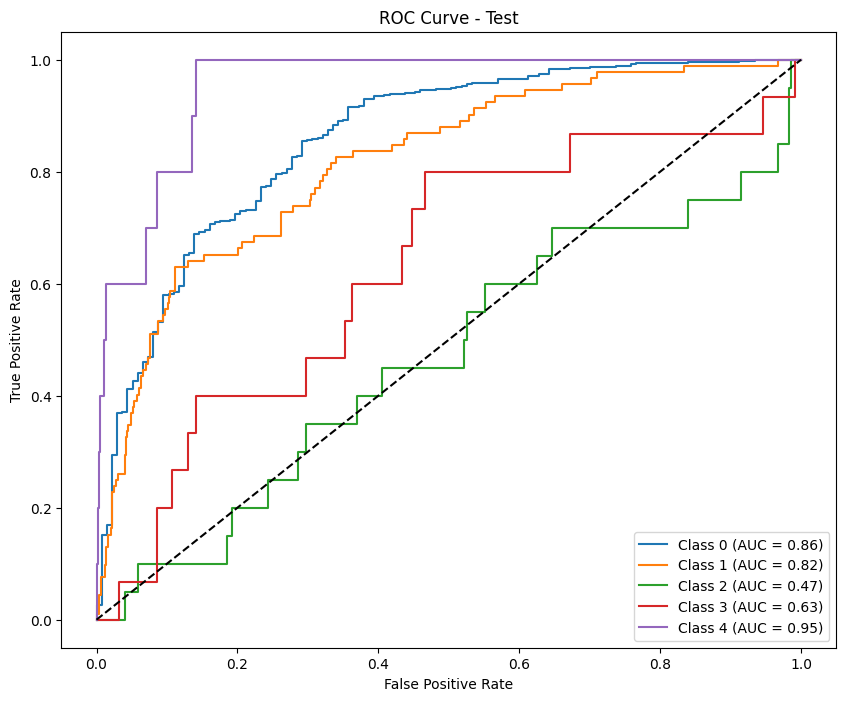


Permutation Importance for phase: phase2


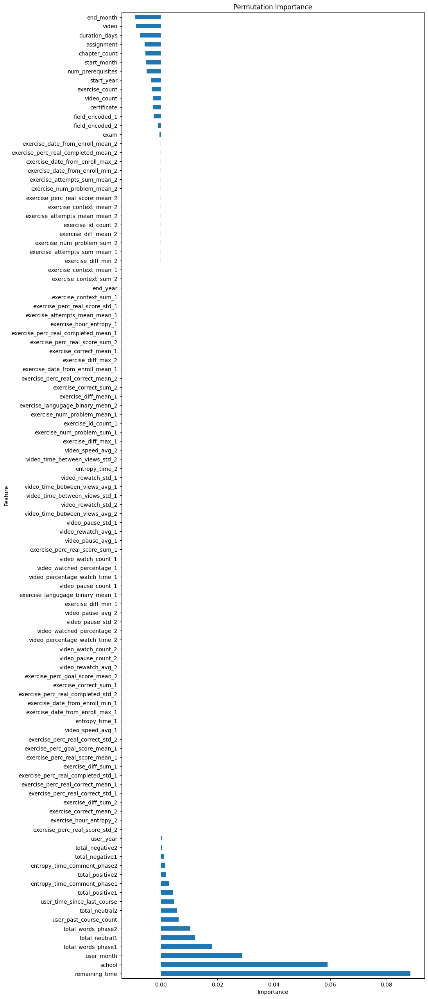

               Feature  Importance
20      remaining_time    0.088524
0               school    0.059089
8           user_month    0.028683
60  total_words_phase1    0.018025
63      total_neutral1    0.012041
..                 ...         ...
11       chapter_count   -0.005523
16          assignment   -0.005741
19       duration_days   -0.007465
17               video   -0.008837
6            end_month   -0.009152

[107 rows x 2 columns]

Lasso Feature Selection for phase: phase2


Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.0856672170211823, tolerance: 0.9432695799951442
Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.87123036634057, tolerance: 0.9432695799951442
Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.692601455858494, tolerance: 0.9432695799951442
Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.087237586208175, tolerance: 0.9432695799951442
Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.221889373732665, tolerance: 0.9432695799951442
Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.327267789031794, tolerance: 0.9432695799951442
Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.201227866152294, tolerance: 0.94326957999

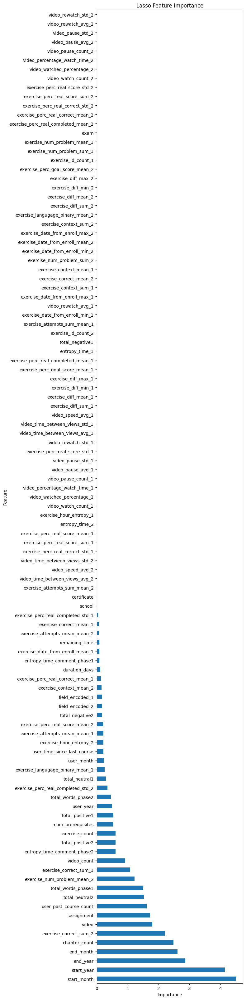

                Feature  Importance
4           start_month    4.502798
3            start_year    4.147642
5              end_year    2.869039
6             end_month    2.616952
11        chapter_count    2.483980
..                  ...         ...
94  video_pause_count_2    0.000000
95    video_pause_avg_2    0.000000
96    video_pause_std_2    0.000000
97  video_rewatch_avg_2    0.000000
98  video_rewatch_std_2    0.000000

[107 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                 Feature  Importance
107       Random Feature    0.131732
20        remaining_time    0.128395
17                 video    0.090382
16            assignment    0.081435
0                 school    0.073417
..                   ...         ...
51   video_pause_count_1    0.000000
52     video_pause_avg_1    0.000000
53     video_pause_std_1    0.000000
97   video_rewatch_avg_2    0.000000
98   video_rewatch_std_2    0.000000

[108 rows x 2 columns]
Important feat

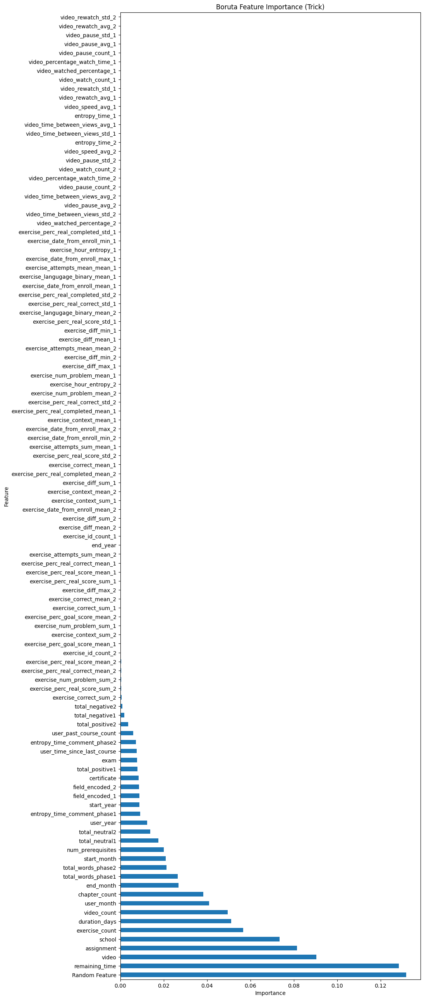

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None
Results saved as test_results_undersample_minmax_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.82704237 0.66518354 0.7118145  0.6608506  0.87431694]
Precision (per class): [0.89651242 0.6689038  0.63451444 0.53771074 0.85714286]
Recall (per class): [0.7675644  0.66150442 0.81056161 0.85714286 0.89219331]
Accuracy: 0.7580
AUC (One-vs-Rest): 0.9434

Classification Report:
              precision    recall  f1-score   support

           E       0.90      0.77      0.83      5124
           D       0.67      0.66      0.67      2260
           C       0.63      0.81      0.71      1193
           B       0.54      0.86      0.66       707
           A       0.86      0.89      0.87       269

    accuracy                           0.76      9553
   macro 

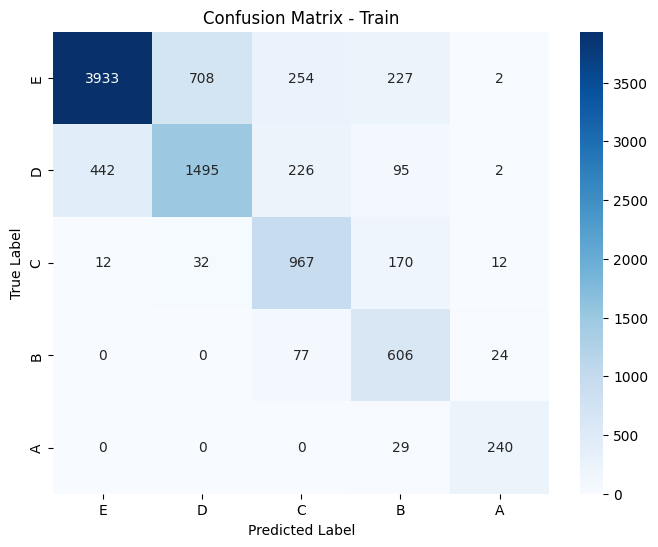

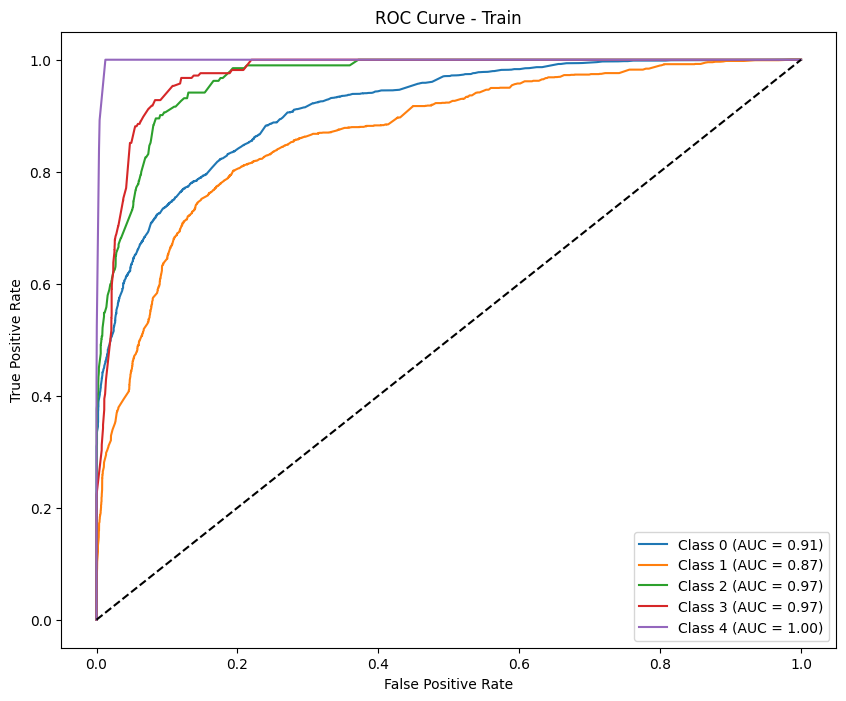


--- Test Metrics ---
F1 Score (per class): [0.89824024 0.         0.         0.         0.        ]
Precision (per class): [0.81641168 0.         0.         0.         0.        ]
Recall (per class): [0.99829932 0.         0.         0.         0.        ]
Accuracy: 0.8141
AUC (One-vs-Rest): 0.5900

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       588
           D       0.00      0.00      0.00        87
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.81       721
   macro avg       0.16      0.20      0.18       721
weighted avg       0.67      0.81      0.73       721



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


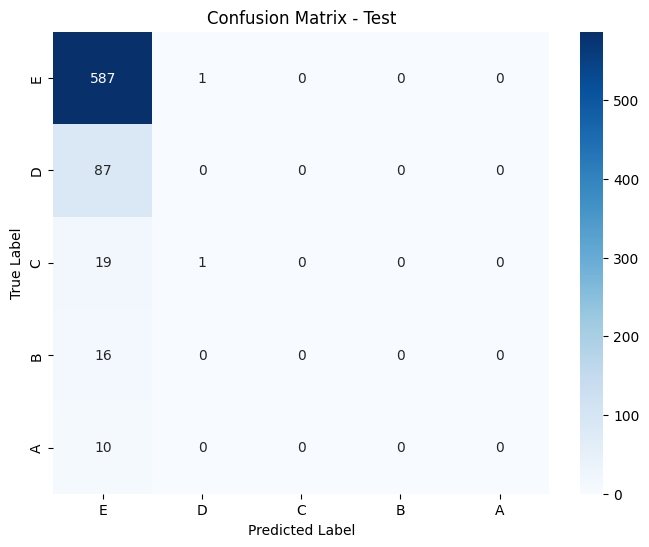

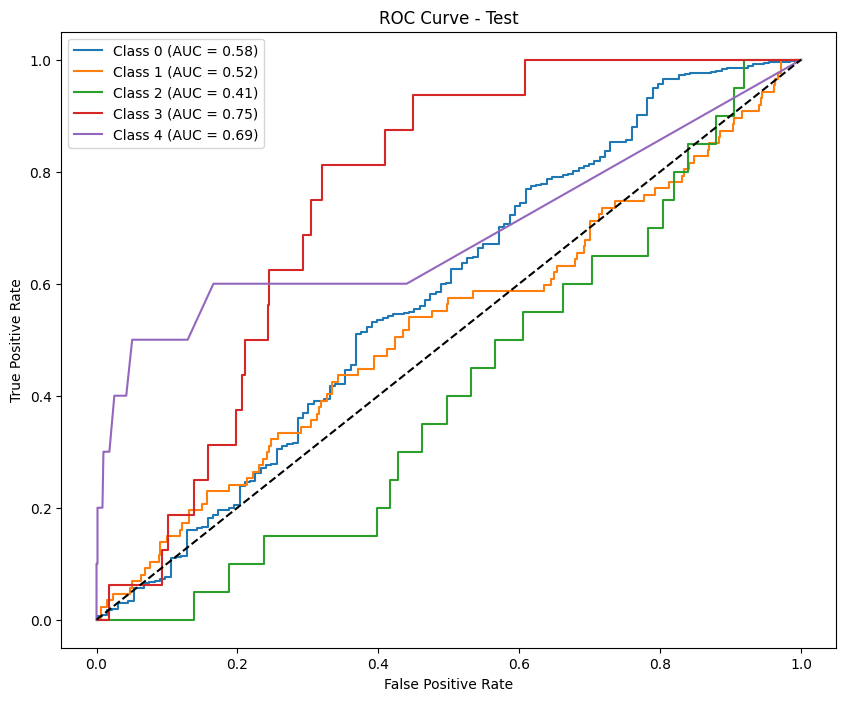

Results saved as test_results_calibrate_undersample_minmax_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.84617616 0.63160518 0.72115761 0.70395137 0.87431694]
Precision (per class): [0.8384748  0.72317352 0.67595308 0.61727079 0.85714286]
Recall (per class): [0.8540203  0.56061947 0.77284158 0.81895332 0.89219331]
Accuracy: 0.7730
AUC (One-vs-Rest): 0.9476

Classification Report:
              precision    recall  f1-score   support

           E       0.84      0.85      0.85      5124
           D       0.72      0.56      0.63      2260
           C       0.68      0.77      0.72      1193
           B       0.62      0.82      0.70       707
           A       0.86      0.89      0.87       269

    accuracy                           0.77      9553
   macro avg       0.74      0.78      0.76      9553
weighted avg       0.78      0.77      0.77      9553



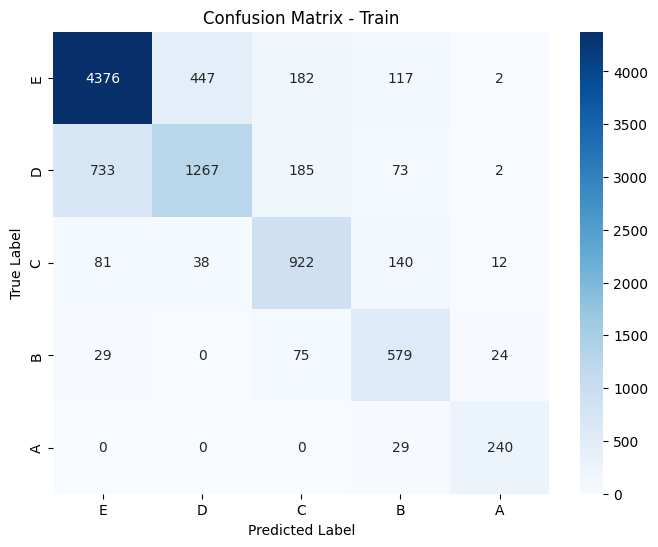

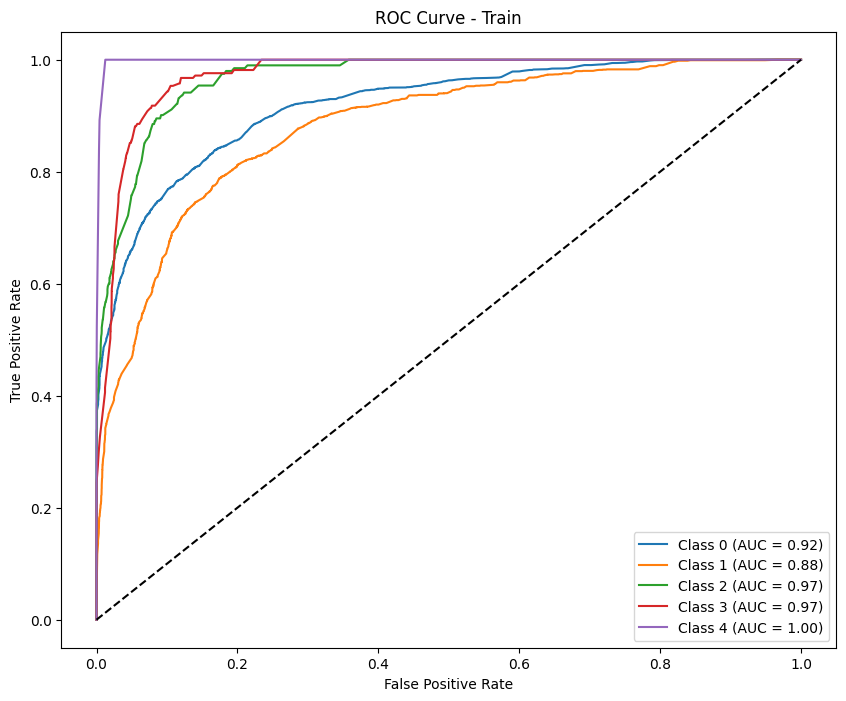

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.89824024 0.         0.         0.         0.        ]
Precision (per class): [0.81641168 0.         0.         0.         0.        ]
Recall (per class): [0.99829932 0.         0.         0.         0.        ]
Accuracy: 0.8141
AUC (One-vs-Rest): 0.6301

Classification Report:
              precision    recall  f1-score   support

           E       0.82      1.00      0.90       588
           D       0.00      0.00      0.00        87
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.81       721
   macro avg       0.16      0.20      0.18       721
weighted avg       0.67      0.81      0.73       721



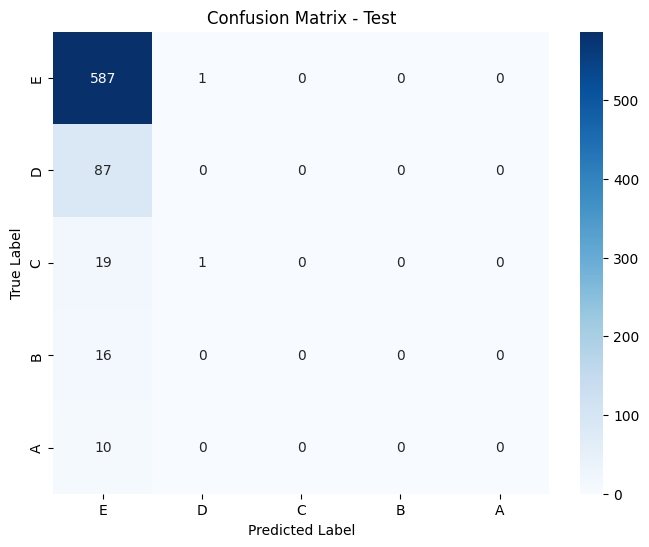

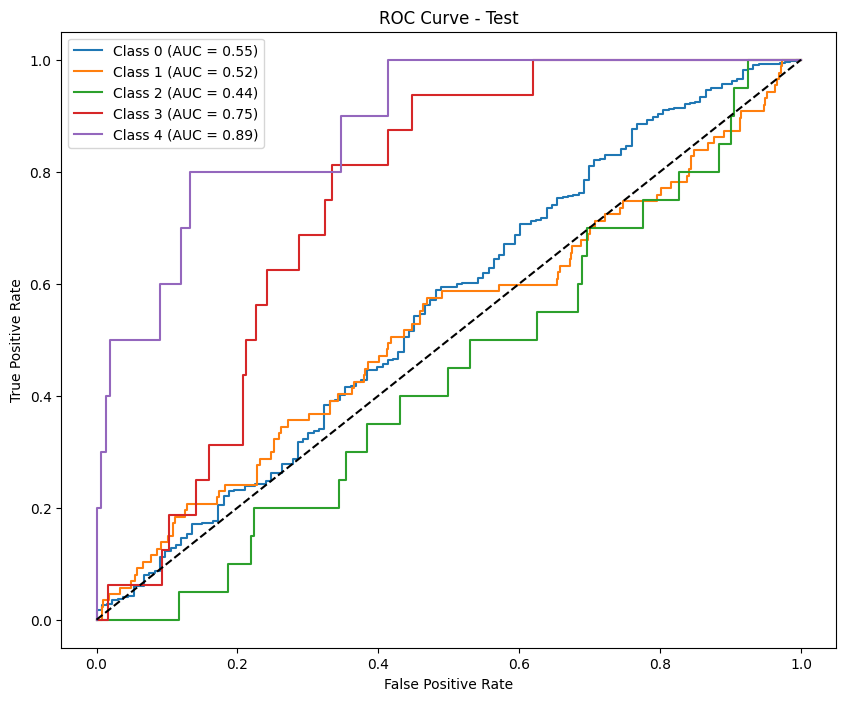

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None
Results saved as test_results_undersample_minmax_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.82454784 0.69335055 0.76037588 0.75526316 0.9025641 ]
Precision (per class): [0.90040513 0.70844327 0.66827254 0.66666667 0.82242991]
Recall (per class): [0.76047904 0.67888748 0.88192552 0.87101669 1.        ]
Accuracy: 0.7803
AUC (One-vs-Rest): 0.9525

Classification Report:
              precision    recall  f1-score   support

           E       0.90      0.76      0.82      3507
           D       0.71      0.68      0.69      1582
           C       0.67      0.88      0.76      1101
           B       0.67      0.87      0.76       659
           A       0.82      1.00      0.90       264

    accuracy                           0.78      7113
   macro 

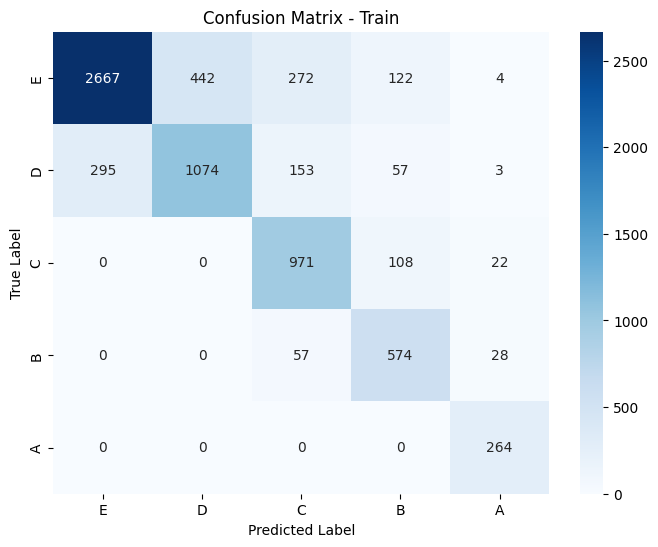

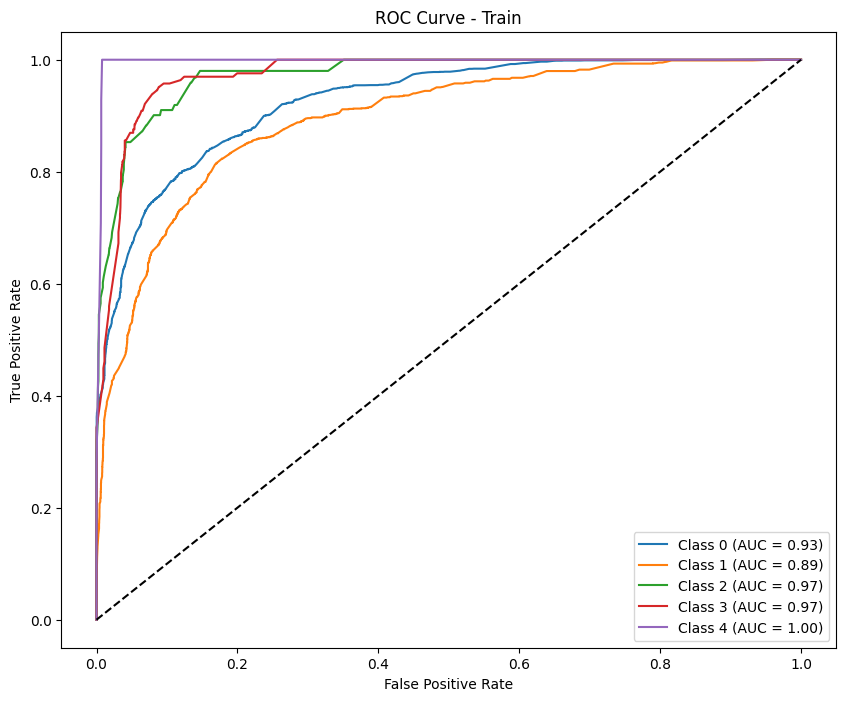

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.88888889 0.0212766  0.         0.         0.        ]
Precision (per class): [0.80825959 0.11111111 0.         0.         0.        ]
Recall (per class): [0.98738739 0.01176471 0.         0.         0.        ]
Accuracy: 0.7991
AUC (One-vs-Rest): 0.5553

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.99      0.89       555
           D       0.11      0.01      0.02        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.80       687
   macro avg       0.18      0.20      0.18       687
weighted avg       0.67      0.80      0.72       687



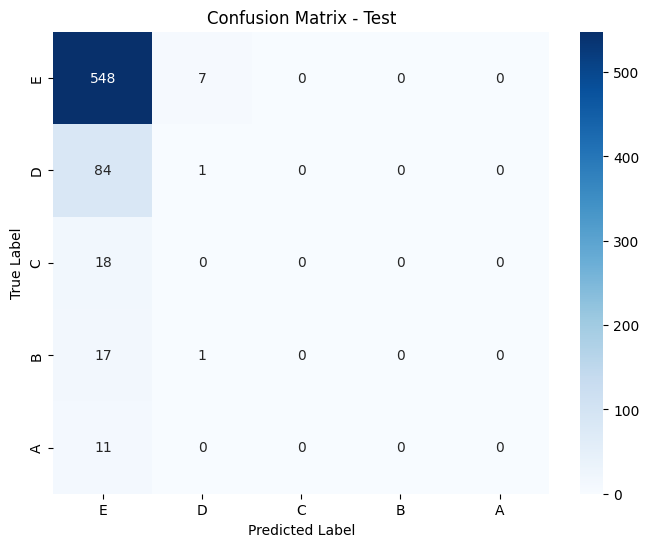

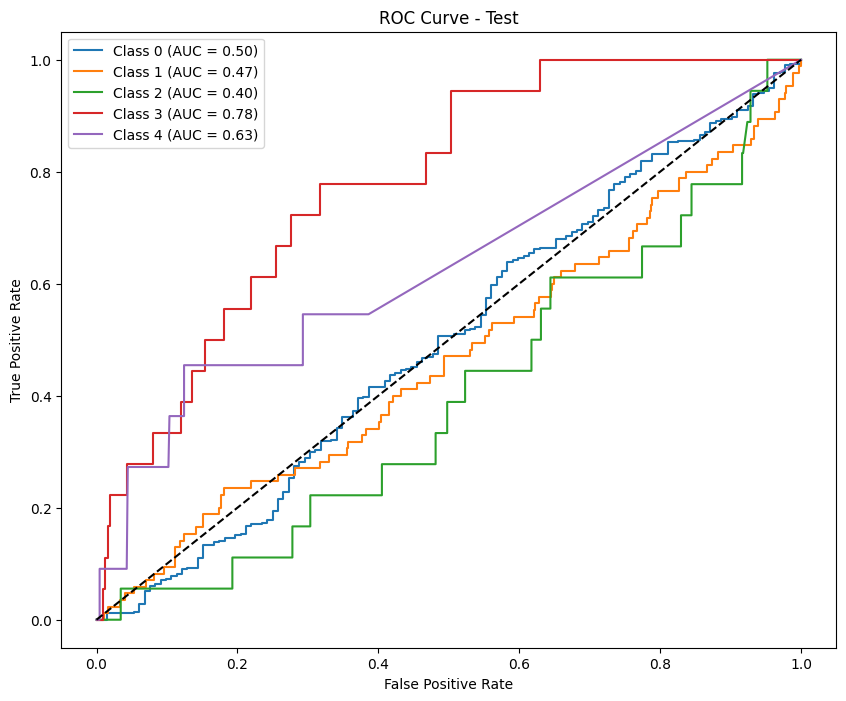

Results saved as test_results_calibrate_undersample_minmax_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.84496342 0.6532229  0.81193256 0.75656985 0.90721649]
Precision (per class): [0.83393502 0.75899582 0.77475248 0.69504447 0.83018868]
Recall (per class): [0.85628743 0.57332491 0.85286104 0.83004552 1.        ]
Accuracy: 0.7957
AUC (One-vs-Rest): 0.9554

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.86      0.84      3507
           D       0.76      0.57      0.65      1582
           C       0.77      0.85      0.81      1101
           B       0.70      0.83      0.76       659
           A       0.83      1.00      0.91       264

    accuracy                           0.80      7113
   macro avg       0.78      0.82      0.79      7113
weighted avg       0.80      0.80      0.79      7113



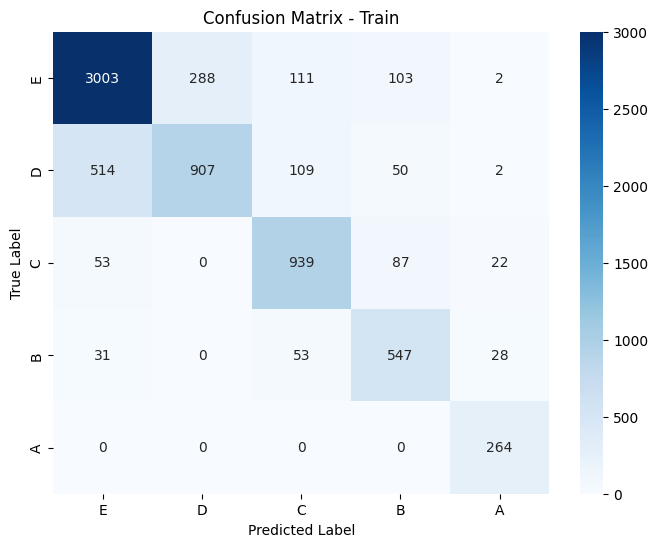

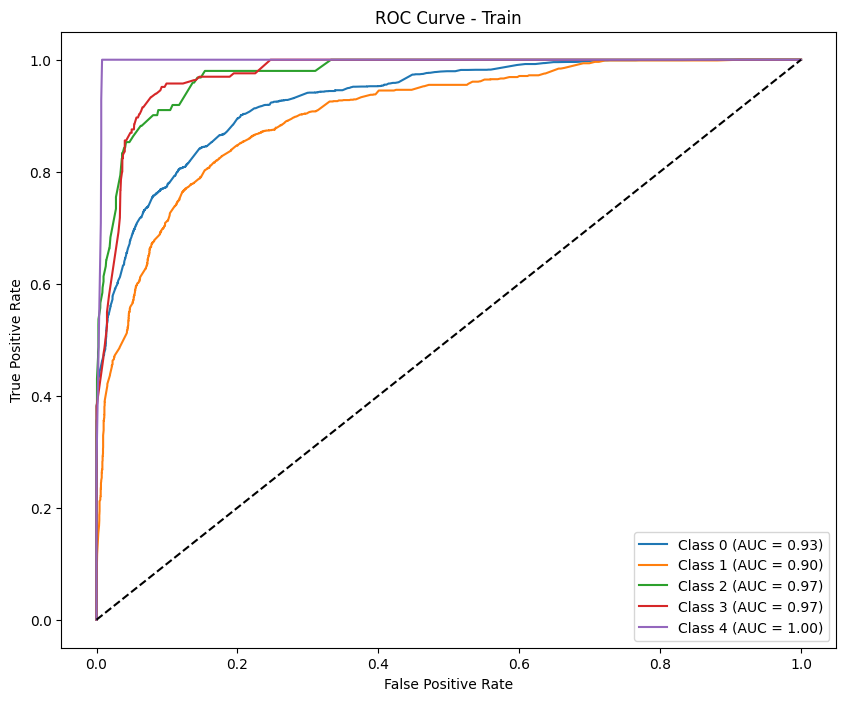


--- Test Metrics ---
F1 Score (per class): [0.89282836 0.         0.         0.         0.        ]
Precision (per class): [0.80758017 0.         0.         0.         0.        ]
Recall (per class): [0.9981982 0.        0.        0.        0.       ]
Accuracy: 0.8064
AUC (One-vs-Rest): 0.6035

Classification Report:
              precision    recall  f1-score   support

           E       0.81      1.00      0.89       555
           D       0.00      0.00      0.00        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.81       687
   macro avg       0.16      0.20      0.18       687
weighted avg       0.65      0.81      0.72       687



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


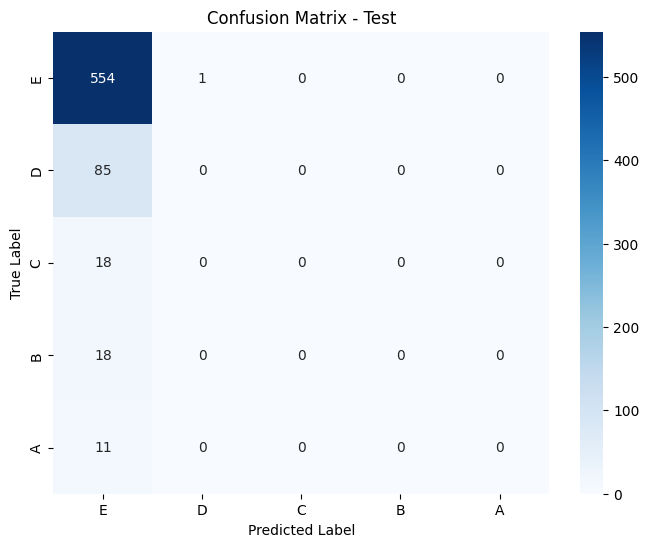

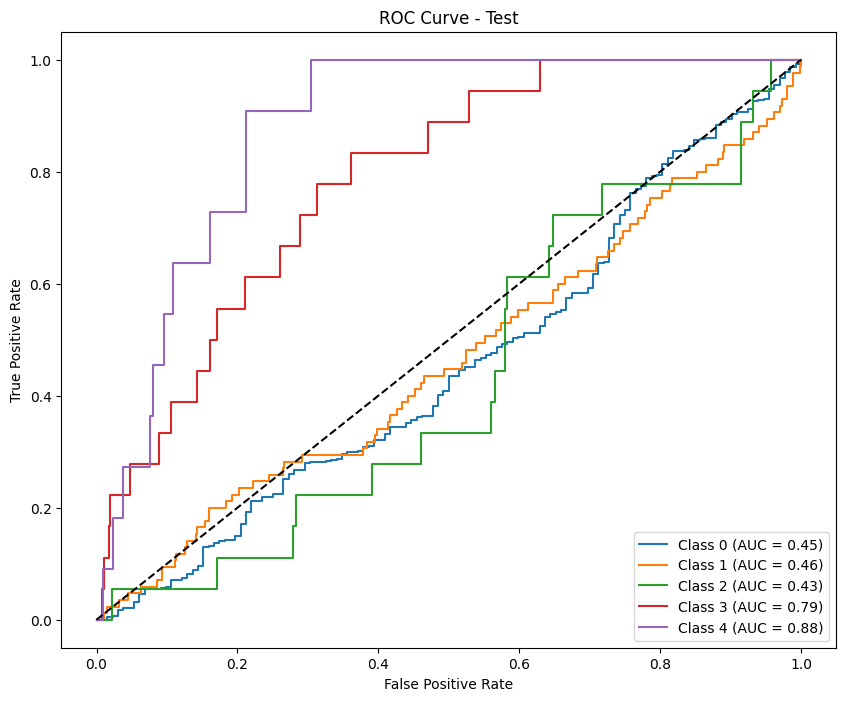

In [37]:
hyperparams = {
    "phase1": hp_1,
    "phase2": hp_2,
    "phase3": hp_3,
    "phase4": hp_4
}

for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_oversample_phase(phase, metric='f1_macro', scale='minmax', hyper=hyperparams[phase]) 